# Extraction of gaze aversion & plot graphs

In [1]:

# TODO : Add function descriptions for calcul_VD_**

#### The following code illustrates how to extract gaze aversioms from eye-tracking data

In [2]:
import csv
import numpy as np
import matplotlib.pyplot as plt
import os
import seaborn as sns
import cv2 
import pandas as pd
import re
from tqdm import tqdm

In [3]:
# Change path to directory
set_WD = os.getcwd() # get current work directory

idd={'1':'P01','2':'P02','3':'P03','4':'P04','5':'P05', \
     '6':'P06','7':'P07','9':'P09','10':'P10','11':'P11', \
     '12':'P12','13':'P13','14':'P14','15':'P15','16':'P16', \
     '17':'P17','18':'P18', '19': 'P19', '20': 'P20', '21': 'P21', '22': 'P22', '23':'P23', '24':'P24', '25':'P25', '26':'P26', '27':'P27', \
     '28': 'P28', '29':'P29', '30':'P30', '31':'P31', '32':'P32', '33':'P33'} #list of all the participants 

seuil=250 #max duration of blink(ms)/2; where max duration of blink is 500 ms

wd_output_csv1=set_WD+"/data/processed_data/ratios_access.csv" # data from access phase
wd_output_csv2=set_WD+"/data/processed_data/orientation.csv" # the orientations of VD are only calculated for the first VD of every access phase
# NOTE: that "visu" is used to refer to the elaboration phase where the participant visualize the event
wd_output_csv3=set_WD+"/data/processed_data/ratios_visu.csv" # data from elaboration phase
wd_output_img=set_WD+"/data/processed_data/graphs/" # graphs to visualise when there is gaze aversion (1 graph per question), red parts represent the gaze aversions

# the path to the directory containing the eye-tracking files
wd_input=set_WD+"/data/raw_data/eye_tracker"

if not os.path.exists(wd_output_img):
    os.makedirs(wd_output_img)

## Helper functions

In [4]:
def ouvrir_fichier_ET() :
    f=open(wd_output_csv1, "a")
    F="Sujet,Bloc,audio,nb_VD,moy_duree_VD,ratio,delai,nb_sacc,duree_fix,VD_continue_in_visu \n"
    f.writelines(F)
    f.close()
    
    
def completer_fichier_ET(sujet,bloc,audio,nb_VD,moy_duree_VD,ratio,delai,sacc,fix, VD_continue_in_visu) :
    f=open(wd_output_csv1, "a")
    FF=sujet+','+bloc+','+audio+','+nb_VD+','+moy_duree_VD+','+ratio+','+delai+','+sacc+','+fix+', '+VD_continue_in_visu+'\n'
    f.writelines(FF)
    f.close()

    
#************************************
def ouvrir_fichier_ET_visu() :
    f=open(wd_output_csv3, "a")
    F="Sujet,Bloc,audio,nb_VD,moy_duree_VD,ratio,delai,time_before_visu_VD,duration_VD_in_elaboration_if_started_before \n"
    f.writelines(F)
    f.close()
    
    
def completer_fichier_ET_visu(sujet,bloc,audio,nb_VD_v,moy_duree_VD_v,ratio_v,delai_v, started_before_visu, duration_VD_inside_elaboration) :
    f=open(wd_output_csv3, "a")
    FF=sujet+','+bloc+','+audio+','+nb_VD_v+','+moy_duree_VD_v+','+ratio_v+','+delai_v+', '+started_before_visu+', '+duration_VD_inside_elaboration+'\n'
    f.writelines(FF)
    f.close()
#************************************
    
    
def ouvrir_fichier_orientation() :
    f=open(wd_output_csv2, "a")
    F="sujet,audio,n_VD,when,coord_x,coord_y,last,duree\n"
    f.writelines(F)
    f.close()
    
    
def completer_fichier_orientation(sujet,audio,n_VD,when,coord_x,coord_y,m,duree) :
    f=open(wd_output_csv2, "a")
    FF=sujet+','+audio+','+n_VD+','+when+','+coord_x+','+coord_y+','+m+','+duree+'\n'
    if coord_x!='out' and coord_y!='out' :
        f.writelines(FF)
    f.close()

# dur = duration of visual disengagement / L_acces = duration of access period in timesteps / end_of_question_xc = temps fin de question /
def calcul_VD(L) : 
    '''
    To identify the gaze aversions in the access phase. 
    Args : 
        L : for all datapoint in the signal, L is a list of 0 and 1 (1 is a datapoint where the gaze is averted = VD)
        for access phase, choose L_acces
    '''
    start_of_visualisation=L.index(6)
    end_of_question_xc=L.index(7)
    L_acces=L[end_of_question_xc+1:start_of_visualisation] 

    nb_VD=0
    given_list = L_acces
    pattern = [0,1]            
    text = ''.join(str(z) for z in given_list)
    pattern = ''.join(str(z) for z in pattern)
    nb_VD=text.count(pattern)
    delai=0
    moy_duree_VD=0
    ratio=0
    if nb_VD!=0:
        delai=(text.index(pattern))*2
        moy_duree_VD=(sum(L_acces)/nb_VD)*2
        ratio=sum(L_acces)/len(L_acces)
    if L_acces[0]==1:
        delai='MISSING'
    if L_acces[-1]==1:
        VD_continue_in_visu='yes' # to calculate the frequency : when there is a VD during access, at which frequency of the trials does it continue during the elaboration
    if L_acces[-1]==0:
        VD_continue_in_visu='no'
    
    return nb_VD,delai,moy_duree_VD,text,pattern,ratio,L_acces,end_of_question_xc, VD_continue_in_visu


#*************************
def calcul_VD_visu(L) :
    '''
    To identify the gaze aversions in the elaboration phase. 
    Args : 
        L : for all datapoint in the signal, L is a list of 0 and 1 (1 is a datapoint where the gaze is averted = VD)
    for elaboration phase, choose L_visu
    '''
    start_of_visualisation=L.index(6)
    L_visu=L[start_of_visualisation+1:]

    
    end_of_question_xc=L.index(7)
    L_acces=L[end_of_question_xc+1:start_of_visualisation] 
    
    nb_VD_v=0
    given_list_v = L_visu
    pattern_v = [0,1]            
    text_v = ''.join(str(z) for z in given_list_v)
    pattern_v = ''.join(str(z) for z in pattern_v)
    nb_VD_v=text_v.count(pattern_v)
    delai_v=0
    moy_duree_VD_v=0
    ratio_v=0
    if nb_VD_v!=0:
        delai_v=(text_v.index(pattern_v))*2
        moy_duree_VD_v=(sum(L_visu)/nb_VD_v)*2
        ratio_v=sum(L_visu)/len(L_visu)
    if L_visu[0]==1 & L_acces[(len(L_acces)-1)] == 1:
        delai_v='START_during_ACCESS'
      
    # To take into account that some VD can start in access phase and contiue in elaboration phase
    duration_VD_inside_elaboration = 0
    if L_visu[1] == 1:
        for i in L_visu:
            if i == 1:
                duration_VD_inside_elaboration = duration_VD_inside_elaboration + 1
            elif i ==0:
                break
    duration_VD_inside_elaboration = duration_VD_inside_elaboration*2 # to transfor timesteps into ms
    
    started_before_visu = 0
    for elt in reversed(L_acces):
        if elt == 1:
            started_before_visu = started_before_visu + 1
        elif elt==0:
            break
    started_before_visu = started_before_visu*2 # to transfor timesteps into ms
        
    return nb_VD_v,delai_v,moy_duree_VD_v,text_v,pattern_v,ratio_v,L_visu,start_of_visualisation, started_before_visu, duration_VD_inside_elaboration
#*****************************

    
def plot_figure(L,L_acces,titre,type_graph,numero) :
    ouput=wd_output_img+"image_"+sujet+"_"+bloc+"_"+numero+".png"                       
    pos=[]
    end_of_question_xc=L.index(7) # end_of_question_xc = end of the question

    end_of_question_xc_end=end_of_question_xc+5998 # end_of_question_xc_end = maximal end time of access period if no memory retrieved before 11995 ms
    #********************
    if len(L_acces) < 5998:
        time_end_access = end_of_question_xc + len(L_acces) # time_end_access & start_visualisation
        time_end_visualisation = time_end_access +5000 # time_end_visualisation

    elif len(L_acces) >= 5998:
        time_end_access = end_of_question_xc_end
        time_end_visualisation = time_end_access +5000

    #********************
    if type_graph=='1':
        for i in range(len(L)):
            pos.append(i)  
        xaxis = np.arange(0, pos[-1]+1)
        yaxis = np.array(L)       
        fig=plt.figure(figsize=(6,1.4),dpi=100)
        ax = fig.add_axes([0.07,0.38,0.85,0.4])
        plt.title(titre,fontsize=10)
        plt.step(xaxis, yaxis,color='blue',linewidth=0)
        ax.set_yticks([])
        ax.set_xticks([0,1000,2000,3000,4000,5000,6000,7000,8000,9000,10000,11000,12000, 13000, 14000, 15000, 16000, 17000])
        ax.set_xticklabels(['0','2000','4000','6000','8000','10000','12000','14000','16000','18000','20000','22000','24000', '26000', '28000', '30000', '32000', '34000'],fontsize=8)
        plt.xticks(rotation=45)
        plt.xlim(0,17500)
        plt.ylim(0.25,0.26)
        plt.fill_between(xaxis,yaxis,color='#FE6A80')
        plt.fill_between(xaxis, yaxis, 1, color='#7EDF7E')
        plt.xlabel('Temps (ms)',fontsize=9)
        plt.axvline(x=2500, color='black', linewidth=1)
        plt.axvline(x=end_of_question_xc, color='black', linewidth=1)
        plt.axvline(x=end_of_question_xc_end, color='grey', linewidth=1,linestyle=':')
        plt.axvline(x=time_end_access, color='black', linewidth=1) # time_end_access & start_visualisation
        plt.axvline(x=time_end_visualisation, color='black', linewidth=1) # time_end_visualisation
        plt.savefig(ouput)
        plt.show()
    elif type_graph=='2':
        pos=[]
        for i in range(len(L_acces)):
            pos.append(i)  
        xaxis = np.arange(0, pos[-1]+1)
        yaxis = np.array(L_acces)        
        fig=plt.figure(figsize=(4,1.4),dpi=100)
        ax = fig.add_axes([0.07,0.38,0.85,0.4])
        plt.title(titre,fontsize=10)
        plt.step(xaxis, yaxis,color='blue',linewidth=0)
        ax.set_yticks([])
        ax.set_xticks([0,1000,2000,3000,4000,5000,6000])
        ax.set_xticklabels(['0','2000','4000','6000','8000','10000','12000'],fontsize=8)
        plt.xticks(rotation=45)
        plt.xlim(0,6000)
        plt.ylim(0.25,0.26)
        plt.fill_between(xaxis,yaxis,color='#FE6A80')
        plt.fill_between(xaxis, yaxis, 1, color='#7EDF7E')
        plt.xlabel('Temps (ms)',fontsize=9)
        plt.savefig(ouput)
        plt.show()

## Code Extraction Eye-Tracker #

P10_1: 21376it [00:00, 213225.40it/s]

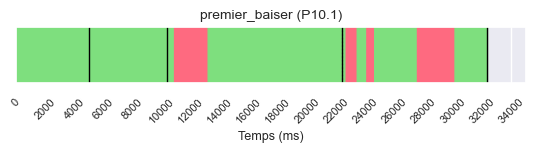

P10_1: 42699it [00:00, 45890.28it/s] 

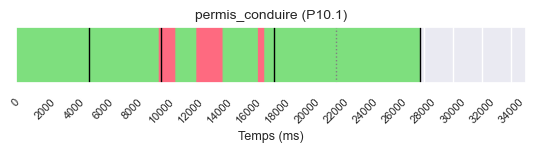

P10_1: 107709it [00:01, 93411.14it/s]

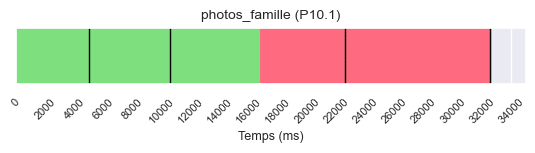

P10_1: 177797it [00:02, 113819.69it/s]

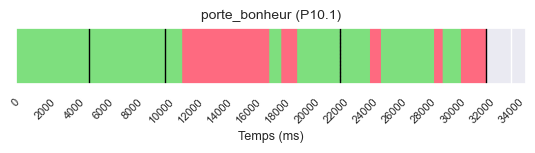

P10_1: 197414it [00:02, 55813.22it/s] 

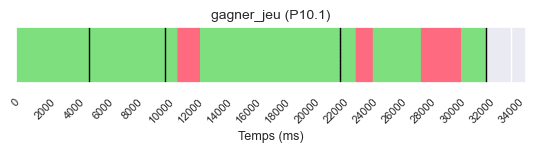

P10_1: 261010it [00:03, 79878.09it/s]

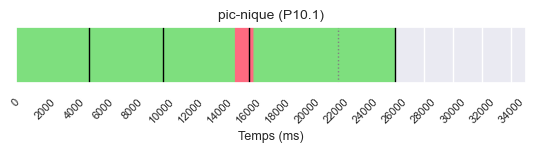

P10_1: 326120it [00:04, 94976.95it/s]

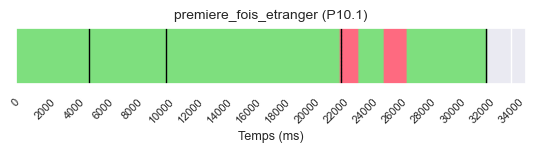

P10_1: 393979it [00:05, 104558.46it/s]

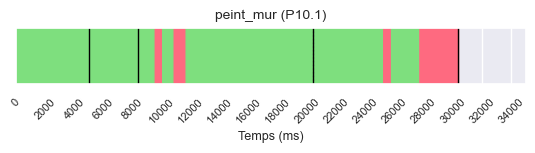

P10_1: 438748it [00:06, 73722.52it/s] 

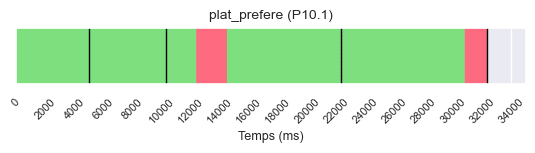

P10_1: 474526it [00:07, 63427.38it/s]

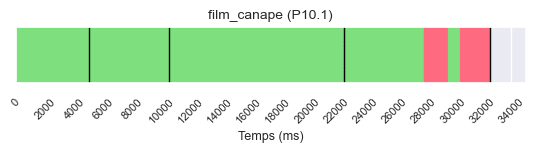

P10_1: 534550it [00:07, 89938.16it/s]

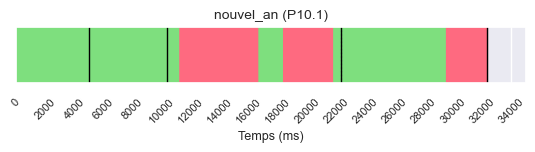

P10_1: 594276it [00:08, 95484.93it/s]

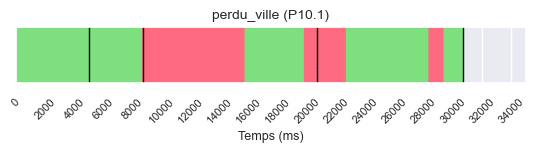

P10_1: 638180it [00:08, 71221.46it/s]
P10_2: 19626it [00:00, 195786.39it/s]

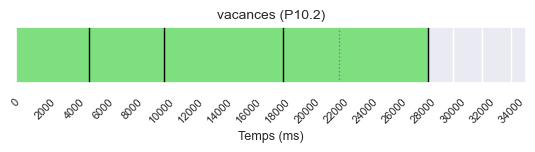

P10_2: 65873it [00:00, 106690.36it/s]

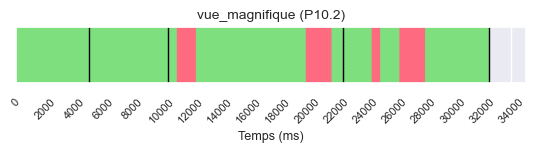

P10_2: 136611it [00:01, 92315.48it/s]

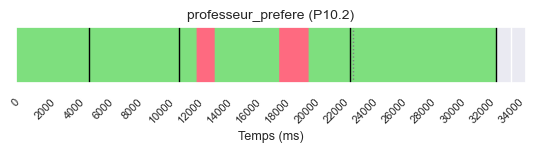

P10_2: 183762it [00:02, 77510.04it/s]

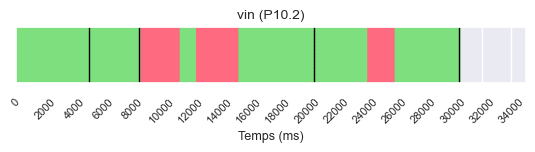

P10_2: 230401it [00:03, 82295.78it/s]

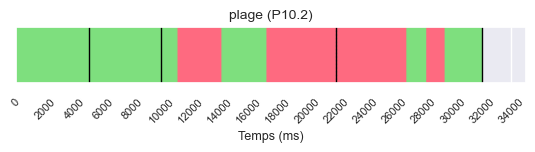

P10_2: 295453it [00:04, 88250.66it/s]

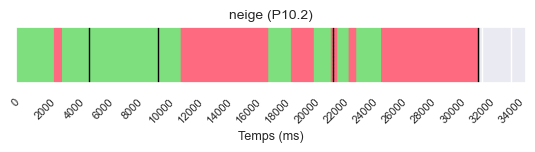

P10_2: 337187it [00:05, 58662.37it/s]

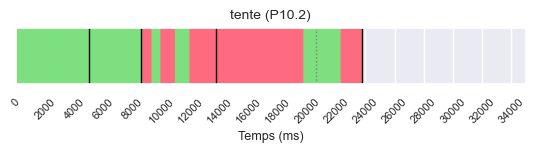

P10_2: 405083it [00:06, 78527.89it/s]

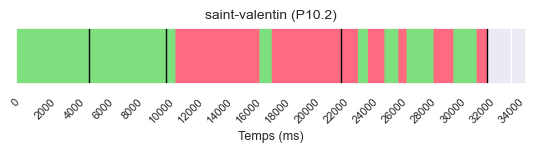

P10_2: 442190it [00:07, 62644.90it/s]

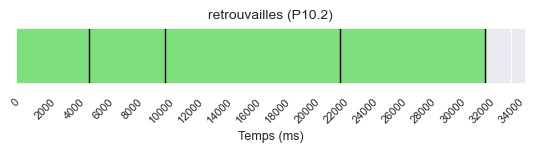

P10_2: 502634it [00:07, 89850.11it/s]

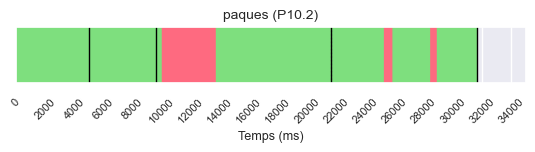

P10_2: 519352it [00:08, 60528.90it/s]

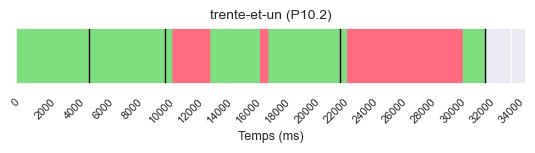

P10_2: 560048it [00:09, 57791.01it/s]

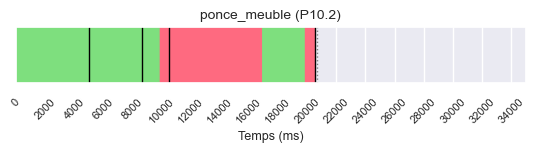

P10_2: 602287it [00:09, 62002.76it/s]
P10_3: 19177it [00:00, 191717.16it/s]

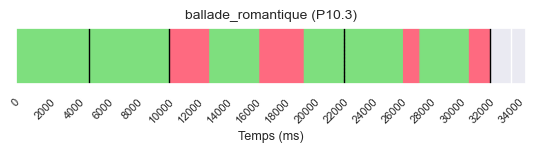

P10_3: 61574it [00:00, 102961.40it/s]

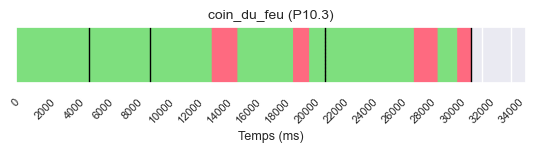

P10_3: 93291it [00:01, 53140.01it/s] 

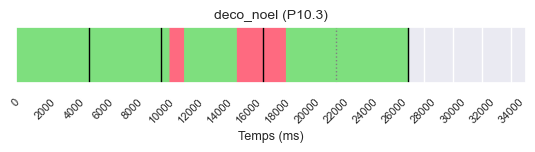

P10_3: 133176it [00:02, 58191.48it/s]

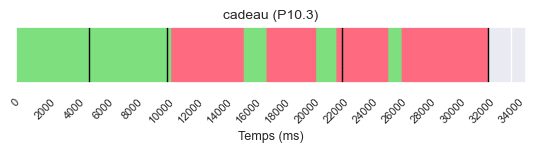

P10_3: 195492it [00:03, 70629.68it/s]

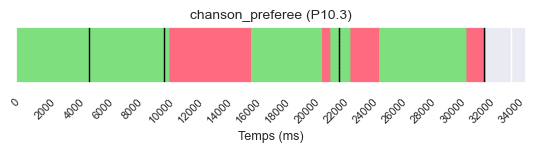

P10_3: 256236it [00:04, 75945.52it/s]

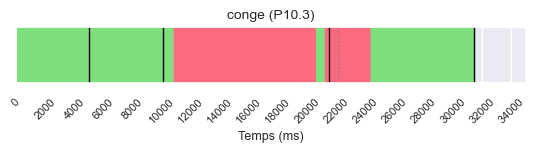

P10_3: 301508it [00:05, 68512.01it/s]

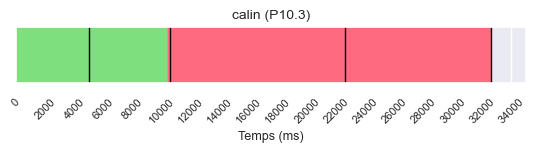

P10_3: 338356it [00:05, 72469.28it/s]

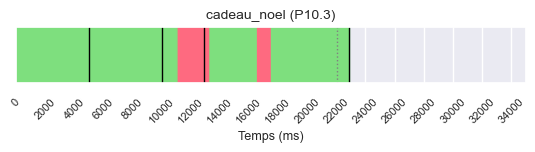

P10_3: 381023it [00:06, 76246.11it/s]

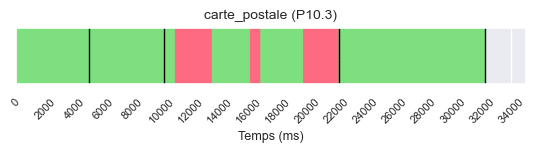

P10_3: 446888it [00:07, 78615.49it/s]

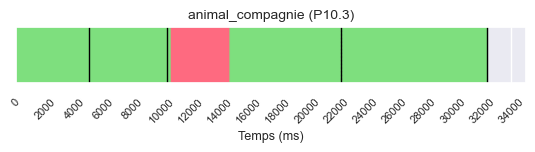

P10_3: 485593it [00:08, 75411.41it/s]

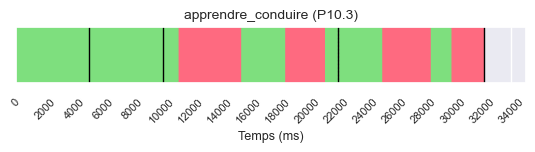

P10_3: 527430it [00:08, 71202.50it/s]

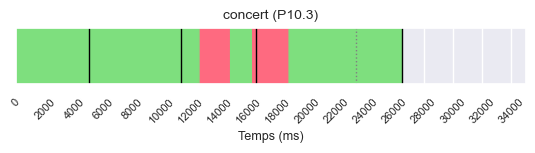

P10_3: 575565it [00:09, 58962.18it/s]
P10_4: 22152it [00:00, 219456.61it/s]

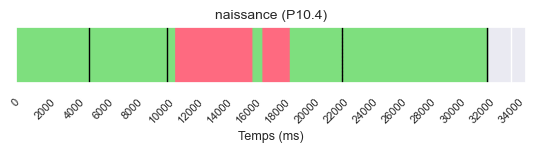

P10_4: 65076it [00:01, 62299.11it/s] 

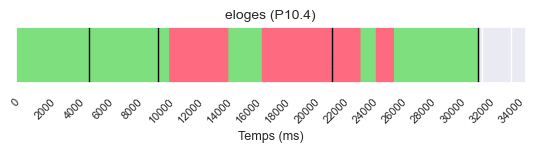

P10_4: 104556it [00:02, 54203.22it/s]

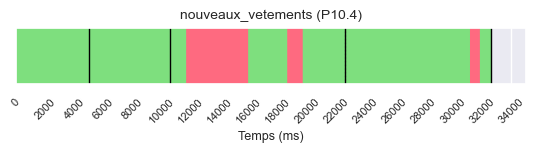

P10_4: 167810it [00:02, 77283.68it/s]

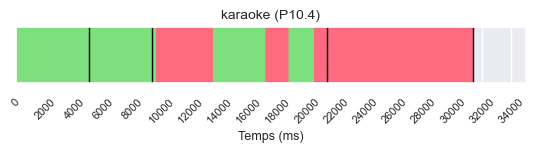

P10_4: 185422it [00:03, 44795.09it/s]

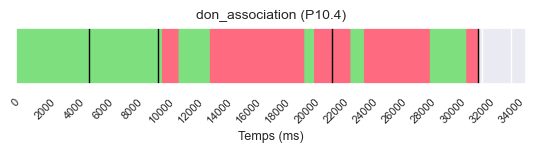

P10_4: 227685it [00:04, 50801.51it/s]

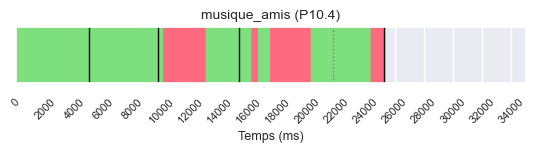

P10_4: 289844it [00:05, 77035.70it/s]

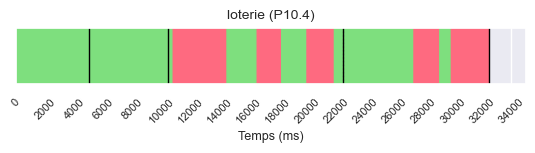

P10_4: 333323it [00:06, 65275.54it/s]

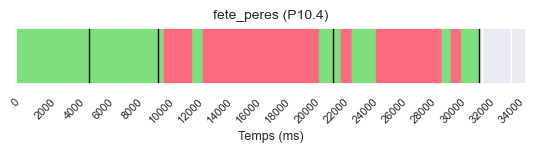

P10_4: 349277it [00:06, 45369.38it/s]

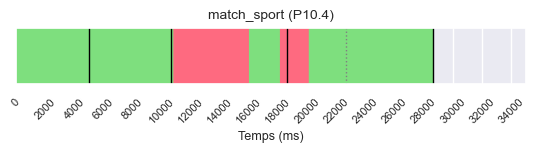

P10_4: 393349it [00:07, 55871.30it/s]

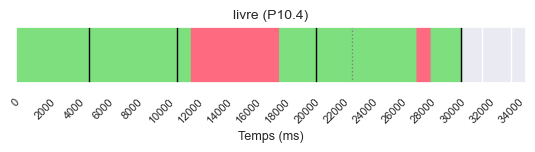

P10_4: 466531it [00:08, 88857.67it/s]

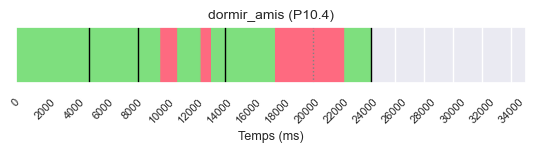

P10_4: 510871it [00:09, 71192.17it/s]

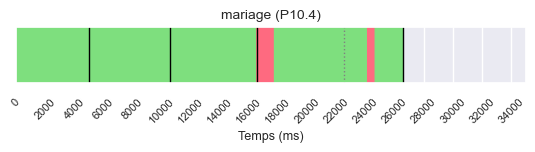

P10_4: 567707it [00:10, 55485.40it/s]
P01_1: 18041it [00:00, 167840.63it/s]

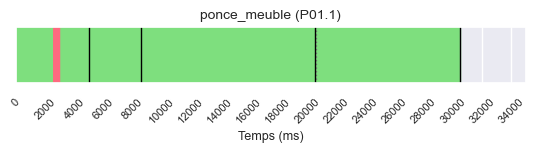

P01_1: 98053it [00:00, 169724.18it/s]

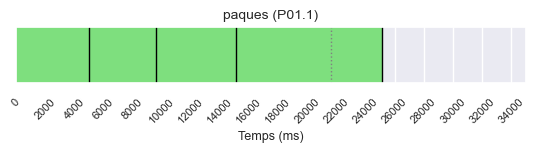

P01_1: 181682it [00:01, 157090.05it/s]

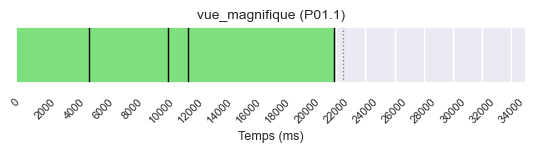

P01_1: 266776it [00:02, 161602.02it/s]

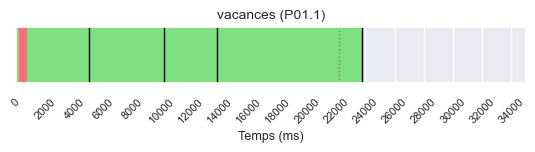

P01_1: 323843it [00:02, 145362.23it/s]

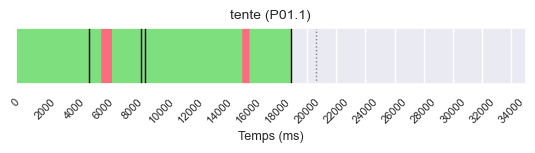

P01_1: 383243it [00:03, 138706.03it/s]

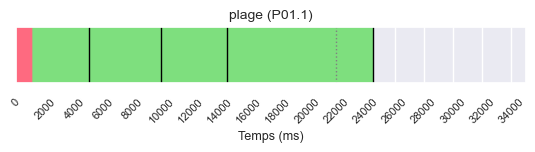

P01_1: 471126it [00:03, 145714.93it/s]

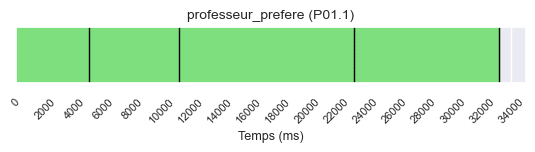

P01_1: 599949it [00:04, 198443.49it/s]

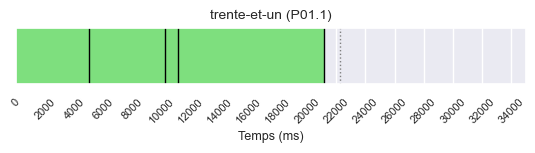

P01_1: 662494it [00:05, 153905.85it/s]

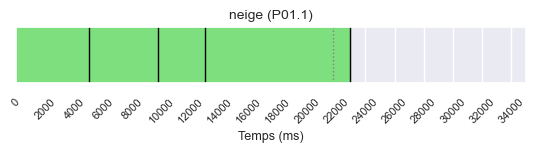

P01_1: 741374it [00:05, 149402.52it/s]

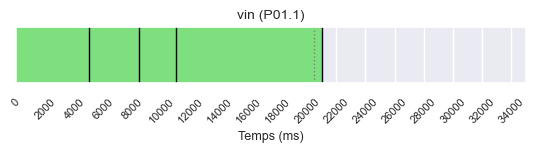

P01_1: 835013it [00:06, 176899.47it/s]

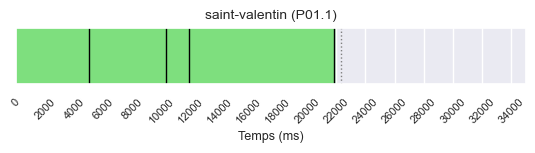

P01_1: 926934it [00:07, 174219.78it/s]

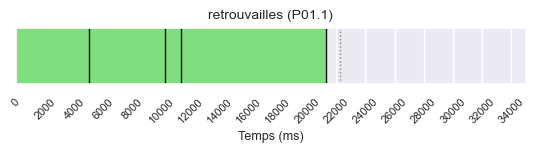

P01_1: 1027590it [00:07, 134071.78it/s]
P01_2: 21873it [00:00, 216692.08it/s]

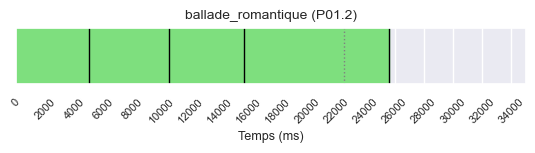

P01_2: 74129it [00:00, 125814.16it/s]

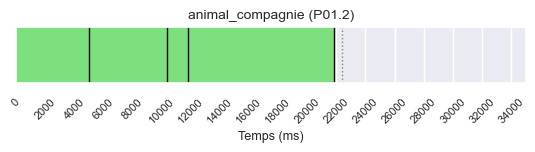

P01_2: 133015it [00:01, 124135.10it/s]

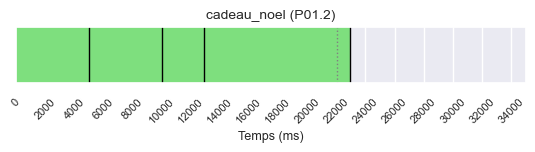

P01_2: 189161it [00:01, 123736.12it/s]

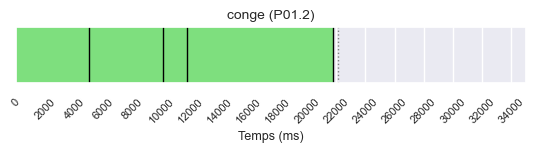

P01_2: 307801it [00:02, 185386.18it/s]

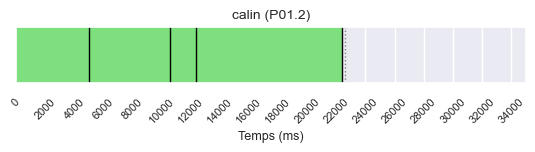

P01_2: 368233it [00:02, 155171.62it/s]

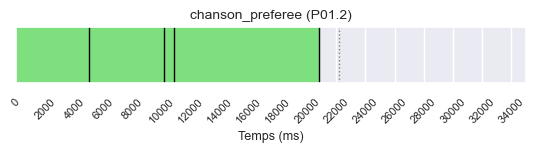

P01_2: 428234it [00:03, 136169.62it/s]

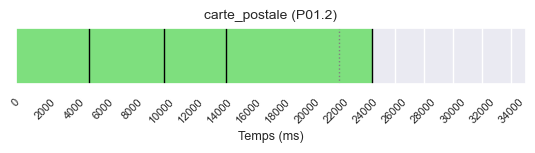

P01_2: 558181it [00:04, 202011.09it/s]

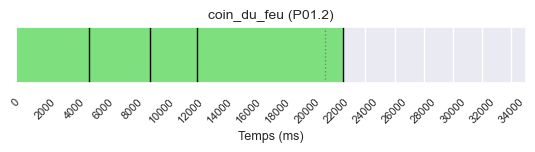

P01_2: 657547it [00:04, 194666.58it/s]

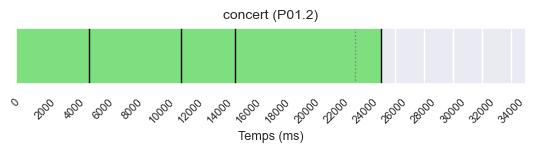

P01_2: 746604it [00:05, 176106.20it/s]

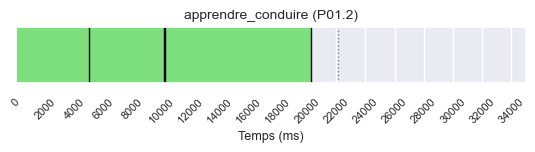

P01_2: 872947it [00:06, 203886.46it/s]

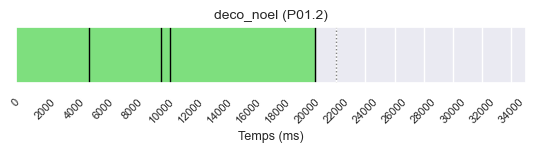

P01_2: 927111it [00:06, 150758.76it/s]

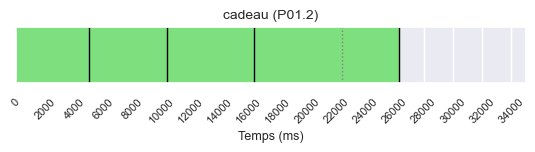

P01_2: 987539it [00:07, 134829.31it/s]
P01_3: 0it [00:00, ?it/s]

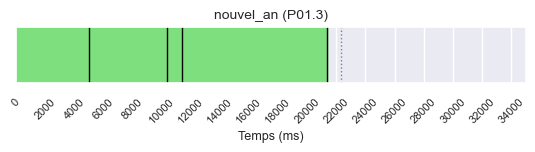

P01_3: 56596it [00:00, 131735.52it/s]

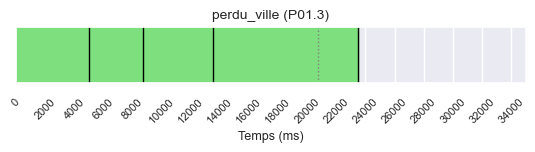

P01_3: 141268it [00:01, 143355.99it/s]

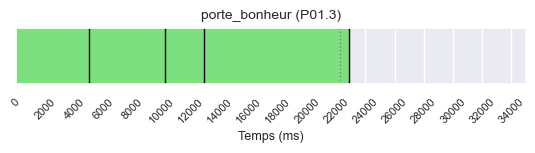

P01_3: 188115it [00:01, 120586.77it/s]

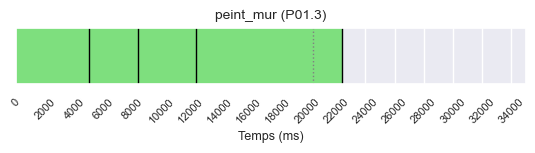

P01_3: 240021it [00:02, 119224.99it/s]

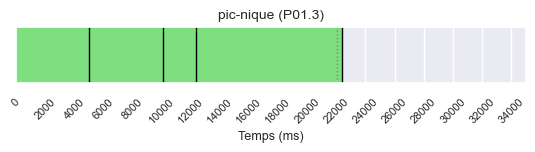

P01_3: 294581it [00:02, 118100.11it/s]

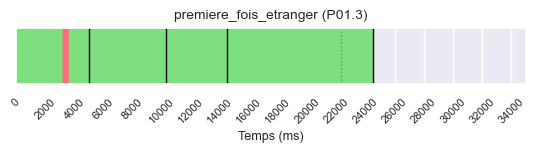

P01_3: 377711it [00:03, 145555.38it/s]

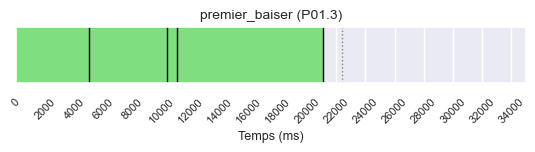

P01_3: 457686it [00:04, 152071.57it/s]

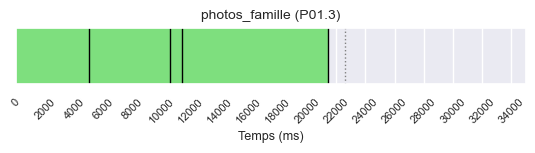

P01_3: 514281it [00:04, 129461.59it/s]

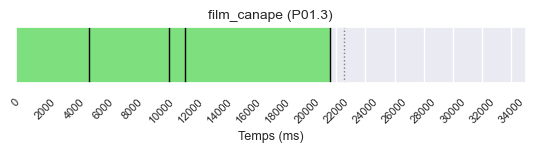

P01_3: 577919it [00:05, 136510.00it/s]

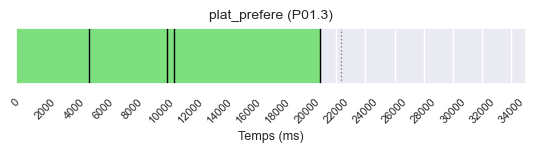

P01_3: 632887it [00:05, 130300.42it/s]

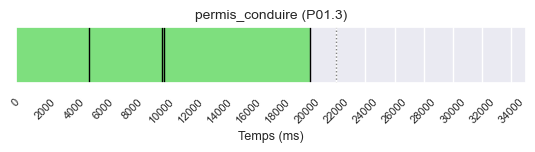

P01_3: 684524it [00:06, 122842.36it/s]

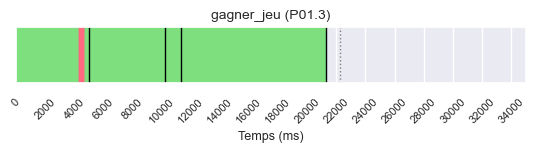

P01_3: 742385it [00:06, 111472.51it/s]
P01_4: 0it [00:00, ?it/s]

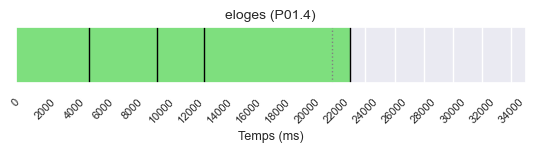

P01_4: 80815it [00:00, 171407.18it/s]

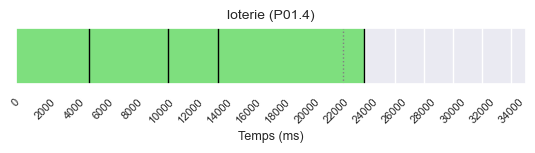

P01_4: 167899it [00:01, 150445.98it/s]

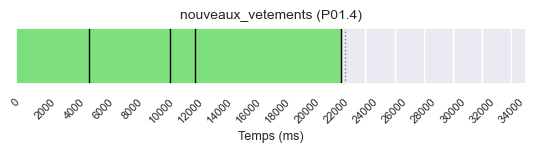

P01_4: 220337it [00:01, 128647.95it/s]

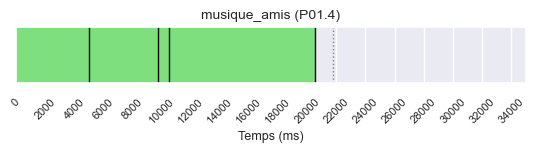

P01_4: 241576it [00:02, 93271.06it/s] 

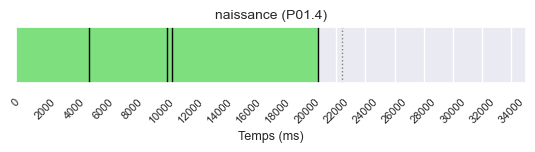

P01_4: 320062it [00:02, 124890.82it/s]

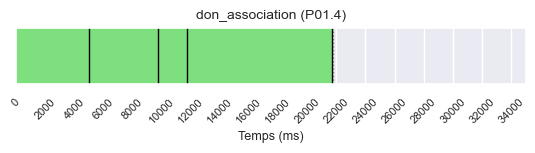

P01_4: 367585it [00:03, 115781.21it/s]

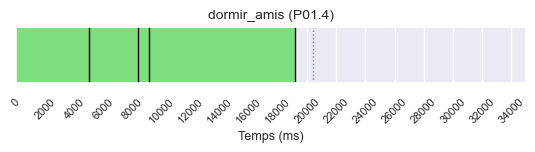

P01_4: 414631it [00:03, 111649.77it/s]

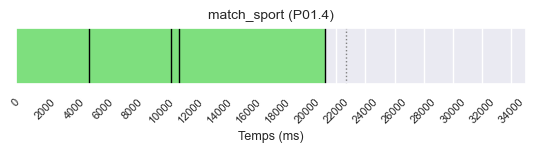

P01_4: 467254it [00:04, 117034.18it/s]

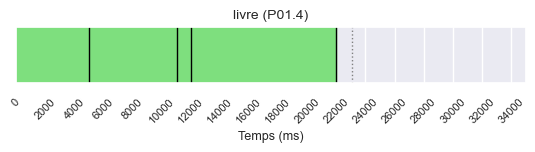

P01_4: 515124it [00:04, 111615.02it/s]

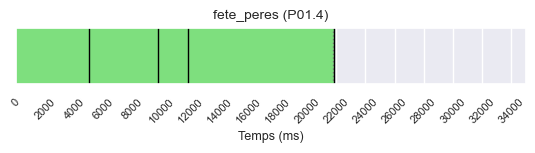

P01_4: 569820it [00:05, 117621.94it/s]

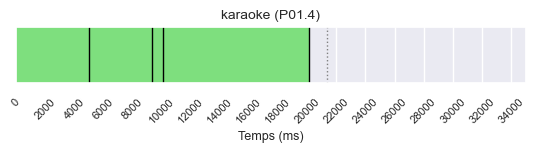

P01_4: 617084it [00:06, 108179.96it/s]

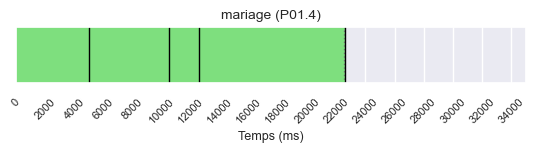

P01_4: 662087it [00:06, 101795.53it/s]
P11_1: 22934it [00:00, 227262.28it/s]

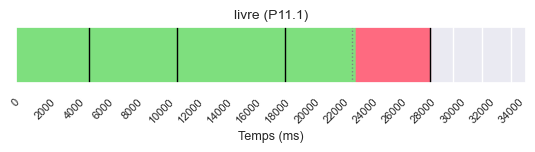

P11_1: 45661it [00:00, 74090.13it/s] 

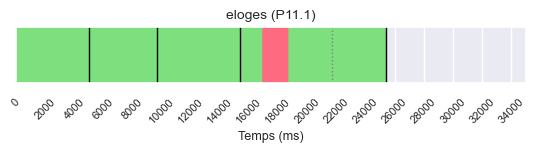

P11_1: 108504it [00:01, 106439.82it/s]

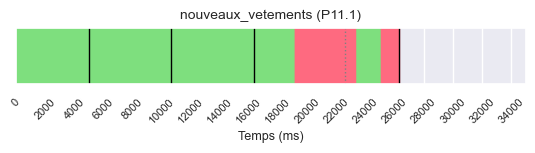

P11_1: 154844it [00:01, 101287.26it/s]

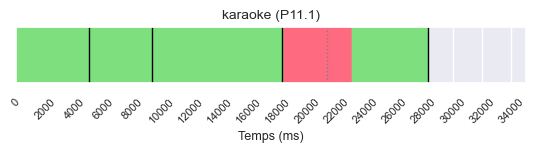

P11_1: 202424it [00:02, 101078.59it/s]

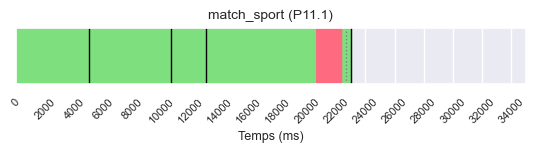

P11_1: 249617it [00:02, 100592.06it/s]

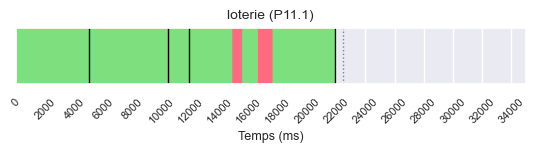

P11_1: 292220it [00:03, 96781.15it/s] 

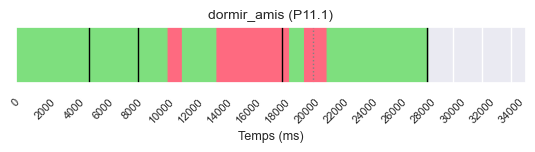

P11_1: 334931it [00:04, 74413.88it/s]

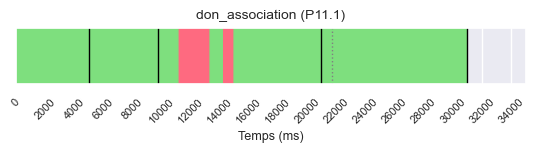

P11_1: 380593it [00:05, 64604.46it/s]

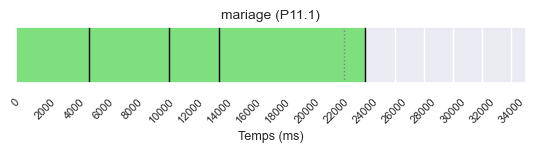

P11_1: 426166it [00:05, 75120.52it/s]

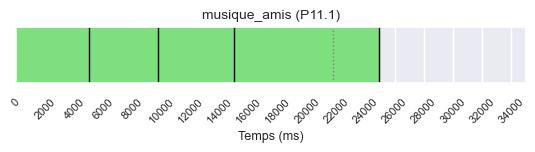

P11_1: 467936it [00:06, 70118.26it/s]

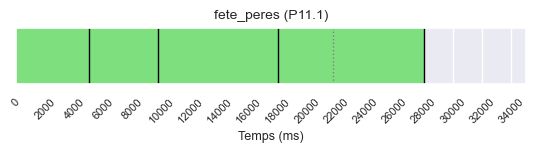

P11_1: 506965it [00:07, 72058.37it/s]

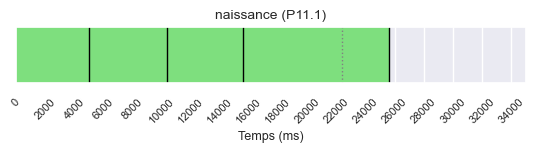

P11_1: 547536it [00:07, 70343.12it/s]
P11_2: 9677it [00:00, 76441.04it/s]

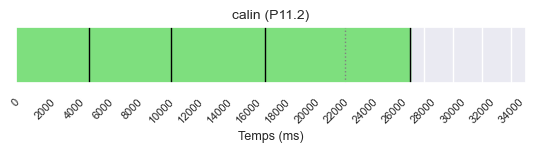

P11_2: 53689it [00:00, 98333.70it/s]

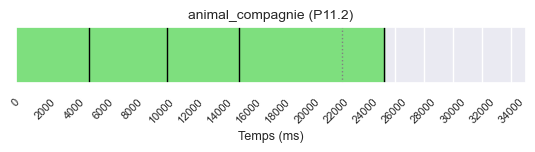

P11_2: 119899it [00:01, 109799.80it/s]

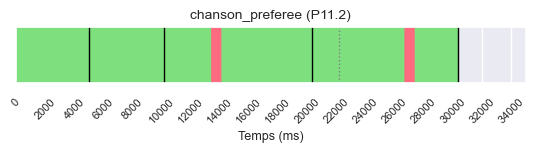

P11_2: 155852it [00:02, 73337.06it/s] 

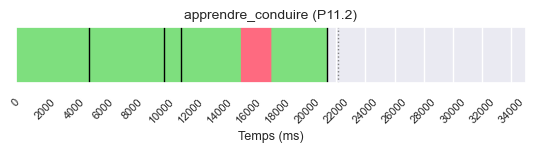

P11_2: 210806it [00:02, 95887.87it/s]

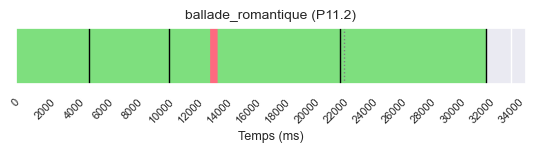

P11_2: 252206it [00:03, 78565.56it/s]

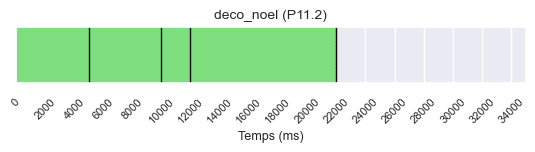

P11_2: 294896it [00:04, 84019.08it/s]

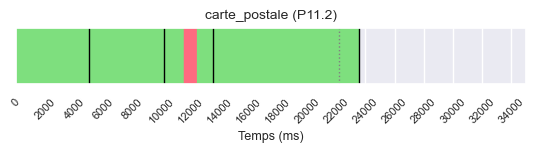

P11_2: 339893it [00:04, 81714.18it/s]

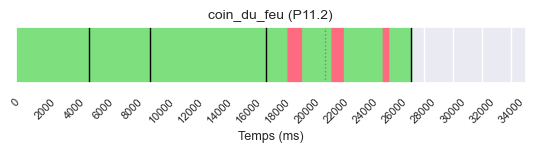

P11_2: 386707it [00:05, 88120.97it/s]

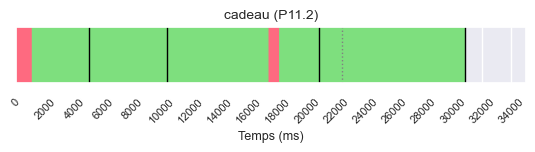

P11_2: 422146it [00:06, 69501.38it/s]

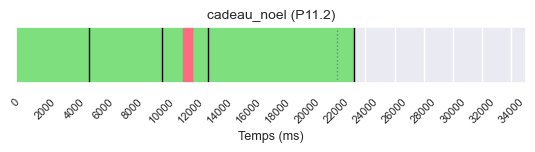

P11_2: 463389it [00:06, 69145.66it/s]

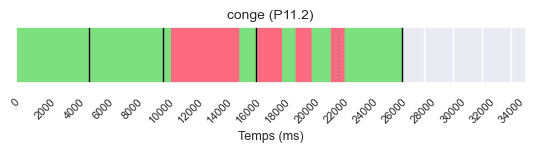

P11_2: 514727it [00:07, 73588.83it/s]

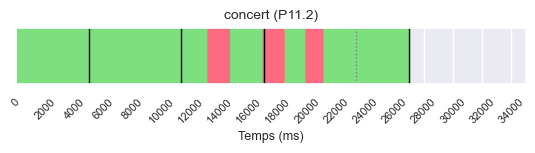

P11_2: 550959it [00:08, 65357.07it/s]
P11_3: 14507it [00:00, 144285.12it/s]

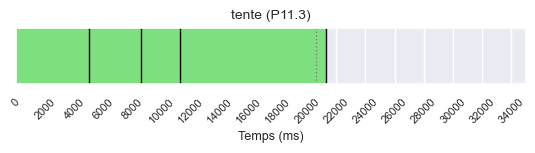

P11_3: 52048it [00:00, 98764.51it/s] 

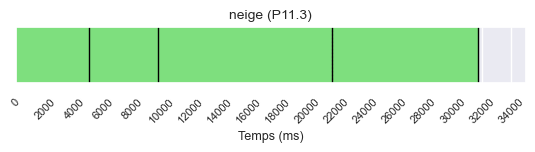

P11_3: 90583it [00:01, 79821.62it/s]

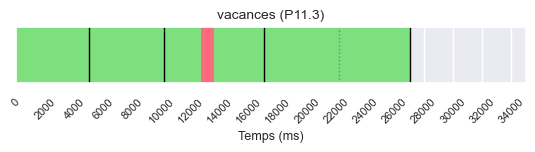

P11_3: 132690it [00:01, 72337.96it/s]

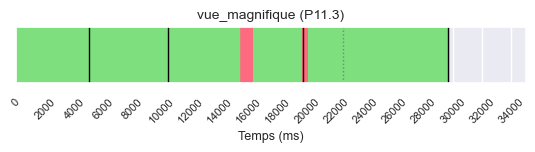

P11_3: 187571it [00:03, 63275.66it/s]

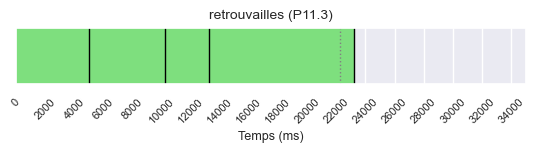

P11_3: 222471it [00:03, 71547.96it/s]

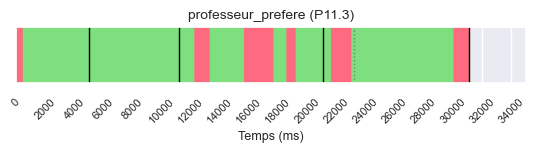

P11_3: 236106it [00:04, 36618.53it/s]

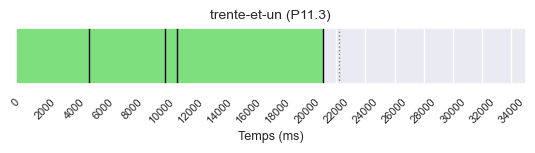

P11_3: 279015it [00:05, 56410.26it/s]

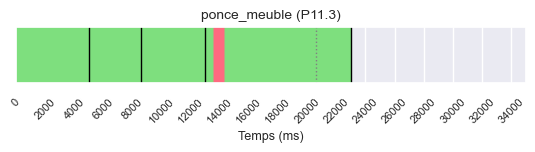

P11_3: 325400it [00:05, 75529.39it/s]

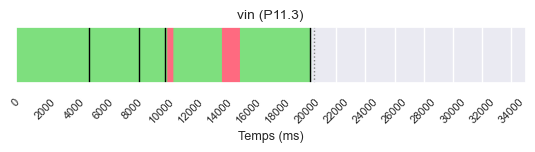

P11_3: 362520it [00:06, 79328.36it/s]

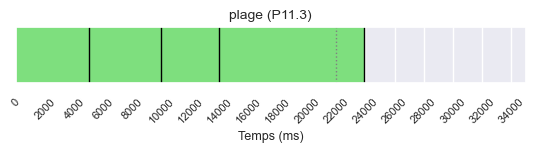

P11_3: 401222it [00:06, 83199.15it/s]

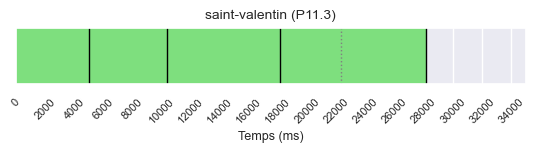

P11_3: 437784it [00:07, 81657.74it/s]

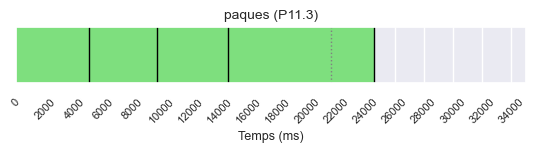

P11_3: 459138it [00:07, 60724.17it/s]
P11_4: 13333it [00:00, 126386.31it/s]

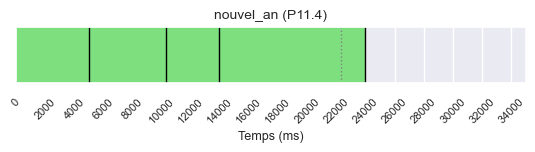

P11_4: 54579it [00:00, 102281.38it/s]

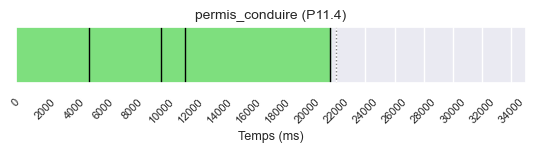

P11_4: 119612it [00:01, 106884.90it/s]

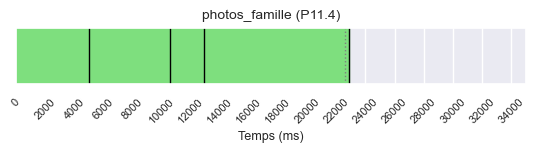

P11_4: 160568it [00:01, 99020.78it/s] 

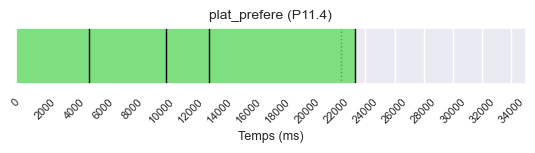

P11_4: 196984it [00:02, 88107.40it/s]

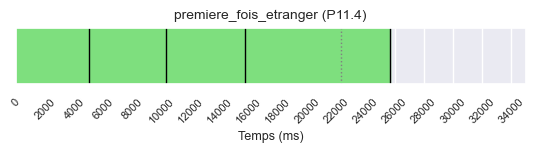

P11_4: 235373it [00:02, 86720.31it/s]

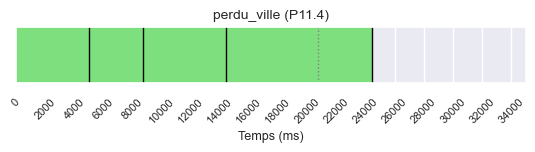

P11_4: 269551it [00:03, 81090.34it/s]

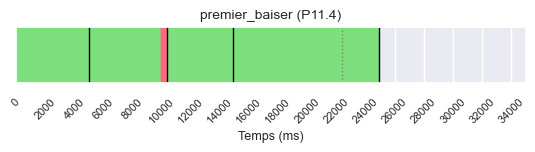

P11_4: 302351it [00:03, 78190.05it/s]

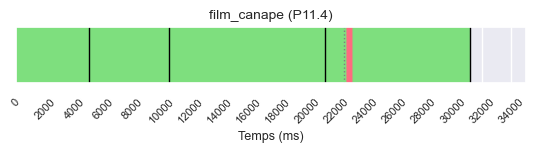

P11_4: 341619it [00:04, 83267.80it/s]

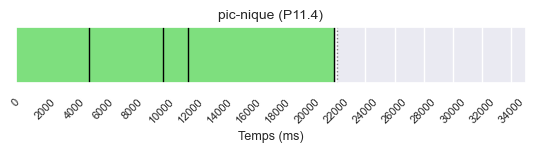

P11_4: 381964it [00:04, 85695.96it/s]

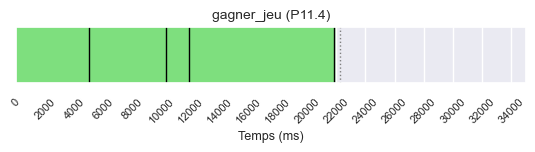

P11_4: 419358it [00:05, 85686.67it/s]

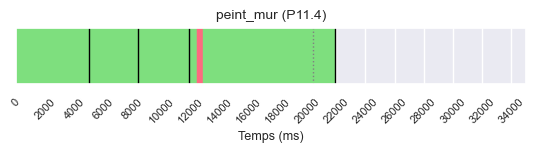

P11_4: 453274it [00:06, 80361.07it/s]

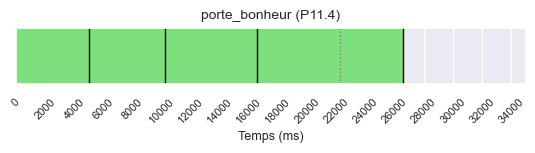

P11_4: 476016it [00:06, 73316.50it/s]
P12_1: 20914it [00:00, 196166.28it/s]

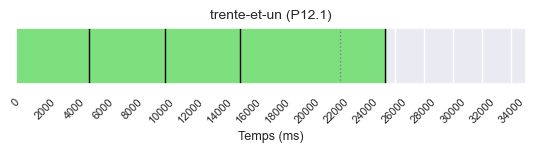

P12_1: 61497it [00:00, 102600.96it/s]

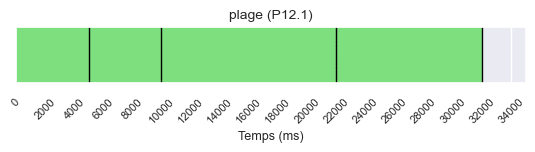

P12_1: 97077it [00:01, 77191.35it/s] 

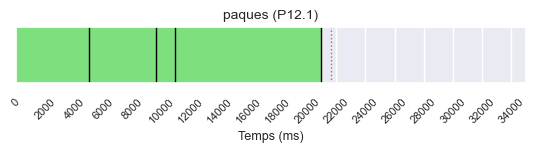

P12_1: 138169it [00:01, 82050.08it/s]

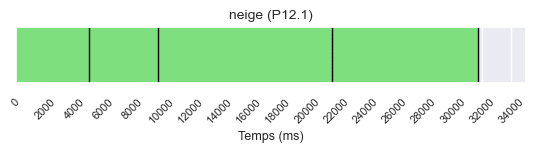

P12_1: 190195it [00:02, 92985.13it/s]

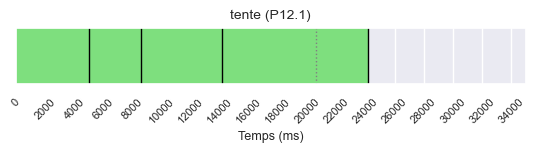

P12_1: 280811it [00:03, 140452.50it/s]

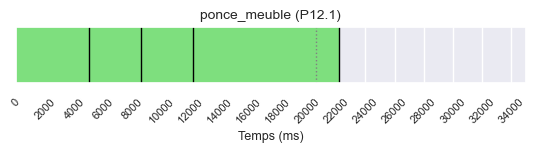

P12_1: 318925it [00:03, 104946.28it/s]

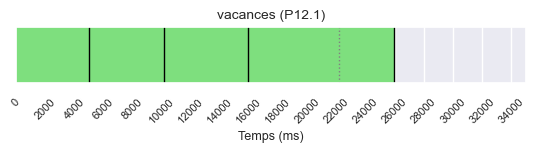

P12_1: 358998it [00:04, 98905.94it/s] 

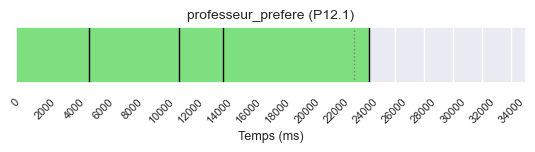

P12_1: 399833it [00:04, 93673.48it/s]

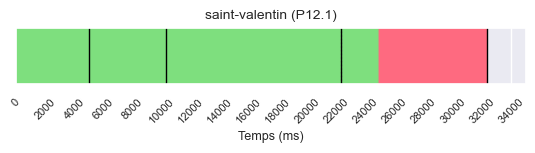

P12_1: 435186it [00:05, 83050.84it/s]

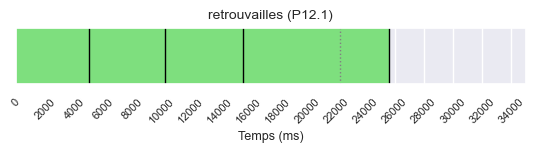

P12_1: 489389it [00:05, 97372.30it/s]

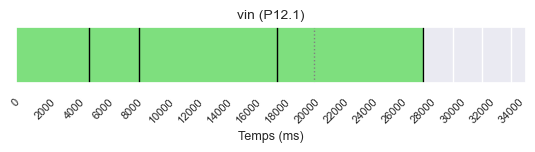

P12_1: 529829it [00:06, 93593.56it/s]

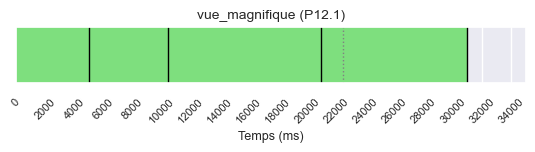

P12_1: 585230it [00:07, 83538.89it/s]
P12_2: 17582it [00:00, 174179.41it/s]

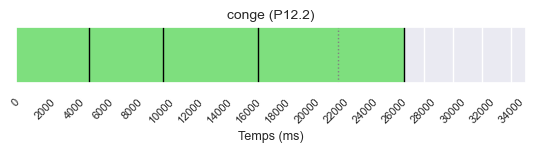

P12_2: 56954it [00:00, 97978.55it/s] 

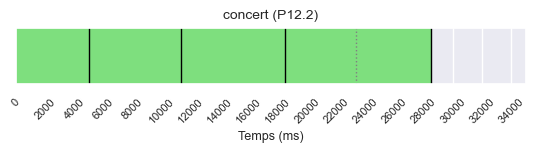

P12_2: 97113it [00:01, 81958.29it/s]

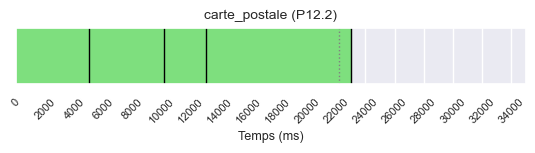

P12_2: 132104it [00:01, 80408.84it/s]

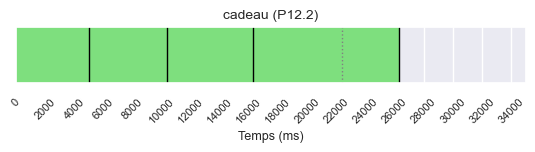

P12_2: 168784it [00:02, 82674.85it/s]

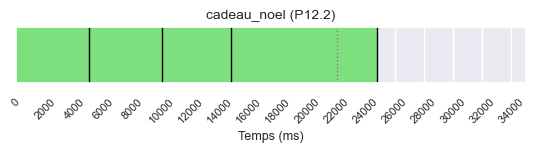

P12_2: 204296it [00:02, 82394.16it/s]

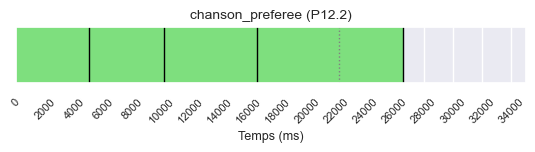

P12_2: 242734it [00:03, 84487.60it/s]

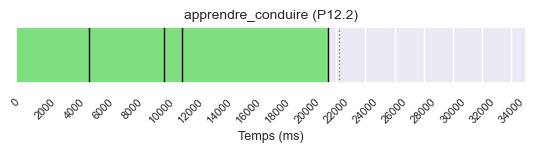

P12_2: 285836it [00:03, 91541.95it/s]

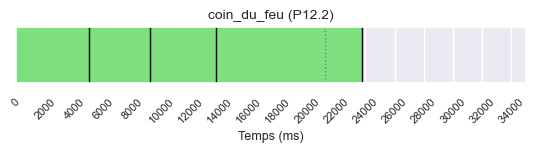

P12_2: 326870it [00:04, 91079.27it/s]

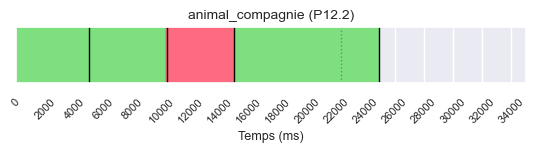

P12_2: 384454it [00:04, 97194.44it/s]

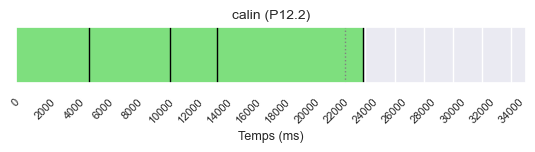

P12_2: 421213it [00:05, 92060.04it/s]

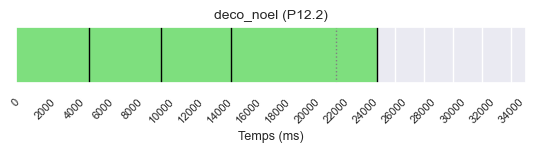

P12_2: 459686it [00:05, 90594.77it/s]

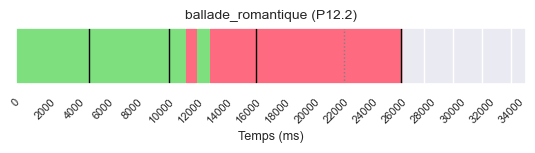

P12_2: 486582it [00:06, 70762.06it/s]
P12_3: 9916it [00:00, 98660.01it/s]

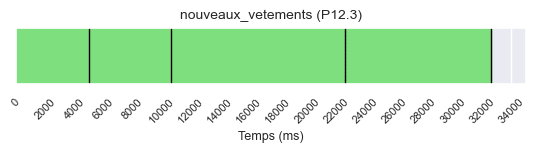

P12_3: 47482it [00:00, 85243.40it/s]

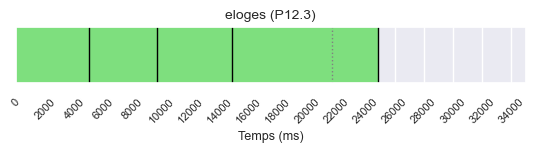

P12_3: 91739it [00:01, 86847.51it/s]

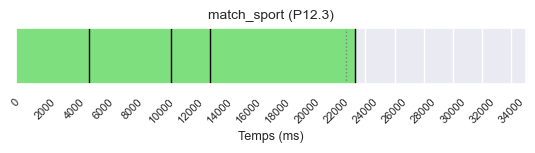

P12_3: 134981it [00:01, 89203.27it/s]

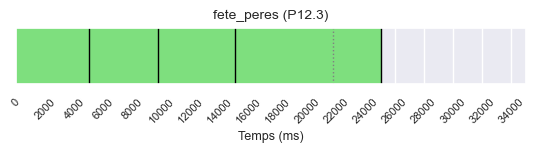

P12_3: 179381it [00:02, 92304.10it/s]

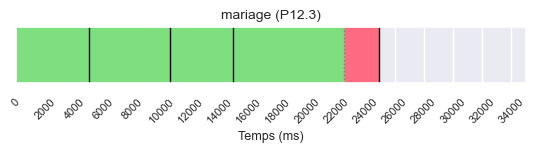

P12_3: 219077it [00:02, 88286.33it/s]

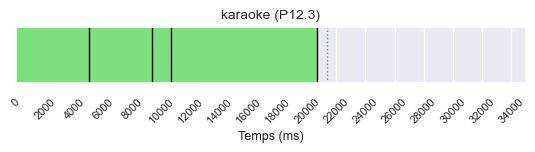

P12_3: 260072it [00:03, 89794.45it/s]

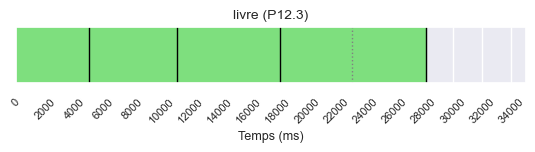

P12_3: 303773it [00:03, 90743.65it/s]

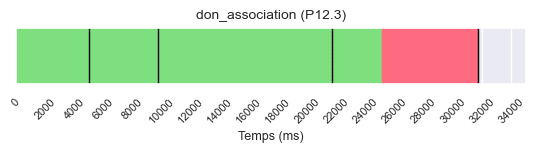

P12_3: 348399it [00:04, 91379.02it/s]

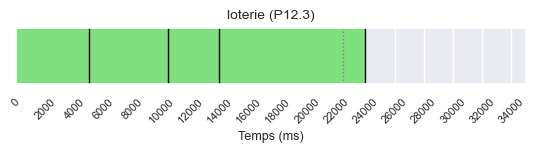

P12_3: 407746it [00:05, 103555.68it/s]

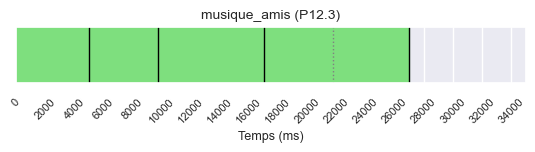

P12_3: 445217it [00:05, 92209.55it/s] 

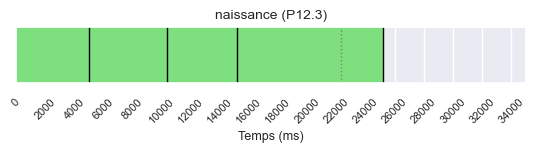

P12_3: 482581it [00:06, 87441.87it/s]

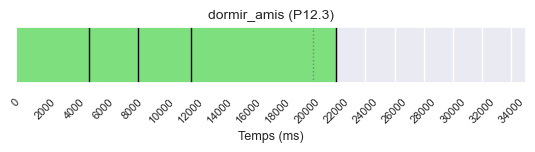

P12_3: 508578it [00:06, 76136.25it/s]
P12_4: 13004it [00:00, 129814.81it/s]

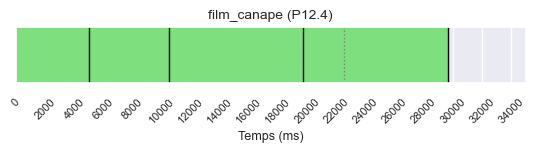

P12_4: 48910it [00:00, 86351.58it/s] 

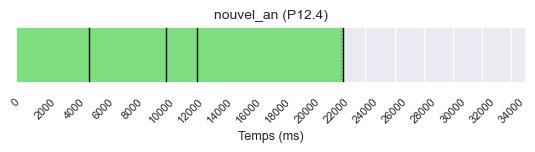

P12_4: 108174it [00:01, 98893.07it/s]

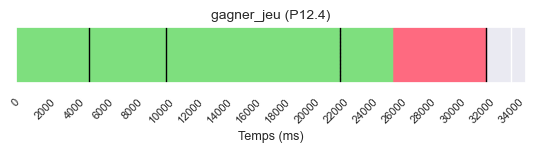

P12_4: 142149it [00:01, 85129.43it/s]

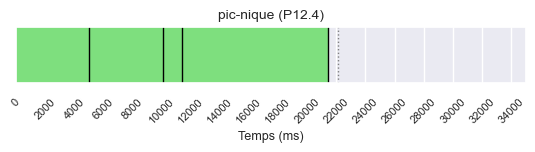

P12_4: 175996it [00:02, 77303.46it/s]

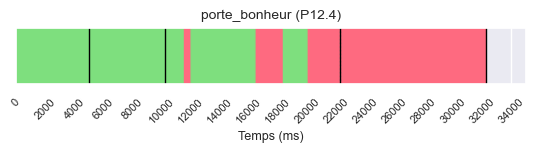

P12_4: 216255it [00:03, 65444.21it/s]

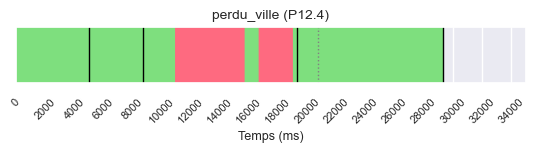

P12_4: 258664it [00:04, 56916.96it/s]

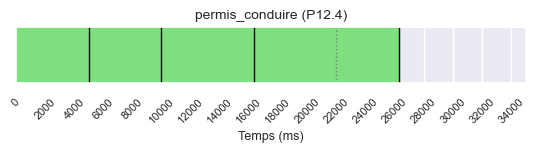

P12_4: 319701it [00:04, 81814.67it/s]

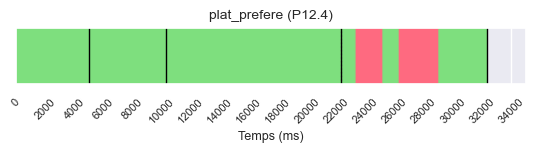

P12_4: 355935it [00:05, 81062.41it/s]

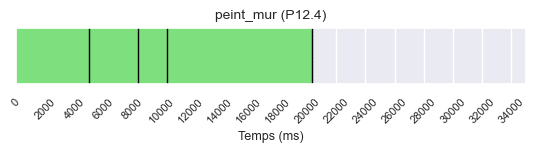

P12_4: 393101it [00:05, 82522.23it/s]

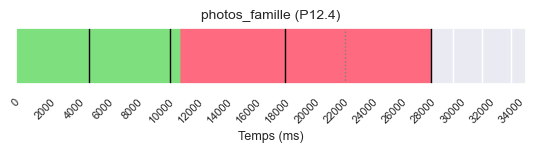

P12_4: 427884it [00:06, 68561.68it/s]

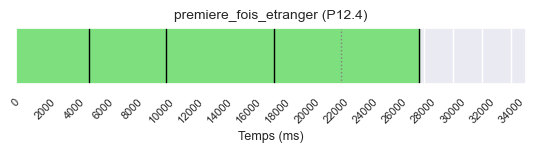

P12_4: 462898it [00:07, 72952.19it/s]

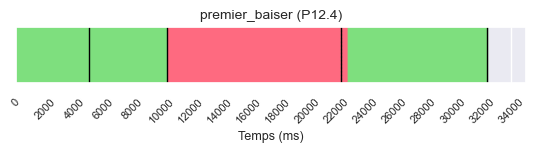

P12_4: 497060it [00:07, 64338.97it/s]
P13_1: 20308it [00:00, 202226.31it/s]

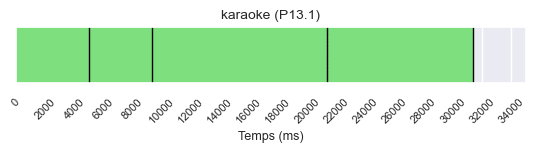

P13_1: 88909it [00:00, 132102.71it/s]

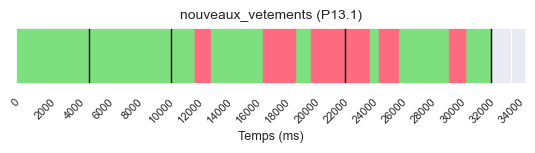

P13_1: 134142it [00:01, 64120.93it/s]

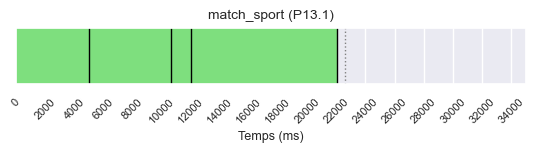

P13_1: 197611it [00:02, 89747.34it/s]

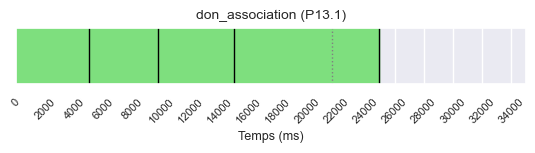

P13_1: 239338it [00:03, 92345.63it/s]

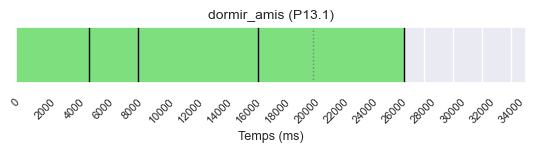

P13_1: 281902it [00:03, 91513.29it/s]

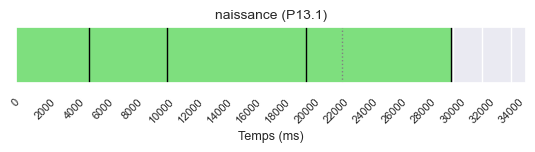

P13_1: 326905it [00:04, 92563.55it/s]

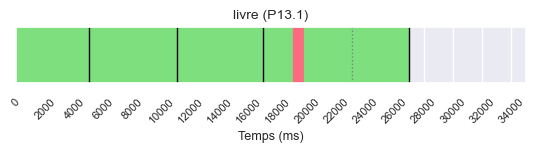

P13_1: 397605it [00:04, 118463.24it/s]

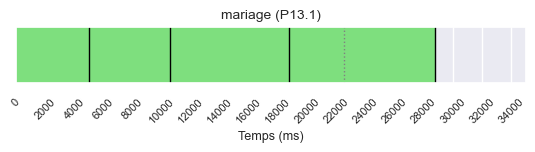

P13_1: 469926it [00:05, 133876.46it/s]

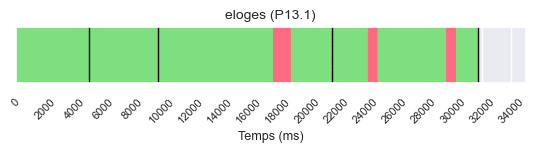

P13_1: 510202it [00:06, 88088.38it/s] 

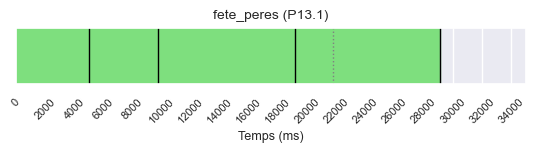

P13_1: 546842it [00:06, 83391.83it/s]

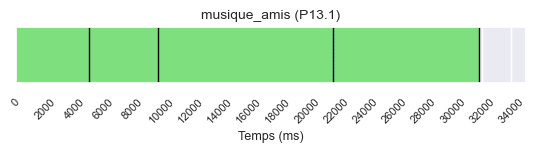

P13_1: 605521it [00:07, 99545.80it/s]

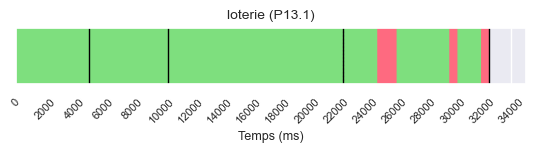

P13_1: 611653it [00:07, 78567.97it/s]
P13_2: 17712it [00:00, 176471.81it/s]

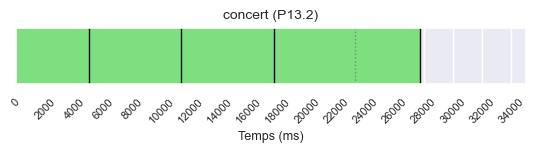

P13_2: 55068it [00:00, 90373.06it/s] 

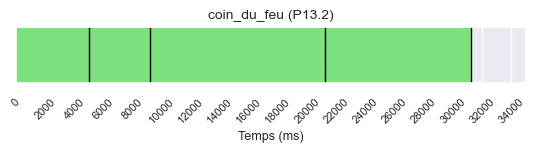

P13_2: 90110it [00:01, 73064.85it/s]

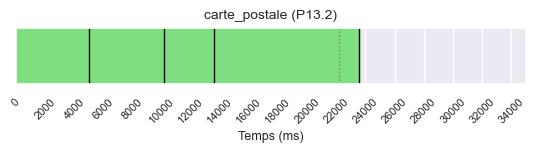

P13_2: 128166it [00:01, 81297.44it/s]

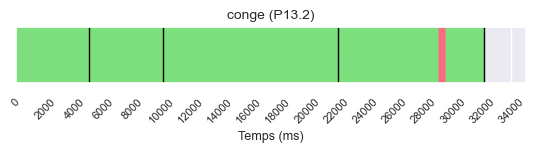

P13_2: 193835it [00:02, 109360.88it/s]

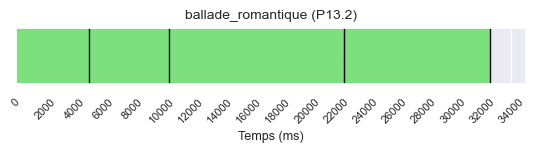

P13_2: 235338it [00:03, 92497.38it/s] 

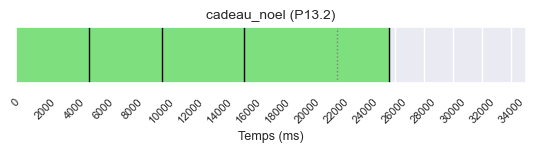

P13_2: 274117it [00:03, 85277.02it/s]

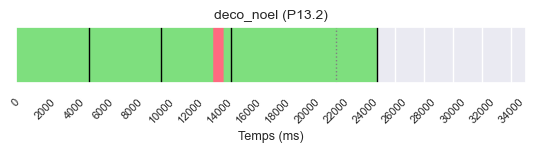

P13_2: 314942it [00:04, 71728.48it/s]

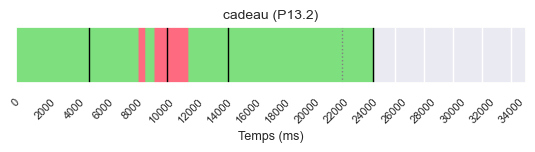

P13_2: 353989it [00:04, 77918.04it/s]

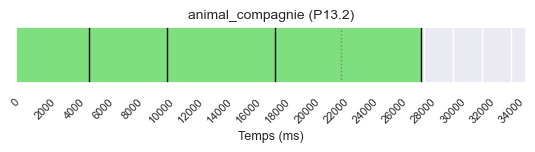

P13_2: 393949it [00:05, 83907.40it/s]

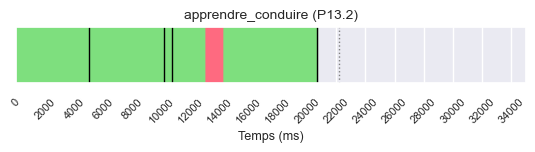

P13_2: 457310it [00:06, 108333.55it/s]

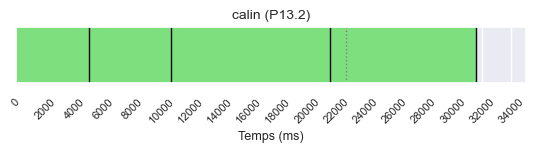

P13_2: 513370it [00:06, 95632.97it/s] 

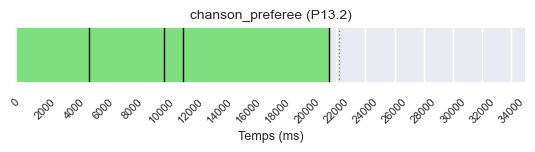

P13_2: 540362it [00:07, 74201.18it/s]
P13_3: 12898it [00:00, 128661.10it/s]

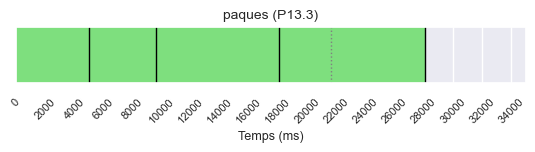

P13_3: 48628it [00:00, 83807.14it/s] 

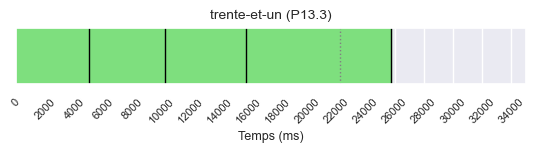

P13_3: 104227it [00:01, 86026.19it/s]

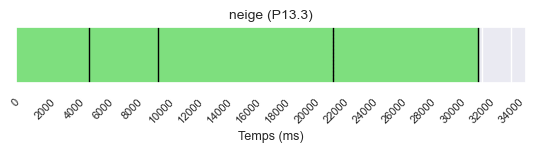

P13_3: 141166it [00:01, 84287.91it/s]

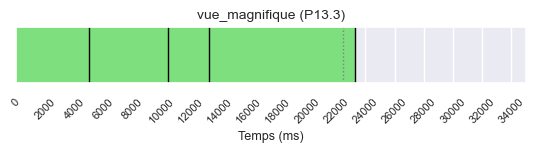

P13_3: 172688it [00:02, 75965.53it/s]

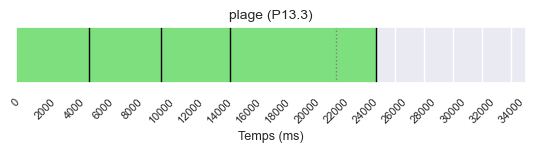

P13_3: 206360it [00:03, 73108.54it/s]

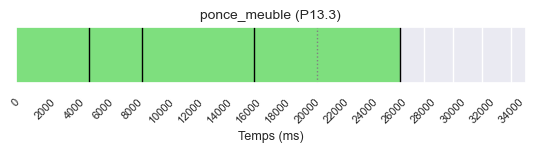

P13_3: 245570it [00:03, 83316.29it/s]

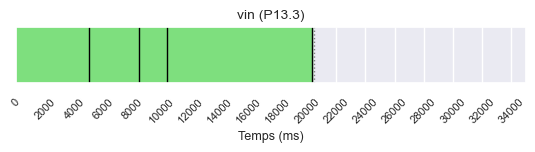

P13_3: 287012it [00:04, 84996.98it/s]

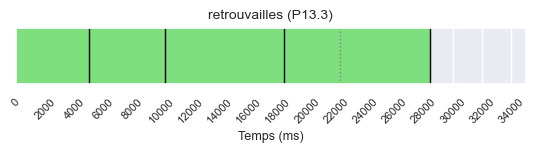

P13_3: 347412it [00:04, 103269.93it/s]

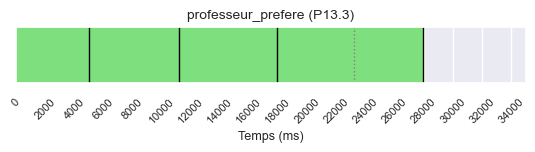

P13_3: 409684it [00:05, 112602.88it/s]

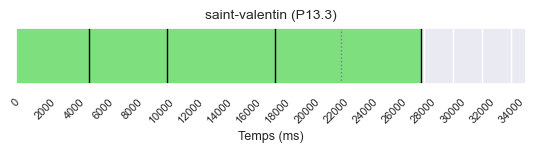

P13_3: 426869it [00:05, 76665.30it/s] 

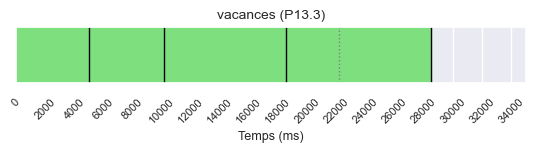

P13_3: 464866it [00:06, 81403.84it/s]

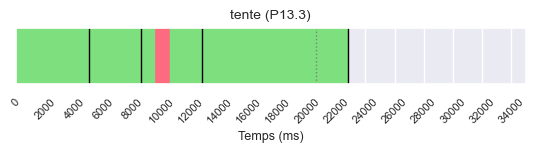

P13_3: 507261it [00:06, 72742.92it/s]
P13_4: 10411it [00:00, 103840.74it/s]

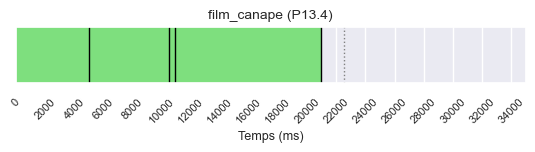

P13_4: 42170it [00:00, 75591.65it/s] 

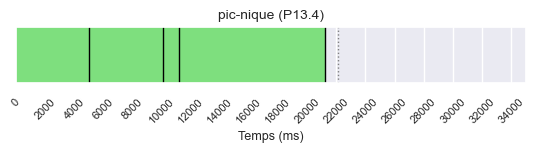

P13_4: 96720it [00:01, 90010.55it/s]

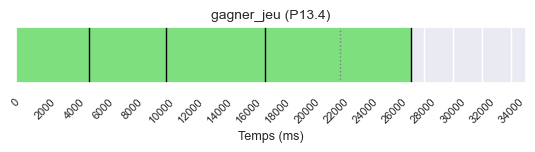

P13_4: 127493it [00:01, 76794.82it/s]

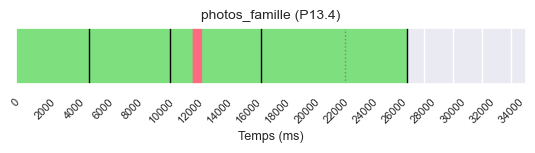

P13_4: 176795it [00:02, 78642.30it/s]

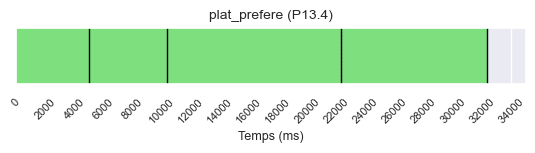

P13_4: 190147it [00:03, 56338.14it/s]

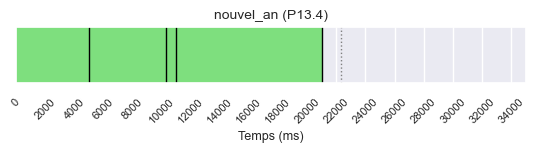

P13_4: 231481it [00:03, 71554.63it/s]

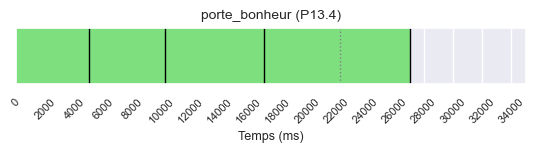

P13_4: 258992it [00:04, 65926.19it/s]

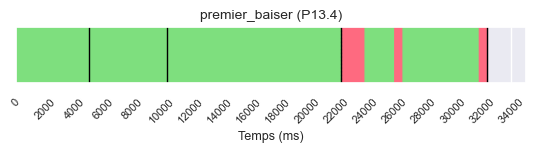

P13_4: 270383it [00:04, 40420.84it/s]

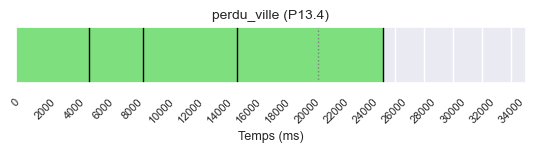

P13_4: 329786it [00:05, 80841.49it/s]

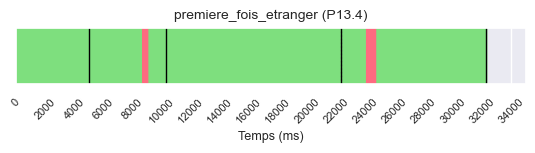

P13_4: 370983it [00:05, 84421.75it/s]

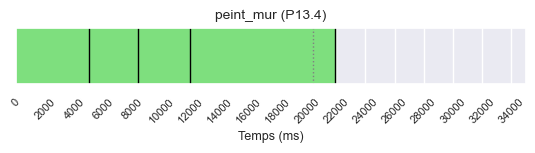

P13_4: 438380it [00:06, 114296.07it/s]

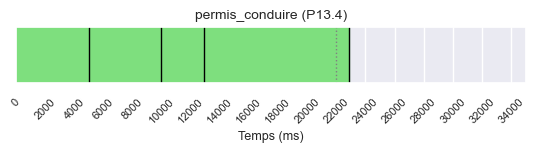

P13_4: 479250it [00:07, 67983.61it/s] 
P14_1: 19366it [00:00, 184835.52it/s]

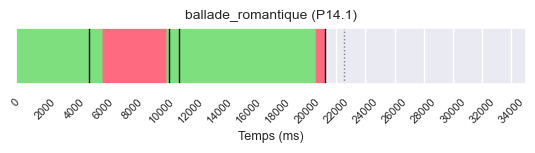

P14_1: 60927it [00:00, 103803.12it/s]

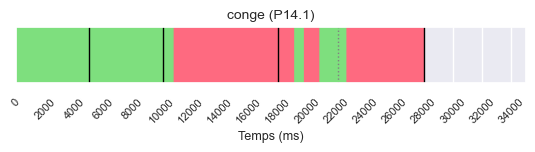

P14_1: 101637it [00:01, 71258.93it/s]

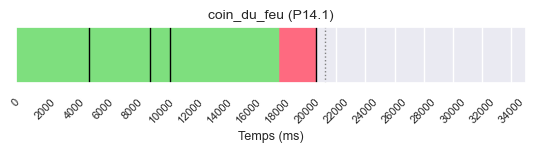

P14_1: 142431it [00:01, 79409.34it/s]

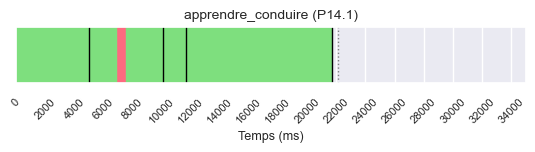

P14_1: 210286it [00:02, 112963.32it/s]

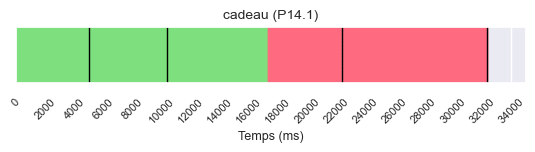

P14_1: 247371it [00:03, 74935.19it/s] 

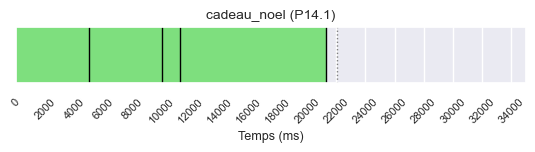

P14_1: 304091it [00:04, 93677.12it/s]

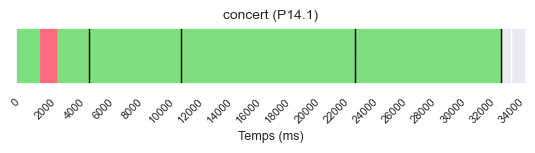

P14_1: 347945it [00:04, 93594.07it/s]

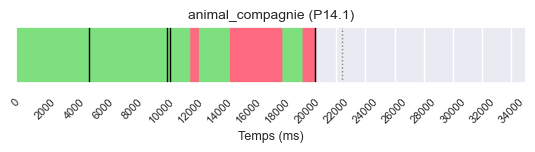

P14_1: 391344it [00:05, 94469.53it/s]

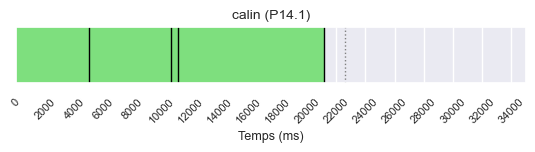

P14_1: 453368it [00:05, 105613.72it/s]

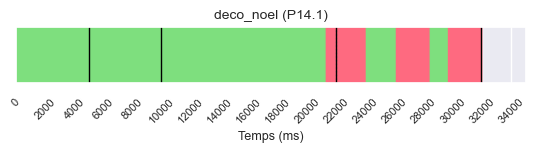

P14_1: 493381it [00:06, 75155.99it/s] 

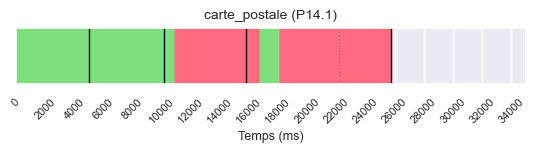

P14_1: 536396it [00:07, 70740.79it/s]

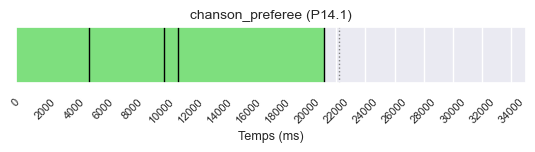

P14_1: 574234it [00:07, 73140.08it/s]
P14_2: 9508it [00:00, 94479.11it/s]

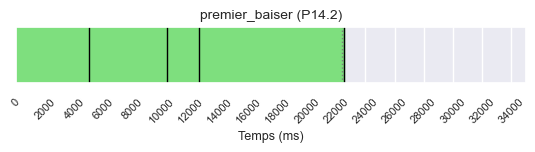

P14_2: 65053it [00:00, 115983.92it/s]

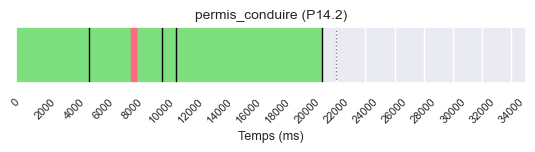

P14_2: 105418it [00:01, 92277.40it/s]

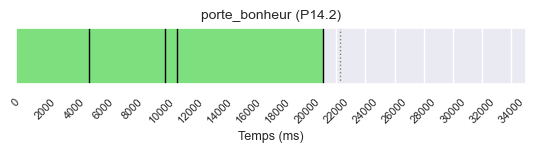

P14_2: 169016it [00:01, 110391.91it/s]

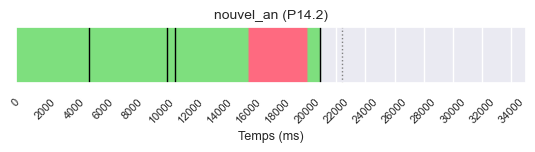

P14_2: 207751it [00:02, 97875.36it/s] 

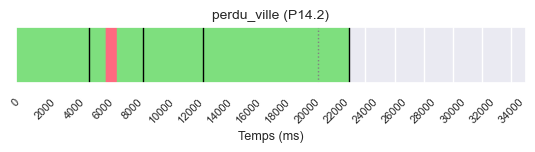

P14_2: 249814it [00:02, 93698.61it/s]

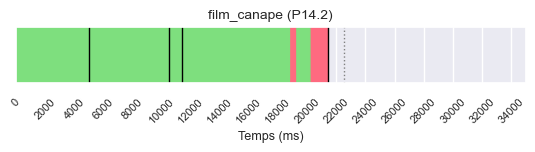

P14_2: 312067it [00:03, 109536.94it/s]

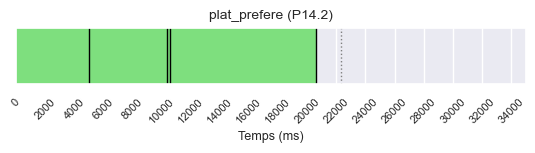

P14_2: 357664it [00:04, 105330.38it/s]

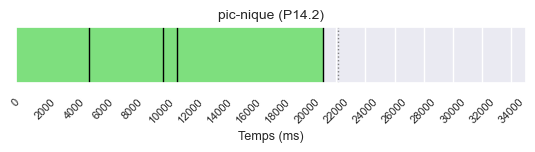

P14_2: 402632it [00:04, 101990.77it/s]

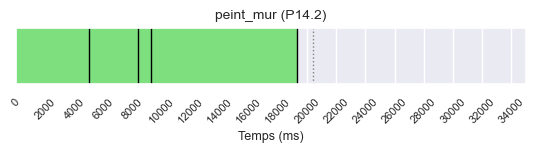

P14_2: 488868it [00:05, 131860.63it/s]

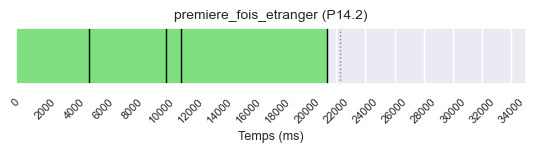

P14_2: 507954it [00:05, 88492.11it/s] 

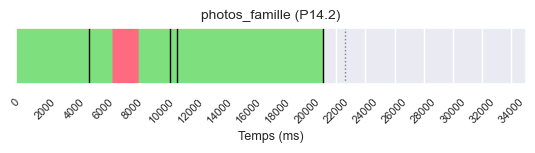

P14_2: 565432it [00:06, 101648.88it/s]

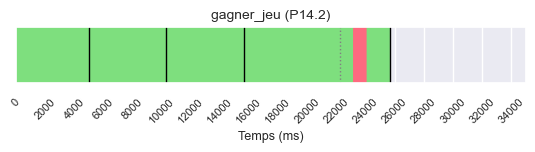

P14_2: 600571it [00:06, 86086.48it/s] 
P14_3: 10300it [00:00, 99117.22it/s]

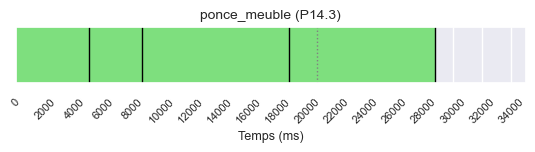

P14_3: 64840it [00:00, 97541.38it/s]

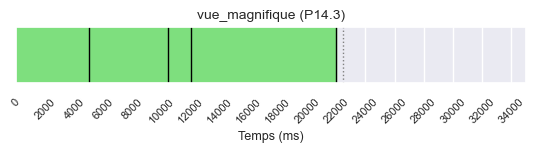

P14_3: 108087it [00:01, 88416.35it/s]

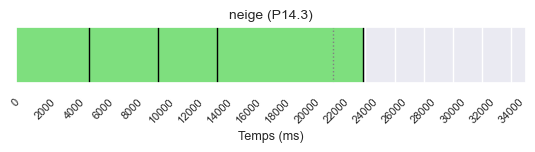

P14_3: 146825it [00:01, 87083.48it/s]

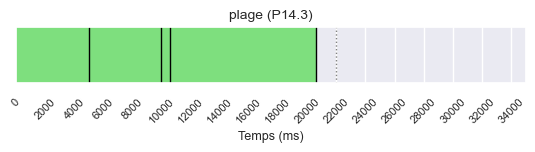

P14_3: 184587it [00:02, 85631.58it/s]

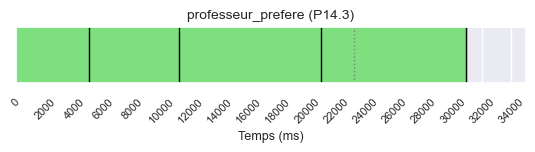

P14_3: 225624it [00:02, 88110.69it/s]

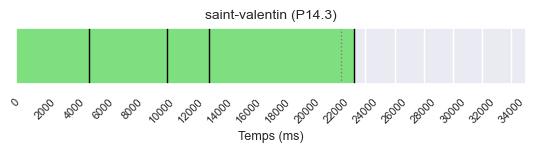

P14_3: 265234it [00:03, 87350.36it/s]

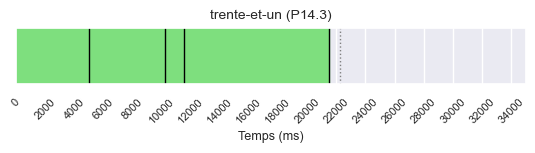

P14_3: 304160it [00:04, 89002.95it/s]

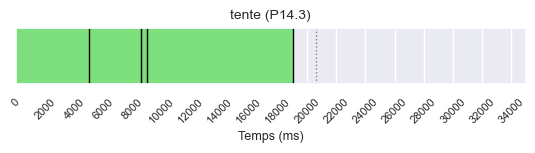

P14_3: 345829it [00:04, 91595.30it/s]

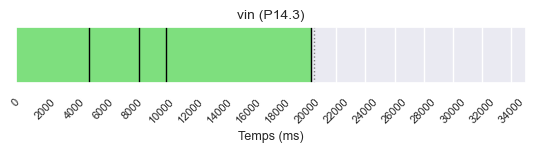

P14_3: 386028it [00:05, 89960.75it/s]

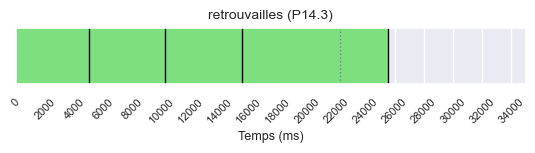

P14_3: 426283it [00:05, 88016.56it/s]

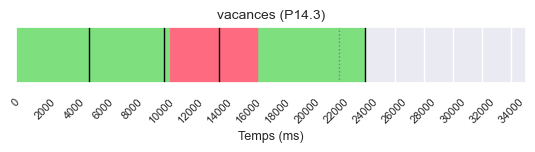

P14_3: 464068it [00:06, 77271.36it/s]

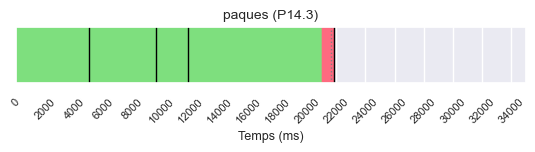

P14_3: 500085it [00:06, 73753.09it/s]
P14_4: 11789it [00:00, 115729.65it/s]

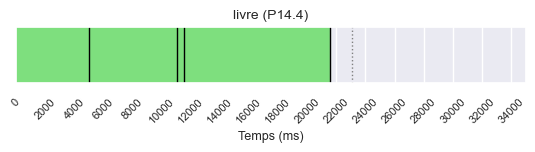

P14_4: 64020it [00:00, 111980.28it/s]

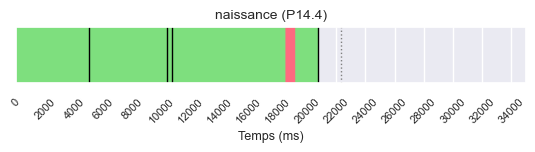

P14_4: 99208it [00:01, 83684.33it/s] 

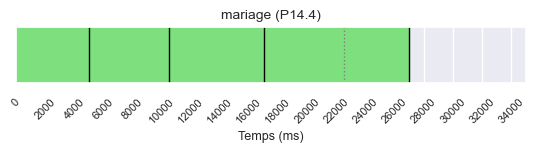

P14_4: 138382it [00:01, 83025.73it/s]

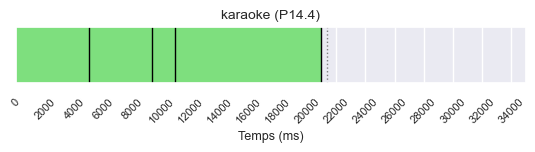

P14_4: 176641it [00:02, 84960.45it/s]

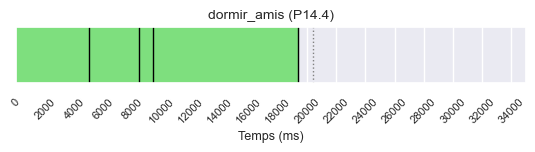

P14_4: 212907it [00:02, 83734.26it/s]

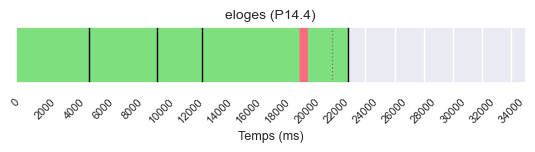

P14_4: 277197it [00:03, 110009.63it/s]

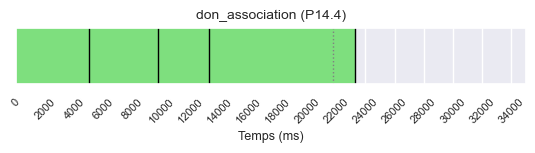

P14_4: 319846it [00:03, 101170.87it/s]

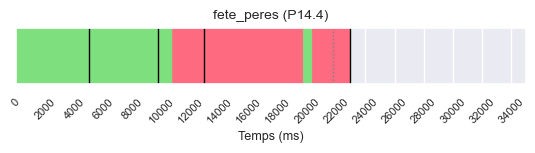

P14_4: 351495it [00:04, 72574.69it/s] 

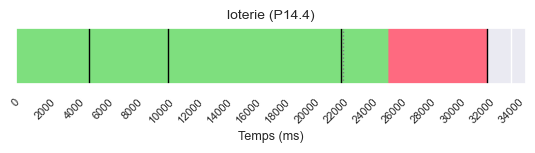

P14_4: 377833it [00:05, 63495.14it/s]

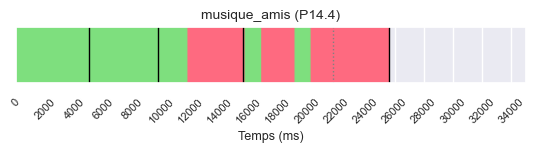

P14_4: 410124it [00:05, 58630.37it/s]

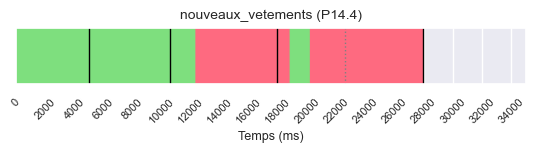

P14_4: 443193it [00:06, 54040.86it/s]

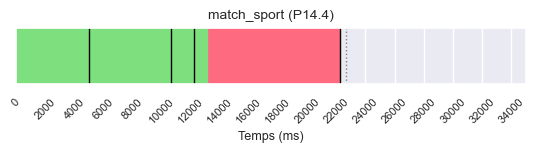

P14_4: 474971it [00:07, 66565.27it/s]
P15_1: 20813it [00:00, 191115.99it/s]

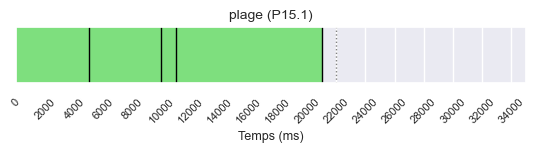

P15_1: 62200it [00:00, 105179.93it/s]

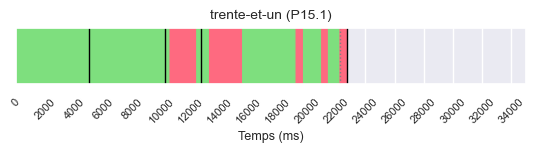

P15_1: 106386it [00:01, 82878.50it/s]

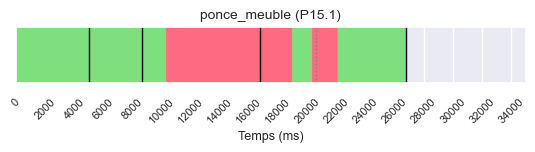

P15_1: 149017it [00:02, 73653.74it/s]

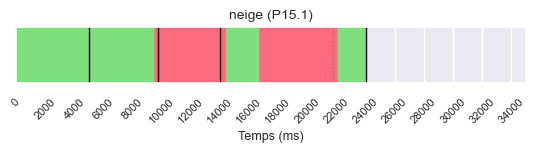

P15_1: 188513it [00:02, 77520.82it/s]

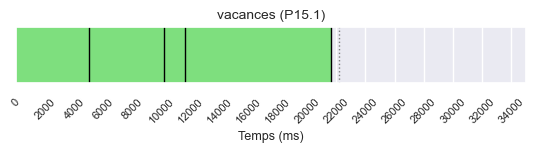

P15_1: 228850it [00:03, 83998.52it/s]

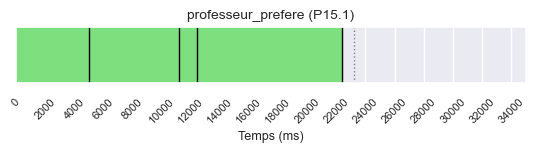

P15_1: 268646it [00:03, 85103.95it/s]

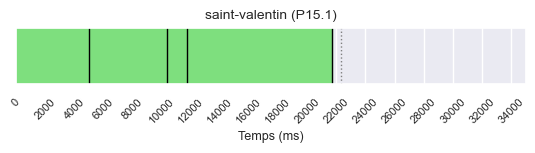

P15_1: 309894it [00:04, 85229.72it/s]

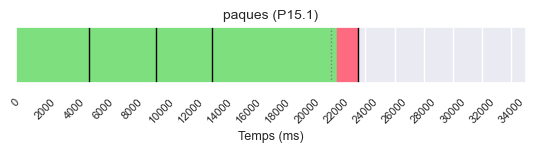

P15_1: 352003it [00:04, 87627.30it/s]

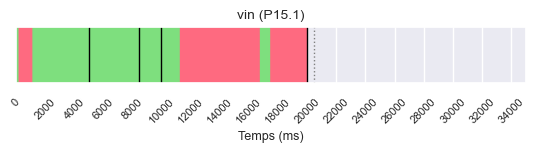

P15_1: 393941it [00:05, 90823.08it/s]

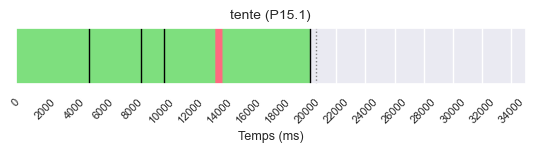

P15_1: 433805it [00:05, 89369.05it/s]

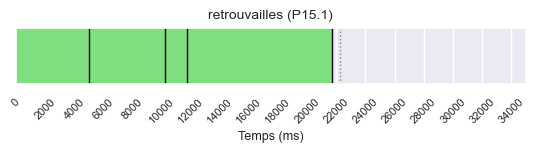

P15_1: 472956it [00:06, 87309.09it/s]

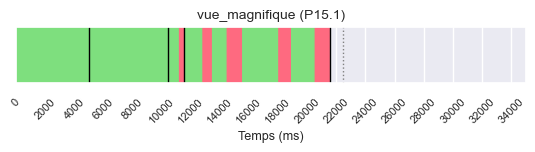

P15_1: 520208it [00:07, 72188.22it/s]
P15_2: 12682it [00:00, 124351.36it/s]

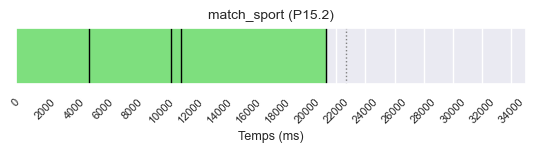

P15_2: 50574it [00:00, 89743.60it/s] 

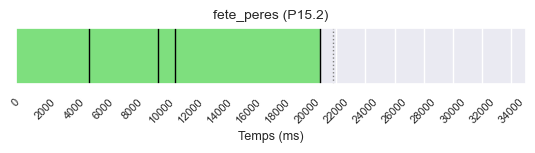

P15_2: 90874it [00:01, 80388.83it/s]

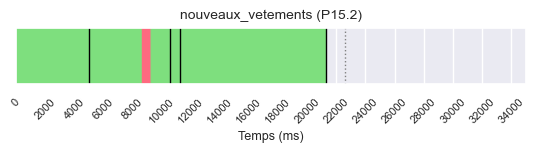

P15_2: 128862it [00:01, 81282.63it/s]

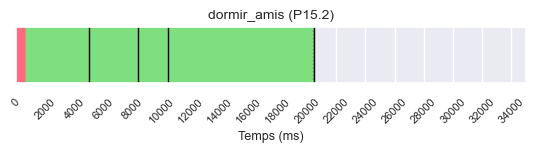

P15_2: 162115it [00:02, 78032.57it/s]

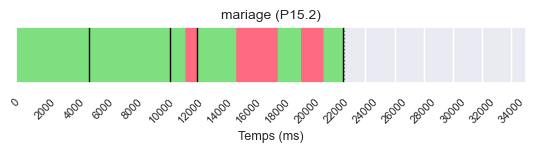

P15_2: 198283it [00:03, 66415.86it/s]

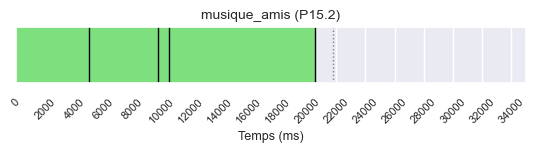

P15_2: 264048it [00:03, 104513.41it/s]

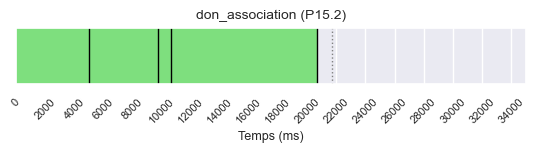

P15_2: 305966it [00:04, 101735.91it/s]

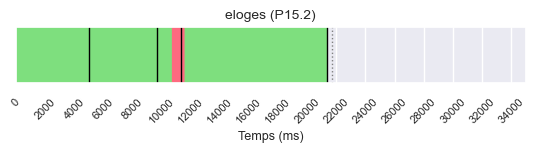

P15_2: 345715it [00:04, 81382.66it/s] 

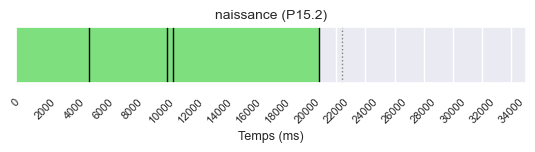

P15_2: 382414it [00:05, 81786.68it/s]

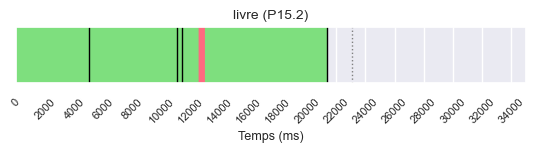

P15_2: 416036it [00:05, 78661.48it/s]

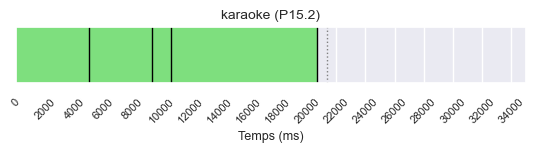

P15_2: 451905it [00:06, 80913.49it/s]

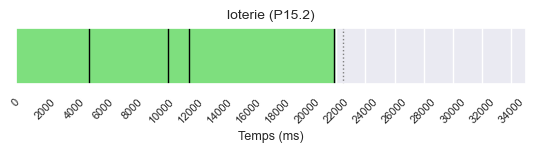

P15_2: 484110it [00:06, 71090.27it/s]
P15_3: 16445it [00:00, 161844.39it/s]

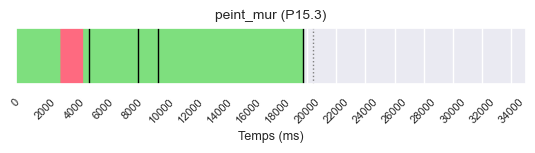

P15_3: 53781it [00:00, 96772.73it/s] 

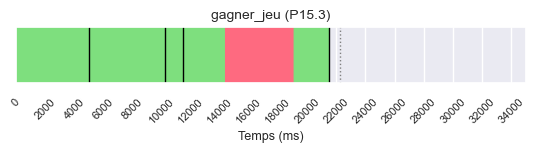

P15_3: 101092it [00:01, 76333.88it/s]

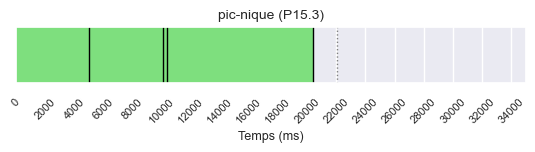

P15_3: 135725it [00:01, 73487.32it/s]

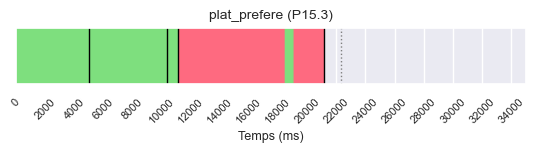

P15_3: 168345it [00:02, 59289.12it/s]

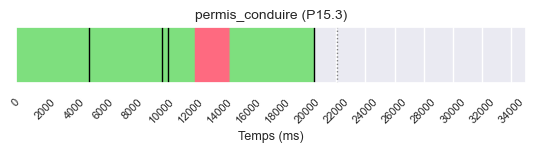

P15_3: 222271it [00:03, 85405.04it/s]

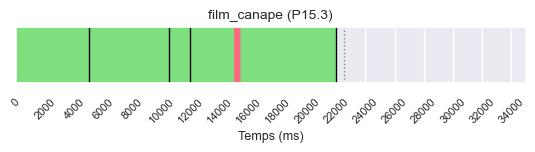

P15_3: 251859it [00:03, 73744.93it/s]

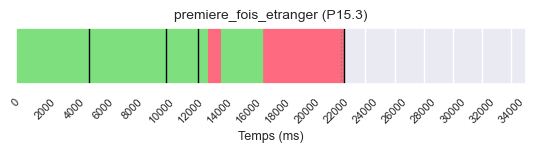

P15_3: 288507it [00:04, 71011.92it/s]

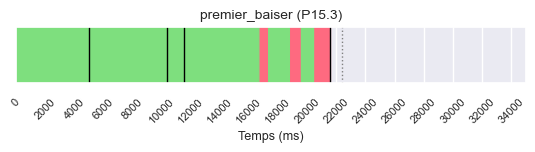

P15_3: 324463it [00:05, 75406.16it/s]

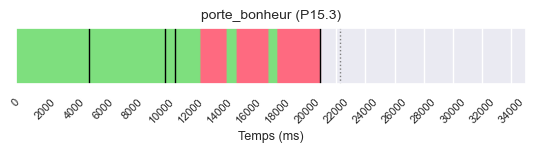

P15_3: 359999it [00:05, 78614.67it/s]

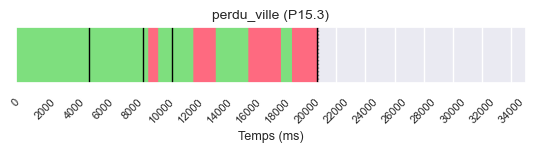

P15_3: 395644it [00:06, 74303.34it/s]

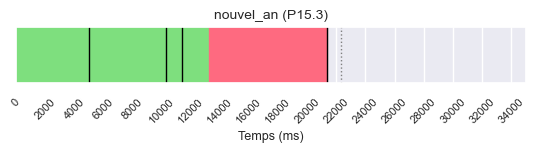

P15_3: 431974it [00:06, 74345.90it/s]

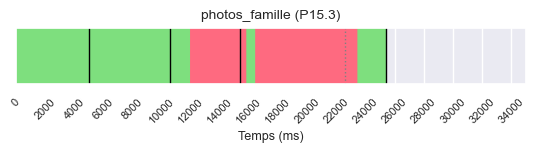

P15_3: 464005it [00:07, 62781.37it/s]
P15_4: 17447it [00:00, 164303.95it/s]

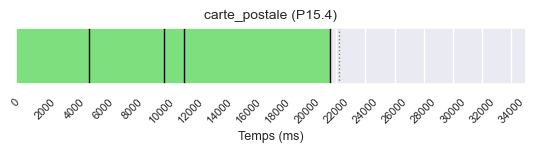

P15_4: 33878it [00:00, 57801.35it/s] 

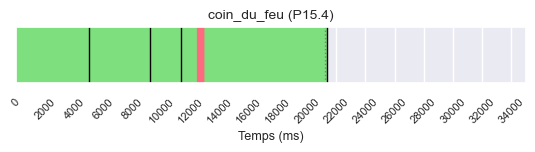

P15_4: 73665it [00:01, 64855.71it/s]

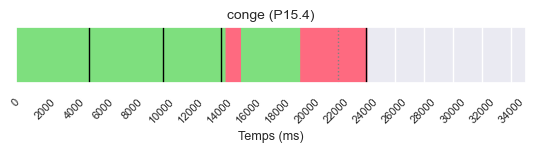

P15_4: 111490it [00:01, 76270.47it/s]

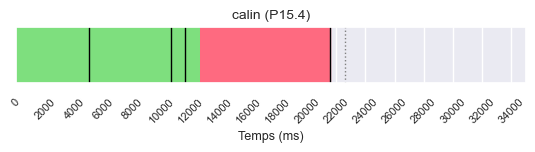

P15_4: 149901it [00:02, 81528.92it/s]

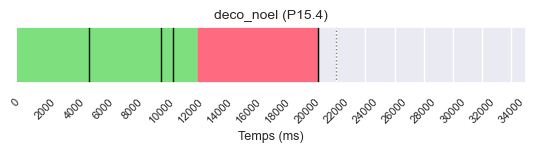

P15_4: 186016it [00:02, 82376.02it/s]

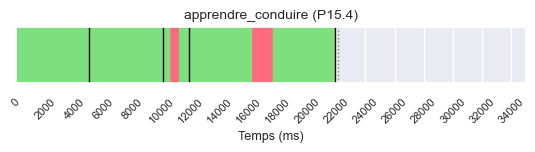

P15_4: 222217it [00:03, 72938.30it/s]

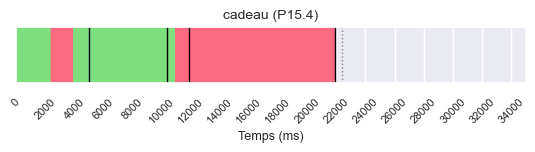

P15_4: 260182it [00:04, 73596.59it/s]

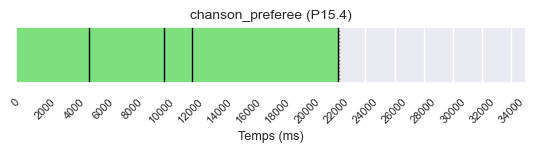

P15_4: 274279it [00:04, 58599.63it/s]

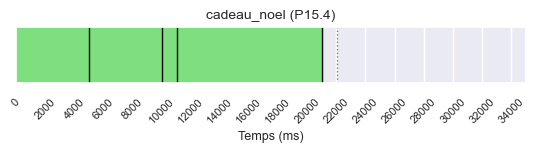

P15_4: 334798it [00:05, 88310.03it/s]

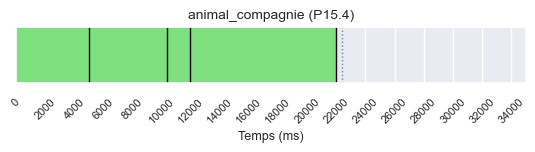

P15_4: 370770it [00:05, 85546.87it/s]

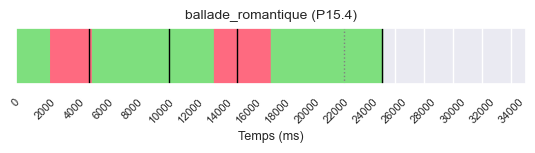

P15_4: 401306it [00:06, 57119.34it/s]

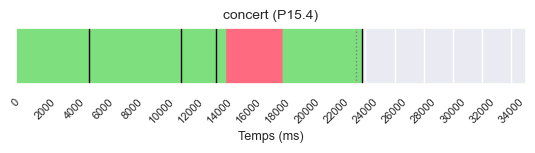

P15_4: 423967it [00:06, 61248.23it/s]
P16_1: 45152it [00:00, 223264.23it/s]

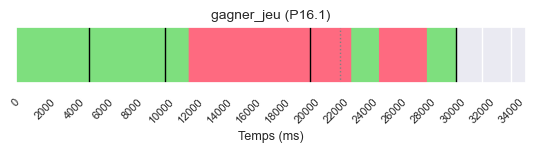

P16_1: 90236it [00:00, 85325.62it/s] 

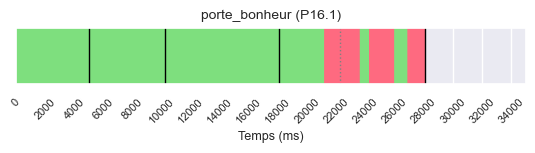

P16_1: 136169it [00:01, 78522.18it/s]

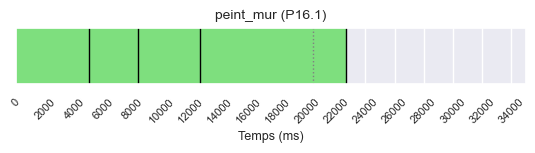

P16_1: 182181it [00:02, 90177.27it/s]

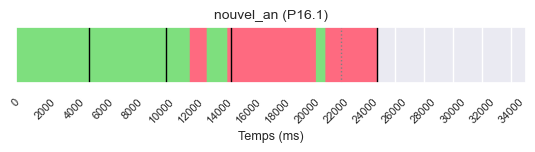

P16_1: 222846it [00:03, 68544.69it/s]

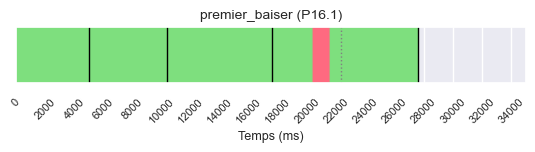

P16_1: 262867it [00:03, 76943.83it/s]

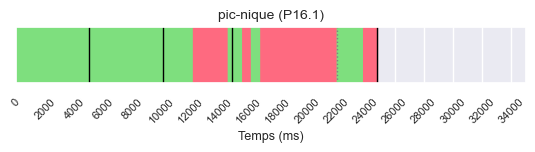

P16_1: 301847it [00:04, 69664.62it/s]

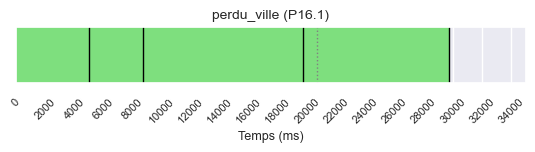

P16_1: 344960it [00:05, 75346.38it/s]

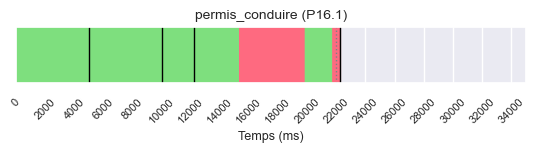

P16_1: 402139it [00:05, 91830.20it/s]

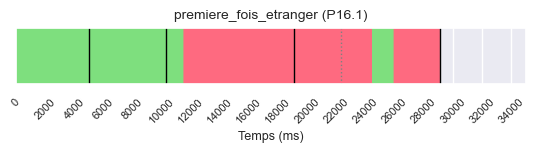

P16_1: 462852it [00:06, 86477.12it/s]

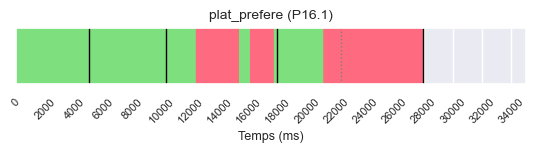

P16_1: 497792it [00:07, 60975.75it/s]

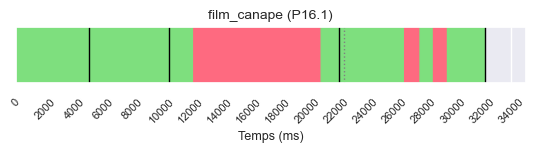

P16_1: 534967it [00:08, 59143.77it/s]

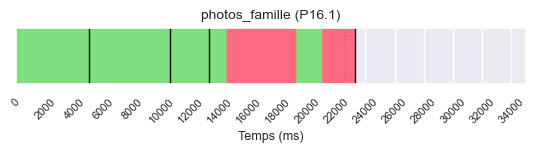

P16_1: 565305it [00:08, 64869.81it/s]
P16_2: 16322it [00:00, 162097.07it/s]

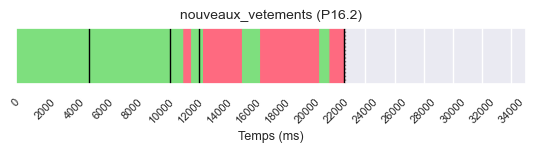

P16_2: 47953it [00:00, 62734.75it/s] 

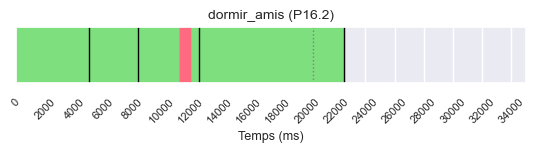

P16_2: 79932it [00:01, 51149.08it/s]

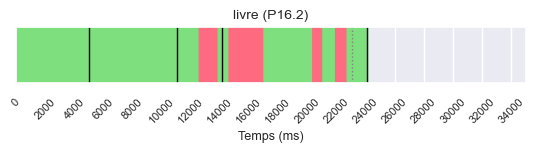

P16_2: 113608it [00:02, 53840.86it/s]

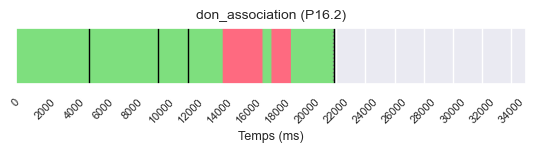

P16_2: 148222it [00:02, 64874.13it/s]

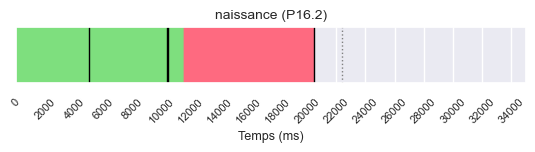

P16_2: 185517it [00:03, 76223.33it/s]

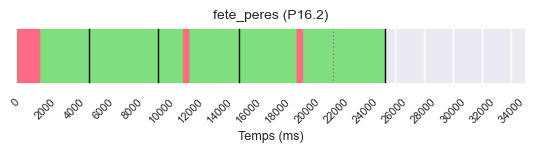

P16_2: 223446it [00:04, 68765.51it/s]

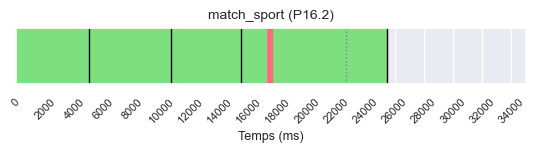

P16_2: 262033it [00:04, 76008.81it/s]

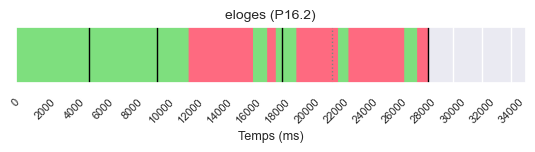

P16_2: 301111it [00:05, 61295.27it/s]

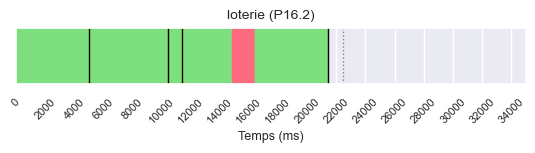

P16_2: 339922it [00:06, 69379.14it/s]

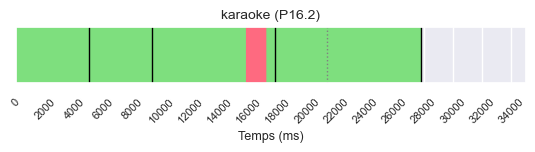

P16_2: 379832it [00:06, 66765.01it/s]

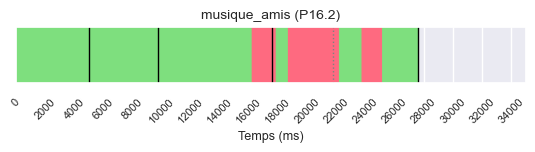

P16_2: 421213it [00:07, 62469.12it/s]

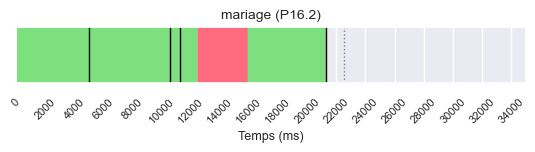

P16_2: 451130it [00:08, 53804.59it/s]
P16_3: 9813it [00:00, 97309.03it/s]

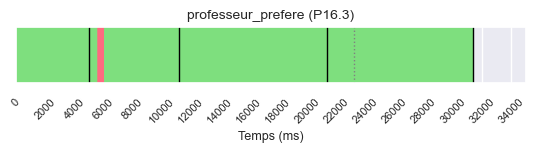

P16_3: 46909it [00:00, 81275.26it/s]

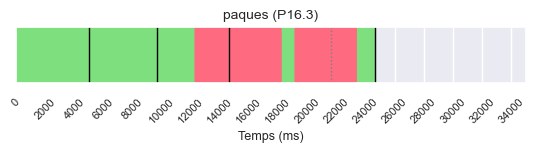

P16_3: 86028it [00:01, 67689.05it/s]

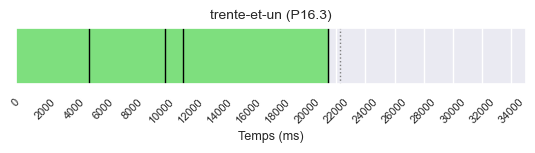

P16_3: 122914it [00:01, 73546.32it/s]

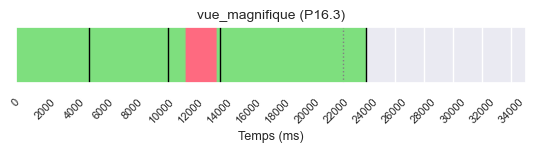

P16_3: 158085it [00:02, 65750.75it/s]

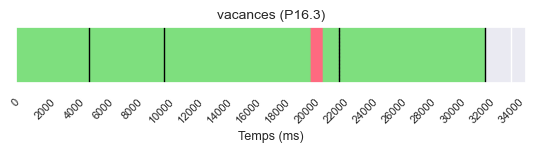

P16_3: 199037it [00:03, 62932.71it/s]

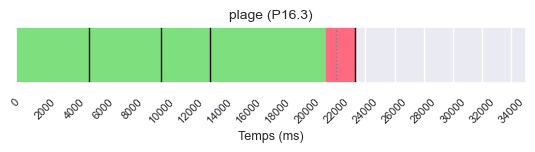

P16_3: 235797it [00:04, 67557.48it/s]

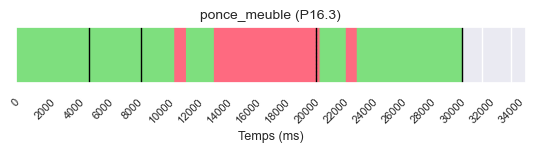

P16_3: 271539it [00:05, 53721.44it/s]

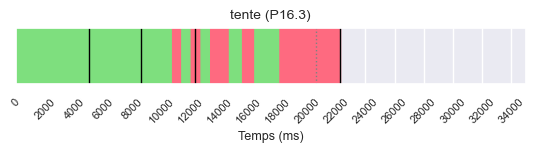

P16_3: 305998it [00:05, 50955.23it/s]

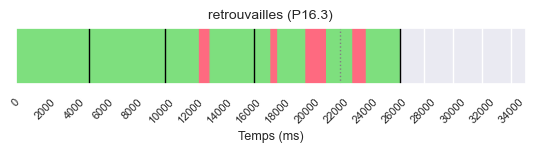

P16_3: 344156it [00:06, 58181.54it/s]

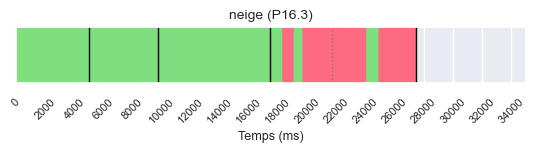

P16_3: 380640it [00:07, 66701.16it/s]

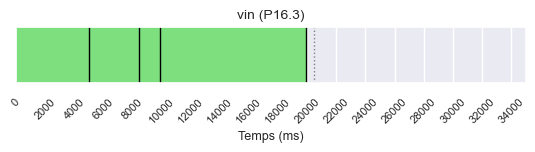

P16_3: 410966it [00:07, 68561.46it/s]

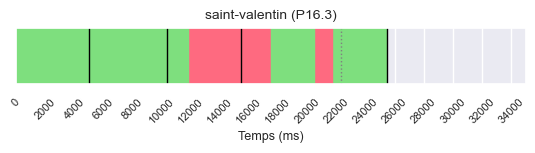

P16_3: 432977it [00:08, 52678.97it/s]
P16_4: 15981it [00:00, 159109.50it/s]

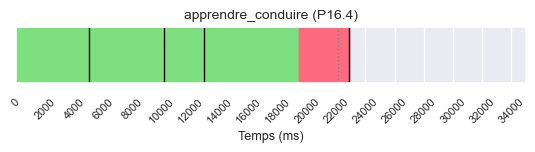

P16_4: 53760it [00:00, 95328.11it/s] 

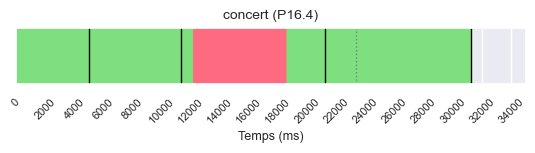

P16_4: 90820it [00:01, 64651.55it/s]

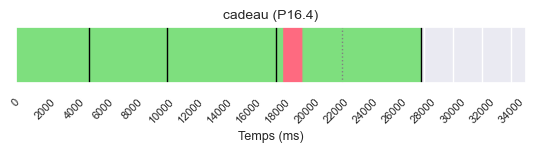

P16_4: 124614it [00:01, 68722.59it/s]

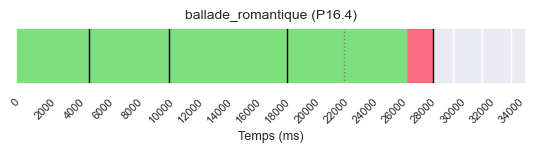

P16_4: 158966it [00:02, 73187.07it/s]

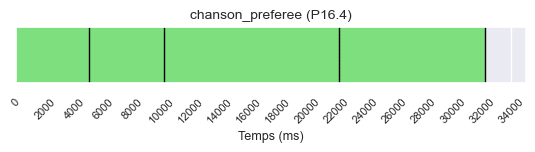

P16_4: 192245it [00:03, 71504.03it/s]

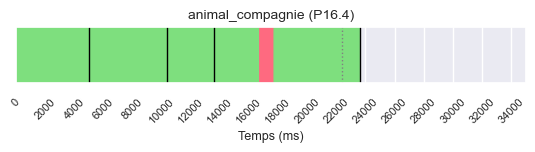

P16_4: 231171it [00:03, 80710.39it/s]

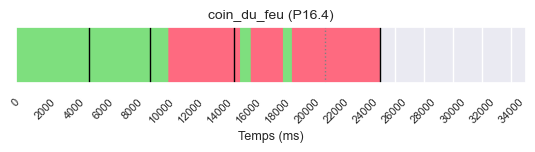

P16_4: 270656it [00:04, 70566.46it/s]

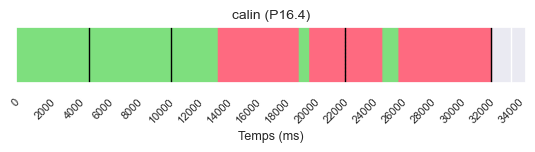

P16_4: 311112it [00:05, 58456.08it/s]

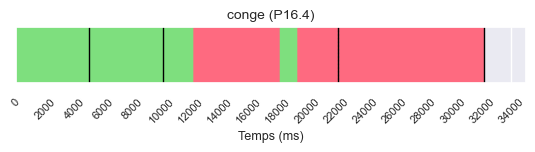

P16_4: 350655it [00:06, 60372.32it/s]

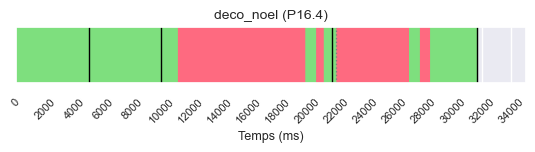

P16_4: 390516it [00:06, 57162.52it/s]

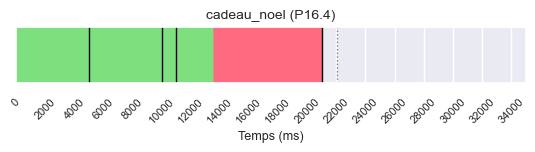

P16_4: 425462it [00:07, 64652.41it/s]

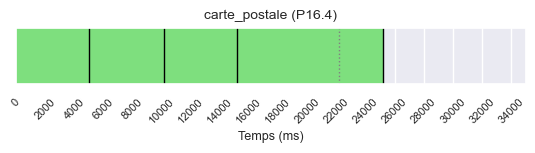

P16_4: 455306it [00:07, 57708.87it/s]
P17_1: 14024it [00:00, 140064.15it/s]

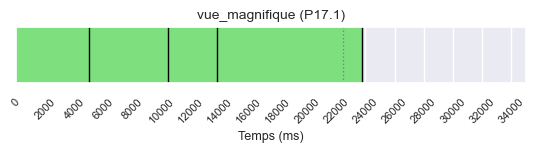

P17_1: 50396it [00:00, 90194.34it/s] 

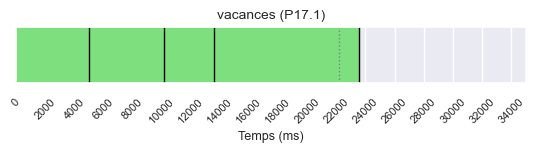

P17_1: 115873it [00:01, 110167.51it/s]

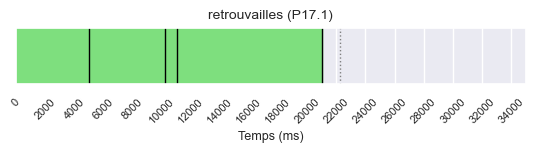

P17_1: 154951it [00:01, 91810.18it/s] 

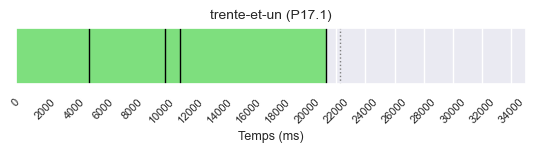

P17_1: 190581it [00:02, 81696.64it/s]

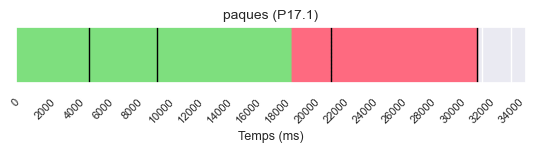

P17_1: 223835it [00:03, 62440.86it/s]

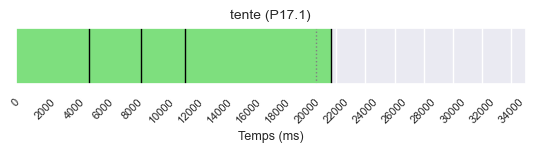

P17_1: 256881it [00:03, 70149.52it/s]

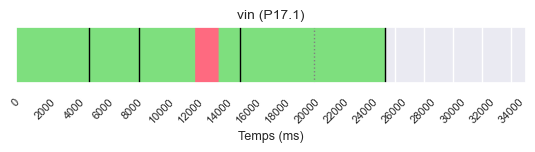

P17_1: 298995it [00:04, 70502.04it/s]

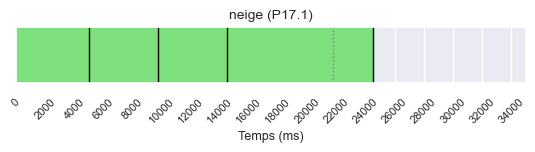

P17_1: 339375it [00:05, 75654.57it/s]

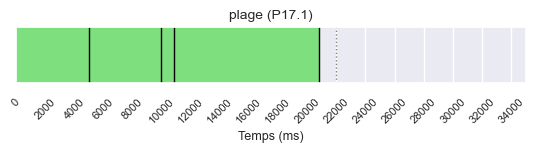

P17_1: 380425it [00:05, 80333.22it/s]

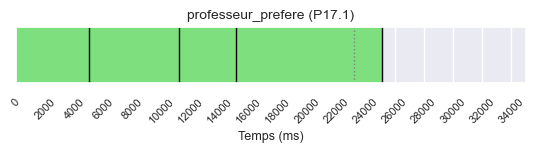

P17_1: 422170it [00:06, 82240.37it/s]

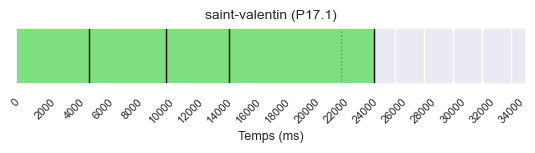

P17_1: 460398it [00:06, 81017.11it/s]

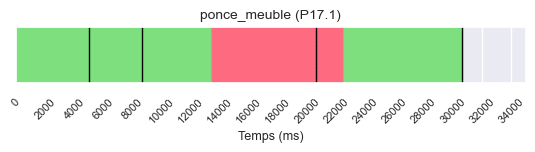

P17_1: 501368it [00:07, 67097.87it/s]
P17_2: 8859it [00:00, 87784.72it/s]

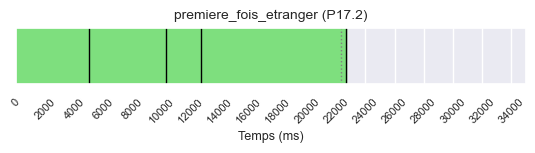

P17_2: 47685it [00:00, 74706.05it/s]

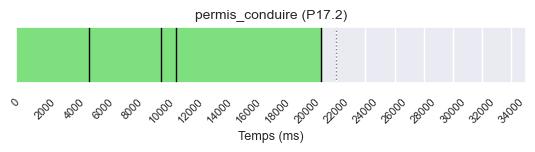

P17_2: 83836it [00:01, 72979.81it/s]

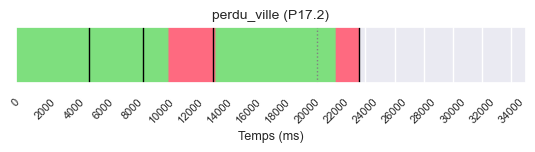

P17_2: 139683it [00:02, 74972.44it/s]

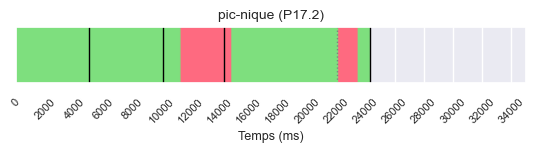

P17_2: 194314it [00:03, 81577.09it/s]

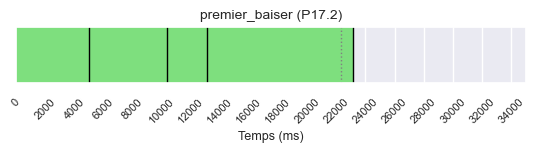

P17_2: 258994it [00:03, 103384.37it/s]

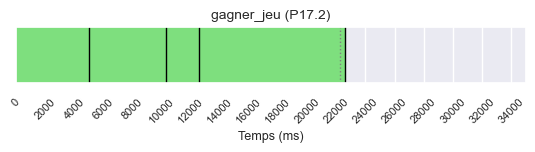

P17_2: 302064it [00:04, 100360.22it/s]

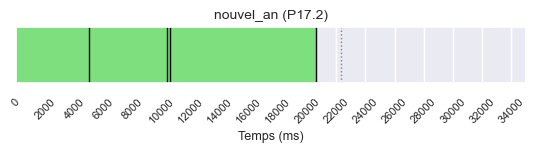

P17_2: 361269it [00:04, 107336.77it/s]

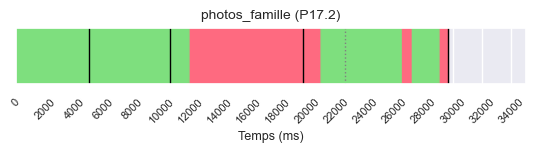

P17_2: 403339it [00:05, 85643.53it/s] 

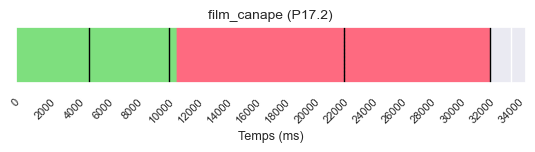

P17_2: 440744it [00:06, 71208.22it/s]

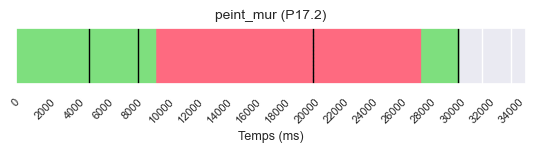

P17_2: 474568it [00:06, 68362.12it/s]

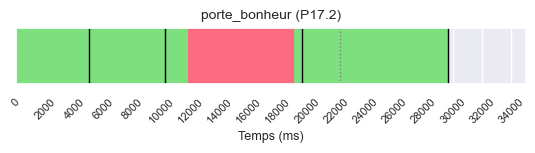

P17_2: 527802it [00:07, 71344.31it/s]

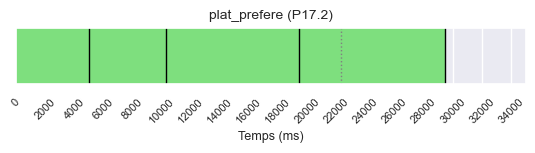

P17_2: 559925it [00:08, 67412.05it/s]
P17_3: 10227it [00:00, 99893.45it/s]

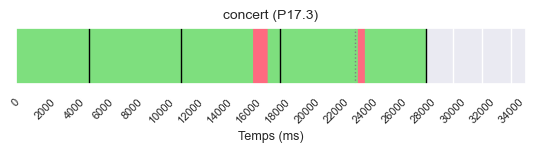

P17_3: 44281it [00:01, 50532.58it/s]

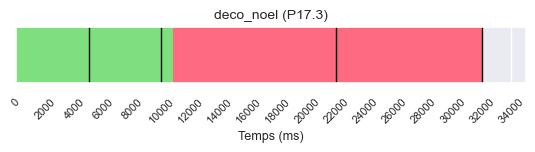

P17_3: 78323it [00:01, 48205.91it/s]

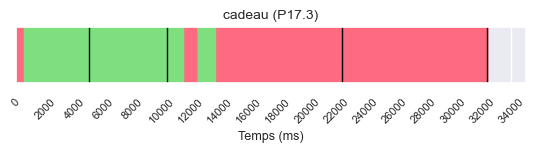

P17_3: 99544it [00:02, 35328.80it/s]

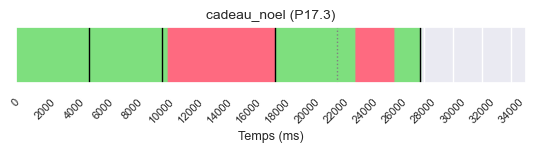

P17_3: 155118it [00:03, 68201.33it/s]

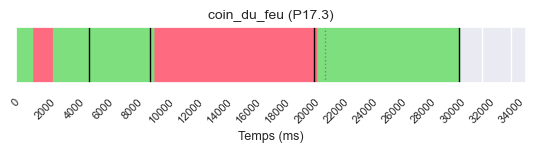

P17_3: 190851it [00:04, 63491.99it/s]

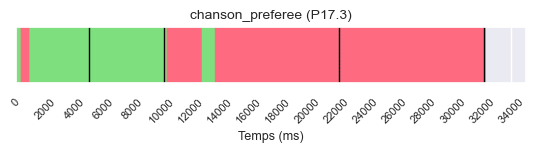

P17_3: 229084it [00:04, 63523.53it/s]

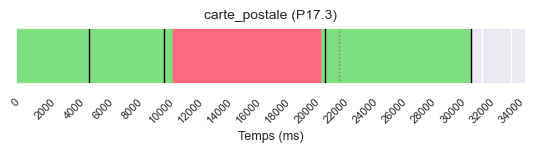

P17_3: 268731it [00:05, 64087.91it/s]

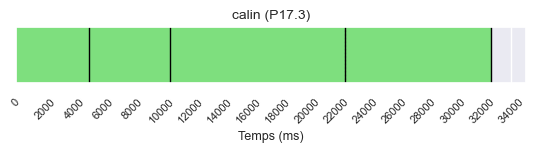

P17_3: 306950it [00:06, 69857.69it/s]

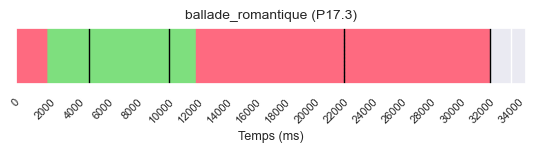

P17_3: 333106it [00:07, 51798.54it/s]

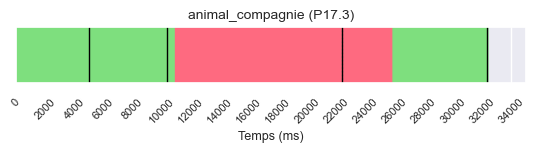

P17_3: 383026it [00:07, 66699.63it/s]

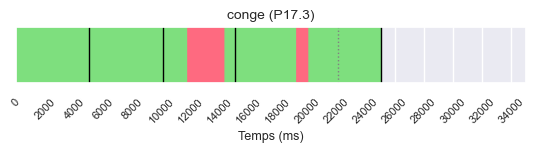

P17_3: 418876it [00:08, 63942.31it/s]

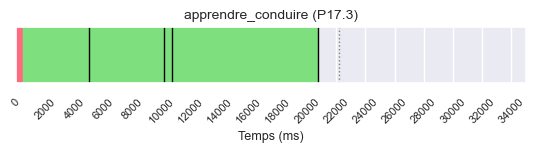

P17_3: 451709it [00:09, 49695.77it/s]
P17_4: 14751it [00:00, 146492.38it/s]

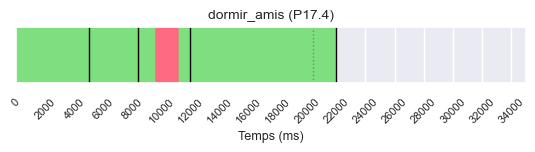

P17_4: 48260it [00:00, 62877.51it/s] 

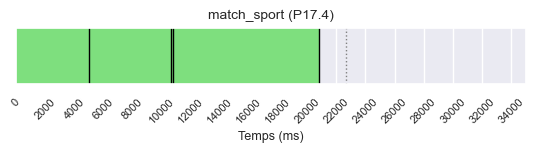

P17_4: 80290it [00:01, 60014.69it/s]

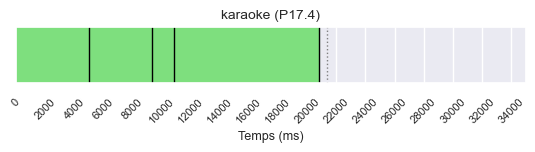

P17_4: 114015it [00:01, 70336.48it/s]

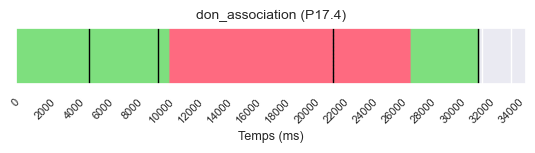

P17_4: 152934it [00:02, 67323.68it/s]

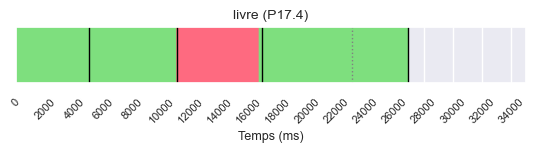

P17_4: 213598it [00:03, 90795.59it/s]

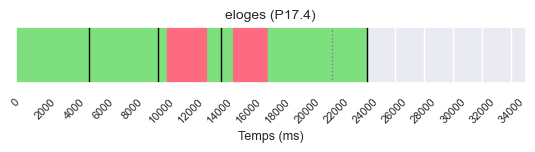

P17_4: 256213it [00:04, 79929.21it/s]

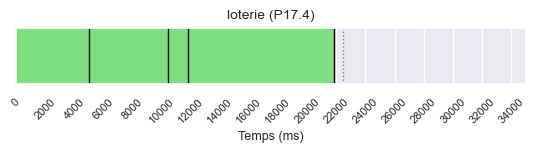

P17_4: 296972it [00:04, 81924.78it/s]

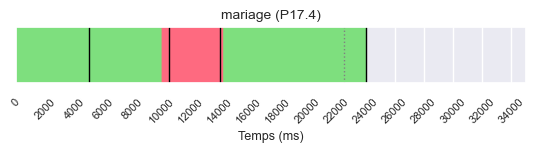

P17_4: 332587it [00:05, 78176.72it/s]

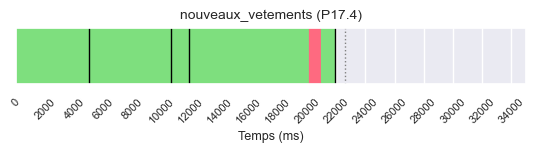

P17_4: 375271it [00:05, 87283.58it/s]

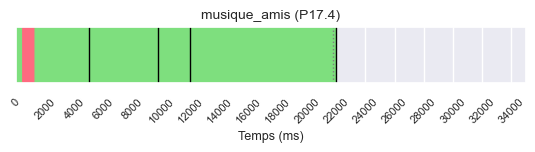

P17_4: 433926it [00:06, 99123.16it/s]

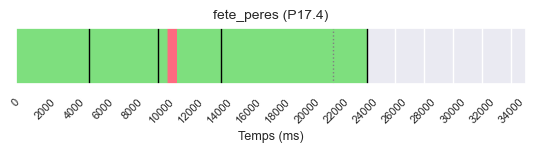

P17_4: 468746it [00:07, 71888.51it/s]

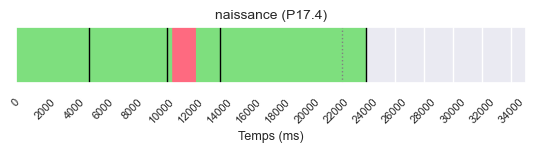

P17_4: 497245it [00:07, 64233.58it/s]
P18_1: 17461it [00:00, 171343.68it/s]

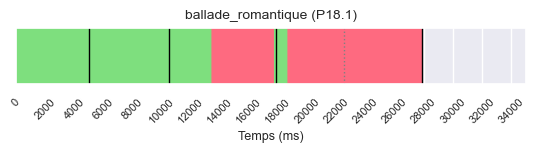

P18_1: 58354it [00:00, 73637.43it/s] 

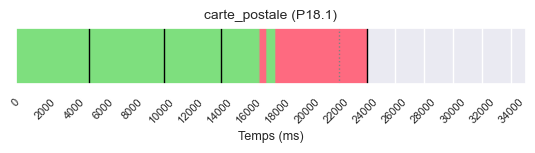

P18_1: 117623it [00:01, 87164.49it/s]

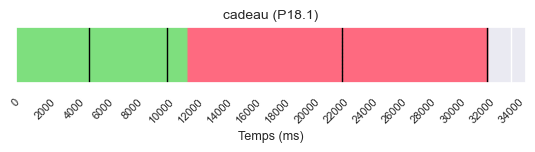

P18_1: 152484it [00:02, 67367.53it/s]

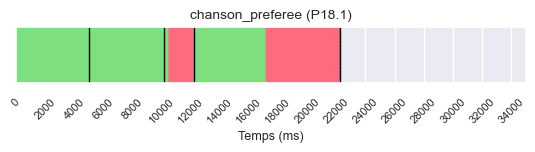

P18_1: 188748it [00:03, 67177.72it/s]

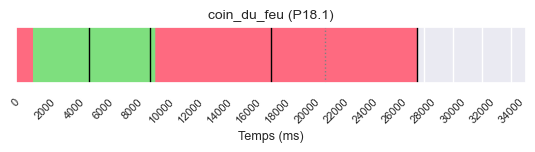

P18_1: 235862it [00:03, 71031.26it/s]

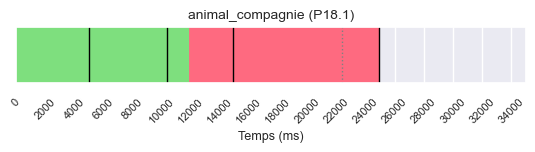

P18_1: 286799it [00:04, 75702.05it/s]

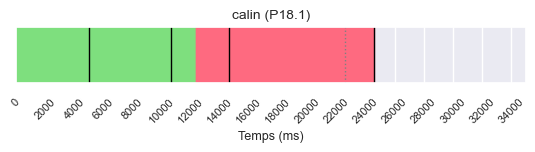

P18_1: 337363it [00:05, 80661.17it/s]

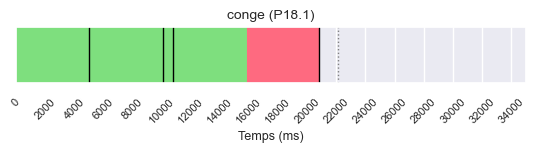

P18_1: 403659it [00:05, 113681.11it/s]

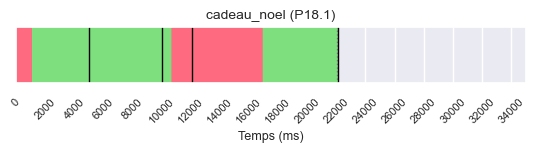

P18_1: 449404it [00:06, 94029.66it/s] 

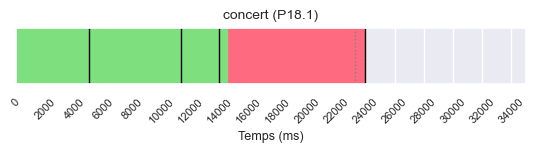

P18_1: 513188it [00:07, 108703.98it/s]

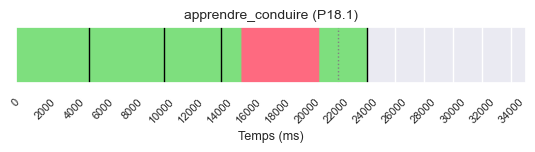

P18_1: 576949it [00:08, 106092.63it/s]

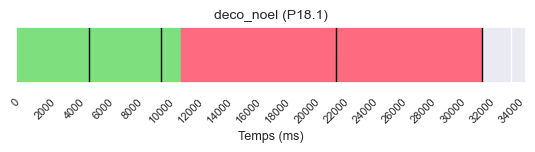

P18_1: 587694it [00:08, 68065.27it/s] 
P18_2: 14421it [00:00, 143996.60it/s]

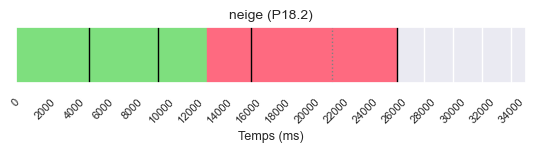

P18_2: 70452it [00:01, 78767.40it/s] 

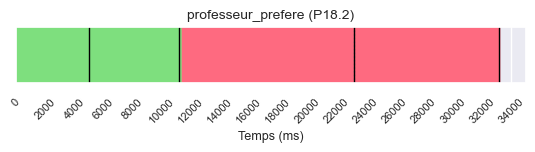

P18_2: 105194it [00:01, 66689.99it/s]

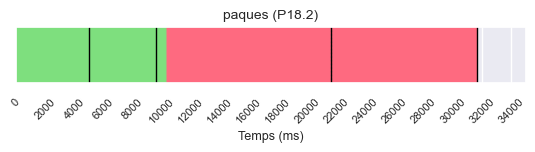

P18_2: 136931it [00:02, 54054.95it/s]

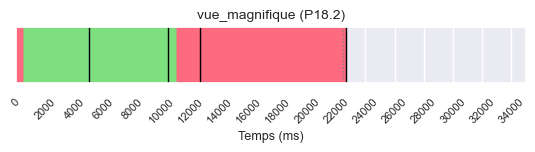

P18_2: 180311it [00:03, 65700.04it/s]

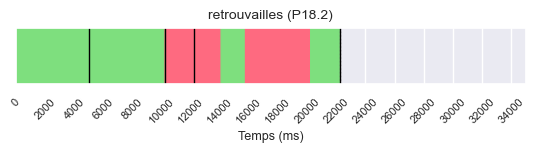

P18_2: 233396it [00:04, 80708.55it/s]

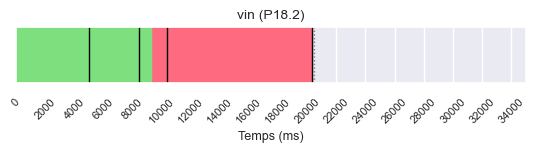

P18_2: 270728it [00:04, 73156.37it/s]

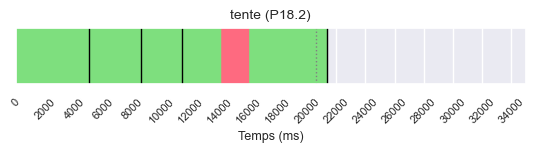

P18_2: 325689it [00:05, 89194.50it/s]

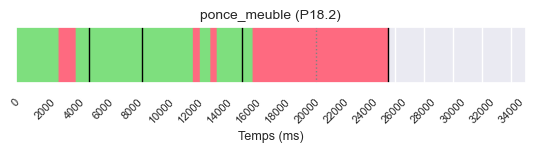

P18_2: 340980it [00:06, 41154.98it/s]

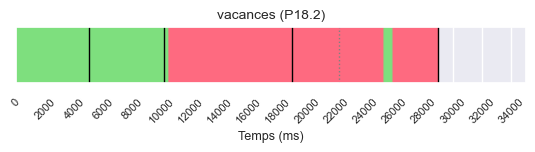

P18_2: 377217it [00:06, 53354.61it/s]

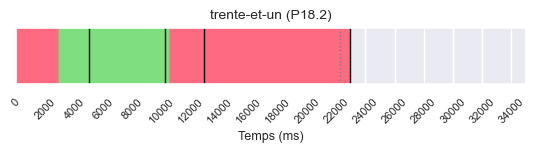

P18_2: 444021it [00:07, 83036.69it/s]

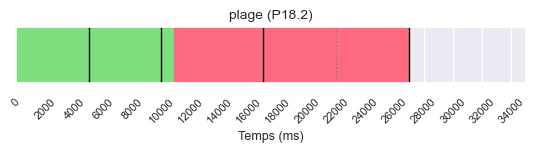

P18_2: 480475it [00:08, 69606.08it/s]

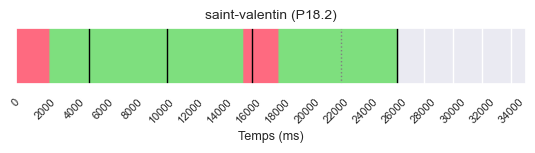

P18_2: 526344it [00:09, 57365.88it/s]
P18_3: 15027it [00:00, 149105.54it/s]

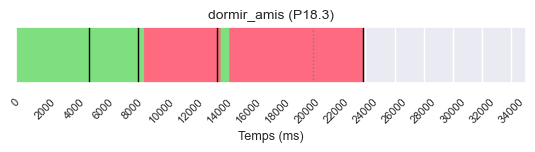

P18_3: 70968it [00:00, 92687.44it/s] 

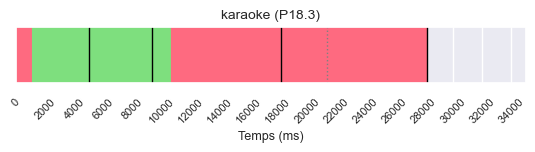

P18_3: 85228it [00:01, 39641.00it/s]

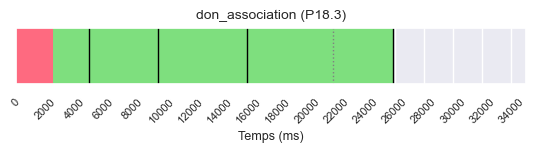

P18_3: 137859it [00:02, 72377.26it/s]

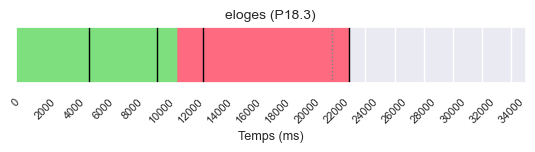

P18_3: 178003it [00:03, 69466.03it/s]

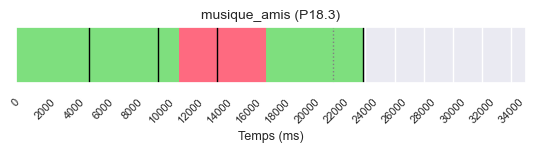

P18_3: 232365it [00:03, 74655.15it/s]

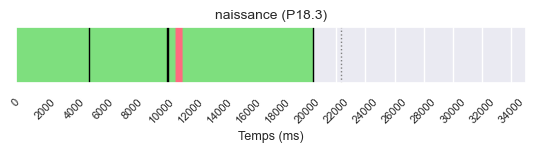

P18_3: 292251it [00:04, 102171.12it/s]

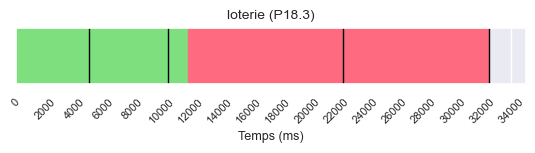

P18_3: 332863it [00:05, 73962.16it/s] 

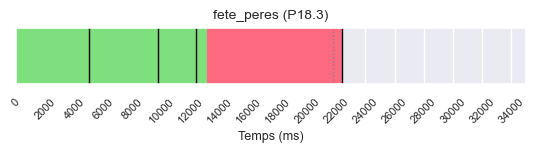

P18_3: 370799it [00:05, 79727.06it/s]

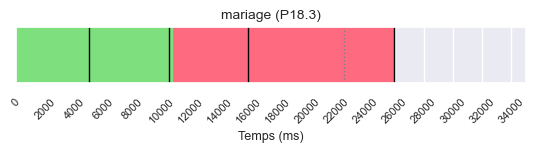

P18_3: 410089it [00:06, 75811.17it/s]

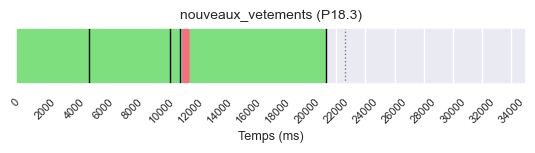

P18_3: 469915it [00:07, 90629.66it/s]

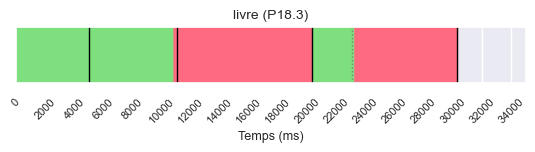

P18_3: 506831it [00:07, 79611.85it/s]

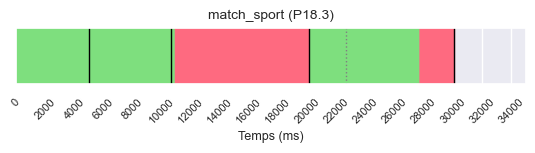

P18_3: 556484it [00:08, 64774.49it/s]
P18_4: 16272it [00:00, 162478.04it/s]

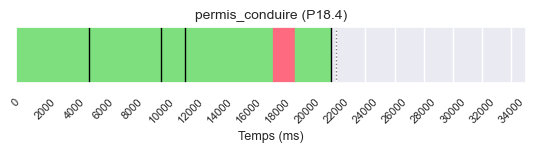

P18_4: 103412it [00:00, 148032.78it/s]

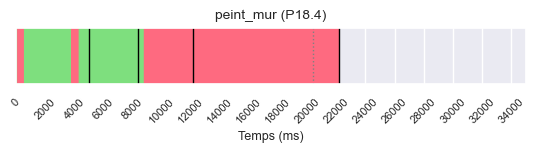

P18_4: 168502it [00:01, 99637.17it/s] 

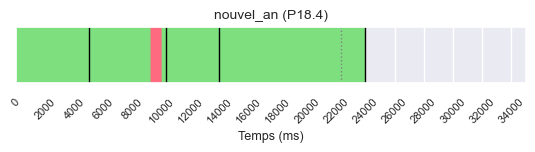

P18_4: 209365it [00:02, 92466.76it/s]

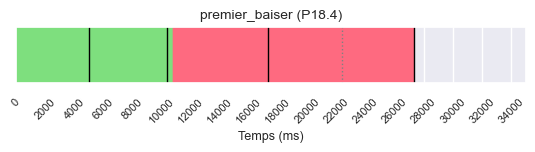

P18_4: 252891it [00:03, 81680.76it/s]

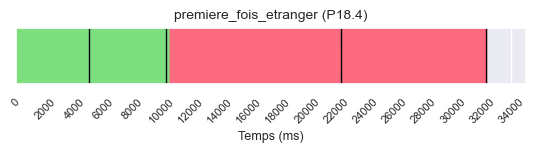

P18_4: 317066it [00:03, 94475.19it/s]

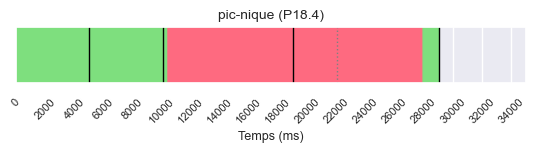

P18_4: 361606it [00:04, 89706.95it/s]

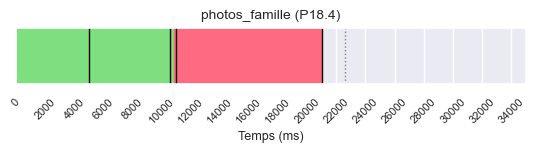

P18_4: 406094it [00:05, 83175.38it/s]

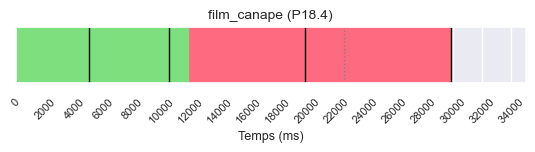

P18_4: 452020it [00:05, 77667.68it/s]

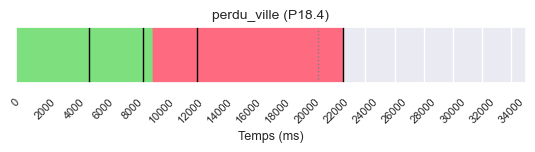

P18_4: 497040it [00:06, 73959.82it/s]

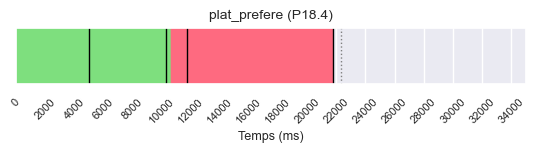

P18_4: 538529it [00:07, 74098.72it/s]

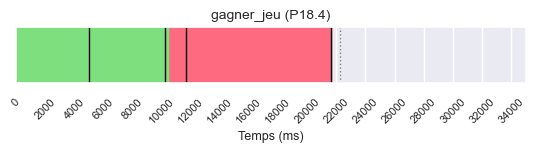

P18_4: 580253it [00:07, 78395.64it/s]

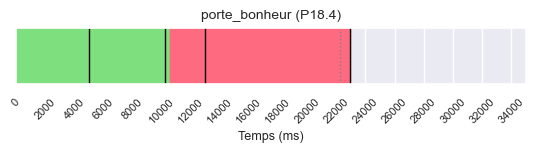

P18_4: 618852it [00:08, 72324.13it/s]
P19_1: 16783it [00:00, 166958.41it/s]

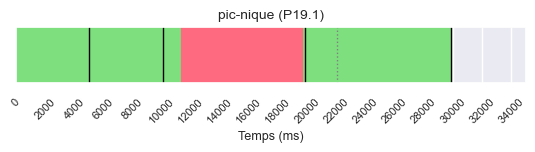

P19_1: 67749it [00:00, 81595.53it/s] 

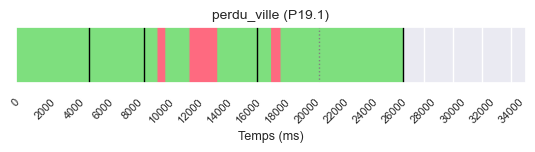

P19_1: 108521it [00:01, 61682.89it/s]

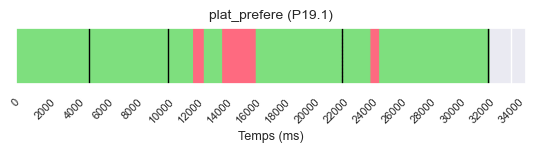

P19_1: 161187it [00:03, 58760.20it/s]

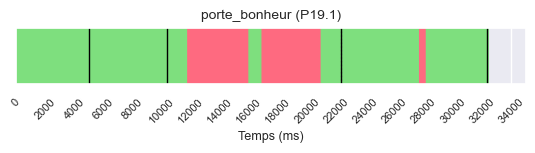

P19_1: 230123it [00:04, 75004.62it/s]

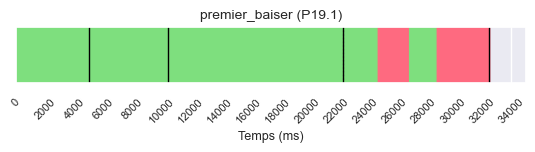

P19_1: 287420it [00:04, 91531.81it/s]

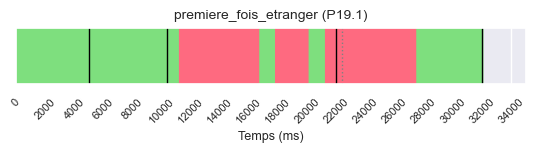

P19_1: 326592it [00:06, 54070.92it/s]

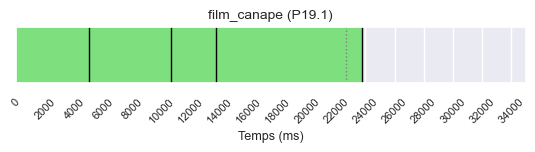

P19_1: 385601it [00:06, 78586.25it/s]

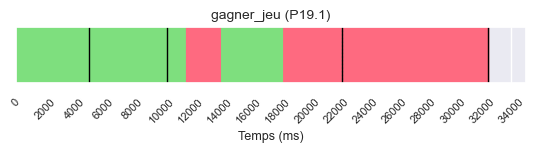

P19_1: 451210it [00:07, 79924.85it/s]

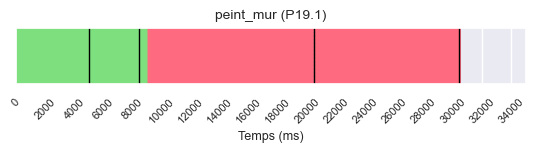

P19_1: 511945it [00:08, 82475.70it/s]

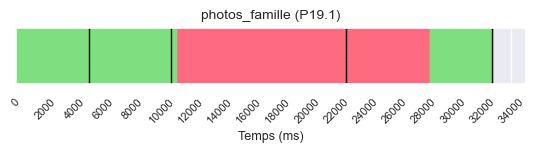

P19_1: 564200it [00:09, 83664.95it/s]

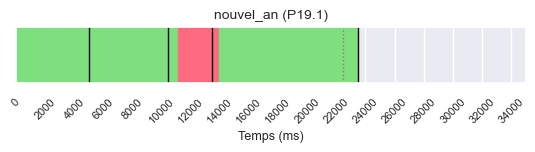

P19_1: 622058it [00:10, 82895.37it/s]

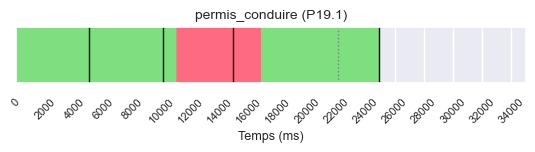

P19_1: 659490it [00:10, 60145.23it/s]
P19_2: 17811it [00:00, 172611.60it/s]

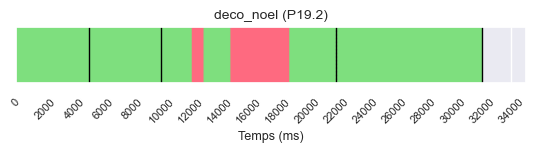

P19_2: 76700it [00:01, 76914.25it/s] 

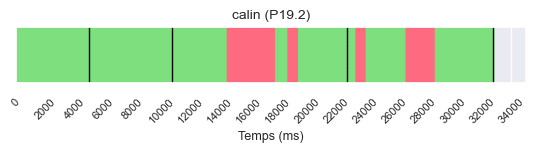

P19_2: 126574it [00:02, 61293.66it/s]

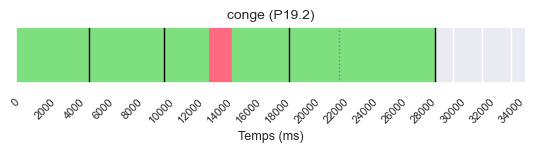

P19_2: 184601it [00:03, 75524.73it/s]

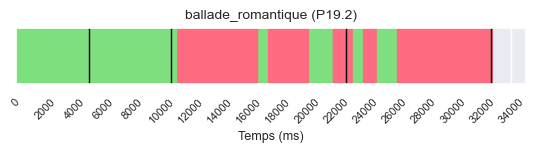

P19_2: 241068it [00:04, 66420.22it/s]

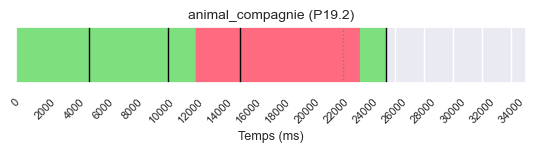

P19_2: 301883it [00:05, 88295.59it/s]

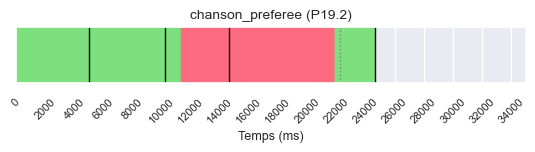

P19_2: 343243it [00:05, 78253.20it/s]

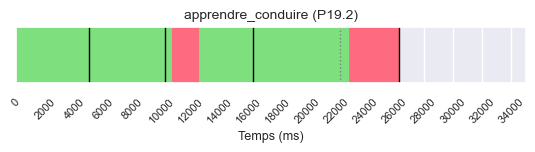

P19_2: 402144it [00:06, 79689.42it/s]

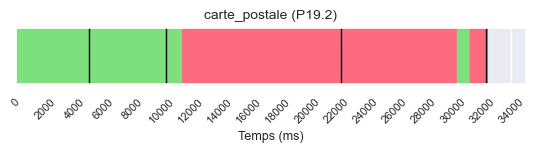

P19_2: 444913it [00:07, 73995.85it/s]

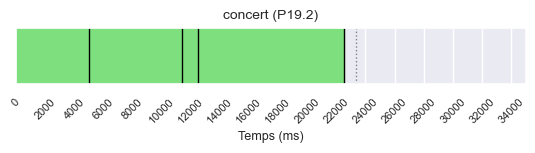

P19_2: 506687it [00:08, 95455.87it/s]

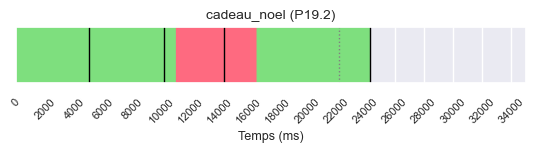

P19_2: 565262it [00:08, 88584.16it/s]

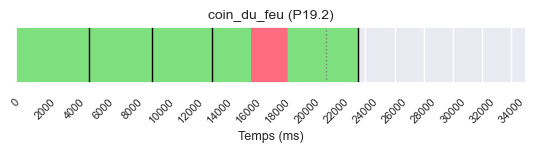

P19_2: 601254it [00:09, 86215.63it/s]

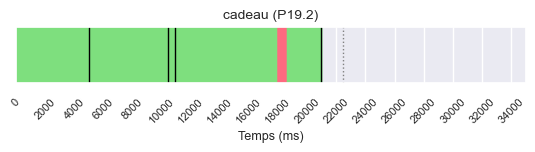

P19_2: 664284it [00:10, 66411.41it/s]
P19_3: 13533it [00:00, 132869.03it/s]

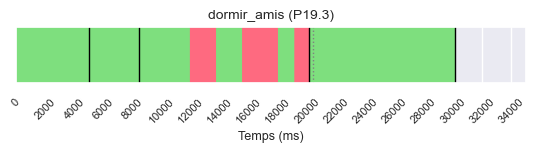

P19_3: 67378it [00:01, 63522.35it/s] 

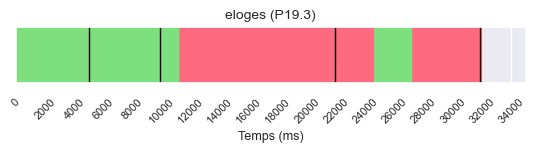

P19_3: 120801it [00:02, 68755.15it/s]

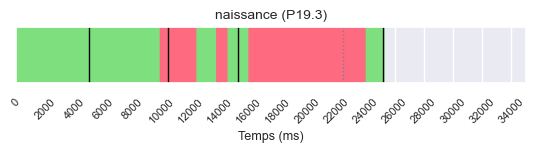

P19_3: 181504it [00:02, 97454.58it/s]

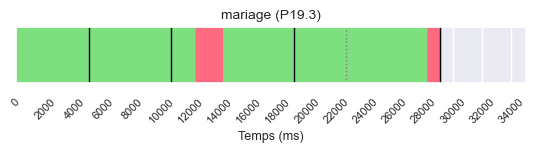

P19_3: 226406it [00:03, 92468.06it/s]

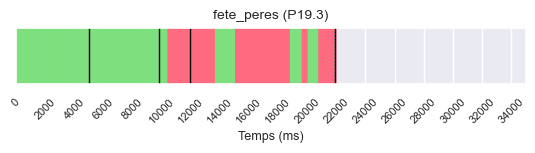

P19_3: 290471it [00:04, 86912.09it/s]

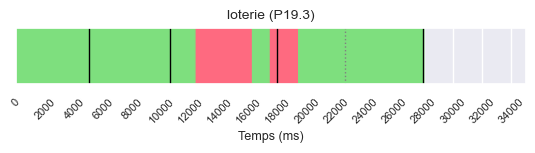

P19_3: 349235it [00:05, 75507.53it/s]

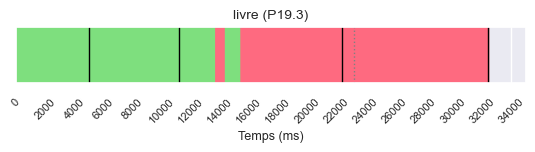

P19_3: 407963it [00:06, 73592.03it/s]

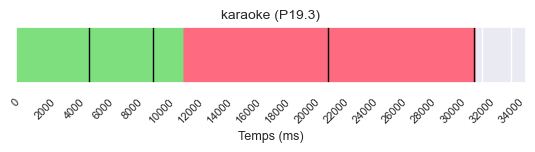

P19_3: 461291it [00:07, 80913.45it/s]

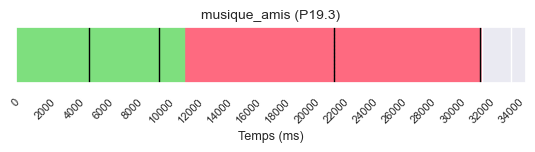

P19_3: 501195it [00:08, 69455.62it/s]

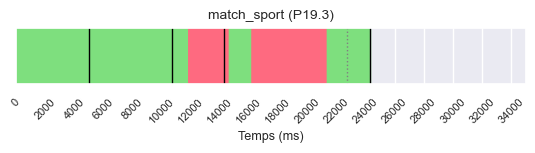

P19_3: 566865it [00:08, 95220.27it/s]

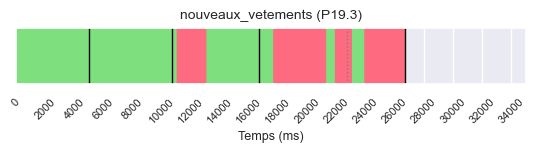

P19_3: 628706it [00:09, 95248.54it/s]

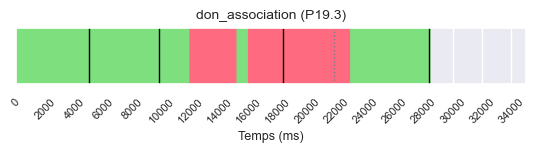

P19_3: 677868it [00:10, 63921.30it/s]
P19_4: 13959it [00:00, 139202.16it/s]

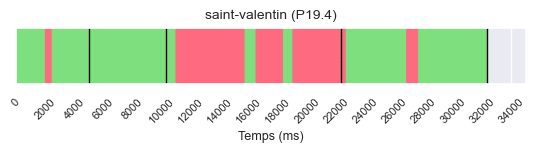

P19_4: 71015it [00:01, 63662.80it/s] 

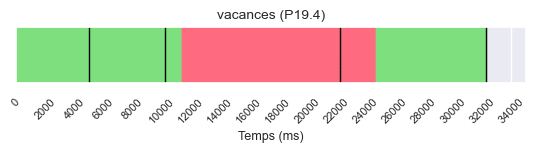

P19_4: 114527it [00:02, 62728.00it/s]

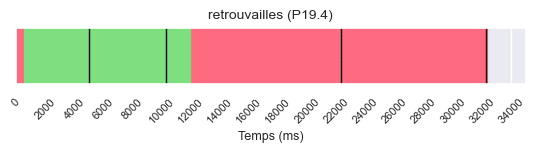

P19_4: 177387it [00:03, 82010.31it/s]

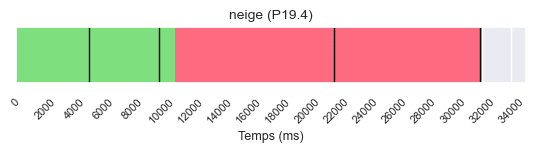

P19_4: 215604it [00:03, 66294.70it/s]

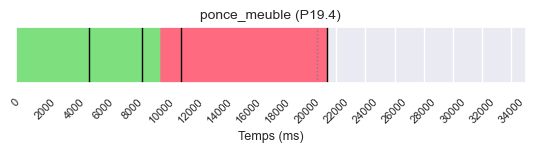

P19_4: 254737it [00:04, 65559.63it/s]

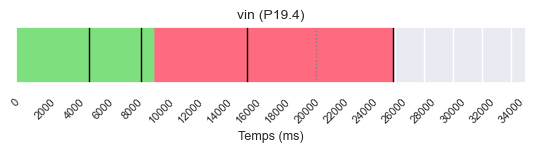

P19_4: 296460it [00:05, 68526.03it/s]

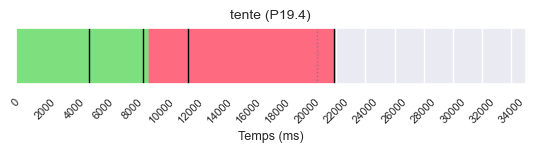

P19_4: 357491it [00:06, 85982.64it/s]

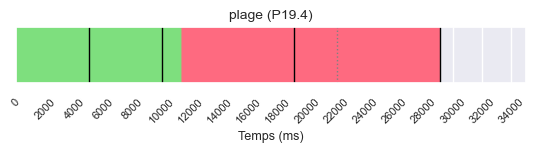

P19_4: 399175it [00:06, 76436.45it/s]

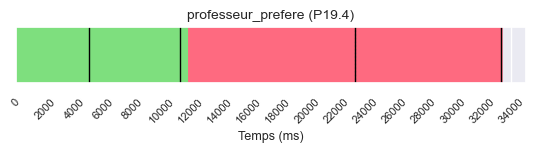

P19_4: 461016it [00:07, 85960.28it/s]

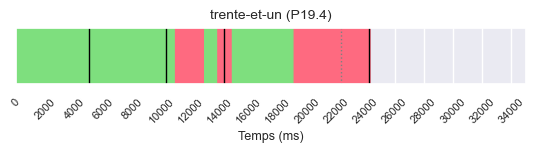

P19_4: 521810it [00:08, 75734.00it/s]

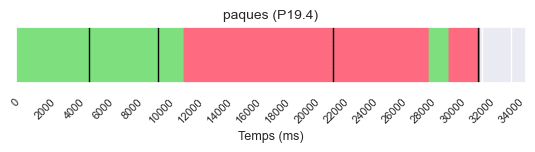

P19_4: 563033it [00:09, 69395.82it/s]

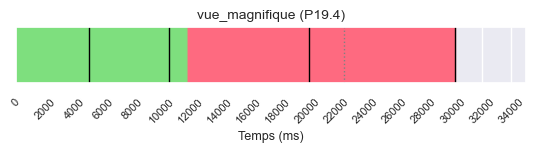

P19_4: 615870it [00:10, 58284.10it/s]
P20_1: 0it [00:00, ?it/s]

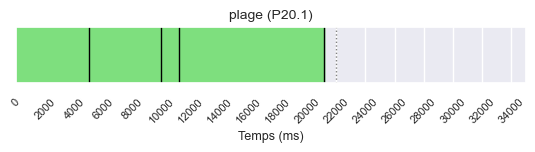

P20_1: 39502it [00:00, 85677.85it/s]

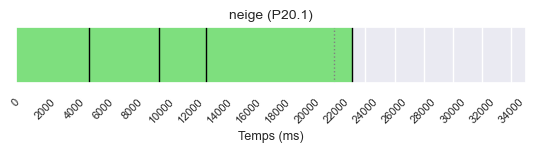

P20_1: 78739it [00:01, 71708.88it/s]

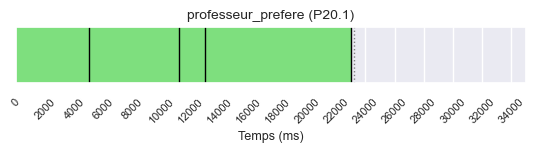

P20_1: 146321it [00:01, 108423.06it/s]

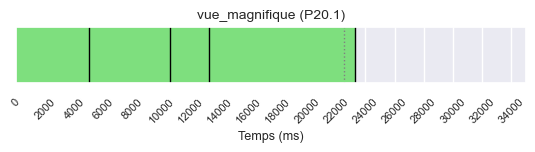

P20_1: 189877it [00:02, 98003.86it/s] 

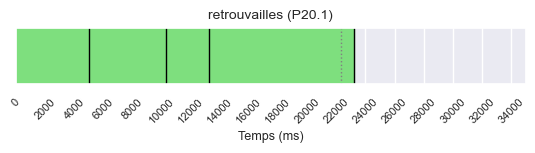

P20_1: 228527it [00:03, 87485.87it/s]

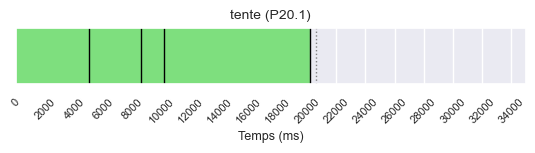

P20_1: 263175it [00:03, 82648.37it/s]

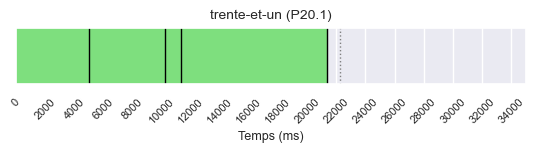

P20_1: 296579it [00:04, 77796.03it/s]

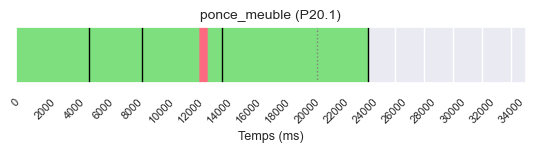

P20_1: 332204it [00:04, 66896.96it/s]

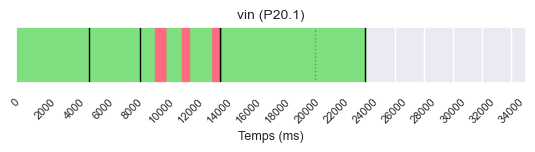

P20_1: 370547it [00:05, 49891.70it/s]

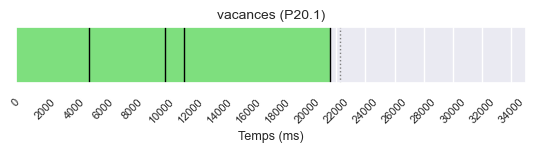

P20_1: 406928it [00:06, 61208.81it/s]

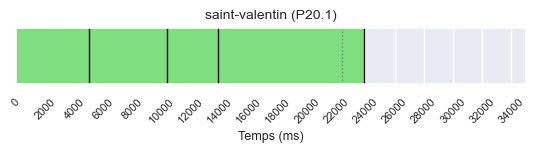

P20_1: 444046it [00:06, 71413.81it/s]

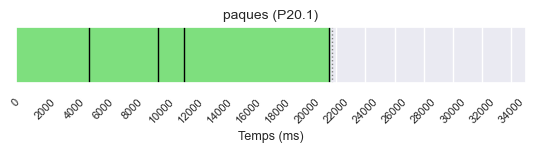

P20_1: 475038it [00:07, 62644.13it/s]
P20_2: 13211it [00:00, 131987.71it/s]

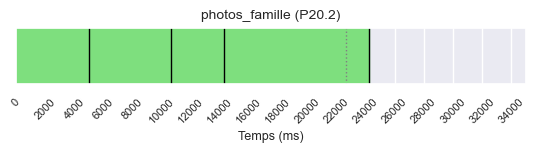

P20_2: 49416it [00:00, 89920.92it/s] 

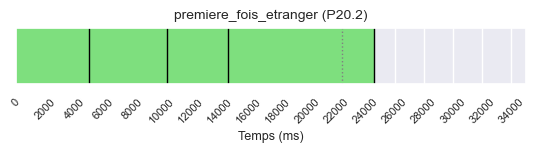

P20_2: 88765it [00:01, 78373.71it/s]

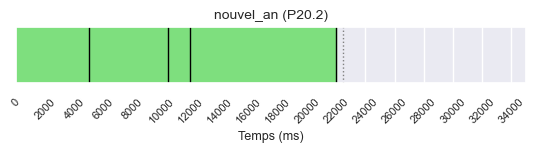

P20_2: 132102it [00:01, 85772.12it/s]

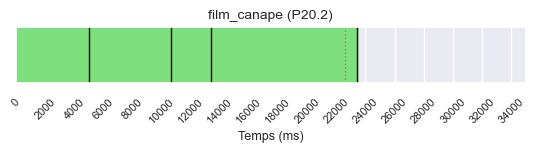

P20_2: 194244it [00:02, 103610.07it/s]

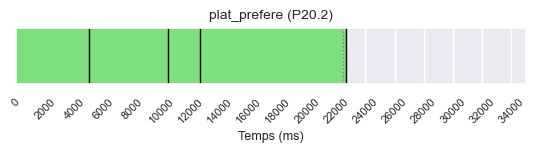

P20_2: 232143it [00:03, 89148.59it/s] 

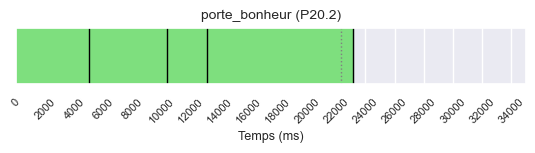

P20_2: 271275it [00:03, 87836.02it/s]

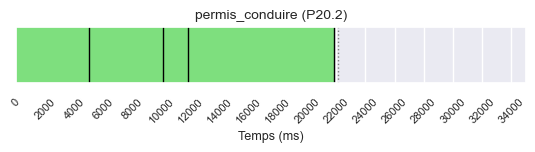

P20_2: 310761it [00:04, 87203.20it/s]

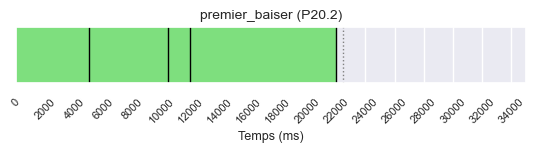

P20_2: 351483it [00:04, 86121.61it/s]

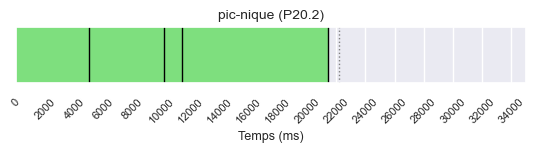

P20_2: 389554it [00:05, 84100.56it/s]

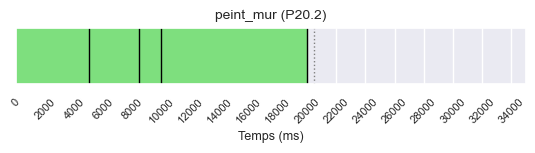

P20_2: 404561it [00:05, 62853.74it/s]

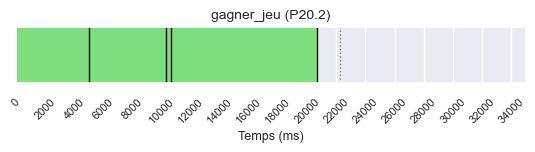

P20_2: 460310it [00:06, 82538.82it/s]

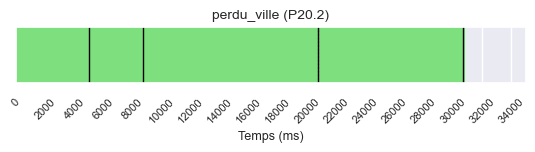

P20_2: 475145it [00:06, 70825.14it/s]
P20_3: 15133it [00:00, 150605.54it/s]

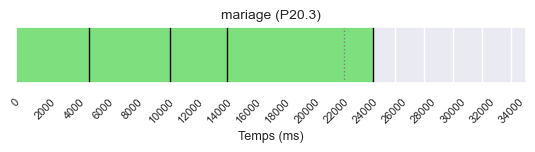

P20_3: 47102it [00:00, 79063.77it/s] 

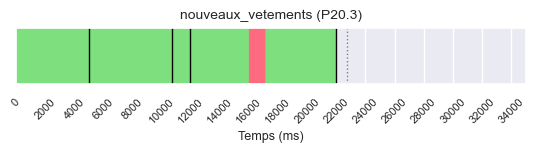

P20_3: 74441it [00:01, 61964.87it/s]

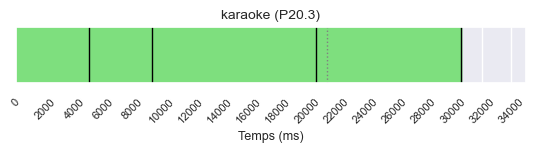

P20_3: 85174it [00:01, 44753.26it/s]

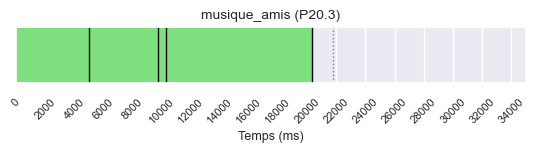

P20_3: 128326it [00:02, 68789.64it/s]

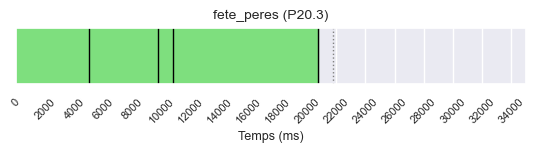

P20_3: 159961it [00:02, 68919.88it/s]

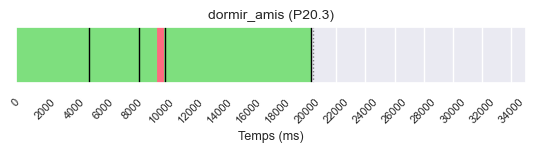

P20_3: 192455it [00:03, 51154.11it/s]

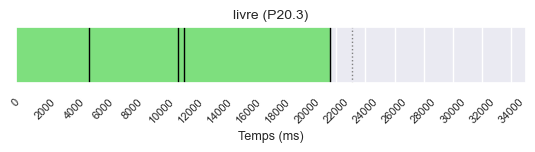

P20_3: 223928it [00:04, 57712.77it/s]

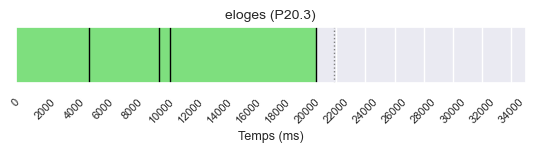

P20_3: 258199it [00:04, 68361.03it/s]

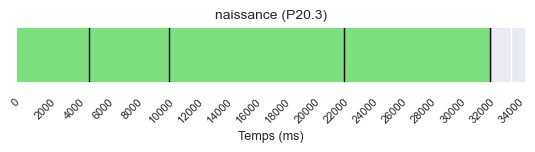

P20_3: 293830it [00:05, 71337.25it/s]

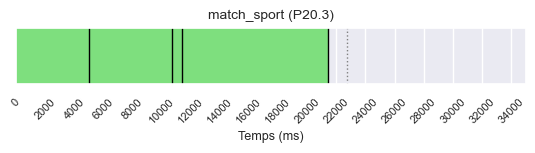

P20_3: 307601it [00:05, 56094.18it/s]

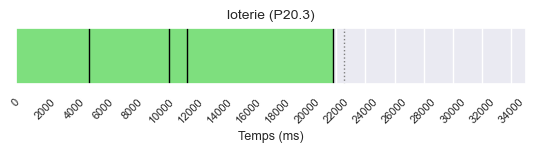

P20_3: 369144it [00:06, 83894.24it/s]

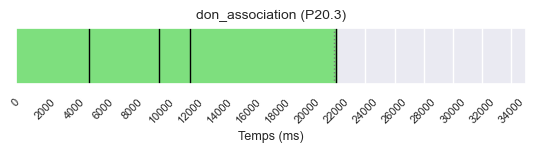

P20_3: 385094it [00:06, 57147.79it/s]
P20_4: 0it [00:00, ?it/s]

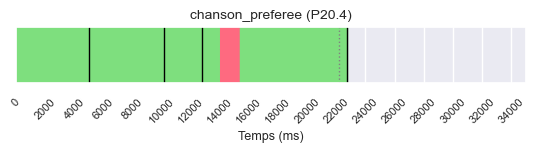

P20_4: 34956it [00:00, 73161.62it/s]

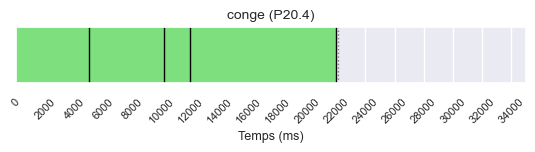

P20_4: 73021it [00:01, 73545.81it/s]

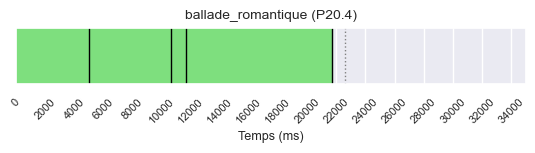

P20_4: 107768it [00:01, 74559.13it/s]

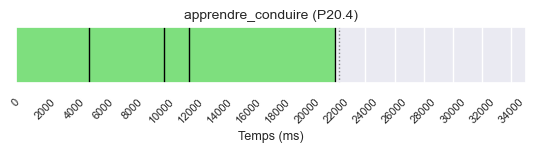

P20_4: 142717it [00:02, 75485.19it/s]

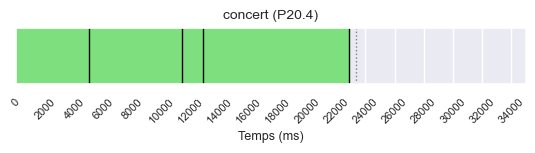

P20_4: 176754it [00:02, 75607.19it/s]

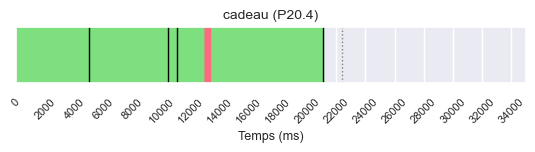

P20_4: 190149it [00:03, 57795.42it/s]

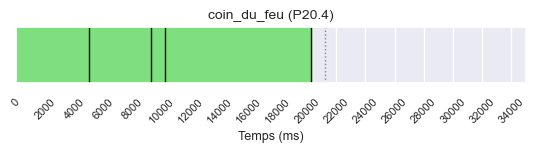

P20_4: 234320it [00:03, 75524.39it/s]

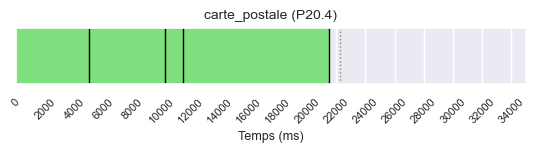

P20_4: 266995it [00:04, 73009.33it/s]

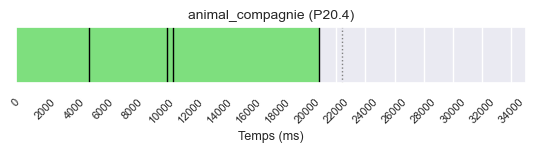

P20_4: 299279it [00:04, 74936.86it/s]

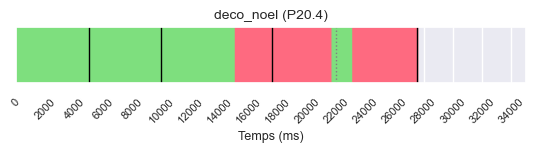

P20_4: 331086it [00:05, 58311.48it/s]

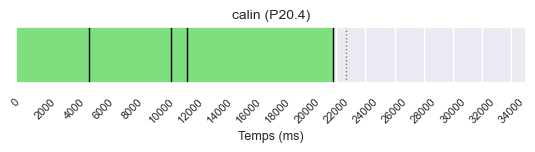

P20_4: 362026it [00:06, 63172.20it/s]

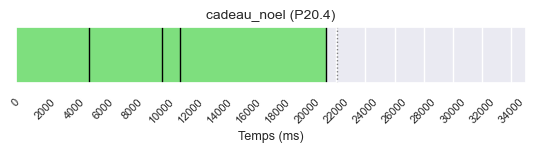

P20_4: 391367it [00:06, 59225.63it/s]
P02_1: 17895it [00:00, 177617.92it/s]

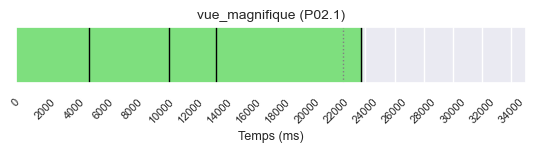

P02_1: 60360it [00:00, 97635.35it/s] 

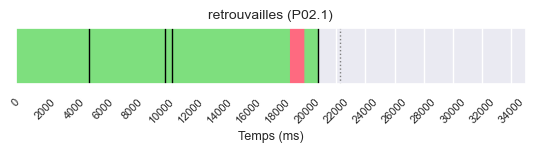

P02_1: 128885it [00:01, 113411.30it/s]

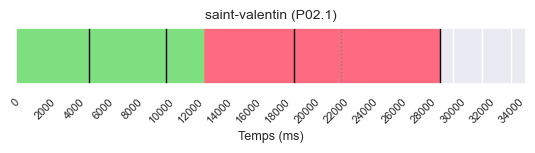

P02_1: 200220it [00:02, 106595.71it/s]

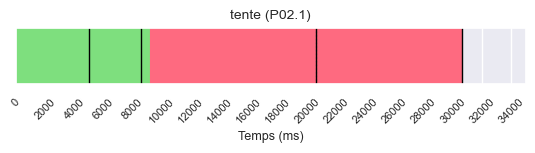

P02_1: 247789it [00:03, 85375.95it/s] 

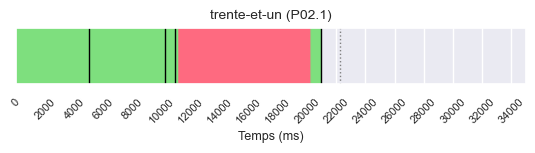

P02_1: 291696it [00:03, 86132.90it/s]

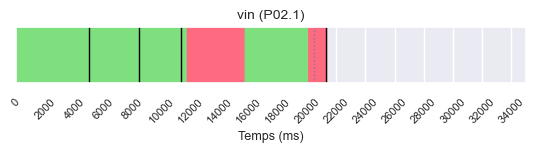

P02_1: 336478it [00:04, 91491.20it/s]

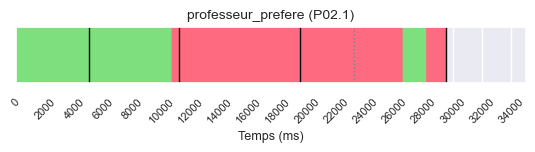

P02_1: 405584it [00:04, 112043.14it/s]

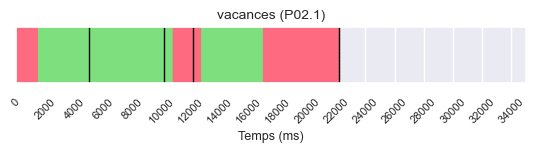

P02_1: 454714it [00:05, 89185.29it/s] 

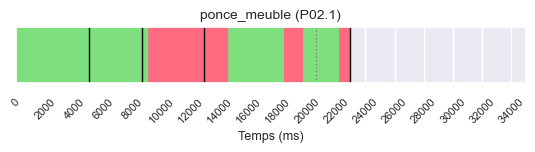

P02_1: 517106it [00:06, 96449.62it/s]

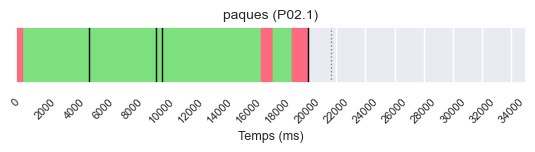

P02_1: 562265it [00:06, 98006.32it/s]

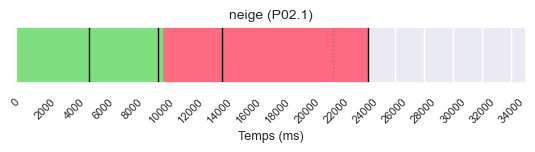

P02_1: 656105it [00:07, 137443.95it/s]

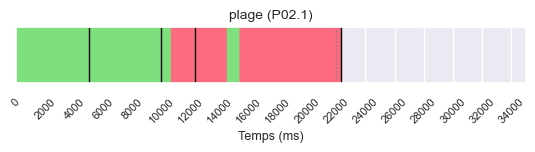

P02_1: 724730it [00:08, 84364.19it/s] 
P02_2: 16613it [00:00, 165946.18it/s]

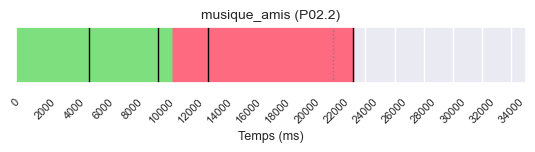

P02_2: 65486it [00:01, 69799.20it/s] 

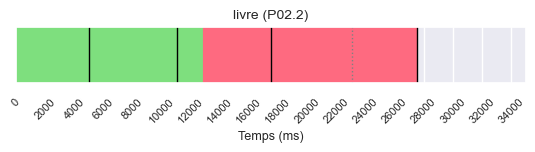

P02_2: 130142it [00:02, 88457.76it/s]

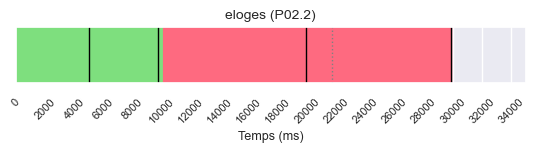

P02_2: 195121it [00:02, 101811.73it/s]

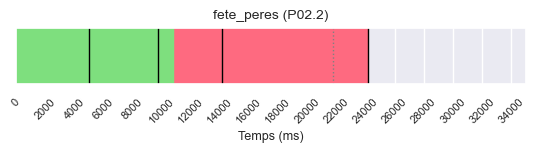

P02_2: 253197it [00:03, 91073.38it/s] 

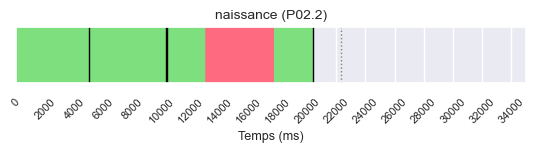

P02_2: 296585it [00:04, 91891.60it/s]

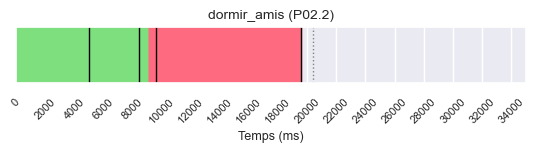

P02_2: 353944it [00:04, 92939.45it/s]

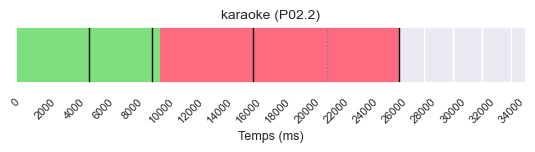

P02_2: 398231it [00:05, 81318.84it/s]

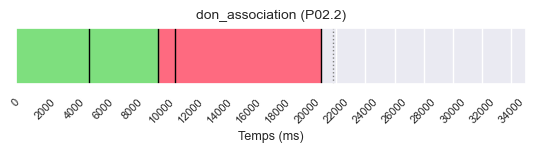

P02_2: 460633it [00:06, 99471.15it/s]

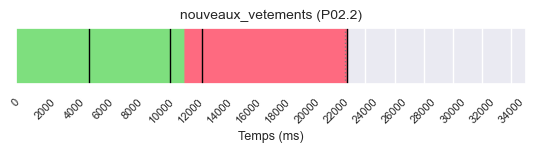

P02_2: 519969it [00:07, 99686.76it/s]

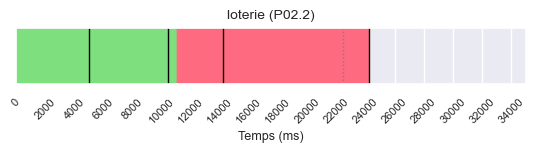

P02_2: 564471it [00:07, 84753.95it/s]

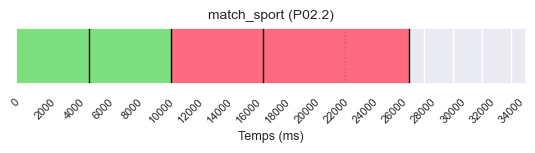

P02_2: 626114it [00:08, 100649.37it/s]

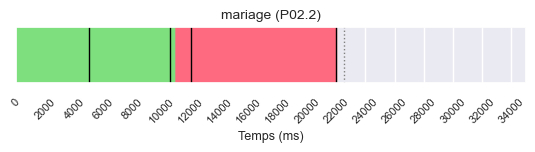

P02_2: 685401it [00:09, 74872.32it/s] 
P02_3: 17559it [00:00, 174572.52it/s]

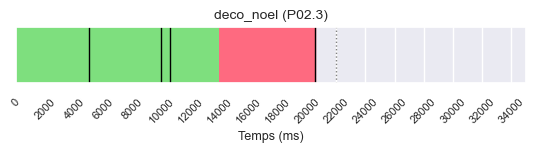

P02_3: 61260it [00:00, 104426.91it/s]

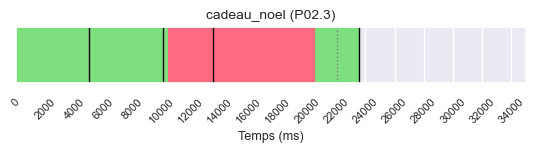

P02_3: 106817it [00:01, 80999.19it/s]

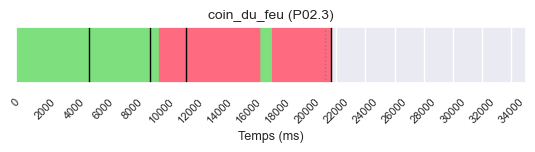

P02_3: 143659it [00:02, 69032.68it/s]

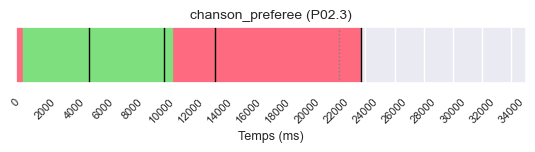

P02_3: 182358it [00:02, 68152.44it/s]

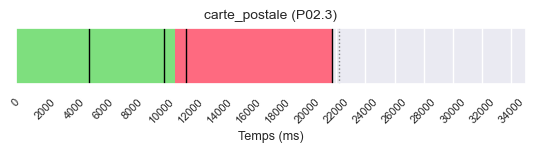

P02_3: 244615it [00:03, 86739.80it/s]

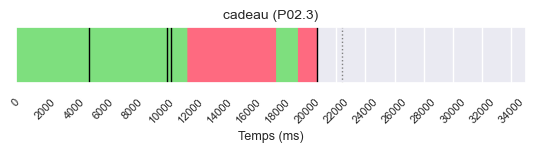

P02_3: 287337it [00:04, 87689.00it/s]

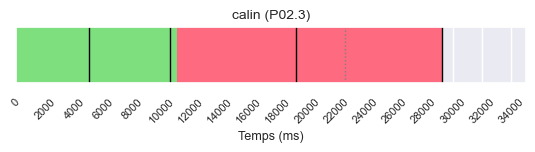

P02_3: 330138it [00:04, 80749.96it/s]

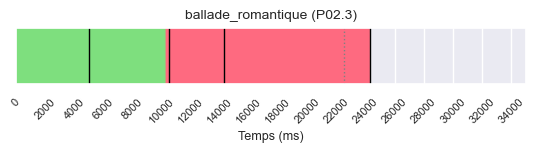

P02_3: 376099it [00:05, 87603.60it/s]

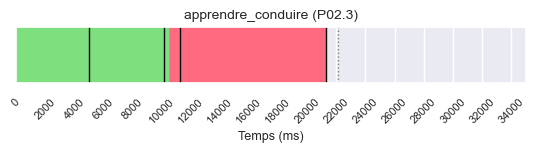

P02_3: 436965it [00:06, 95004.13it/s]

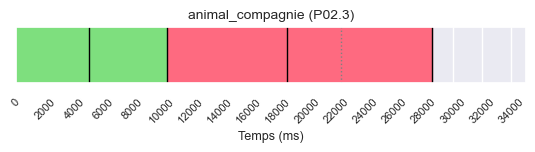

P02_3: 478179it [00:06, 90377.46it/s]

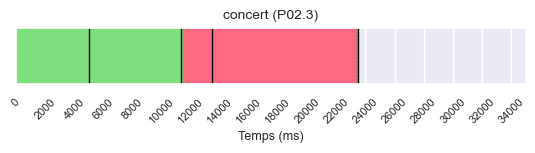

P02_3: 538367it [00:07, 100762.49it/s]

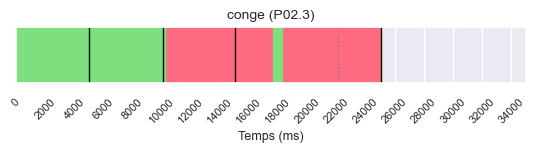

P02_3: 582951it [00:08, 72661.51it/s] 
P02_4: 18709it [00:00, 186184.18it/s]

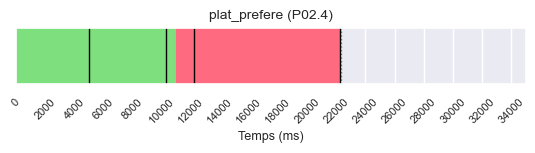

P02_4: 60664it [00:00, 78090.08it/s] 

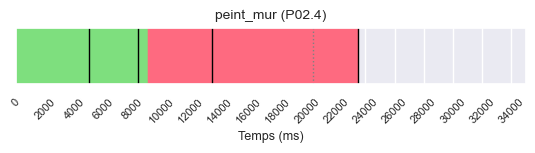

P02_4: 104160it [00:01, 68367.83it/s]

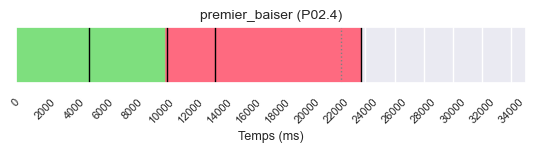

P02_4: 147076it [00:02, 76830.87it/s]

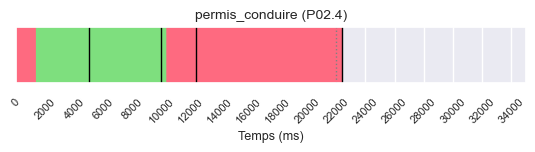

P02_4: 212024it [00:02, 94349.27it/s]

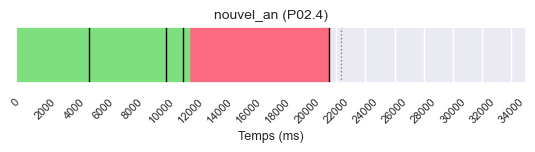

P02_4: 258770it [00:03, 97642.00it/s]

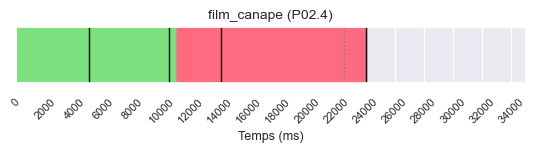

P02_4: 301187it [00:04, 88280.00it/s]

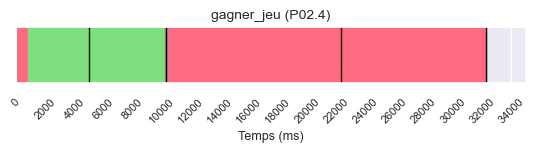

P02_4: 345620it [00:04, 86081.14it/s]

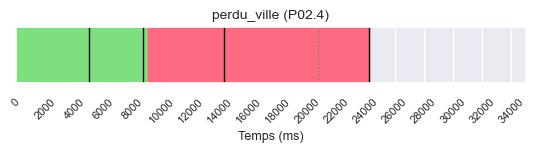

P02_4: 405674it [00:05, 96684.72it/s]

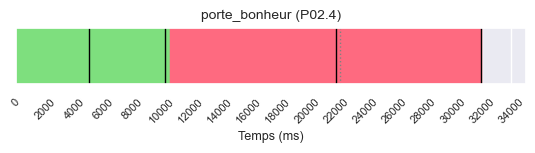

P02_4: 448846it [00:06, 83336.31it/s]

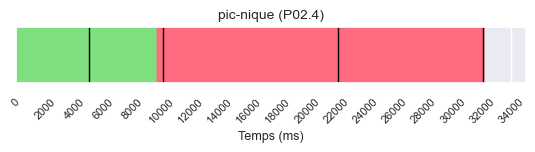

P02_4: 515334it [00:06, 107722.67it/s]

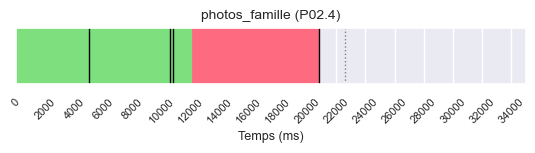

P02_4: 559577it [00:07, 101232.72it/s]

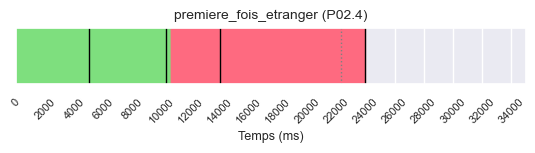

P02_4: 626997it [00:08, 76717.71it/s] 
P21_1: 0it [00:00, ?it/s]

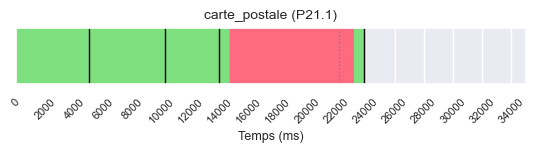

P21_1: 60514it [00:00, 118819.06it/s]

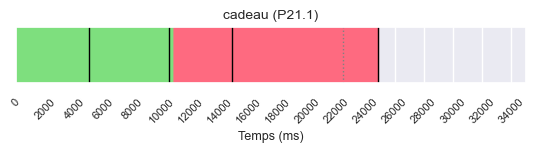

P21_1: 130392it [00:01, 109497.91it/s]

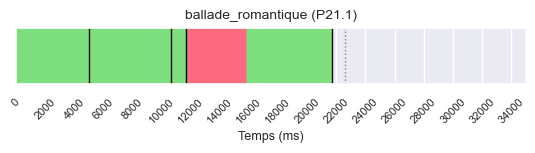

P21_1: 168498it [00:02, 93249.54it/s] 

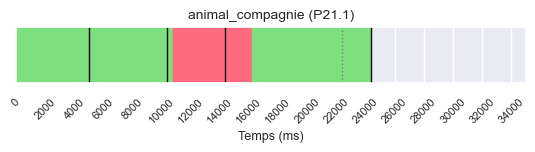

P21_1: 213484it [00:02, 83397.96it/s]

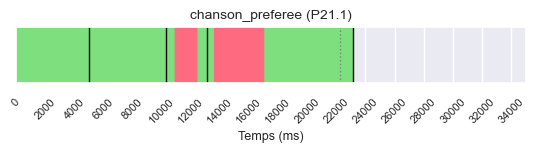

P21_1: 259265it [00:03, 76615.62it/s]

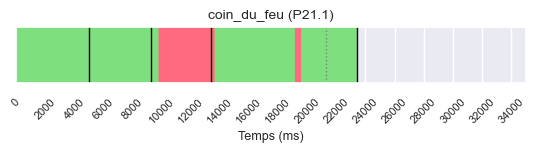

P21_1: 301010it [00:04, 70206.52it/s]

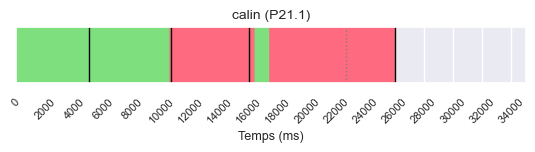

P21_1: 341018it [00:04, 78863.71it/s]

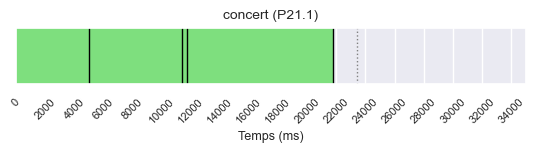

P21_1: 382565it [00:05, 82525.20it/s]

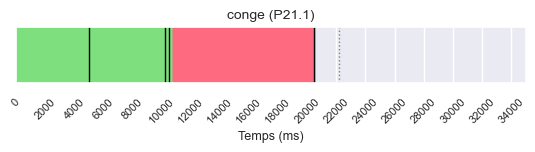

P21_1: 425969it [00:05, 90734.45it/s]

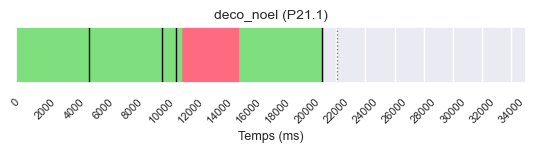

P21_1: 462466it [00:06, 84568.54it/s]

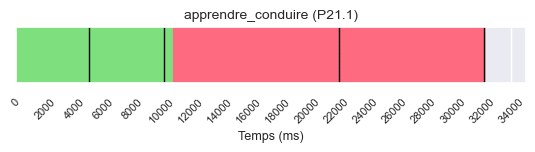

P21_1: 477442it [00:06, 52600.42it/s]

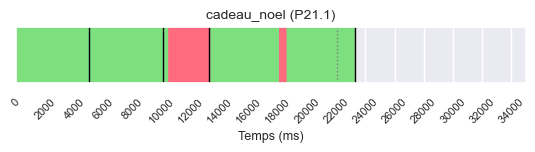

P21_1: 525120it [00:07, 66929.30it/s]
P21_2: 12439it [00:00, 123929.77it/s]

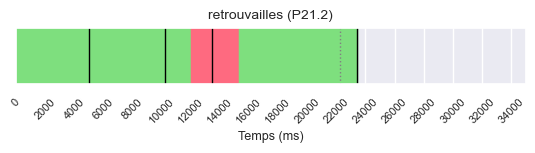

P21_2: 49583it [00:00, 80651.43it/s] 

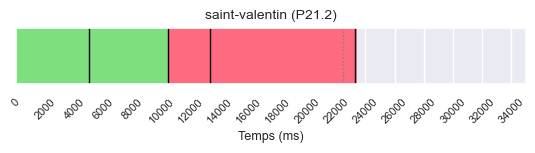

P21_2: 117354it [00:01, 109131.80it/s]

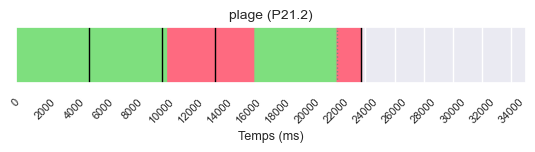

P21_2: 161839it [00:02, 89135.77it/s] 

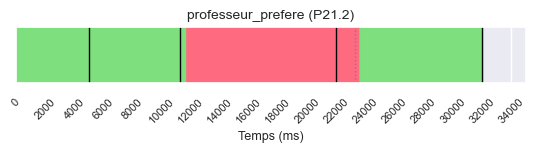

P21_2: 208430it [00:02, 82746.76it/s]

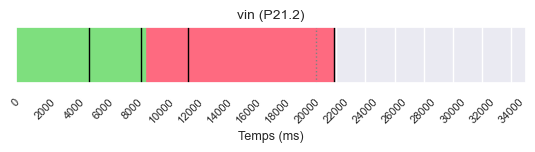

P21_2: 249952it [00:03, 77121.05it/s]

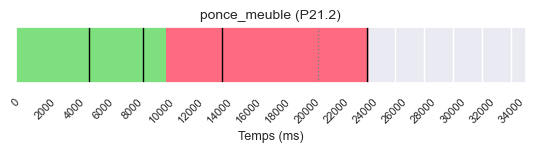

P21_2: 293420it [00:04, 73202.88it/s]

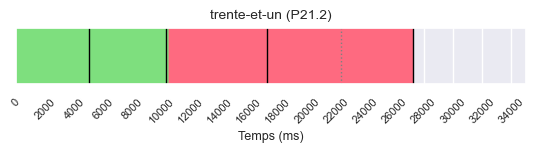

P21_2: 339659it [00:04, 77263.82it/s]

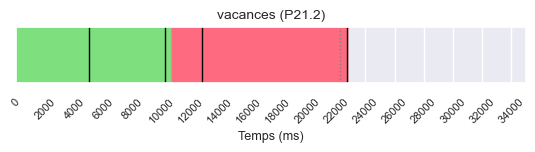

P21_2: 384853it [00:05, 78507.10it/s]

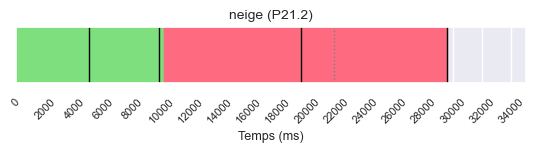

P21_2: 424663it [00:06, 74265.79it/s]

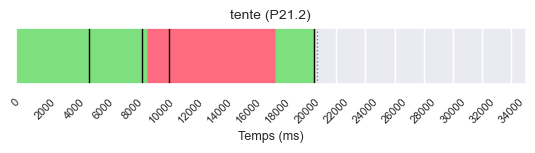

P21_2: 463450it [00:06, 73815.08it/s]

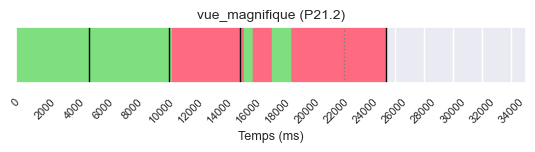

P21_2: 502080it [00:07, 76995.92it/s]

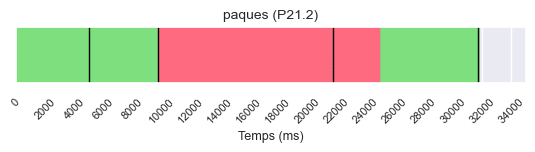

P21_2: 547351it [00:07, 68612.03it/s]
P21_3: 15277it [00:00, 150201.79it/s]

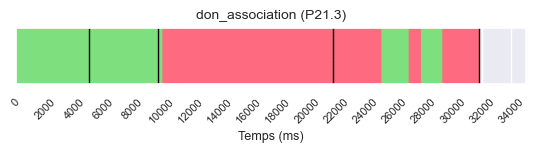

P21_3: 51287it [00:00, 79809.08it/s] 

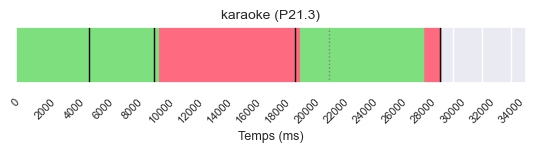

P21_3: 91686it [00:01, 71616.44it/s]

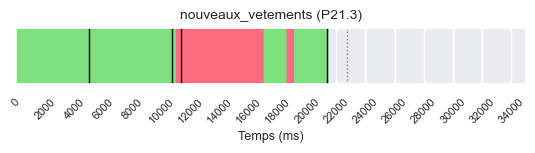

P21_3: 132659it [00:02, 75586.04it/s]

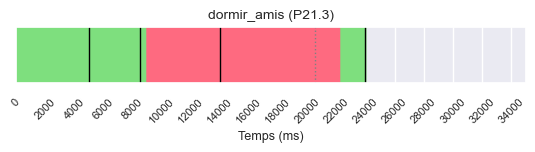

P21_3: 164710it [00:02, 64397.26it/s]

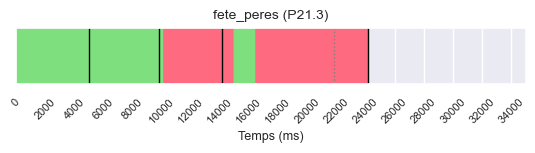

P21_3: 208251it [00:03, 72306.93it/s]

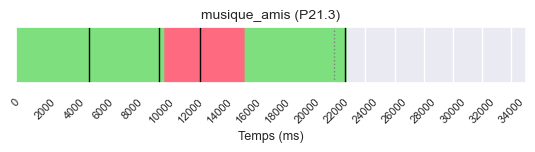

P21_3: 248969it [00:03, 74612.94it/s]

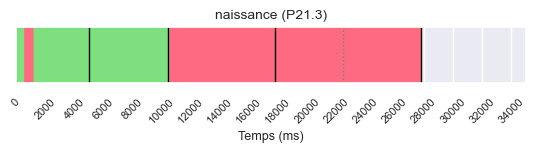

P21_3: 295886it [00:04, 84501.74it/s]

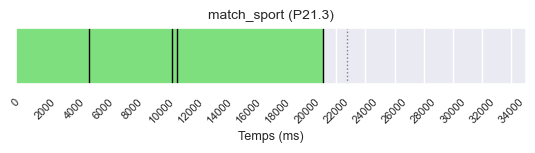

P21_3: 333399it [00:05, 80689.37it/s]

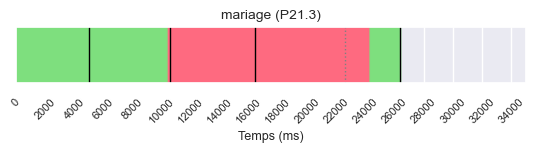

P21_3: 374398it [00:05, 83491.79it/s]

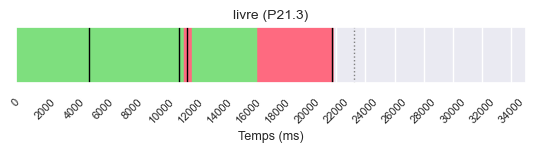

P21_3: 439784it [00:06, 100487.11it/s]

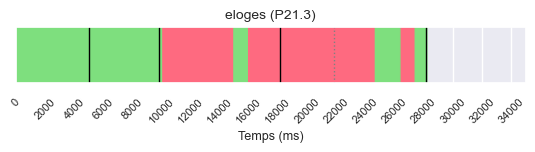

P21_3: 480785it [00:07, 75286.30it/s] 

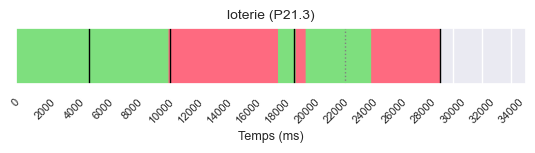

P21_3: 507407it [00:07, 65996.95it/s]
P21_4: 16638it [00:00, 157848.52it/s]

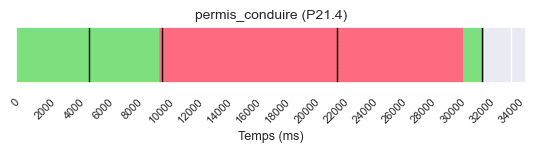

P21_4: 32423it [00:00, 47262.74it/s] 

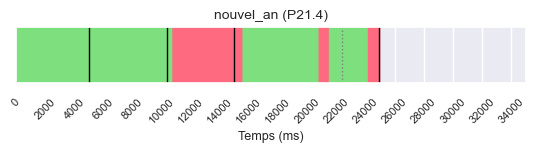

P21_4: 64613it [00:01, 52989.89it/s]

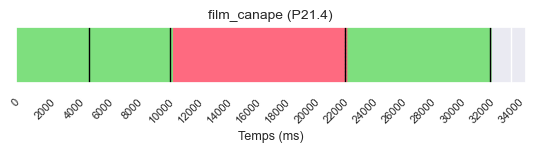

P21_4: 104036it [00:01, 64391.37it/s]

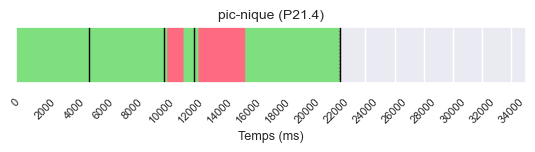

P21_4: 144698it [00:02, 73320.01it/s]

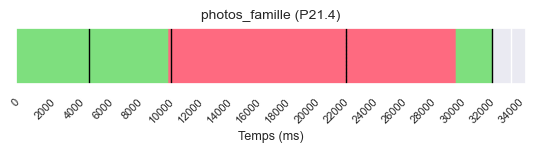

P21_4: 187325it [00:03, 79994.26it/s]

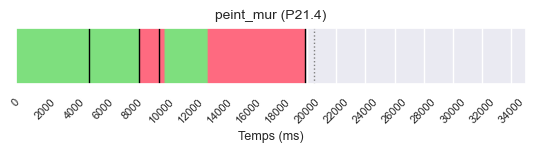

P21_4: 228262it [00:03, 86258.79it/s]

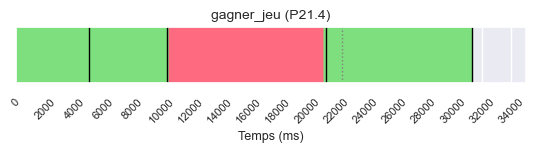

P21_4: 270763it [00:04, 85364.28it/s]

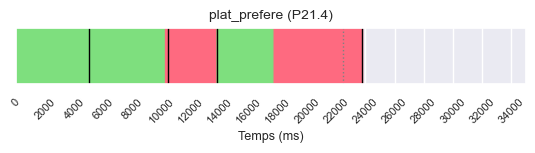

P21_4: 309766it [00:04, 81481.08it/s]

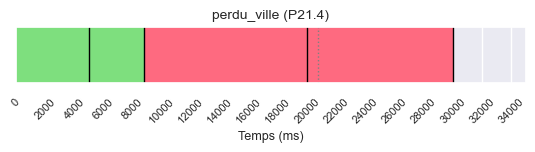

P21_4: 352652it [00:05, 89137.52it/s]

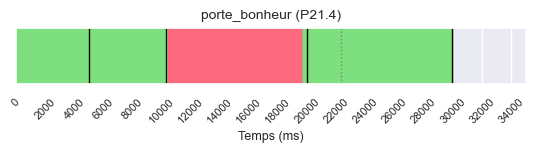

P21_4: 398241it [00:05, 89666.79it/s]

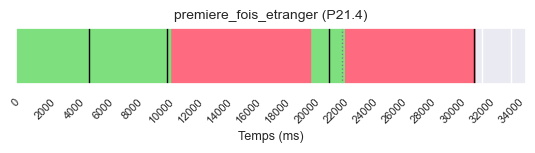

P21_4: 440703it [00:06, 82301.86it/s]

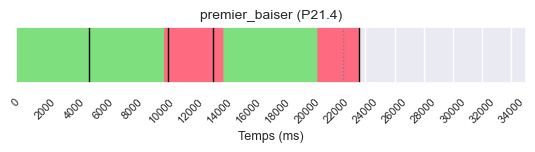

P21_4: 481872it [00:07, 67306.67it/s]
P22_1: 23130it [00:00, 229791.94it/s]

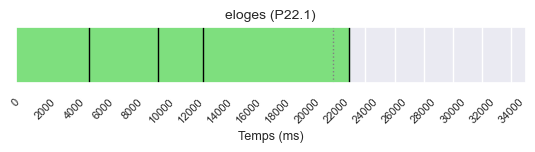

P22_1: 74377it [00:00, 119950.25it/s]

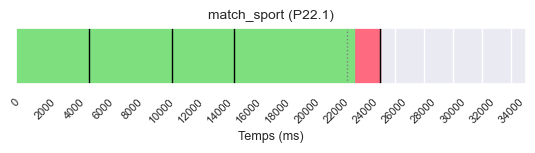

P22_1: 118768it [00:01, 90334.06it/s]

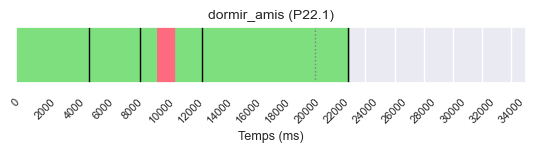

P22_1: 159154it [00:02, 73374.88it/s]

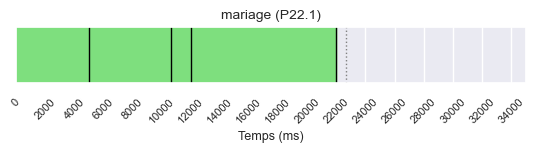

P22_1: 194775it [00:02, 71793.38it/s]

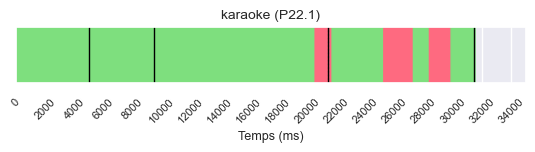

P22_1: 225675it [00:03, 60246.27it/s]

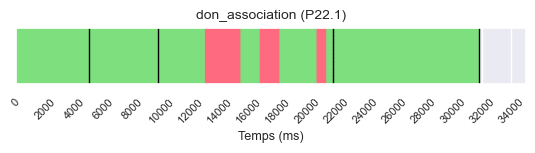

P22_1: 261739it [00:04, 48333.61it/s]

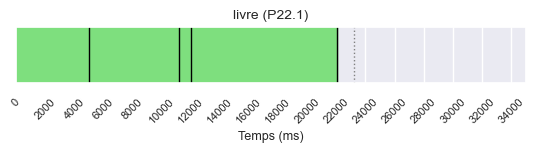

P22_1: 296479it [00:04, 59271.72it/s]

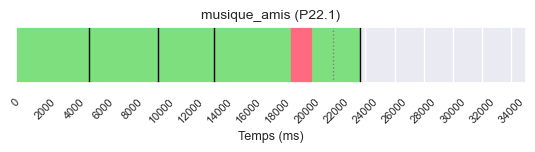

P22_1: 332845it [00:05, 67463.13it/s]

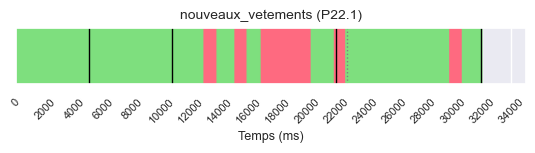

P22_1: 369780it [00:06, 47117.80it/s]

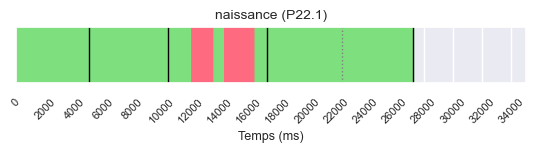

P22_1: 425761it [00:07, 61117.90it/s]

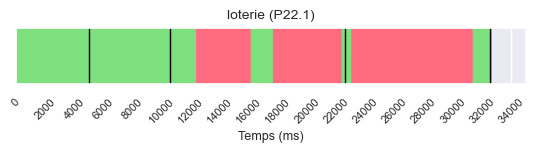

P22_1: 440885it [00:08, 36691.47it/s]

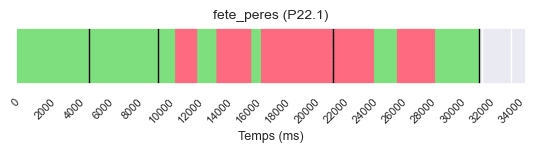

P22_1: 467621it [00:09, 47459.39it/s]
P22_2: 14017it [00:00, 135807.70it/s]

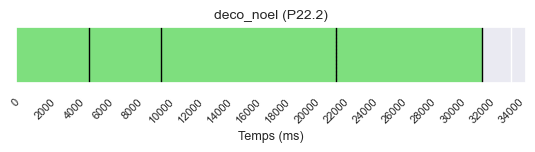

P22_2: 50411it [00:00, 87318.39it/s] 

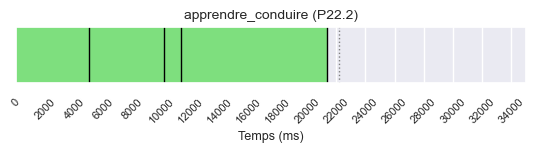

P22_2: 87842it [00:01, 76133.53it/s]

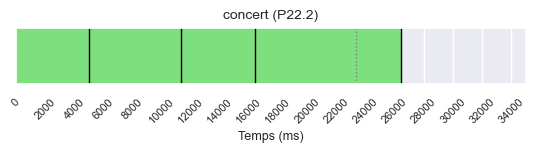

P22_2: 125572it [00:01, 81706.92it/s]

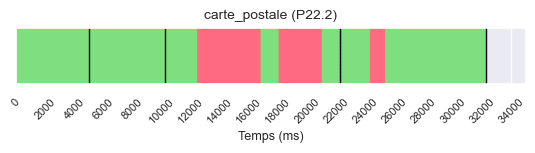

P22_2: 167386it [00:02, 61670.78it/s]

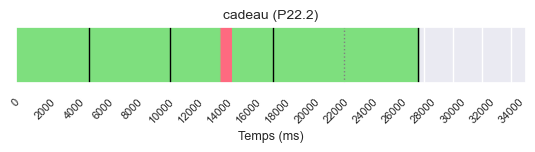

P22_2: 209436it [00:03, 64301.86it/s]

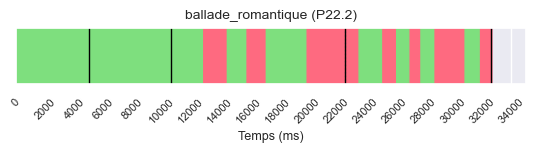

P22_2: 242641it [00:04, 46214.75it/s]

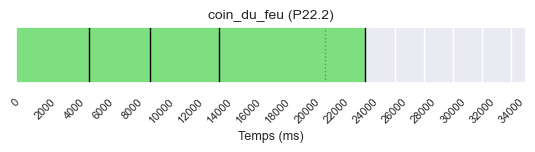

P22_2: 275904it [00:05, 55669.32it/s]

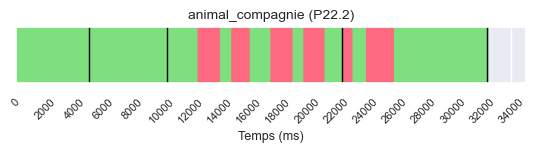

P22_2: 311368it [00:06, 40161.60it/s]

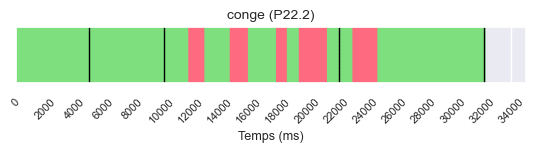

P22_2: 373334it [00:07, 54626.15it/s]

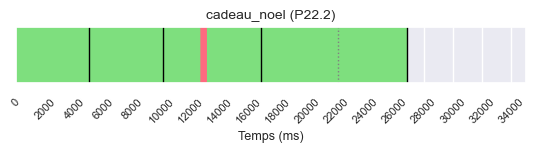

P22_2: 412362it [00:08, 58215.87it/s]

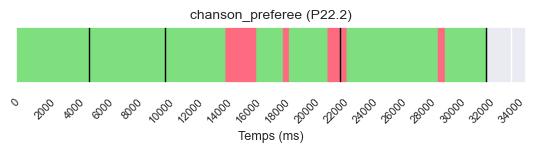

P22_2: 427708it [00:09, 32781.56it/s]

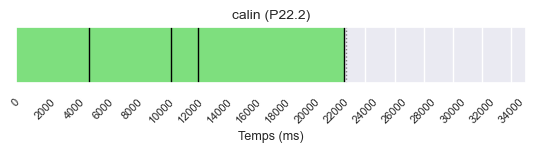

P22_2: 464273it [00:10, 44838.61it/s]
P22_3: 14072it [00:00, 130546.98it/s]

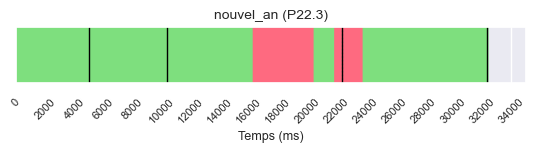

P22_3: 46835it [00:01, 46214.04it/s] 

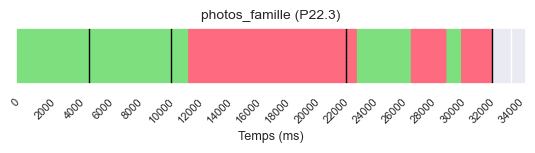

P22_3: 78238it [00:01, 45863.41it/s]

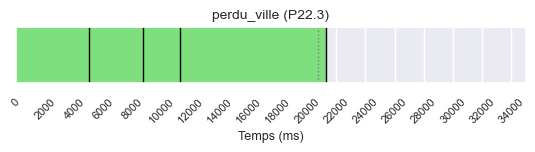

P22_3: 112324it [00:02, 60315.39it/s]

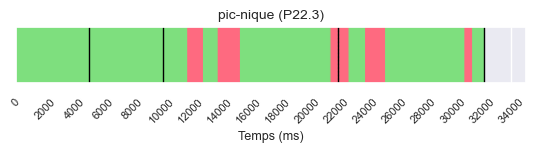

P22_3: 145346it [00:03, 44876.62it/s]

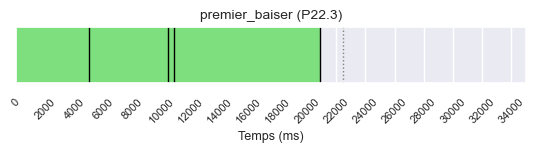

P22_3: 185400it [00:04, 62181.07it/s]

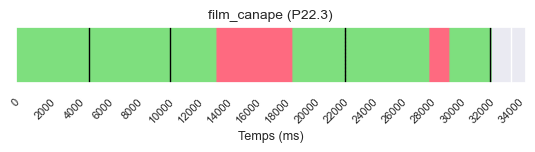

P22_3: 222103it [00:04, 60321.78it/s]

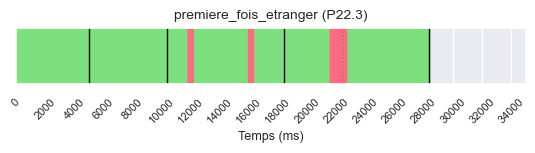

P22_3: 280123it [00:05, 64853.25it/s]

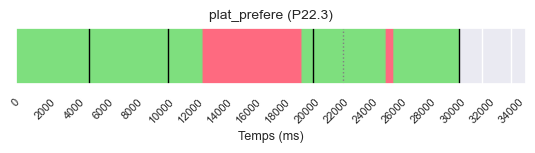

P22_3: 314330it [00:06, 63233.03it/s]

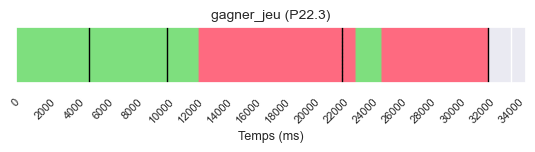

P22_3: 327612it [00:07, 41926.63it/s]

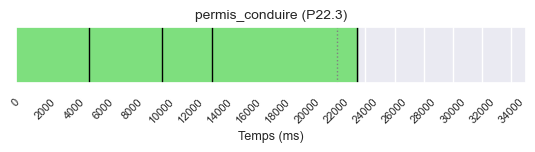

P22_3: 370493it [00:07, 61699.29it/s]

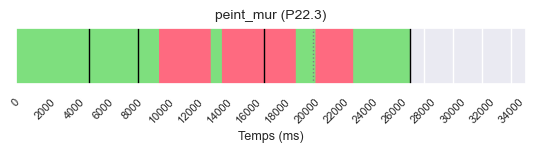

P22_3: 426433it [00:08, 67622.34it/s]

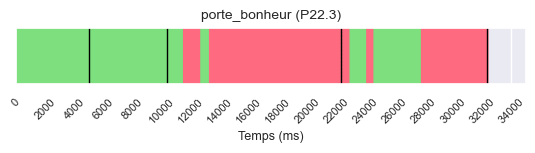

P22_3: 436952it [00:09, 45468.56it/s]
P22_4: 15166it [00:00, 146547.76it/s]

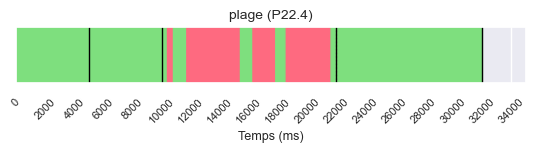

P22_4: 55302it [00:01, 43878.52it/s] 

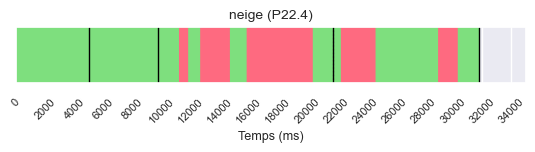

P22_4: 93716it [00:02, 38369.27it/s]

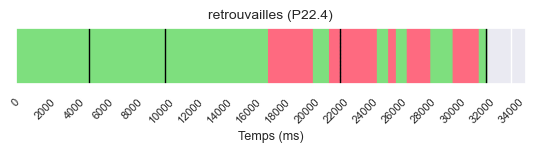

P22_4: 107871it [00:03, 27803.92it/s]

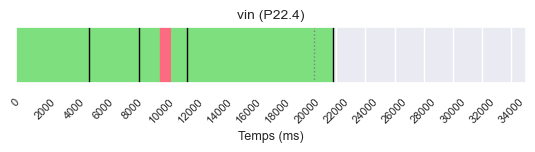

P22_4: 162467it [00:04, 50619.75it/s]

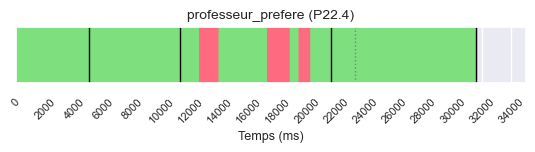

P22_4: 200981it [00:05, 43690.15it/s]

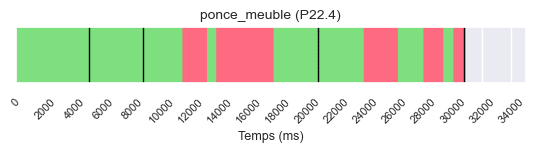

P22_4: 231499it [00:06, 40122.42it/s]

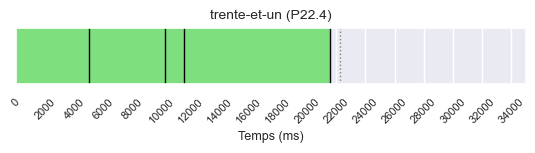

P22_4: 264526it [00:07, 53134.55it/s]

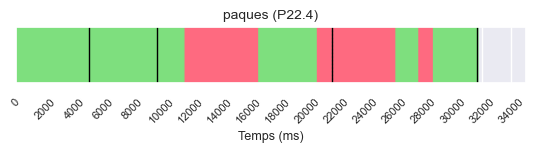

P22_4: 292583it [00:08, 42851.61it/s]

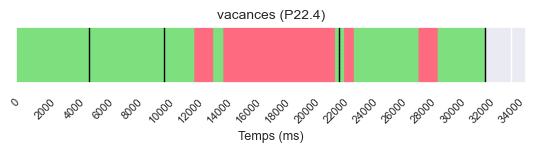

P22_4: 328803it [00:08, 47466.88it/s]

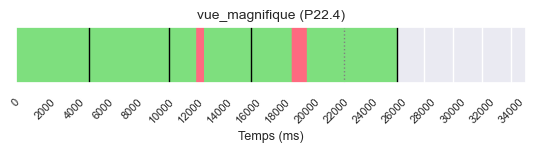

P22_4: 383558it [00:09, 63065.76it/s]

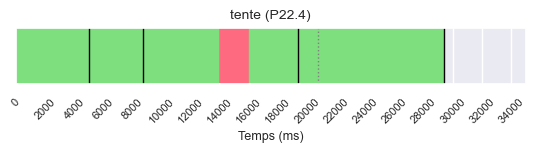

P22_4: 414250it [00:10, 55011.28it/s]

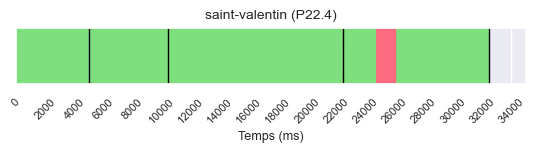

P22_4: 432195it [00:11, 38541.87it/s]
P23_1: 14686it [00:00, 145694.74it/s]

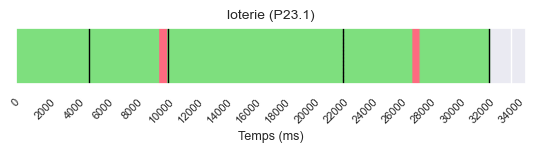

P23_1: 55490it [00:00, 91253.93it/s] 

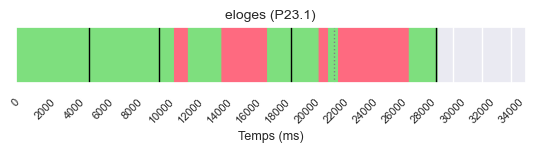

P23_1: 118412it [00:01, 82363.38it/s]

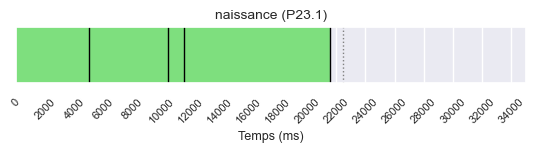

P23_1: 181885it [00:02, 107341.73it/s]

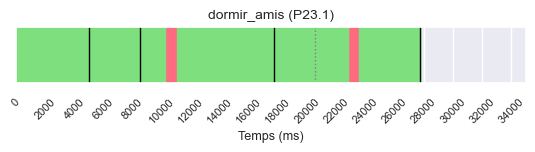

P23_1: 226468it [00:03, 86502.34it/s] 

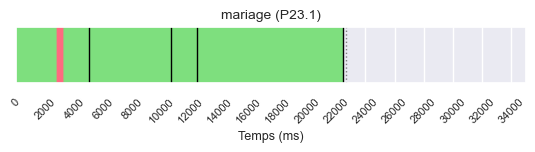

P23_1: 297486it [00:03, 115661.09it/s]

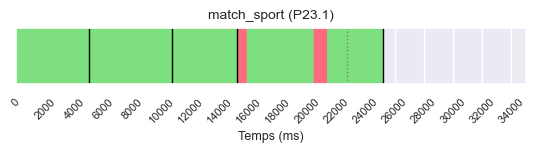

P23_1: 358004it [00:04, 115417.95it/s]

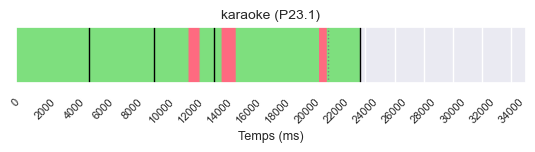

P23_1: 405234it [00:05, 90532.67it/s] 

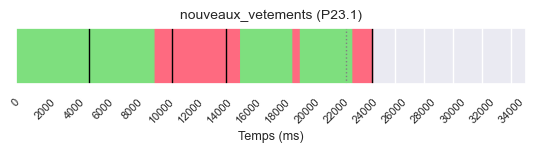

P23_1: 446017it [00:05, 84890.88it/s]

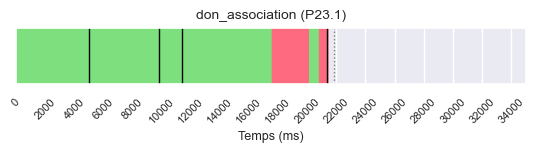

P23_1: 491956it [00:06, 90125.72it/s]

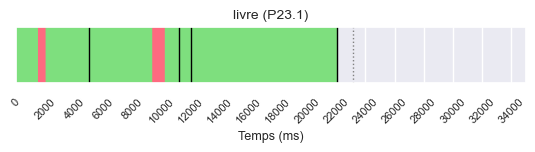

P23_1: 536265it [00:06, 92023.21it/s]

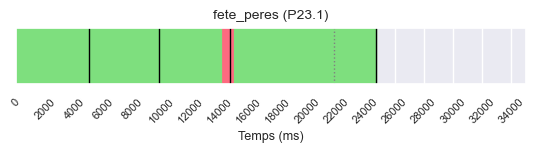

P23_1: 597345it [00:07, 82694.87it/s]

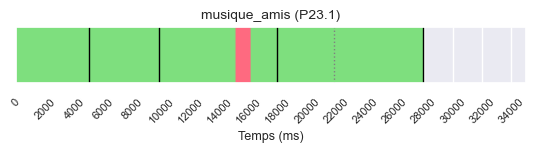

P23_1: 639811it [00:08, 74735.32it/s]
P23_2: 12360it [00:00, 123575.66it/s]

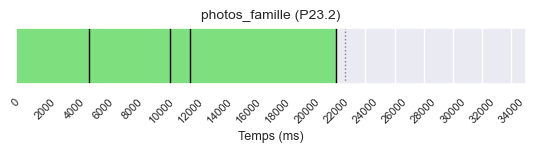

P23_2: 69793it [00:00, 115466.58it/s]

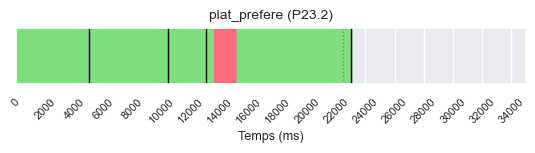

P23_2: 112997it [00:01, 92418.96it/s]

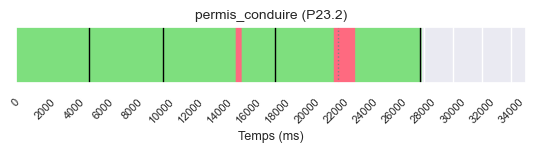

P23_2: 157619it [00:02, 76123.53it/s]

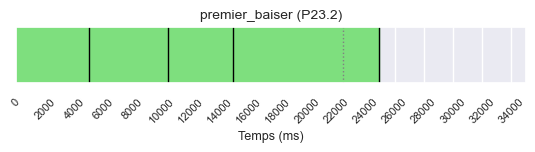

P23_2: 217238it [00:02, 93334.85it/s]

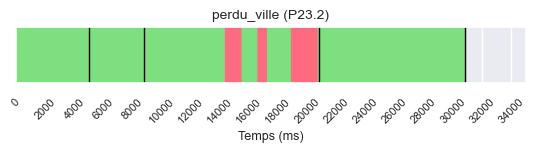

P23_2: 256884it [00:04, 55221.50it/s]

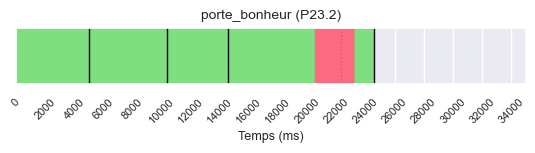

P23_2: 297144it [00:04, 66983.46it/s]

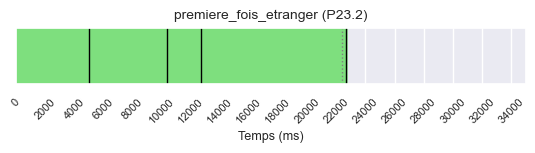

P23_2: 358690it [00:05, 87408.06it/s]

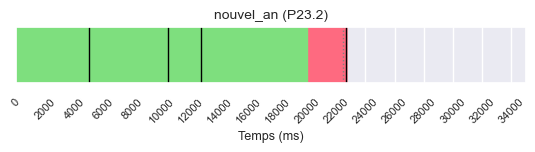

P23_2: 397836it [00:05, 86326.19it/s]

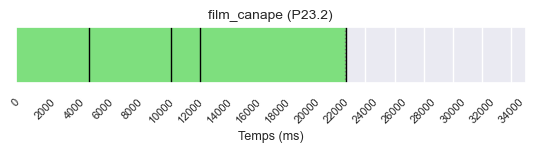

P23_2: 437127it [00:06, 68426.90it/s]

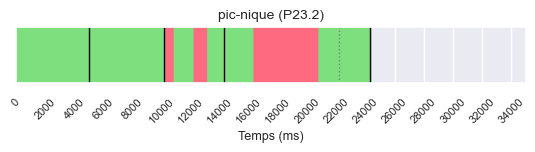

P23_2: 491562it [00:07, 72222.64it/s]

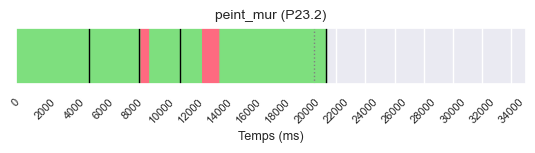

P23_2: 548598it [00:08, 88116.05it/s]

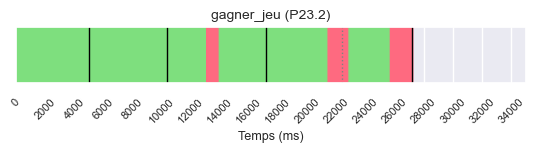

P23_2: 581737it [00:09, 62497.25it/s]
P23_3: 14102it [00:00, 140736.94it/s]

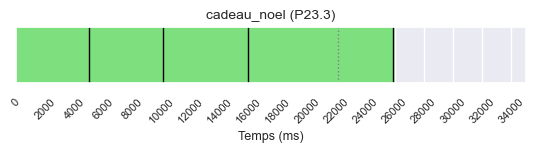

P23_3: 53954it [00:00, 93037.13it/s] 

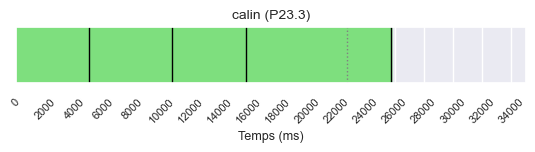

P23_3: 98016it [00:01, 85874.60it/s]

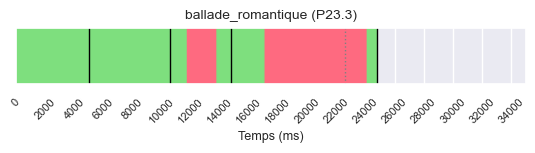

P23_3: 141276it [00:02, 75318.80it/s]

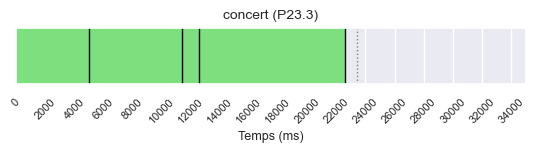

P23_3: 202956it [00:02, 92341.97it/s]

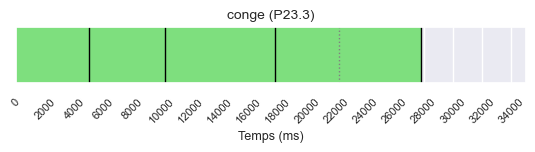

P23_3: 260068it [00:03, 102400.48it/s]

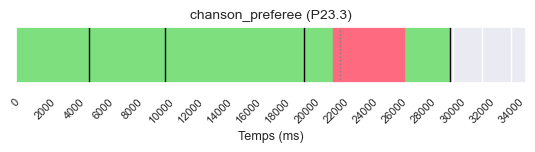

P23_3: 298718it [00:03, 94217.45it/s] 

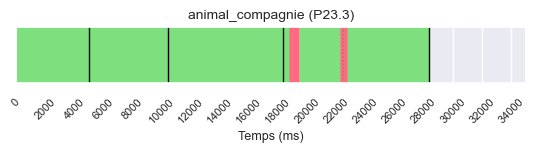

P23_3: 340070it [00:04, 92255.48it/s]

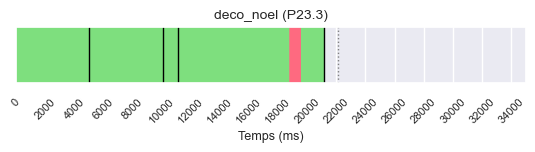

P23_3: 403420it [00:05, 106126.72it/s]

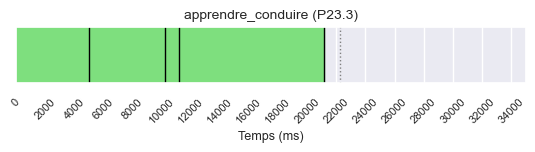

P23_3: 442546it [00:05, 97848.84it/s] 

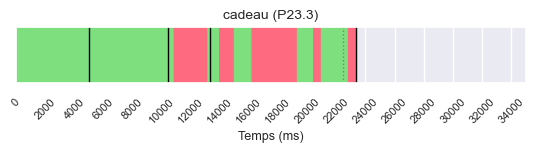

P23_3: 480782it [00:06, 82071.80it/s]

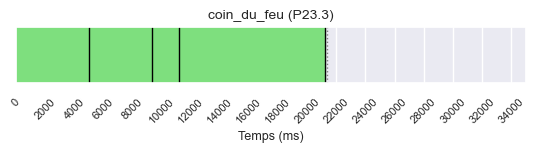

P23_3: 524348it [00:06, 89217.62it/s]

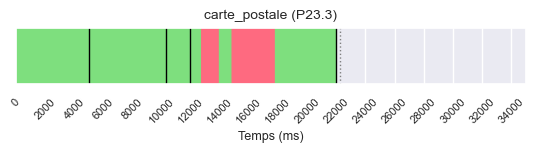

P23_3: 573844it [00:07, 78571.25it/s]
P23_4: 5778it [00:00, 57434.16it/s]

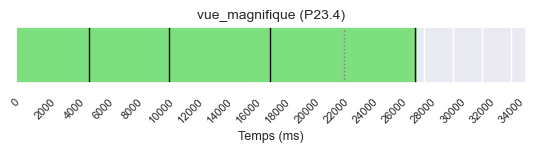

P23_4: 66888it [00:00, 115446.40it/s]

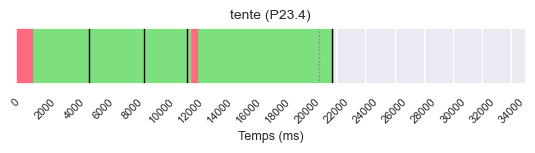

P23_4: 107568it [00:01, 89925.47it/s]

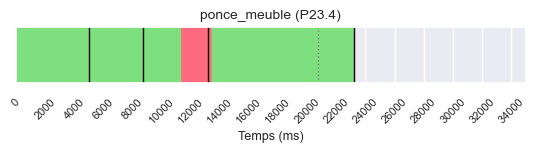

P23_4: 147848it [00:02, 72002.15it/s]

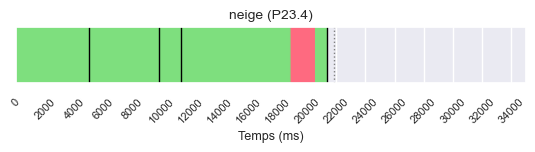

P23_4: 188386it [00:02, 78346.81it/s]

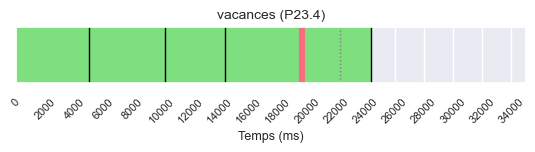

P23_4: 246429it [00:03, 93617.47it/s]

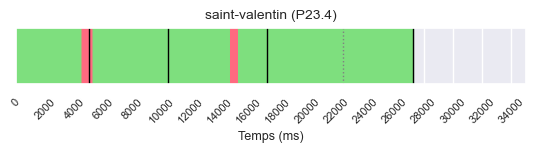

P23_4: 262698it [00:03, 56256.95it/s]

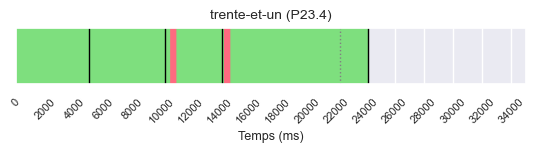

P23_4: 312181it [00:04, 68086.66it/s]

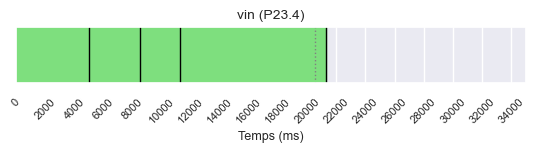

P23_4: 351087it [00:05, 74469.32it/s]

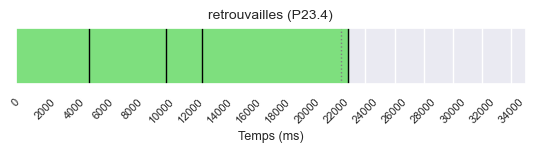

P23_4: 409725it [00:06, 95879.30it/s]

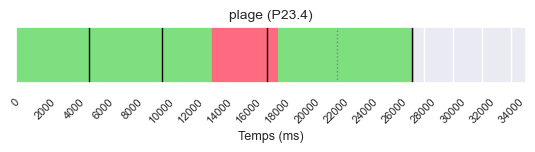

P23_4: 450047it [00:06, 70656.51it/s]

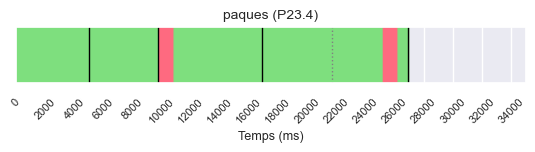

P23_4: 491240it [00:07, 77737.33it/s]

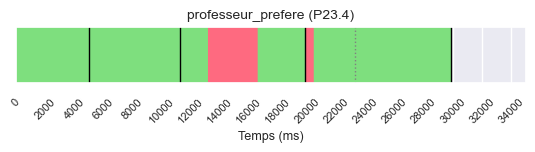

P23_4: 536891it [00:08, 62158.47it/s]
P24_1: 14987it [00:00, 149506.56it/s]

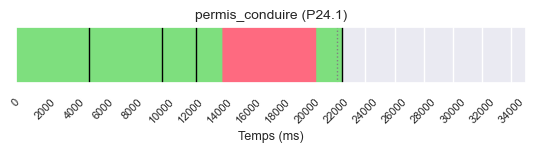

P24_1: 53335it [00:00, 99655.15it/s] 

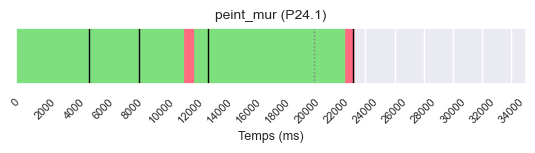

P24_1: 90987it [00:01, 64873.84it/s]

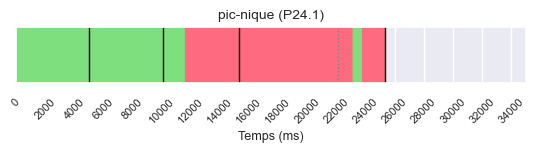

P24_1: 129284it [00:02, 62444.25it/s]

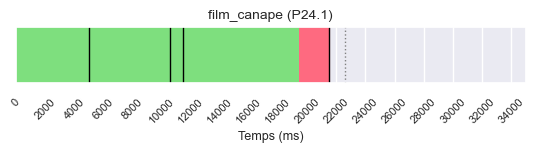

P24_1: 163823it [00:02, 61627.54it/s]

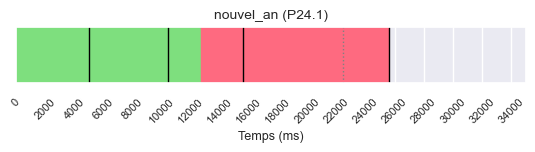

P24_1: 226949it [00:03, 77664.35it/s]

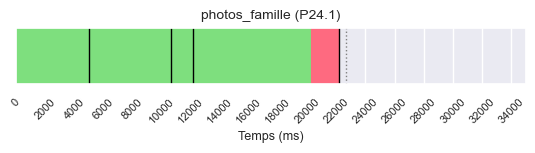

P24_1: 264696it [00:04, 72717.27it/s]

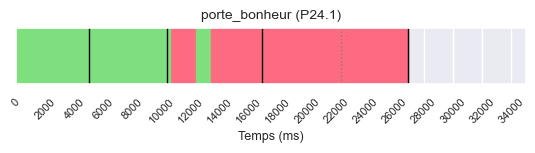

P24_1: 317363it [00:05, 68534.84it/s]

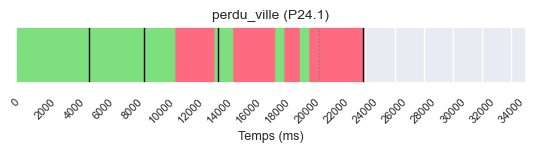

P24_1: 351419it [00:06, 59917.83it/s]

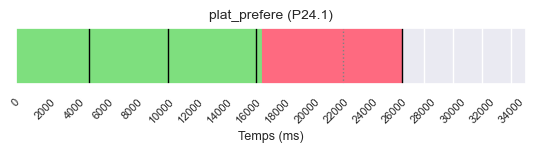

P24_1: 416678it [00:06, 96193.41it/s]

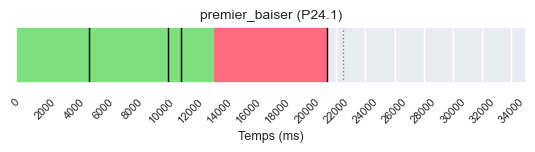

P24_1: 460334it [00:07, 98471.80it/s]

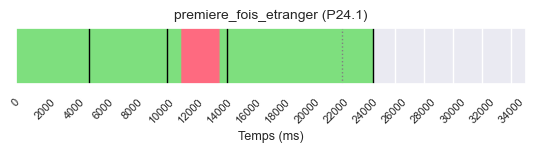

P24_1: 506730it [00:08, 85217.37it/s]

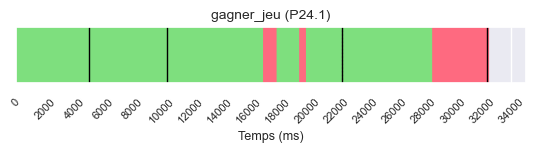

P24_1: 542201it [00:09, 59712.52it/s]
P24_2: 9707it [00:00, 96856.03it/s]

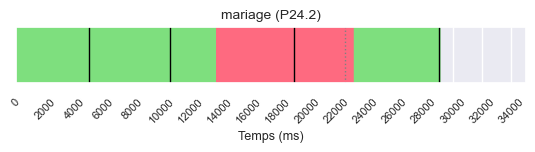

P24_2: 84584it [00:01, 120994.13it/s]

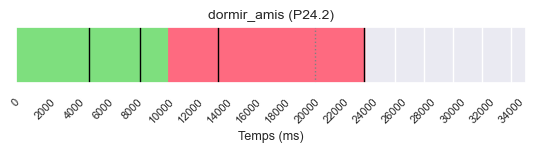

P24_2: 130954it [00:01, 76524.58it/s]

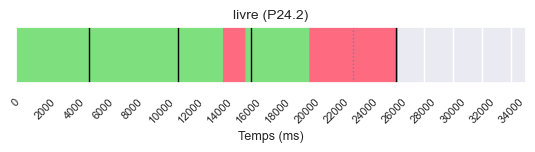

P24_2: 170887it [00:02, 70617.08it/s]

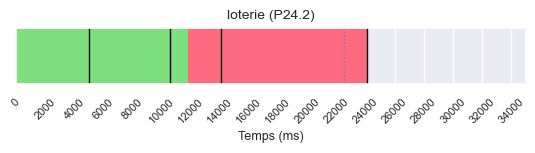

P24_2: 226681it [00:03, 77157.53it/s]

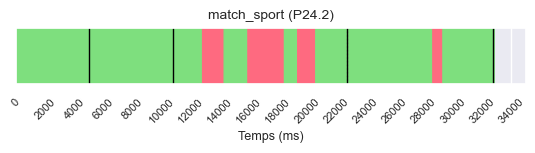

P24_2: 264447it [00:04, 52501.86it/s]

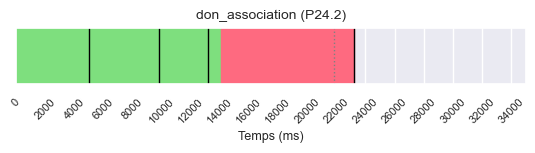

P24_2: 306169it [00:05, 65667.19it/s]

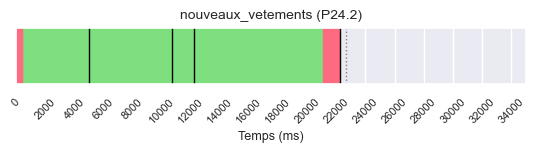

P24_2: 343541it [00:05, 73351.76it/s]

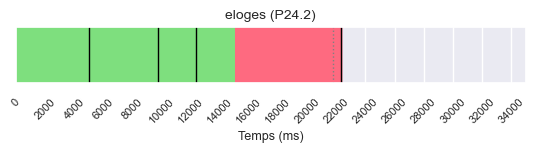

P24_2: 388524it [00:06, 89099.35it/s]

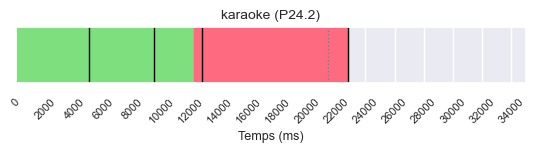

P24_2: 435304it [00:07, 79661.96it/s]

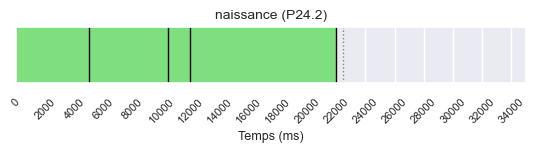

P24_2: 504393it [00:07, 108481.94it/s]

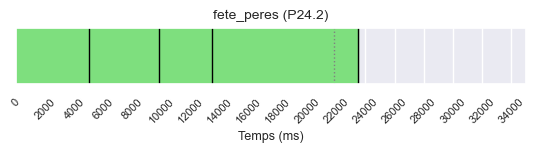

P24_2: 546812it [00:08, 98263.93it/s] 

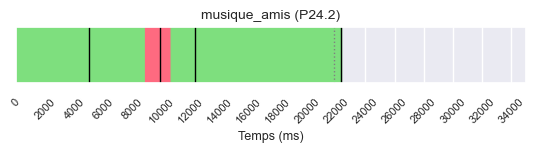

P24_2: 570071it [00:08, 66139.58it/s]
P24_3: 13875it [00:00, 138336.54it/s]

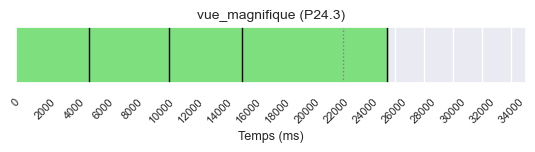

P24_3: 49239it [00:00, 86901.34it/s] 

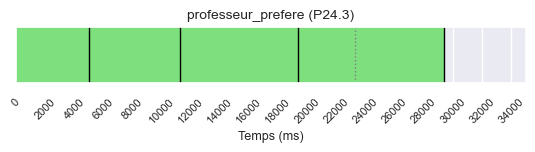

P24_3: 95352it [00:01, 87907.96it/s]

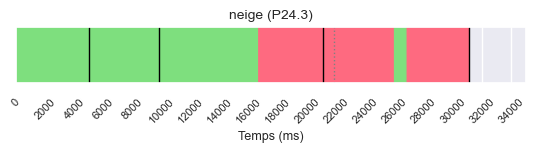

P24_3: 141014it [00:01, 80825.04it/s]

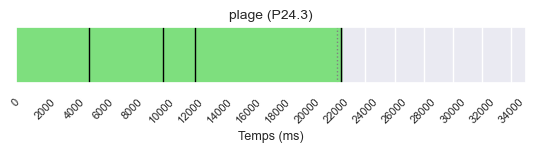

P24_3: 181833it [00:02, 84504.67it/s]

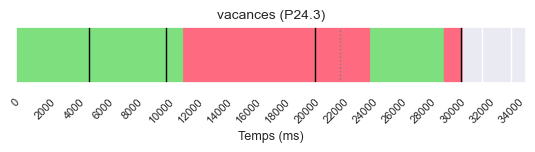

P24_3: 243553it [00:03, 94584.90it/s]

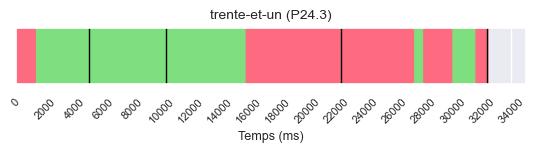

P24_3: 285466it [00:03, 77470.61it/s]

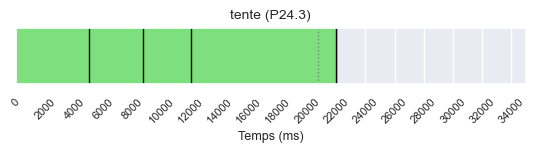

P24_3: 329542it [00:04, 86477.39it/s]

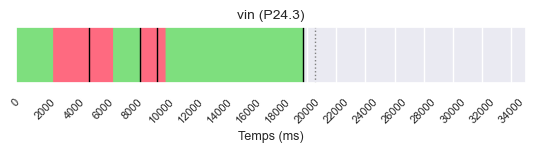

P24_3: 372567it [00:05, 92562.02it/s]

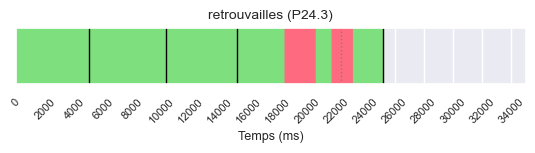

P24_3: 417093it [00:05, 92456.38it/s]

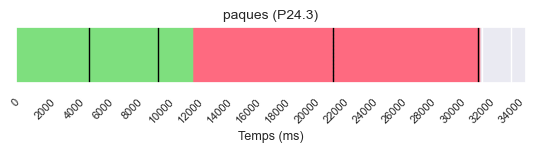

P24_3: 454401it [00:06, 72895.85it/s]

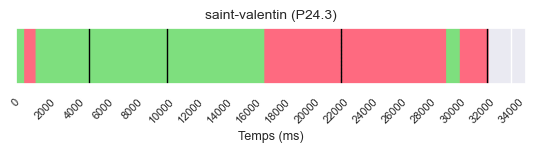

P24_3: 486625it [00:06, 68003.69it/s]

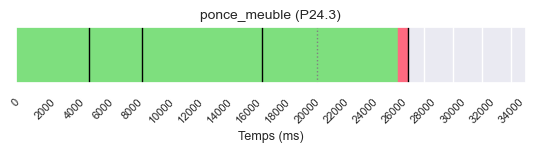

P24_3: 526776it [00:07, 70792.98it/s]
P24_4: 15295it [00:00, 152354.43it/s]

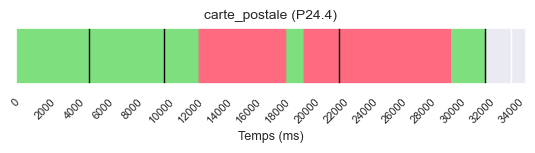

P24_4: 51842it [00:01, 53263.54it/s] 

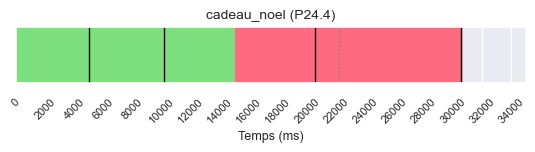

P24_4: 99164it [00:01, 65408.48it/s]

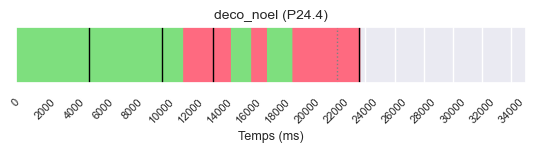

P24_4: 141900it [00:02, 66309.30it/s]

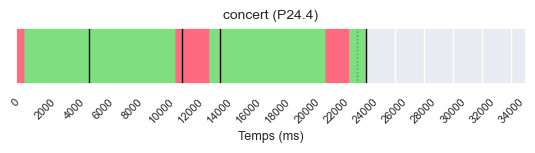

P24_4: 186685it [00:03, 78633.09it/s]

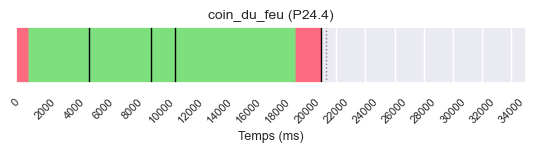

P24_4: 235866it [00:03, 92831.88it/s]

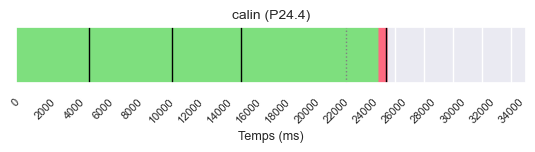

P24_4: 277133it [00:04, 84136.49it/s]

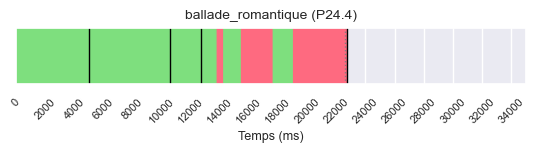

P24_4: 320724it [00:04, 91526.18it/s]

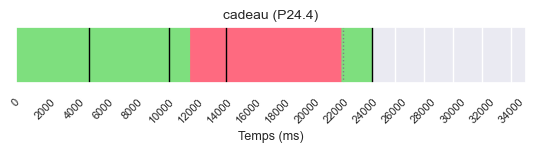

P24_4: 363288it [00:05, 80799.82it/s]

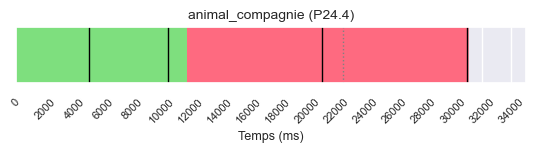

P24_4: 403972it [00:06, 70843.09it/s]

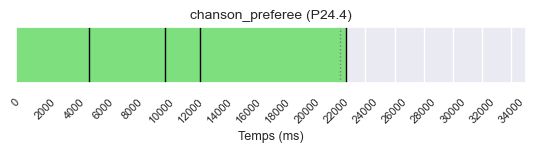

P24_4: 441574it [00:06, 77351.34it/s]

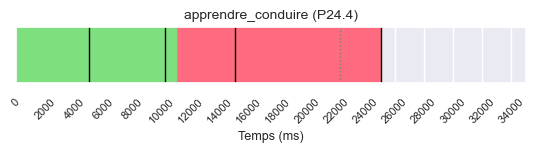

P24_4: 482452it [00:07, 73007.87it/s]

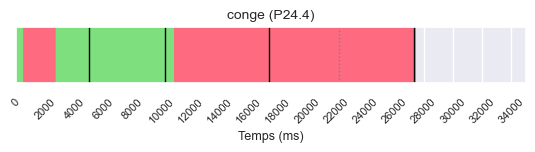

P24_4: 517264it [00:08, 63065.40it/s]
P25_1: 16243it [00:00, 159791.54it/s]

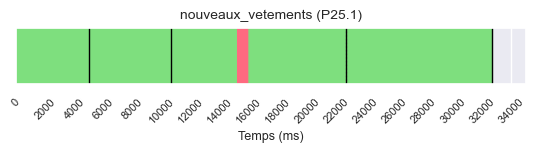

P25_1: 59225it [00:00, 81135.30it/s] 

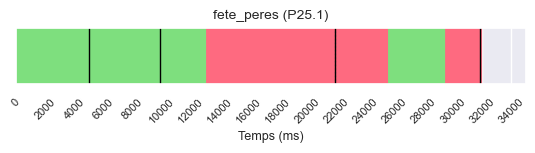

P25_1: 100059it [00:01, 62212.16it/s]

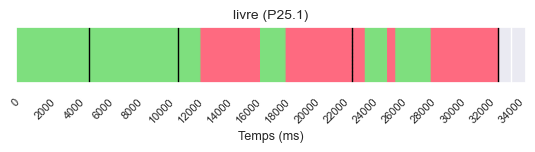

P25_1: 178268it [00:02, 95904.29it/s]

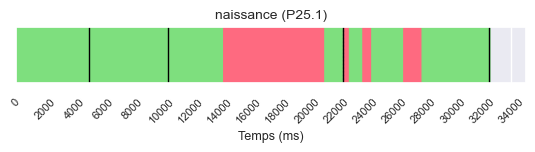

P25_1: 227394it [00:03, 74843.86it/s]

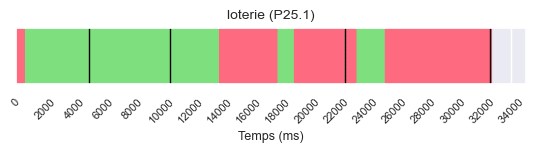

P25_1: 288539it [00:04, 78824.47it/s]

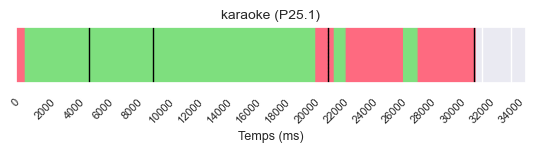

P25_1: 330841it [00:05, 71118.74it/s]

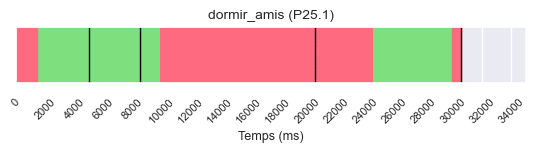

P25_1: 378982it [00:06, 77487.40it/s]

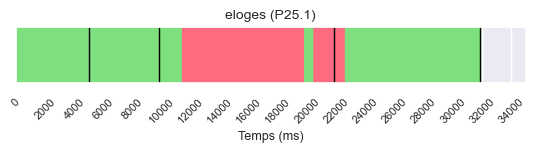

P25_1: 464445it [00:07, 97095.23it/s]

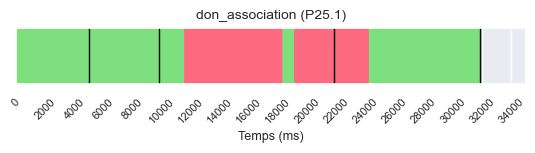

P25_1: 510075it [00:08, 76222.99it/s]

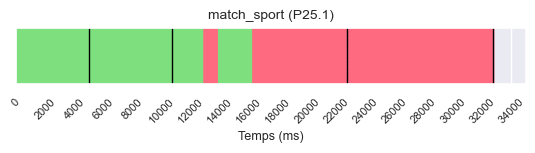

P25_1: 576044it [00:09, 73849.66it/s]

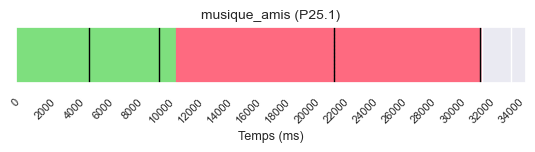

P25_1: 612205it [00:09, 70339.30it/s]

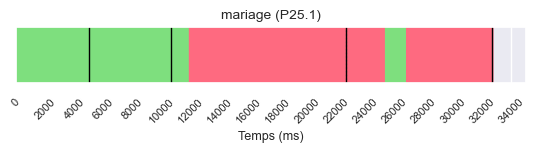

P25_1: 666847it [00:10, 62338.78it/s]
P25_2: 16865it [00:00, 159583.76it/s]

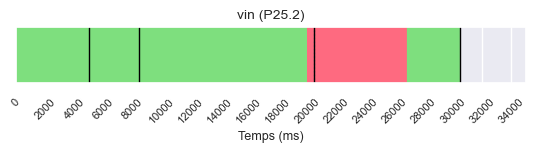

P25_2: 141429it [00:01, 181437.40it/s]

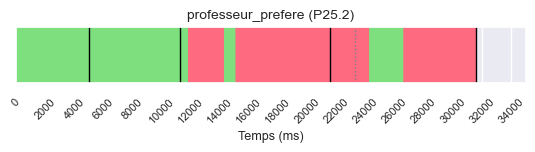

P25_2: 221759it [00:02, 103231.37it/s]

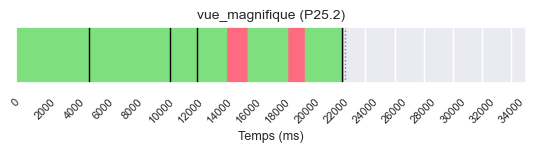

P25_2: 292986it [00:02, 123722.87it/s]

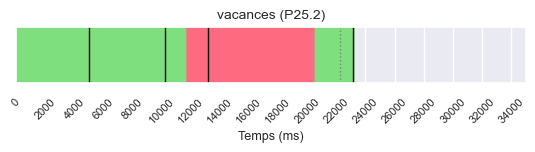

P25_2: 366974it [00:03, 117465.03it/s]

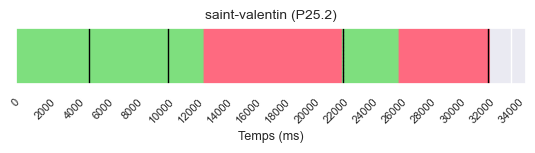

P25_2: 410093it [00:04, 86215.69it/s] 

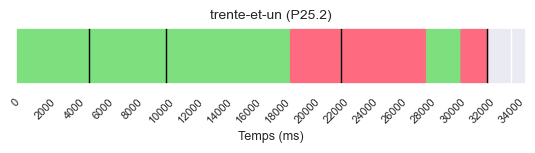

P25_2: 455219it [00:05, 79438.51it/s]

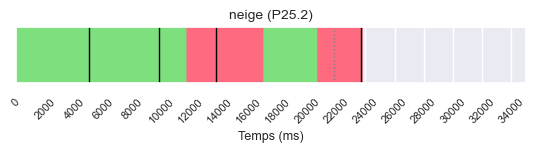

P25_2: 522573it [00:06, 88414.07it/s]

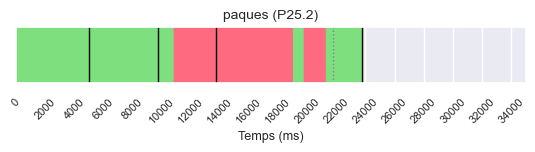

P25_2: 564732it [00:06, 81206.82it/s]

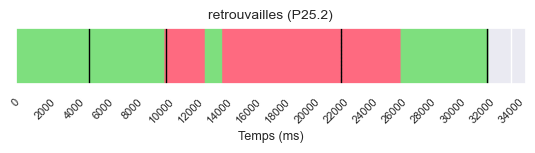

P25_2: 601852it [00:07, 74285.59it/s]

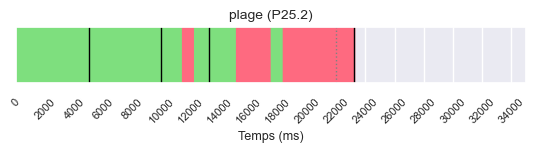

P25_2: 643897it [00:08, 72746.41it/s]

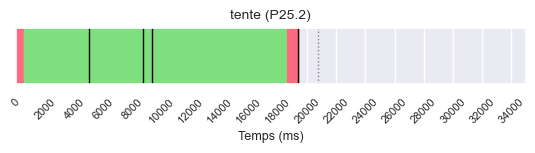

P25_2: 685609it [00:08, 82411.09it/s]

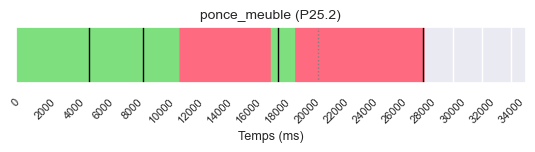

P25_2: 745586it [00:09, 78208.36it/s]
P25_3: 12511it [00:00, 123915.66it/s]

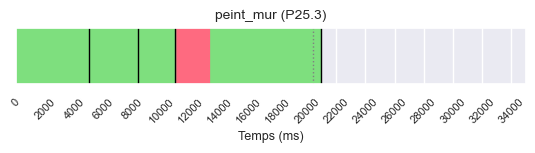

P25_3: 64995it [00:00, 106170.39it/s]

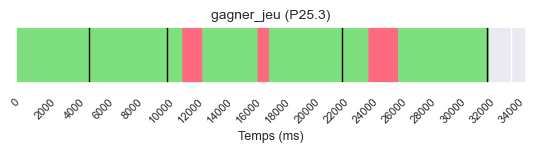

P25_3: 79652it [00:01, 35831.80it/s] 

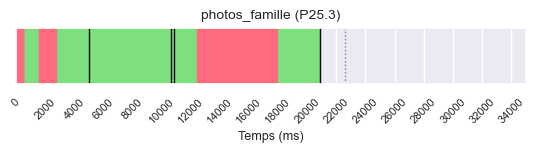

P25_3: 140701it [00:02, 77965.78it/s]

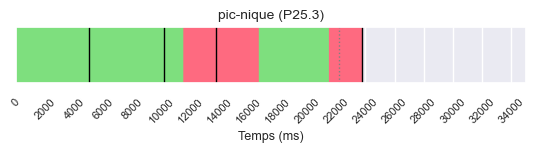

P25_3: 203294it [00:03, 82674.25it/s]

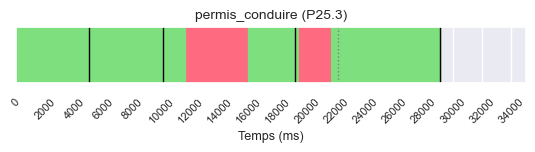

P25_3: 273346it [00:03, 98612.27it/s]

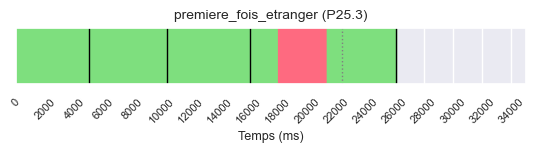

P25_3: 322919it [00:04, 99277.13it/s]

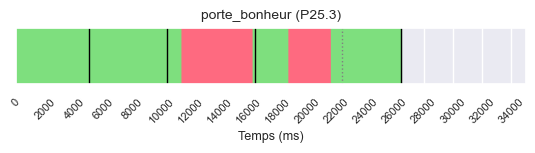

P25_3: 390887it [00:05, 91389.91it/s]

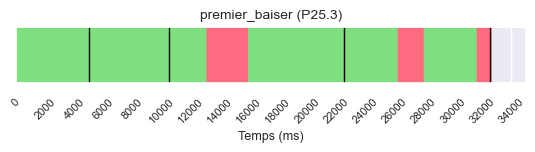

P25_3: 451605it [00:06, 83126.93it/s]

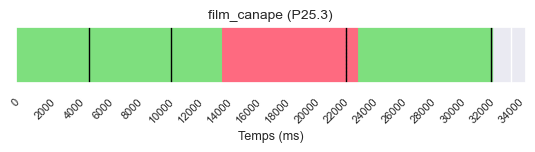

P25_3: 513525it [00:07, 91147.36it/s]

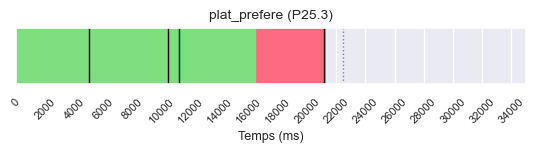

P25_3: 556049it [00:07, 92870.62it/s]

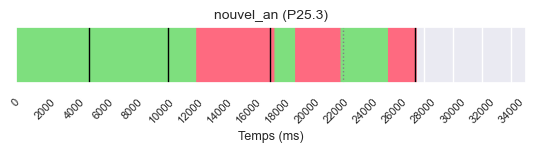

P25_3: 600488it [00:08, 89214.53it/s]

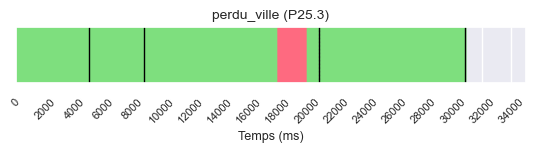

P25_3: 642175it [00:09, 70067.31it/s]
P25_4: 14602it [00:00, 144889.50it/s]

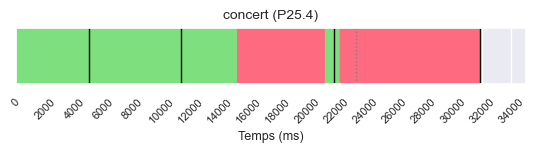

P25_4: 77703it [00:00, 98160.50it/s] 

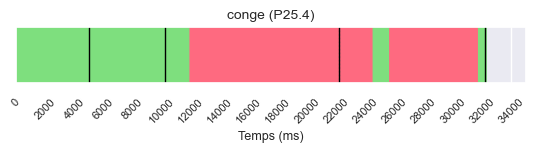

P25_4: 113084it [00:01, 63551.31it/s]

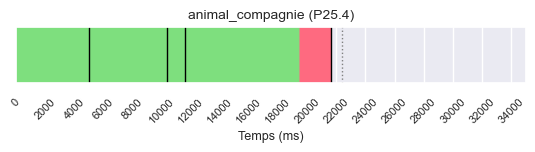

P25_4: 174186it [00:02, 96091.55it/s]

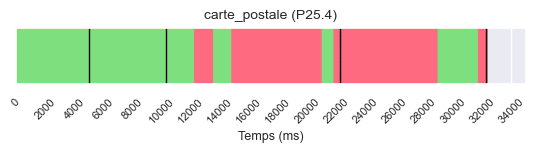

P25_4: 190993it [00:03, 46587.75it/s]

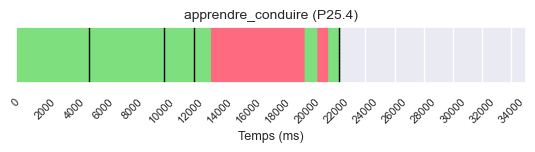

P25_4: 251943it [00:03, 80316.39it/s]

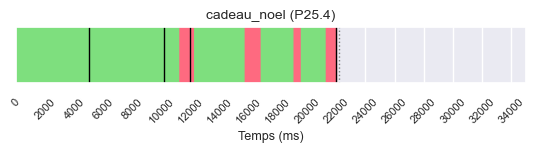

P25_4: 314386it [00:04, 95388.23it/s]

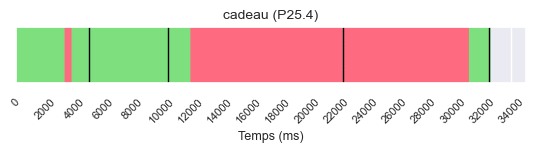

P25_4: 348181it [00:05, 69503.97it/s]

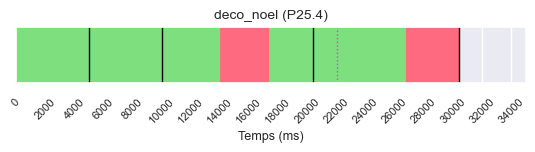

P25_4: 411849it [00:06, 85118.33it/s]

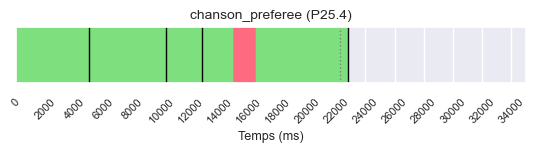

P25_4: 453405it [00:06, 87473.65it/s]

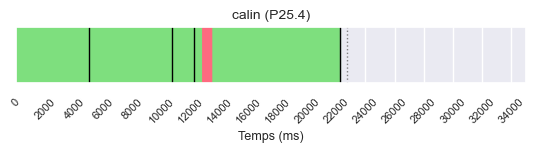

P25_4: 494029it [00:07, 88139.34it/s]

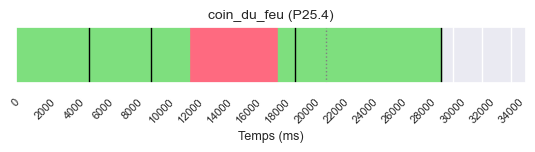

P25_4: 534230it [00:08, 72421.87it/s]

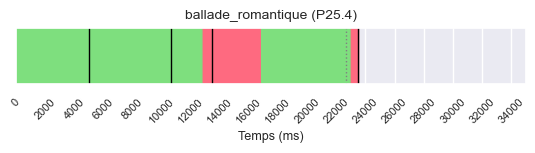

P25_4: 561398it [00:08, 63188.32it/s]
P26_1: 13350it [00:00, 130011.70it/s]

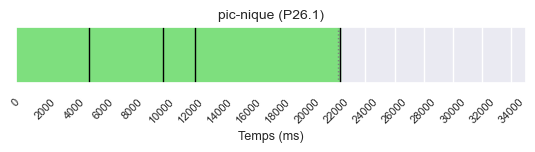

P26_1: 51630it [00:00, 96869.39it/s] 

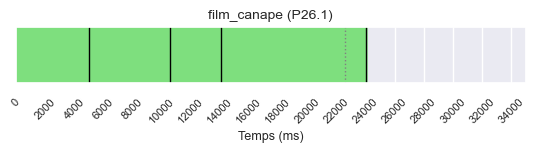

P26_1: 95175it [00:01, 89685.19it/s]

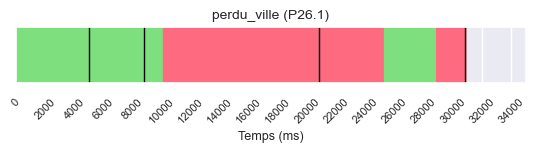

P26_1: 141396it [00:01, 78483.46it/s]

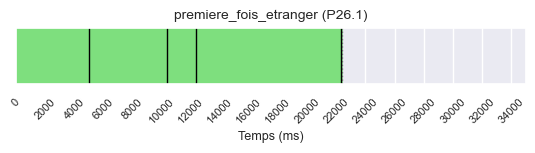

P26_1: 185072it [00:02, 82961.87it/s]

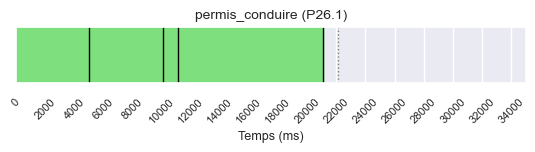

P26_1: 229688it [00:03, 90210.62it/s]

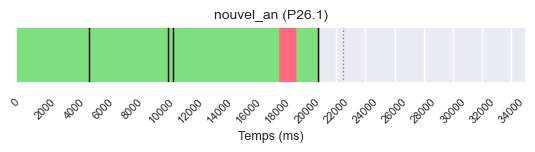

P26_1: 273306it [00:03, 92520.62it/s]

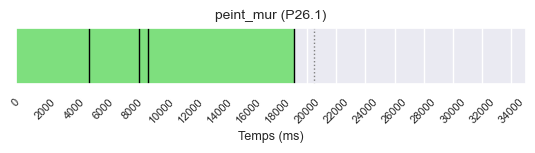

P26_1: 317173it [00:04, 91869.37it/s]

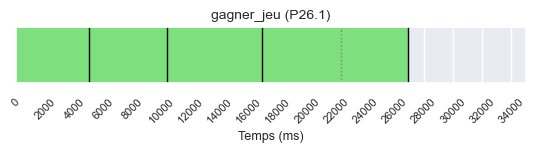

P26_1: 357542it [00:04, 90412.95it/s]

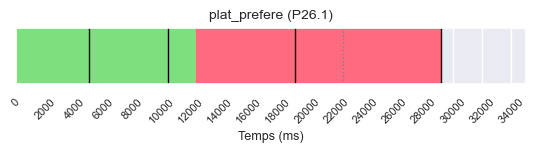

P26_1: 403927it [00:05, 81747.91it/s]

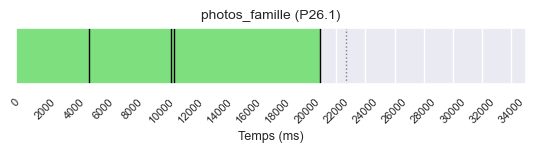

P26_1: 445863it [00:06, 83882.33it/s]

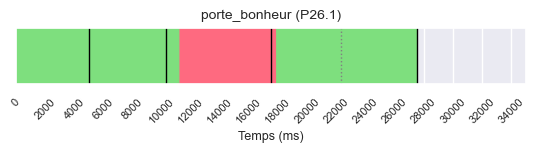

P26_1: 511356it [00:06, 85811.10it/s]

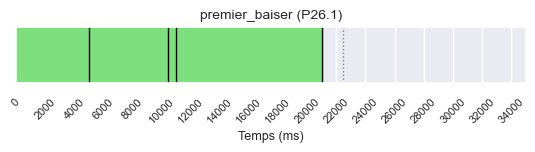

P26_1: 546379it [00:07, 73759.17it/s]
P26_2: 0it [00:00, ?it/s]

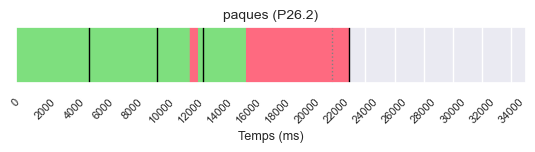

P26_2: 57744it [00:00, 82449.89it/s]

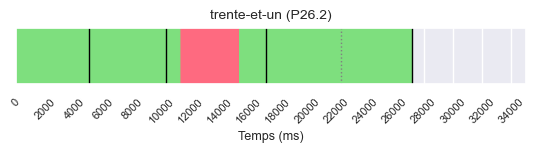

P26_2: 91492it [00:01, 61204.63it/s]

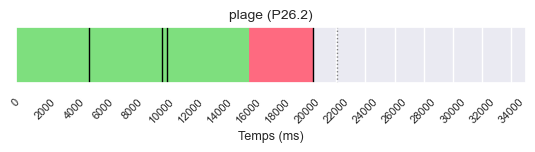

P26_2: 132438it [00:02, 78199.65it/s]

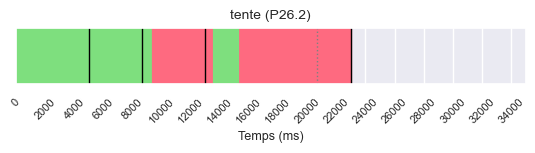

P26_2: 172405it [00:03, 68277.15it/s]

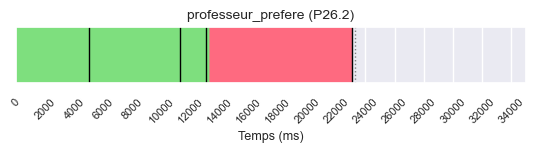

P26_2: 216178it [00:03, 79158.04it/s]

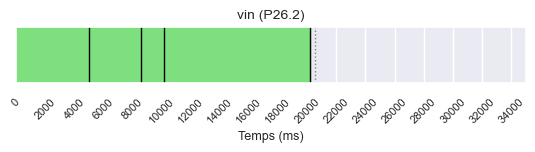

P26_2: 257578it [00:04, 82278.80it/s]

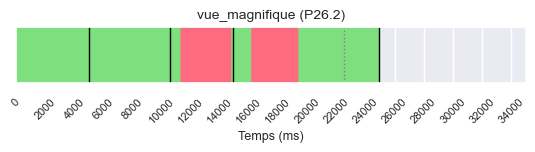

P26_2: 302771it [00:04, 77608.81it/s]

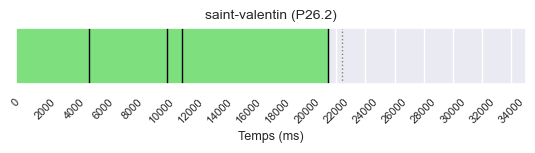

P26_2: 370716it [00:05, 104268.23it/s]

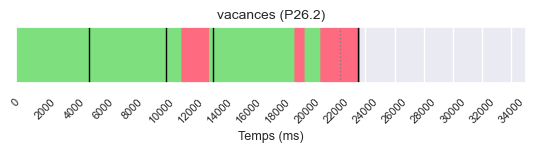

P26_2: 418731it [00:06, 88202.77it/s] 

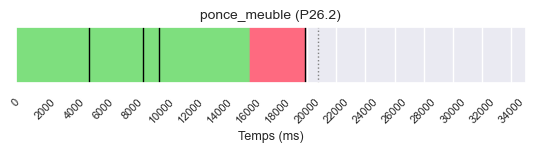

P26_2: 464105it [00:06, 88771.12it/s]

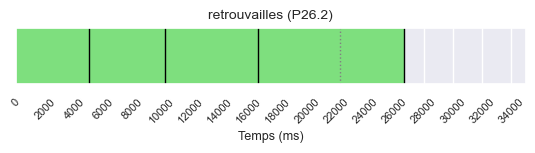

P26_2: 503208it [00:07, 84405.19it/s]

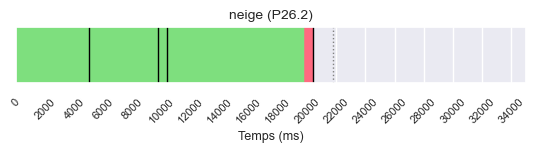

P26_2: 543318it [00:08, 67747.18it/s]
P26_3: 0it [00:00, ?it/s]

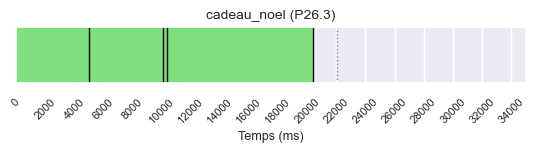

P26_3: 41479it [00:00, 92505.59it/s]

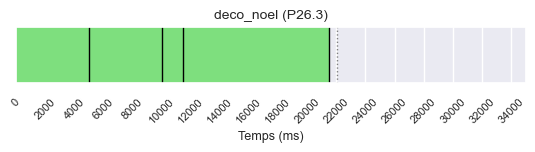

P26_3: 88113it [00:01, 88387.41it/s]

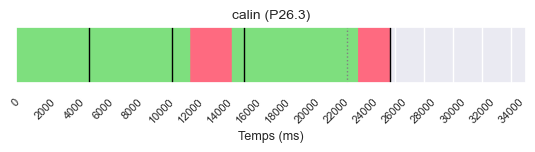

P26_3: 130484it [00:01, 70954.36it/s]

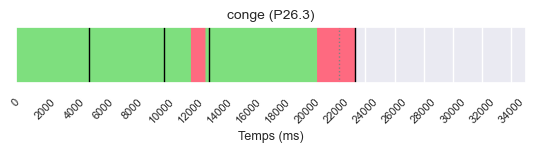

P26_3: 170905it [00:02, 66471.27it/s]

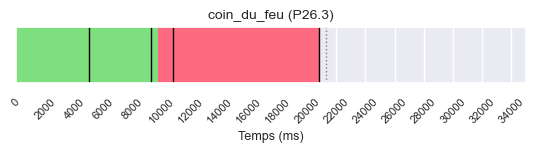

P26_3: 207816it [00:03, 63982.25it/s]

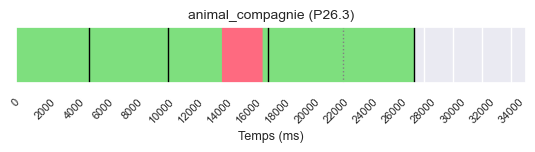

P26_3: 249374it [00:04, 69788.59it/s]

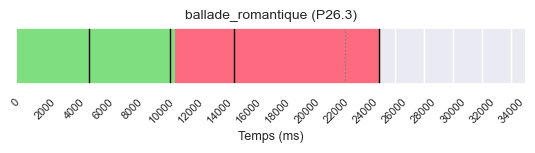

P26_3: 294510it [00:04, 76448.90it/s]

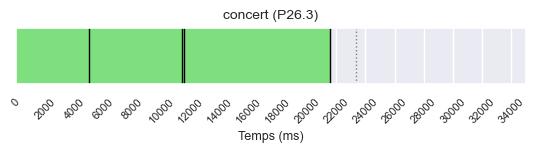

P26_3: 336528it [00:05, 77721.20it/s]

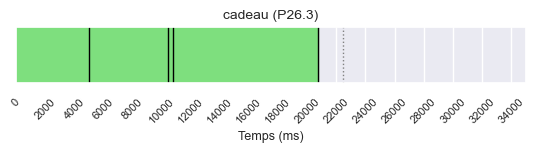

P26_3: 376534it [00:05, 81331.84it/s]

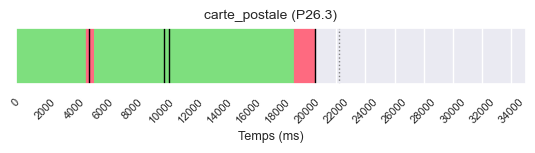

P26_3: 413373it [00:06, 81743.11it/s]

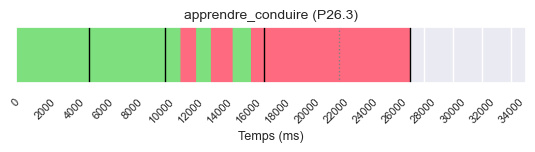

P26_3: 451682it [00:07, 59234.08it/s]

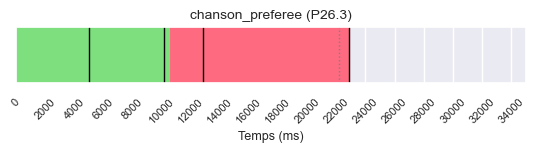

P26_3: 484247it [00:08, 60055.62it/s]
P26_4: 0it [00:00, ?it/s]

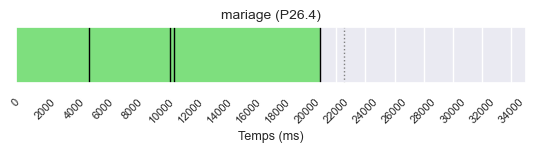

P26_4: 38527it [00:00, 82631.64it/s]

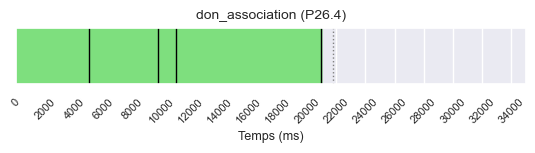

P26_4: 80905it [00:01, 79515.34it/s]

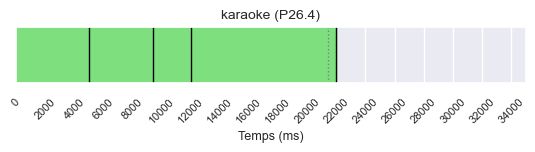

P26_4: 118595it [00:01, 81884.49it/s]

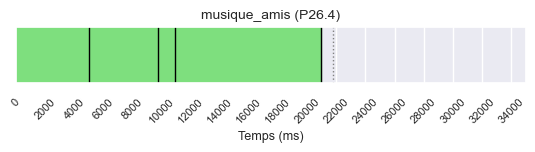

P26_4: 157473it [00:02, 84278.04it/s]

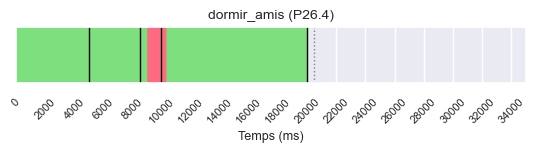

P26_4: 198665it [00:02, 75004.06it/s]

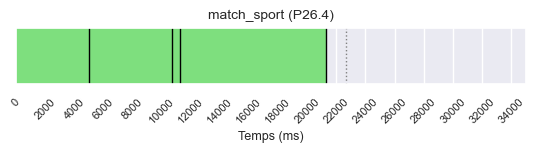

P26_4: 237736it [00:03, 78888.56it/s]

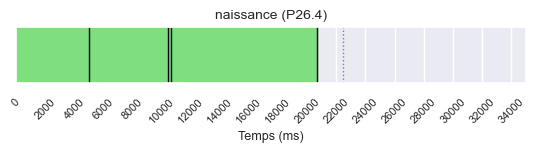

P26_4: 277349it [00:04, 84660.44it/s]

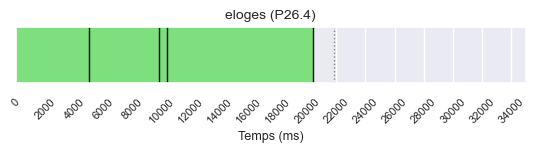

P26_4: 315669it [00:04, 83876.25it/s]

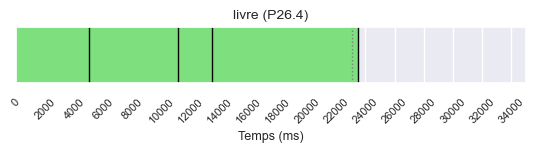

P26_4: 355977it [00:05, 88993.19it/s]

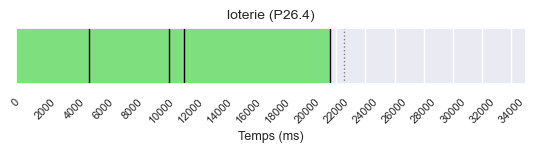

P26_4: 398607it [00:05, 93673.51it/s]

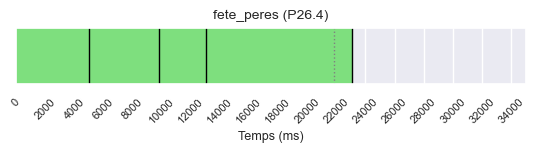

P26_4: 460030it [00:06, 107520.05it/s]

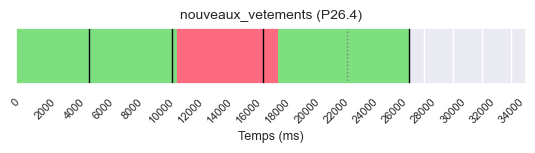

P26_4: 483487it [00:06, 71655.34it/s] 
P27_1: 15264it [00:00, 151216.42it/s]

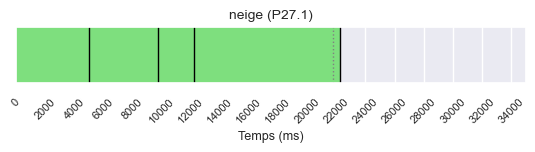

P27_1: 52818it [00:00, 91481.46it/s] 

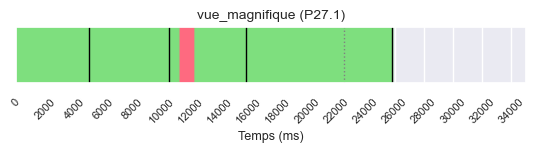

P27_1: 92264it [00:01, 66694.92it/s]

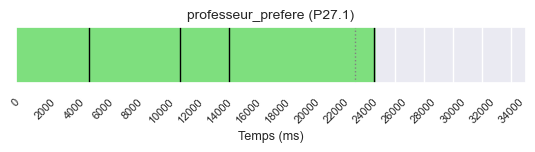

P27_1: 152157it [00:02, 90140.33it/s]

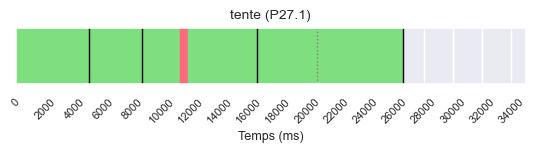

P27_1: 206834it [00:02, 79817.61it/s]

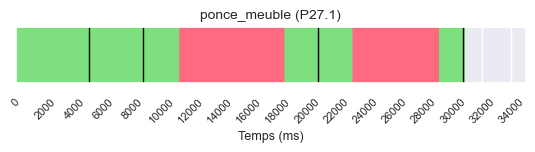

P27_1: 240985it [00:03, 68086.67it/s]

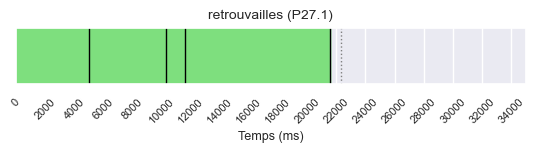

P27_1: 282222it [00:04, 82087.89it/s]

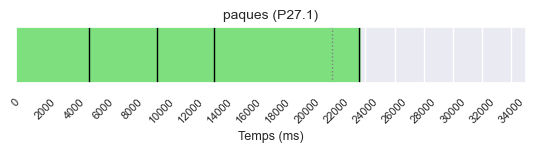

P27_1: 339215it [00:04, 96457.31it/s]

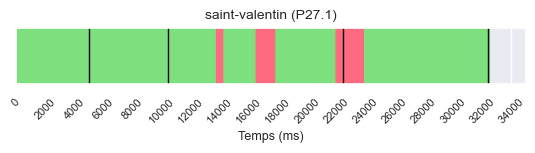

P27_1: 375587it [00:05, 59537.85it/s]

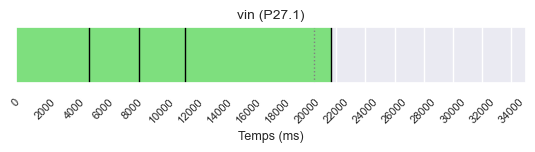

P27_1: 411592it [00:06, 70578.55it/s]

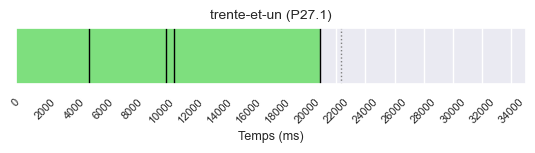

P27_1: 452205it [00:06, 77885.16it/s]

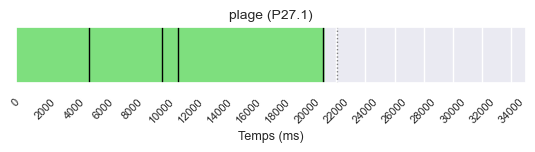

P27_1: 492332it [00:07, 83536.26it/s]

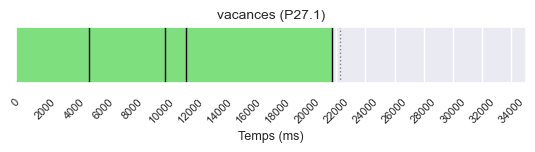

P27_1: 536672it [00:07, 67665.94it/s]
P27_2: 17553it [00:00, 169189.83it/s]

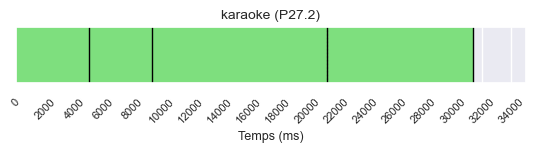

P27_2: 73344it [00:00, 104947.49it/s]

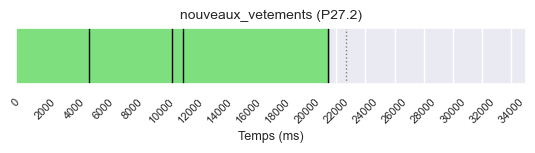

P27_2: 117488it [00:01, 92623.78it/s]

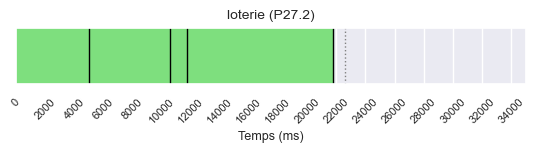

P27_2: 158322it [00:01, 91798.93it/s]

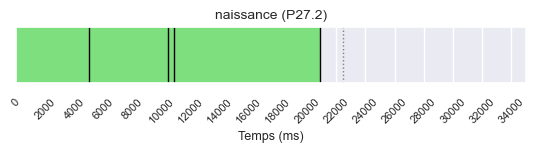

P27_2: 195650it [00:02, 85303.86it/s]

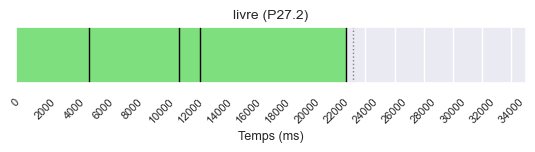

P27_2: 236597it [00:03, 89302.72it/s]

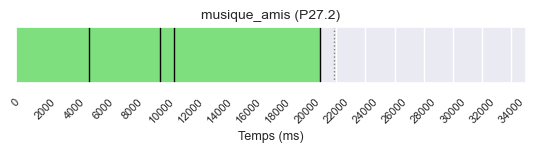

P27_2: 282165it [00:03, 94717.11it/s]

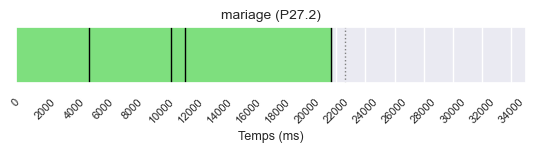

P27_2: 349952it [00:04, 114901.17it/s]

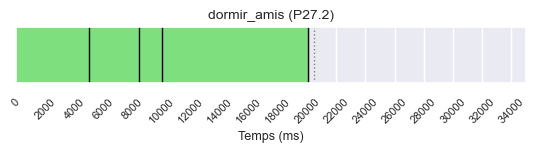

P27_2: 394233it [00:04, 104486.78it/s]

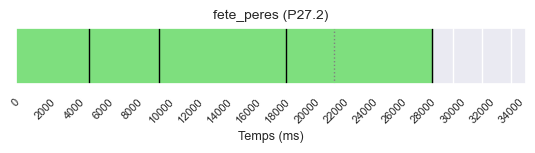

P27_2: 440416it [00:05, 97957.41it/s] 

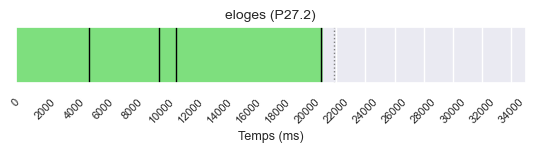

P27_2: 501516it [00:05, 108388.74it/s]

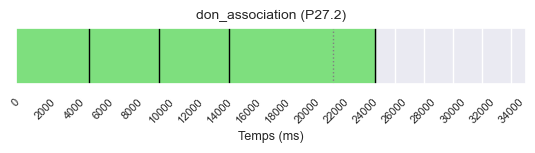

P27_2: 547118it [00:06, 101741.79it/s]

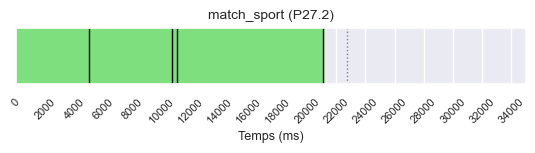

P27_2: 593981it [00:07, 84494.57it/s] 
P27_3: 0it [00:00, ?it/s]

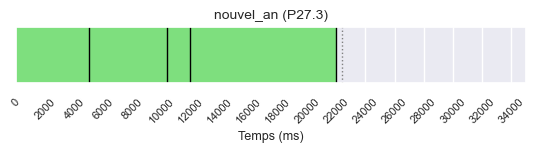

P27_3: 53412it [00:00, 101142.63it/s]

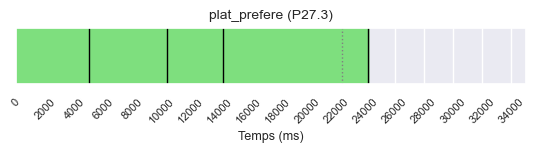

P27_3: 90352it [00:01, 80088.76it/s] 

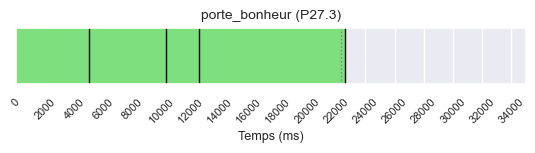

P27_3: 146341it [00:01, 96376.26it/s]

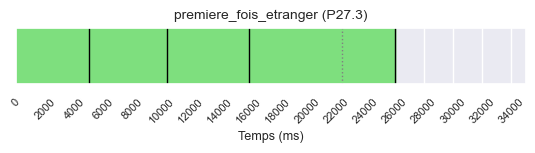

P27_3: 185519it [00:02, 90833.68it/s]

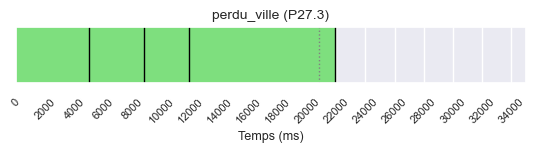

P27_3: 222441it [00:02, 85638.28it/s]

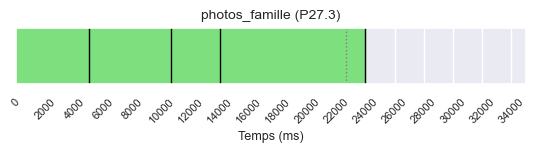

P27_3: 262079it [00:03, 88007.66it/s]

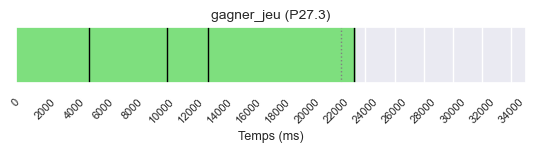

P27_3: 303570it [00:03, 90812.54it/s]

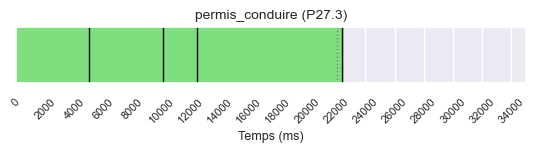

P27_3: 362874it [00:04, 102331.63it/s]

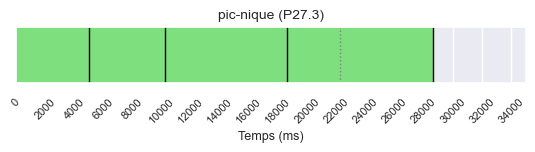

P27_3: 405193it [00:05, 97623.88it/s] 

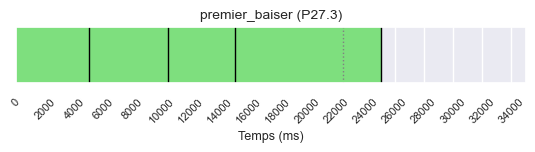

P27_3: 461863it [00:05, 98129.88it/s]

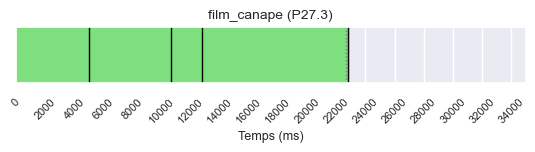

P27_3: 489371it [00:06, 64931.83it/s]

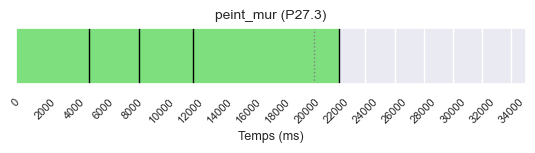

P27_3: 531329it [00:07, 74857.96it/s]
P27_4: 0it [00:00, ?it/s]

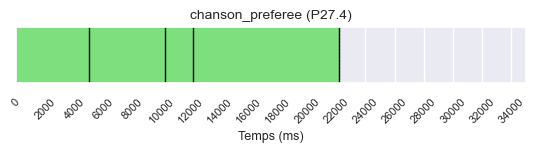

P27_4: 41761it [00:00, 80776.90it/s]

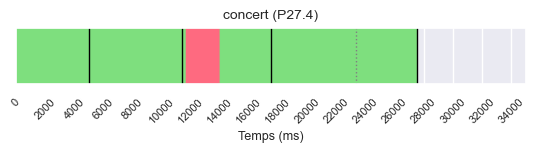

P27_4: 96018it [00:01, 80553.33it/s]

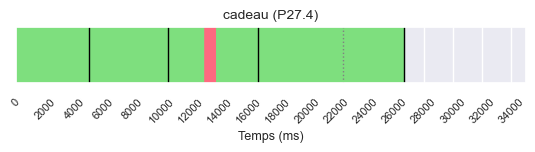

P27_4: 132163it [00:02, 71592.33it/s]

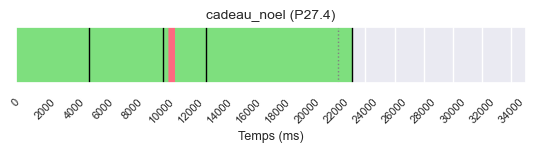

P27_4: 175494it [00:02, 77508.96it/s]

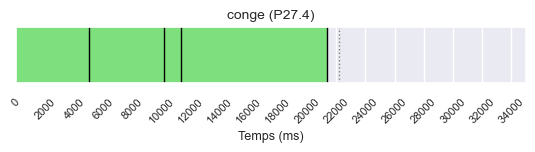

P27_4: 219954it [00:03, 82994.81it/s]

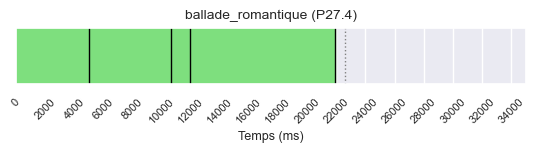

P27_4: 263192it [00:03, 88685.14it/s]

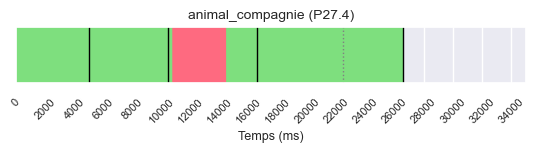

P27_4: 307286it [00:04, 82791.08it/s]

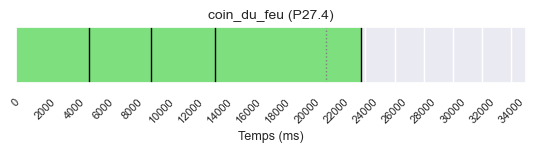

P27_4: 351319it [00:05, 86224.23it/s]

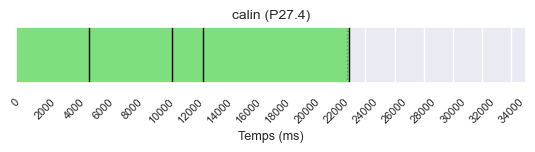

P27_4: 391377it [00:05, 85669.94it/s]

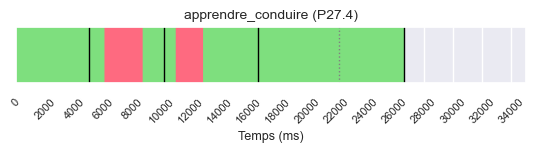

P27_4: 429777it [00:06, 70060.20it/s]

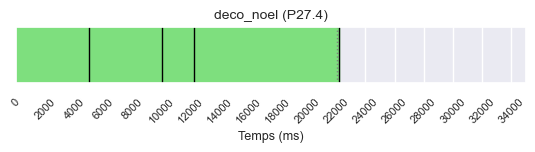

P27_4: 465684it [00:06, 73890.46it/s]

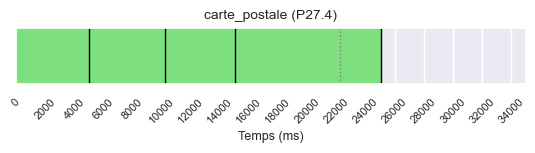

P27_4: 497661it [00:07, 66214.21it/s]
P28_1: 13426it [00:00, 133585.88it/s]

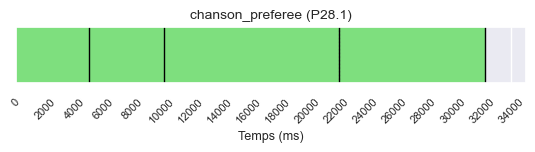

P28_1: 72333it [00:00, 114304.95it/s]

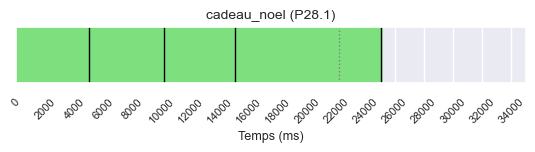

P28_1: 141190it [00:01, 116794.66it/s]

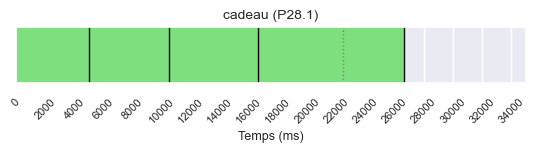

P28_1: 177025it [00:02, 89413.06it/s] 

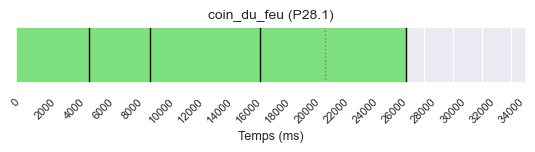

P28_1: 220116it [00:02, 95242.63it/s]

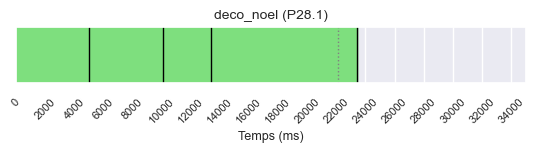

P28_1: 294549it [00:03, 125166.84it/s]

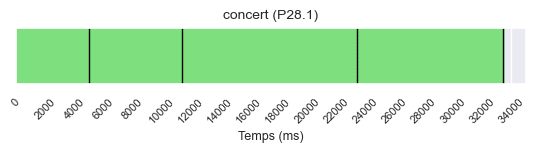

P28_1: 365353it [00:03, 124406.88it/s]

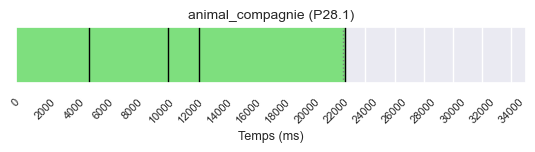

P28_1: 409457it [00:04, 109928.86it/s]

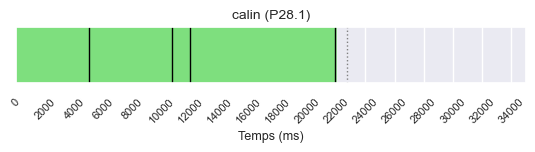

P28_1: 450407it [00:04, 98993.22it/s] 

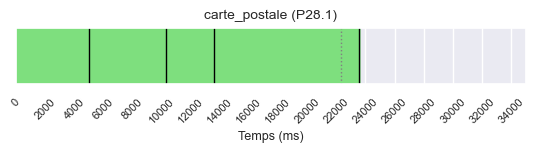

P28_1: 489509it [00:05, 91768.58it/s]

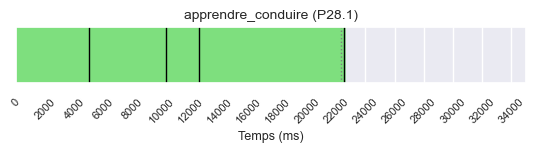

P28_1: 528470it [00:05, 92111.04it/s]

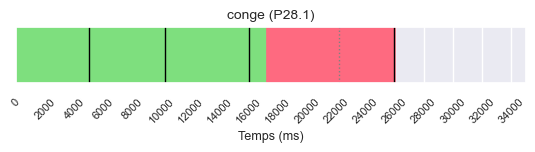

P28_1: 573635it [00:06, 96692.43it/s]

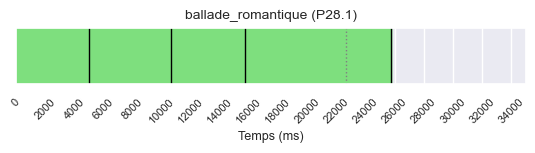

P28_1: 620306it [00:07, 87237.52it/s]
P28_2: 0it [00:00, ?it/s]

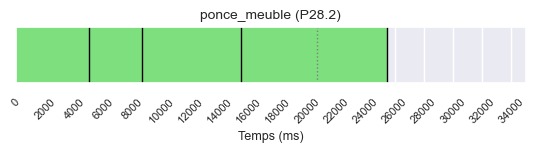

P28_2: 46072it [00:00, 98240.40it/s]

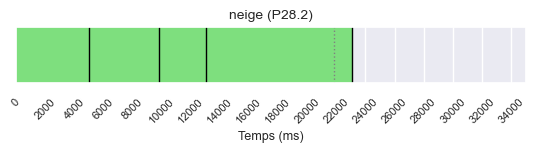

P28_2: 115243it [00:01, 104450.90it/s]

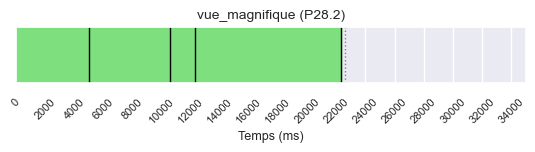

P28_2: 151466it [00:01, 86780.24it/s] 

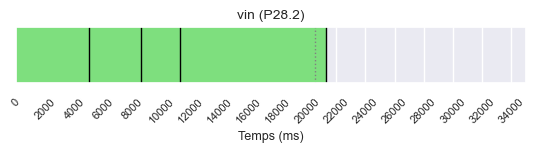

P28_2: 187862it [00:02, 85763.71it/s]

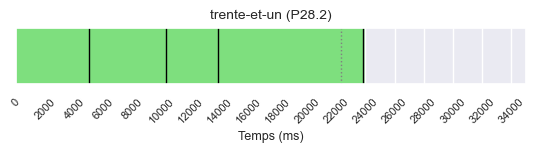

P28_2: 245604it [00:03, 103811.29it/s]

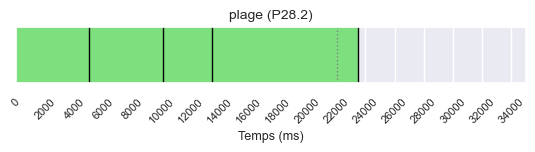

P28_2: 283365it [00:03, 92314.40it/s] 

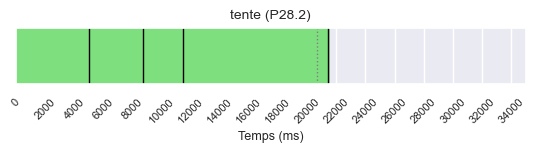

P28_2: 317472it [00:04, 83106.77it/s]

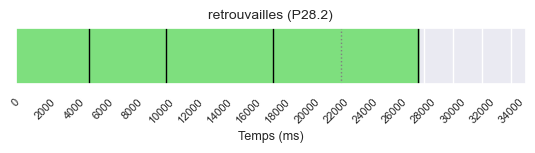

P28_2: 376024it [00:04, 100643.16it/s]

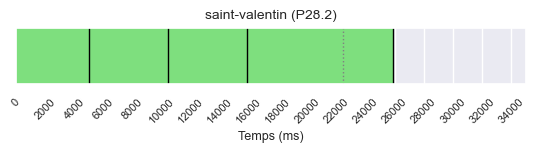

P28_2: 413054it [00:05, 90891.70it/s] 

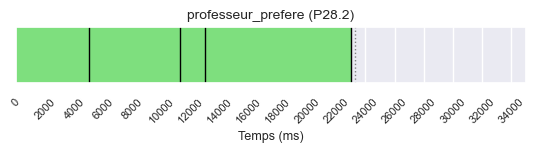

P28_2: 450056it [00:05, 85972.17it/s]

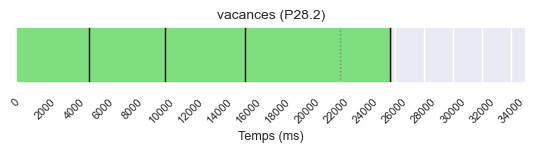

P28_2: 511543it [00:06, 105133.49it/s]

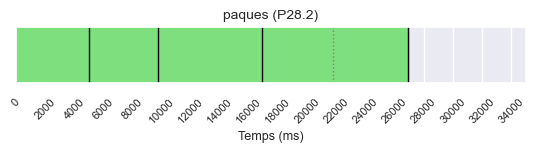

P28_2: 550551it [00:06, 80523.75it/s] 
P28_3: 0it [00:00, ?it/s]

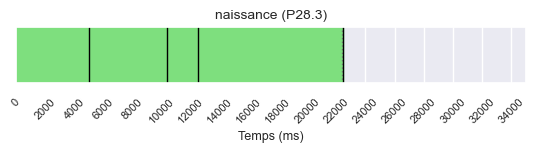

P28_3: 57743it [00:00, 113390.97it/s]

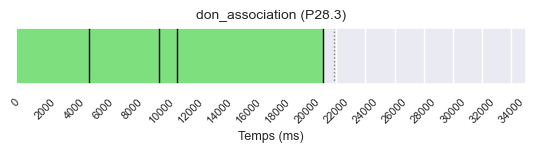

P28_3: 97215it [00:01, 85929.51it/s] 

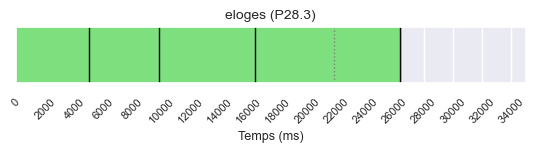

P28_3: 140511it [00:01, 90458.63it/s]

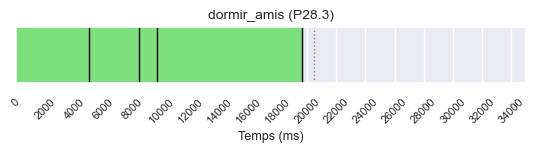

P28_3: 182913it [00:02, 93336.34it/s]

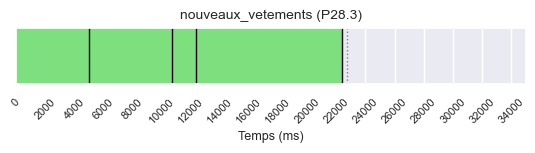

P28_3: 217902it [00:02, 80447.88it/s]

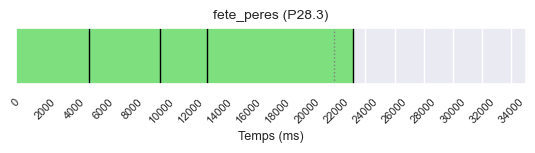

P28_3: 273912it [00:03, 86277.09it/s]

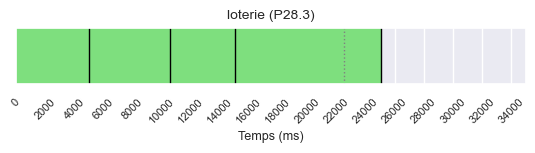

P28_3: 313823it [00:04, 86076.17it/s]

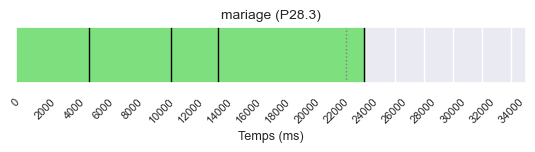

P28_3: 351091it [00:04, 78592.52it/s]

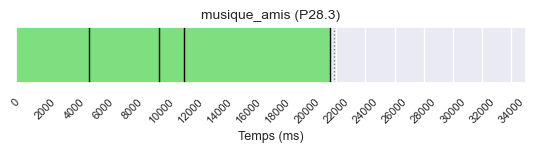

P28_3: 393188it [00:05, 84162.05it/s]

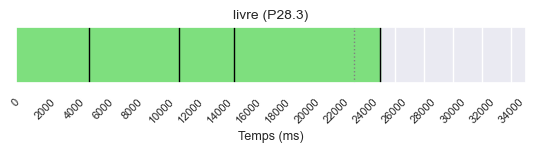

P28_3: 442604it [00:06, 88327.58it/s]

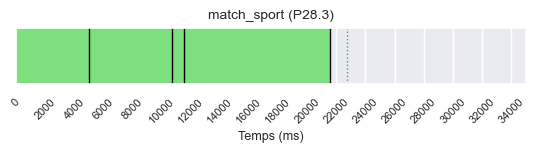

P28_3: 480252it [00:06, 86498.38it/s]

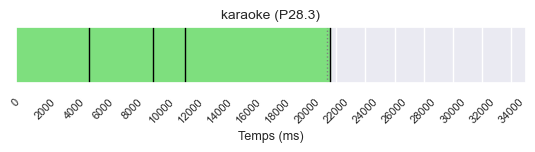

P28_3: 521046it [00:07, 73526.32it/s]
P28_4: 9208it [00:00, 91199.04it/s]

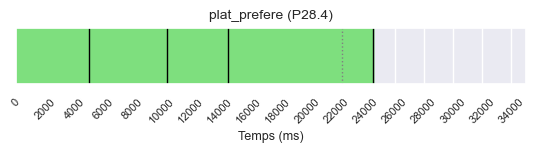

P28_4: 47551it [00:00, 85570.18it/s]

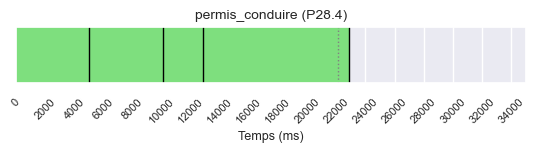

P28_4: 89328it [00:01, 81451.38it/s]

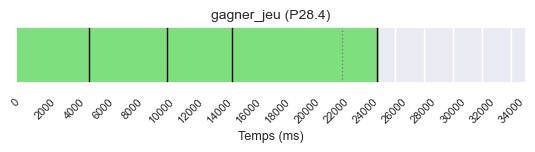

P28_4: 133728it [00:01, 86244.18it/s]

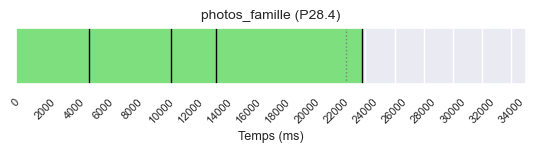

P28_4: 181575it [00:02, 96367.19it/s]

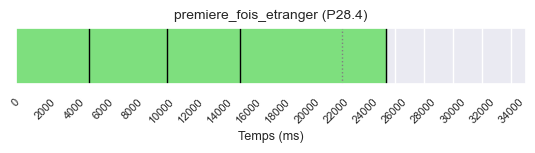

P28_4: 229448it [00:02, 99055.81it/s]

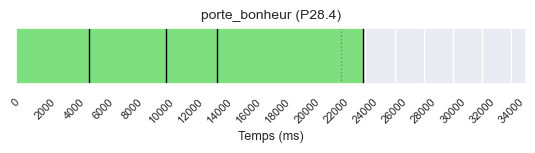

P28_4: 292560it [00:03, 108253.97it/s]

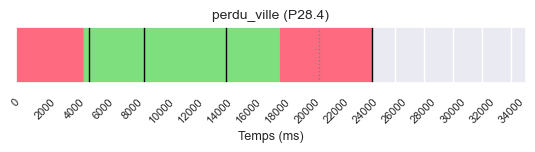

P28_4: 334308it [00:04, 97026.37it/s] 

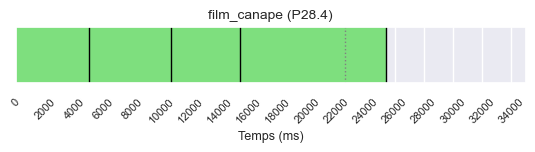

P28_4: 378840it [00:04, 96059.13it/s]

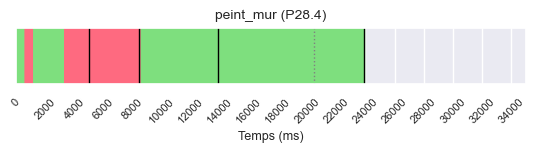

P28_4: 419529it [00:05, 91296.07it/s]

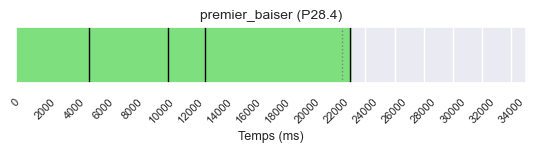

P28_4: 460688it [00:05, 84731.48it/s]

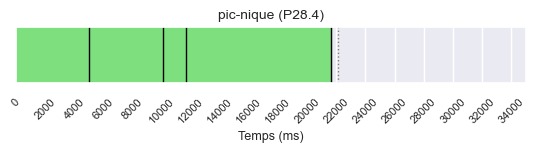

P28_4: 501250it [00:06, 89193.07it/s]

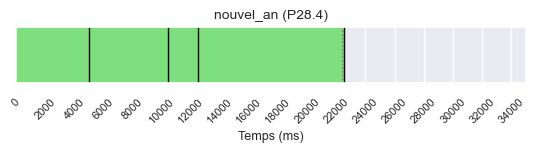

P28_4: 541071it [00:06, 78794.50it/s]
P29_1: 0it [00:00, ?it/s]

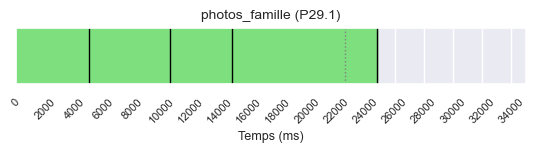

P29_1: 67512it [00:00, 125918.50it/s]

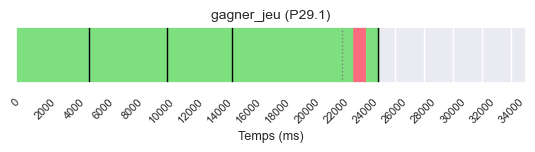

P29_1: 129981it [00:01, 105713.11it/s]

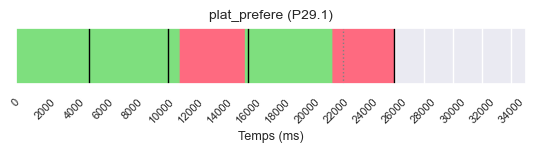

P29_1: 184157it [00:02, 76511.22it/s] 

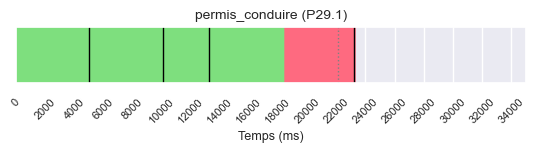

P29_1: 270812it [00:03, 119501.30it/s]

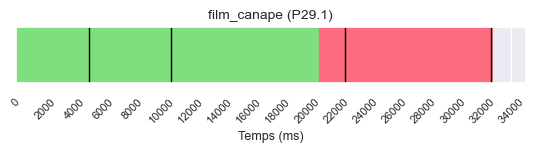

P29_1: 371765it [00:04, 144816.40it/s]

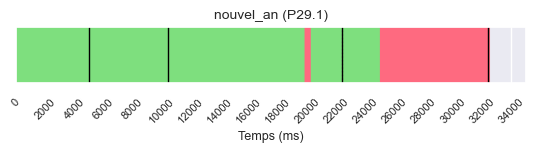

P29_1: 438613it [00:05, 105847.65it/s]

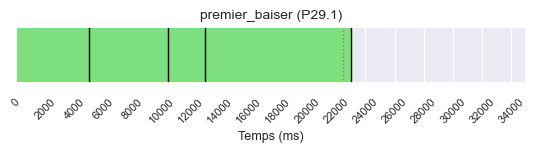

P29_1: 506728it [00:05, 120736.54it/s]

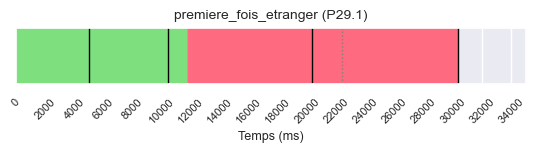

P29_1: 572731it [00:06, 98956.96it/s] 

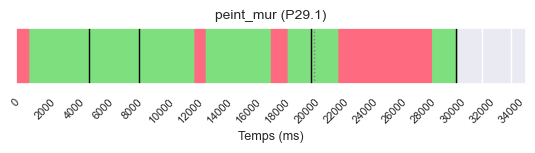

P29_1: 663872it [00:07, 109162.44it/s]

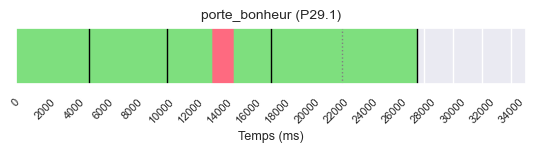

P29_1: 746526it [00:08, 107557.26it/s]

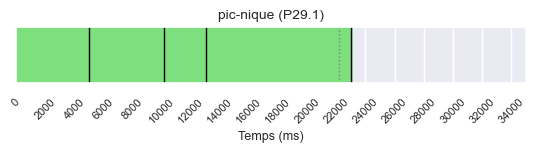

P29_1: 780178it [00:09, 86459.73it/s] 

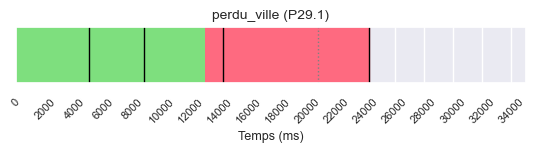

P29_1: 890168it [00:10, 86305.70it/s] 
P29_2: 14857it [00:00, 140001.43it/s]

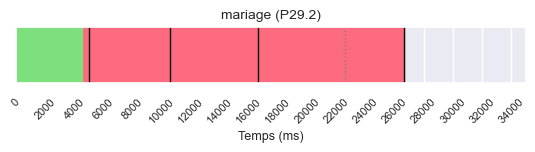

P29_2: 52990it [00:00, 88983.26it/s] 

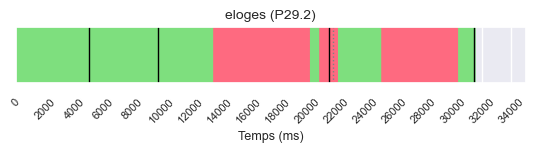

P29_2: 110821it [00:02, 59496.47it/s]

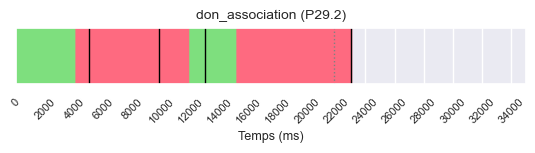

P29_2: 180211it [00:02, 99089.14it/s]

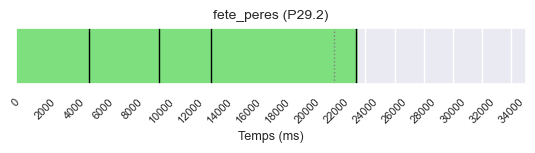

P29_2: 221146it [00:03, 86996.07it/s]

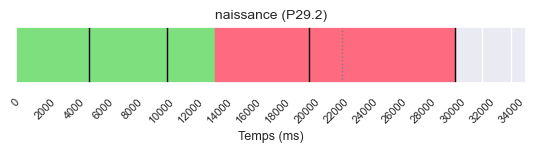

P29_2: 290175it [00:04, 106590.41it/s]

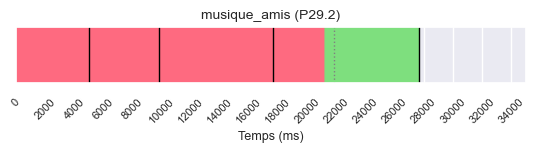

P29_2: 358184it [00:04, 112739.26it/s]

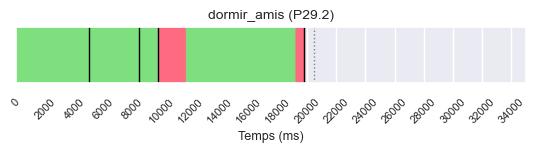

P29_2: 399253it [00:05, 91442.58it/s] 

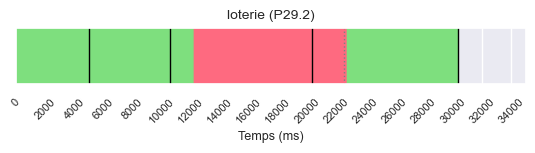

P29_2: 467591it [00:06, 104052.26it/s]

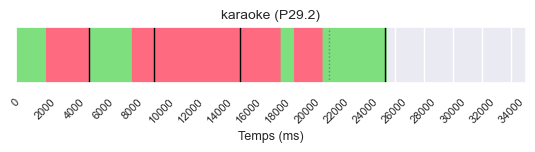

P29_2: 515414it [00:06, 96867.55it/s] 

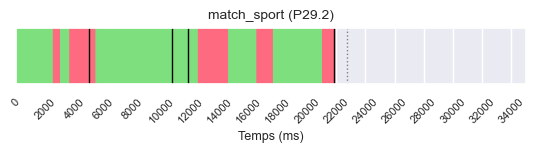

P29_2: 561715it [00:07, 98227.72it/s]

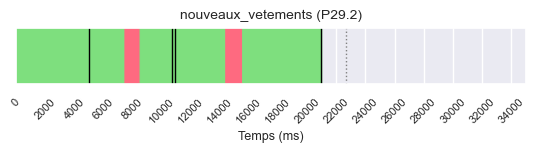

P29_2: 609278it [00:07, 95611.38it/s]

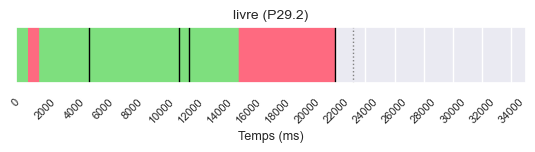

P29_2: 694528it [00:09, 77061.33it/s]
P29_3: 15095it [00:00, 142358.98it/s]

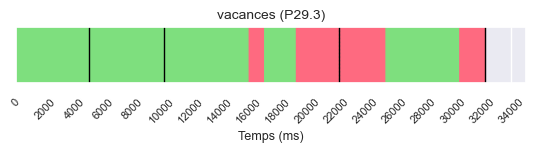

P29_3: 46474it [00:01, 46677.52it/s] 

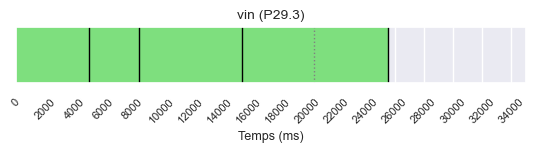

P29_3: 101377it [00:01, 76154.06it/s]

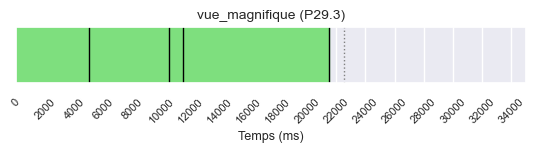

P29_3: 170504it [00:02, 118188.92it/s]

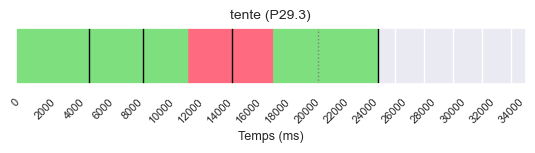

P29_3: 236062it [00:03, 96777.41it/s] 

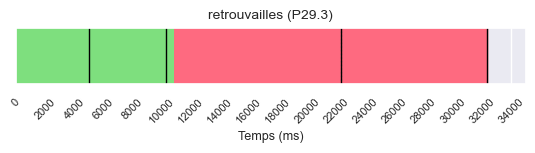

P29_3: 280951it [00:03, 86528.68it/s]

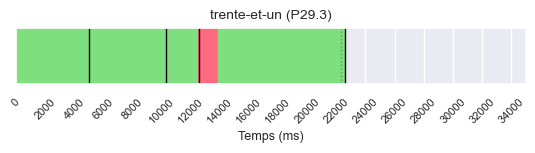

P29_3: 343785it [00:04, 85475.47it/s]

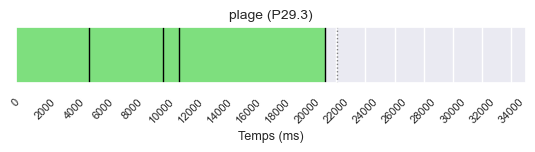

P29_3: 402854it [00:05, 100785.37it/s]

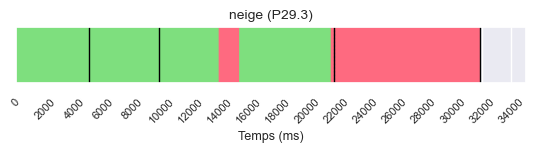

P29_3: 464400it [00:06, 83499.56it/s] 

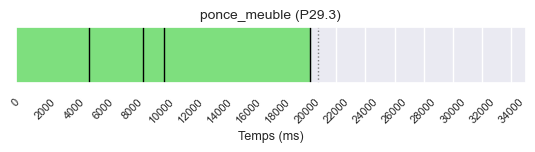

P29_3: 531996it [00:07, 110737.96it/s]

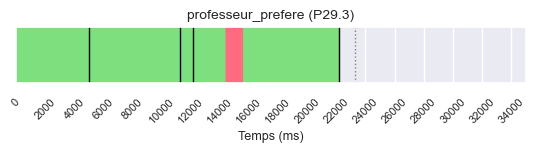

P29_3: 598559it [00:07, 124202.93it/s]

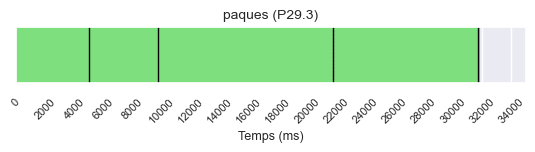

P29_3: 616996it [00:08, 81975.14it/s] 

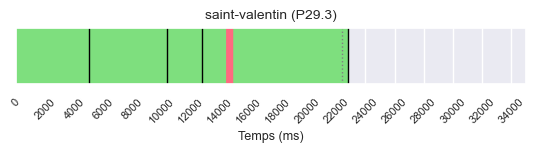

P29_3: 685788it [00:08, 77967.43it/s]
P29_4: 15943it [00:00, 158186.32it/s]

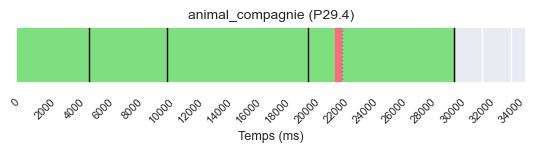

P29_4: 78180it [00:00, 125436.76it/s]

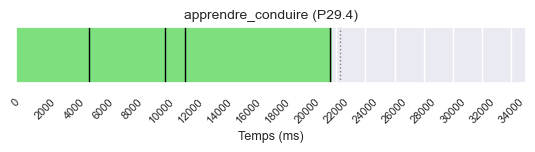

P29_4: 122751it [00:01, 100565.20it/s]

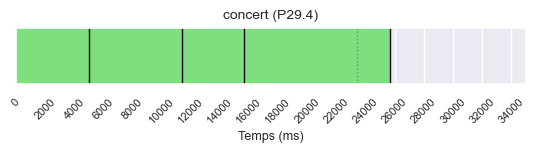

P29_4: 163551it [00:01, 97043.06it/s] 

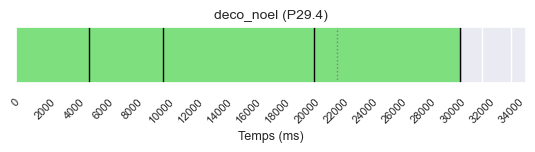

P29_4: 199838it [00:02, 88264.34it/s]

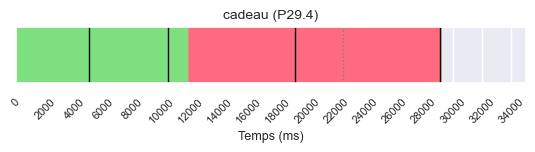

P29_4: 238404it [00:02, 77212.51it/s]

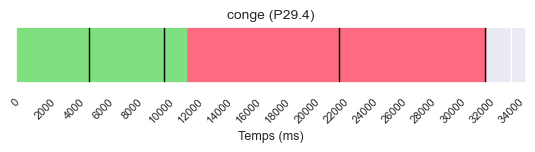

P29_4: 303147it [00:03, 96785.89it/s]

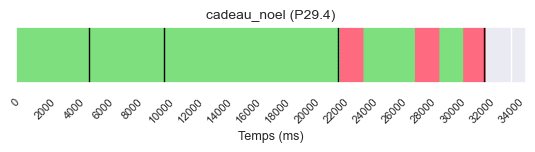

P29_4: 344530it [00:04, 94520.20it/s]

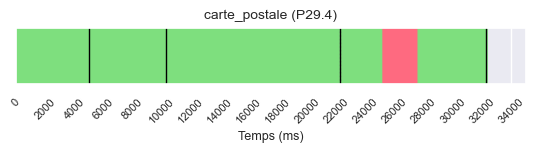

P29_4: 407474it [00:04, 110902.83it/s]

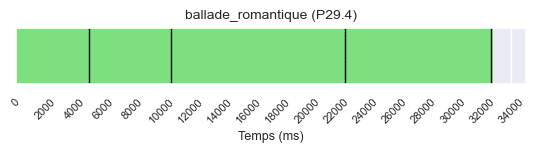

P29_4: 449000it [00:05, 100523.54it/s]

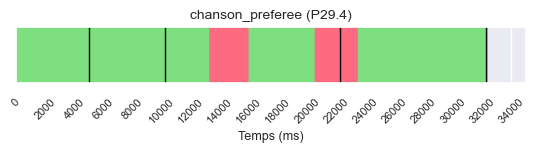

P29_4: 509727it [00:06, 82660.68it/s] 

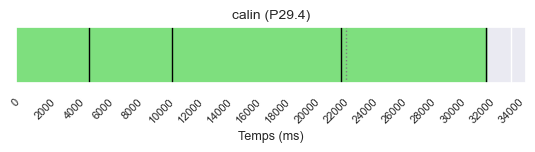

P29_4: 569298it [00:06, 103150.23it/s]

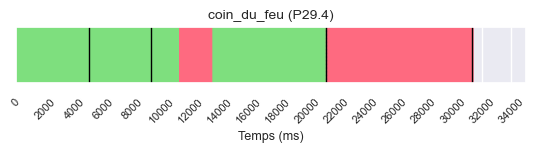

P29_4: 593014it [00:07, 76874.45it/s] 
P30_1: 12073it [00:00, 119602.61it/s]

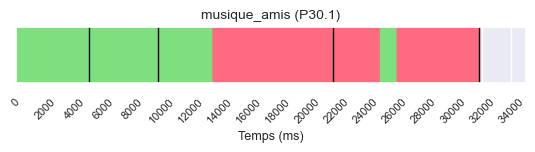

P30_1: 36772it [00:00, 48640.11it/s] 

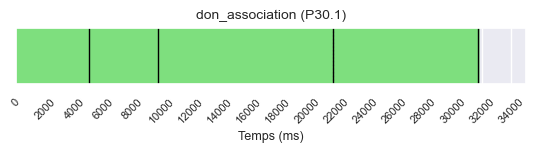

P30_1: 92289it [00:01, 86339.15it/s]

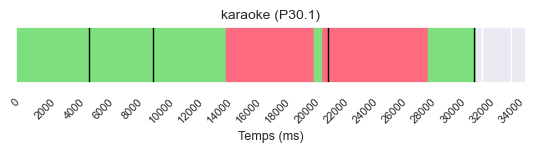

P30_1: 125299it [00:02, 57255.89it/s]

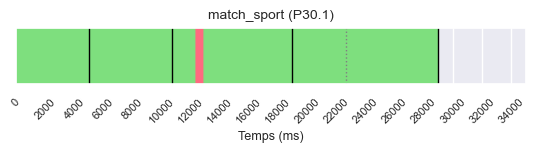

P30_1: 184021it [00:03, 71326.31it/s]

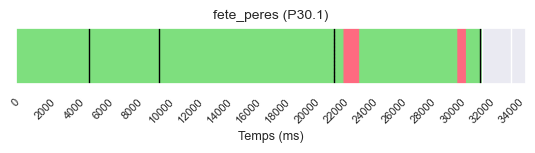

P30_1: 216730it [00:03, 72016.62it/s]

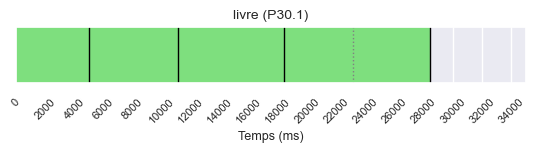

P30_1: 304165it [00:04, 117977.16it/s]

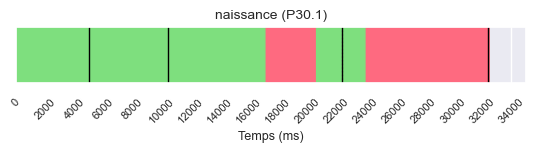

P30_1: 383574it [00:05, 110458.01it/s]

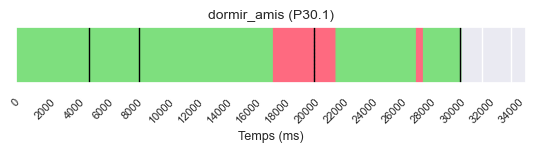

P30_1: 441279it [00:06, 91219.79it/s] 

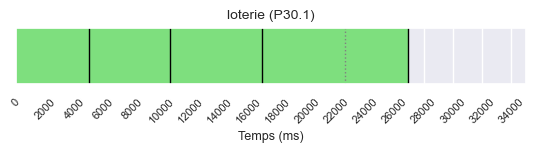

P30_1: 501514it [00:06, 108777.63it/s]

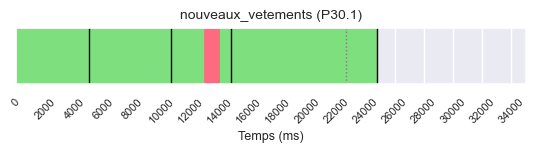

P30_1: 562837it [00:07, 92787.07it/s] 

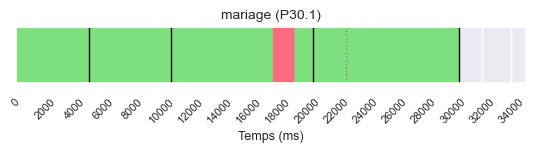

P30_1: 638346it [00:08, 96925.87it/s]

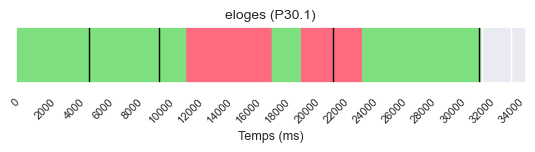

P30_1: 639936it [00:09, 66504.33it/s]
P30_2: 10612it [00:00, 105111.41it/s]

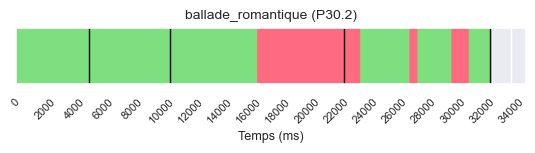

P30_2: 74297it [00:00, 100229.35it/s]

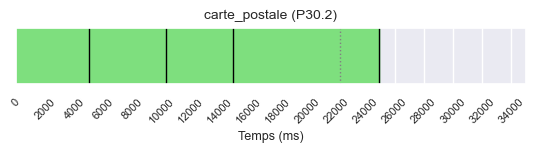

P30_2: 134108it [00:01, 101523.27it/s]

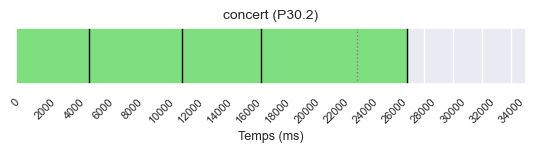

P30_2: 178412it [00:02, 103010.05it/s]

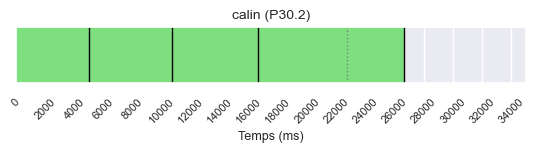

P30_2: 247062it [00:02, 123933.98it/s]

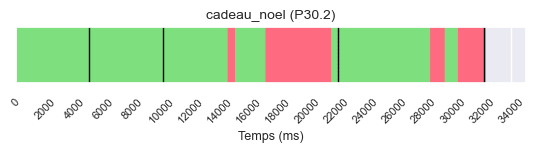

P30_2: 289458it [00:03, 71380.81it/s] 

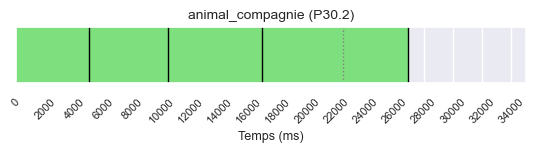

P30_2: 356944it [00:04, 102677.06it/s]

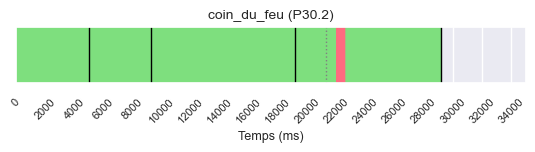

P30_2: 420098it [00:05, 112434.09it/s]

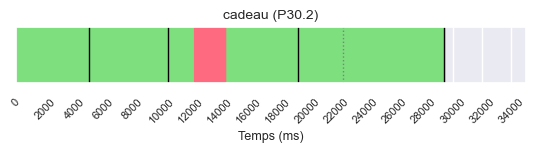

P30_2: 458849it [00:05, 76460.32it/s] 

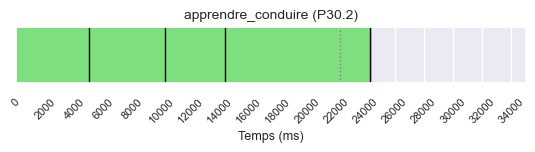

P30_2: 525100it [00:06, 106481.60it/s]

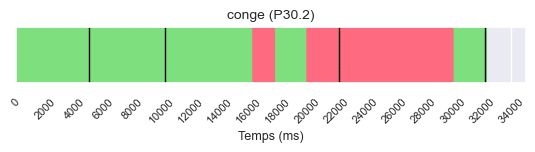

P30_2: 589419it [00:07, 81071.19it/s] 

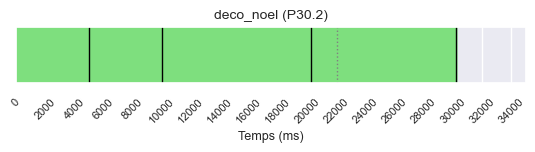

P30_2: 655940it [00:08, 108687.95it/s]

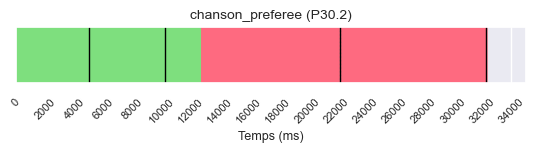

P30_2: 678464it [00:08, 76037.12it/s] 
P30_3: 15191it [00:00, 150508.16it/s]

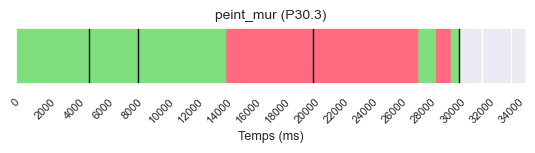

P30_3: 49422it [00:00, 63412.01it/s] 

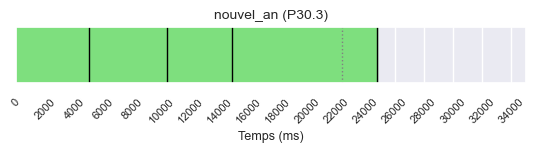

P30_3: 85176it [00:01, 64976.49it/s]

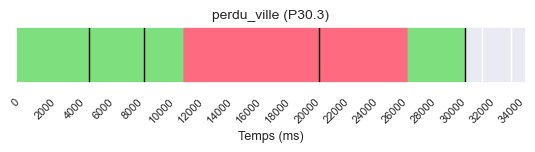

P30_3: 148278it [00:02, 83462.70it/s]

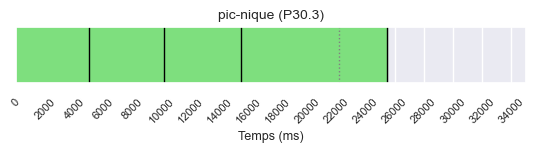

P30_3: 213282it [00:03, 112837.20it/s]

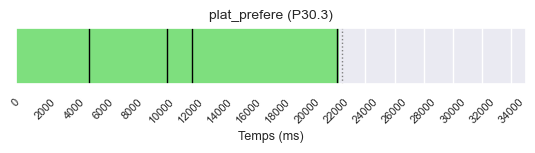

P30_3: 254209it [00:03, 100897.61it/s]

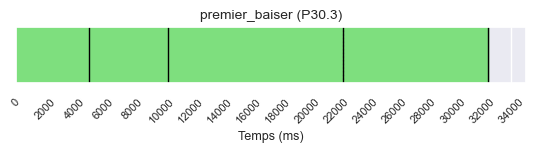

P30_3: 270579it [00:04, 68295.70it/s] 

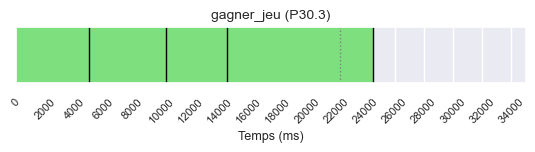

P30_3: 309659it [00:04, 79261.00it/s]

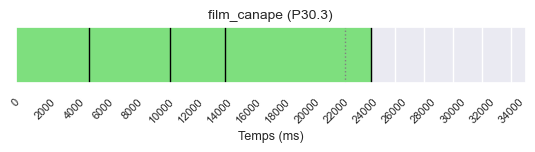

P30_3: 378041it [00:05, 110393.37it/s]

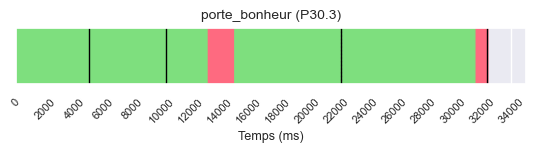

P30_3: 396353it [00:05, 60146.16it/s] 

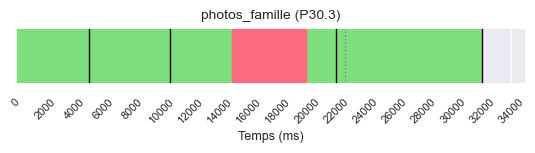

P30_3: 448519it [00:06, 70099.52it/s]

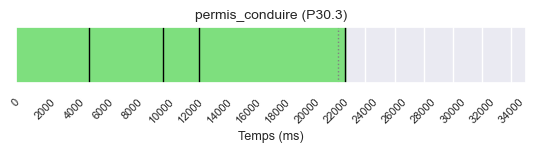

P30_3: 506818it [00:07, 89315.38it/s]

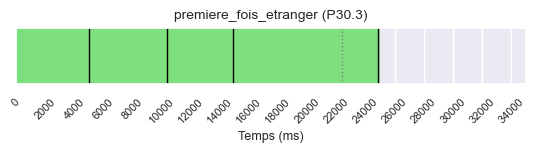

P30_3: 544618it [00:08, 67579.69it/s]
P30_4: 12996it [00:00, 128749.77it/s]

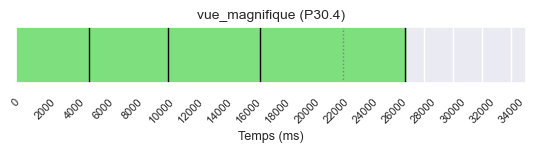

P30_4: 53103it [00:00, 97926.73it/s] 

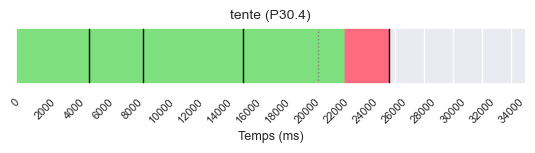

P30_4: 118899it [00:01, 107012.99it/s]

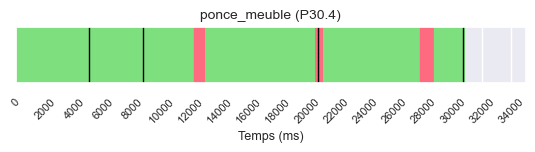

P30_4: 183889it [00:02, 76105.51it/s] 

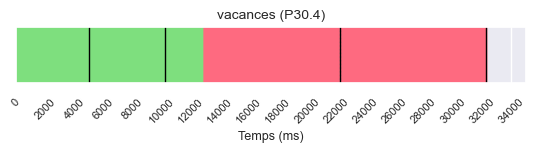

P30_4: 247584it [00:03, 85811.09it/s]

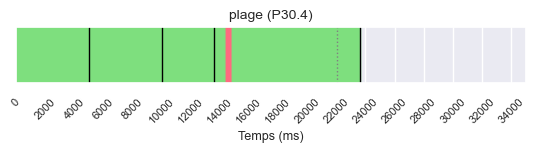

P30_4: 292017it [00:03, 92380.55it/s]

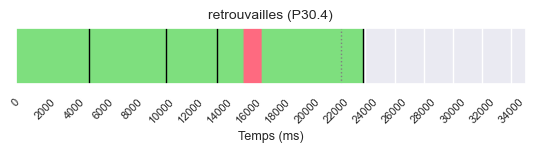

P30_4: 336395it [00:04, 96507.64it/s]

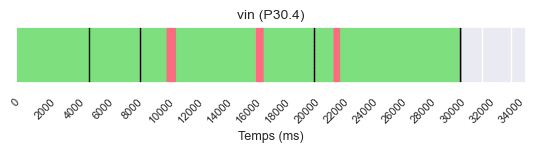

P30_4: 401237it [00:05, 79343.04it/s]

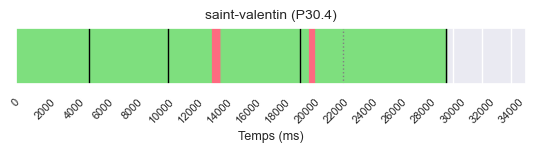

P30_4: 442675it [00:06, 80757.72it/s]

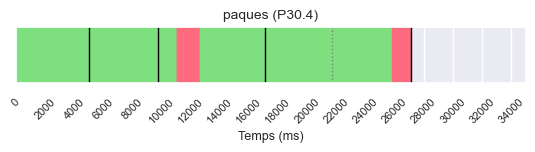

P30_4: 503745it [00:07, 76180.70it/s]

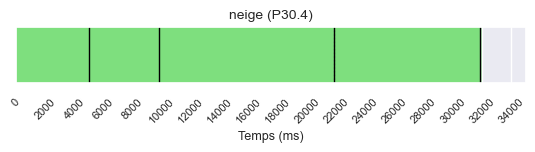

P30_4: 542082it [00:07, 81370.88it/s]

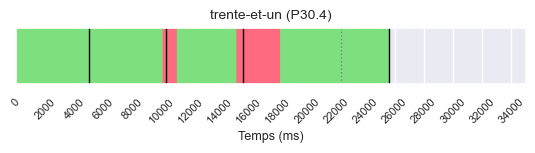

P30_4: 586085it [00:08, 92322.76it/s]

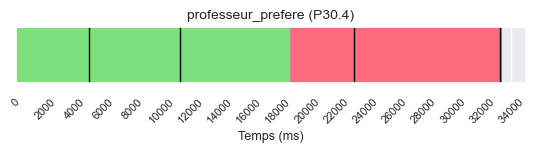

P30_4: 639901it [00:08, 71629.06it/s]
P03_1: 20266it [00:00, 199960.87it/s]

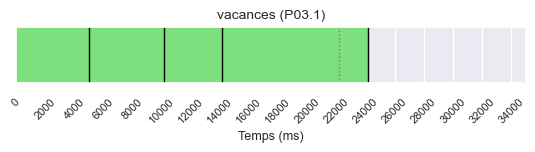

P03_1: 65321it [00:00, 114535.26it/s]

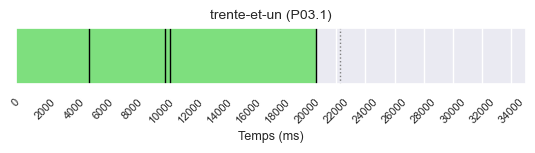

P03_1: 113810it [00:01, 102792.97it/s]

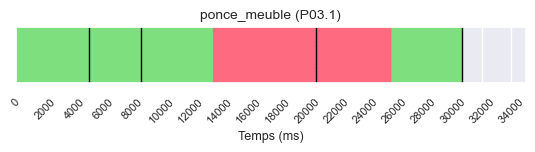

P03_1: 163186it [00:01, 93384.33it/s] 

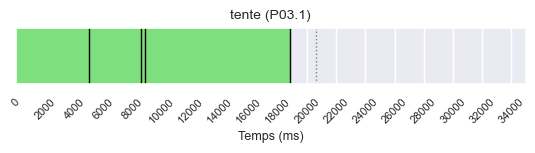

P03_1: 203840it [00:02, 93351.20it/s]

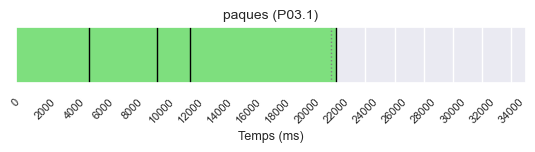

P03_1: 238756it [00:02, 86653.24it/s]

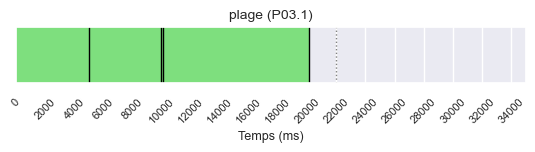

P03_1: 276220it [00:03, 90085.77it/s]

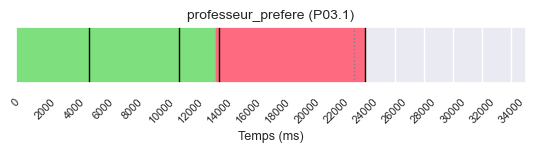

P03_1: 317963it [00:03, 79391.07it/s]

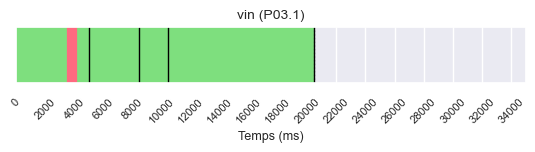

P03_1: 361801it [00:04, 84064.80it/s]

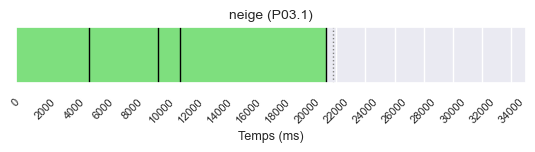

P03_1: 404552it [00:05, 89849.28it/s]

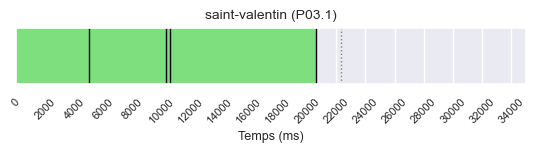

P03_1: 443088it [00:05, 88988.75it/s]

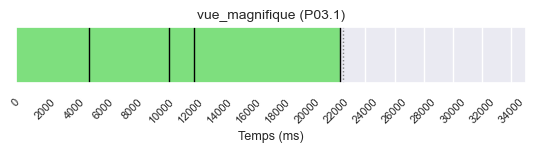

P03_1: 507360it [00:06, 115390.10it/s]

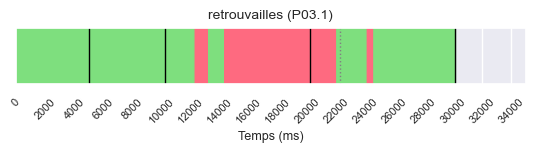

P03_1: 541753it [00:07, 77282.48it/s] 
P03_2: 17042it [00:00, 168971.88it/s]

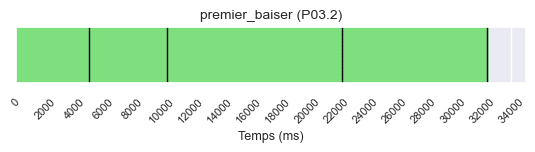

P03_2: 58502it [00:00, 100545.55it/s]

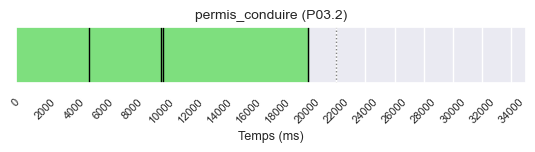

P03_2: 103731it [00:01, 95764.83it/s]

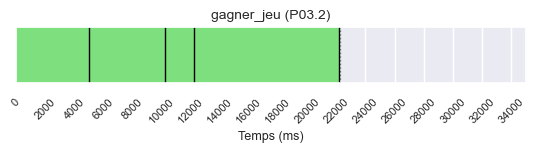

P03_2: 142429it [00:01, 81970.72it/s]

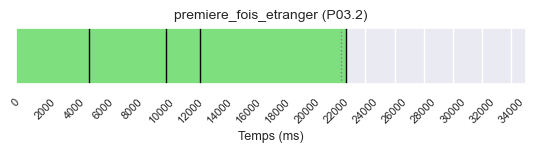

P03_2: 183297it [00:02, 85166.51it/s]

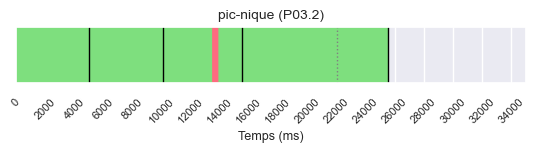

P03_2: 232886it [00:03, 77249.54it/s]

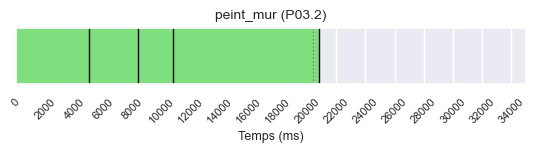

P03_2: 270104it [00:03, 84505.00it/s]

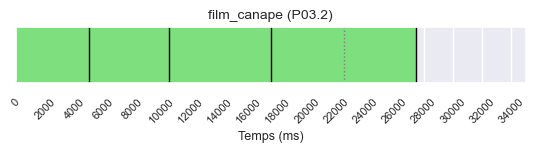

P03_2: 308051it [00:04, 85426.20it/s]

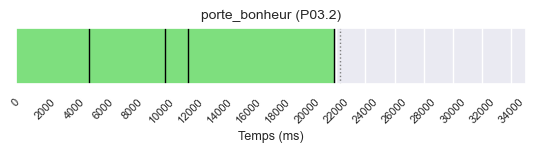

P03_2: 339127it [00:04, 77841.94it/s]

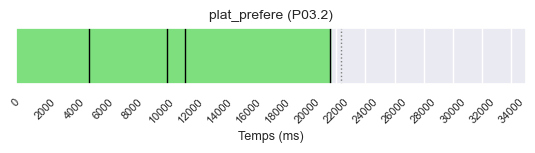

P03_2: 401702it [00:05, 102715.73it/s]

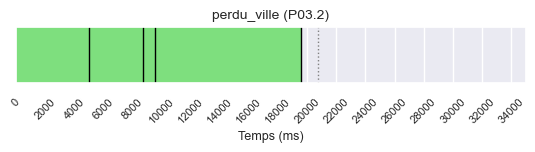

P03_2: 418863it [00:05, 68234.54it/s] 

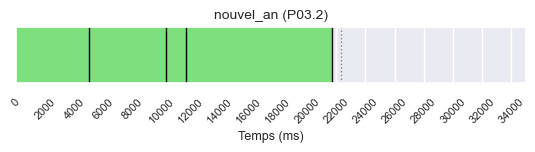

P03_2: 464607it [00:06, 73054.96it/s]

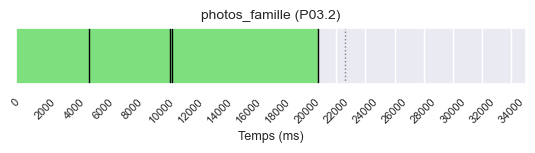

P03_2: 515274it [00:07, 72252.80it/s]
P03_3: 12521it [00:00, 124042.83it/s]

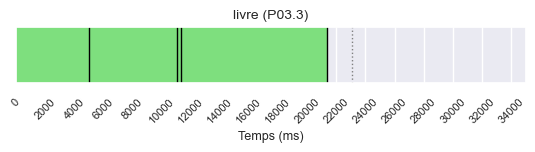

P03_3: 53944it [00:00, 97108.40it/s] 

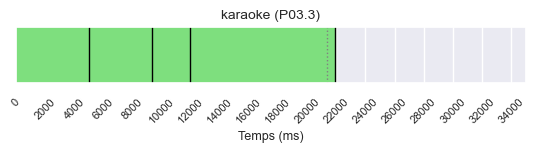

P03_3: 95567it [00:01, 78353.50it/s]

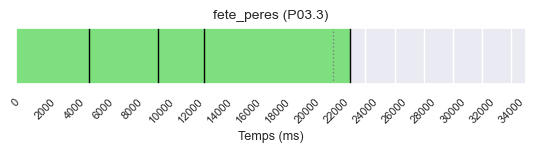

P03_3: 134926it [00:02, 72422.47it/s]

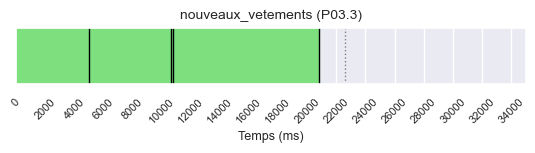

P03_3: 176251it [00:02, 76914.86it/s]

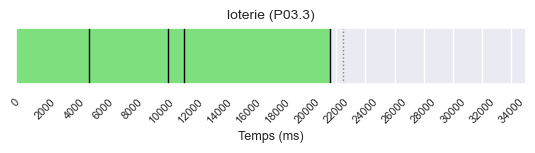

P03_3: 215893it [00:03, 79371.81it/s]

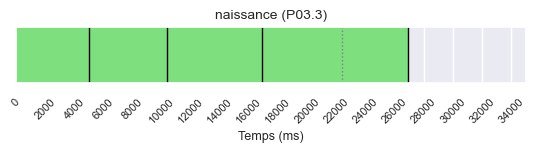

P03_3: 259176it [00:03, 83786.84it/s]

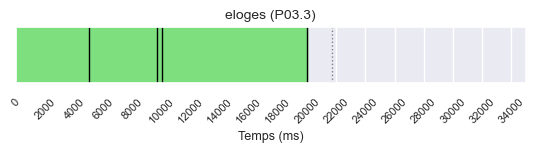

P03_3: 299630it [00:04, 87350.06it/s]

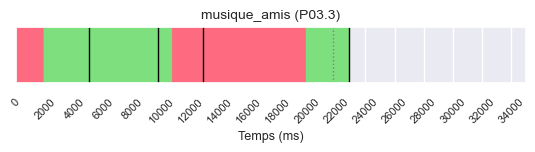

P03_3: 341292it [00:04, 82810.25it/s]

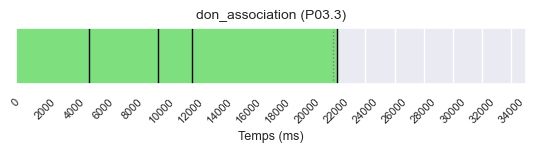

P03_3: 385044it [00:05, 89598.41it/s]

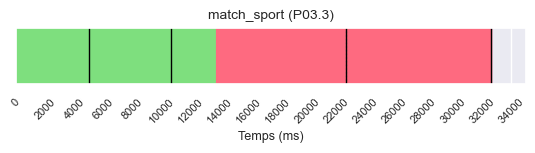

P03_3: 427538it [00:06, 74746.76it/s]

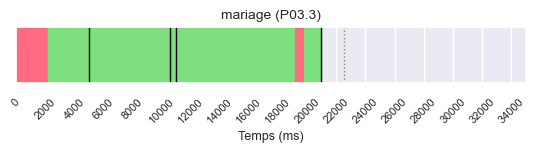

P03_3: 443953it [00:06, 63411.27it/s]

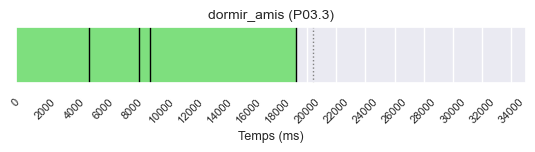

P03_3: 497150it [00:07, 69648.64it/s]
P03_4: 0it [00:00, ?it/s]

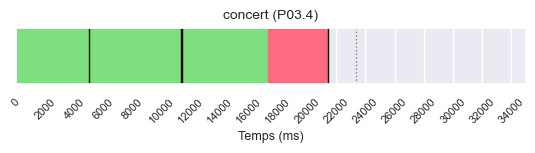

P03_4: 43906it [00:00, 100626.70it/s]

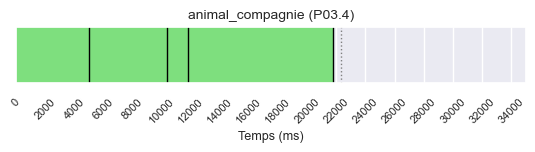

P03_4: 60467it [00:01, 56464.91it/s] 

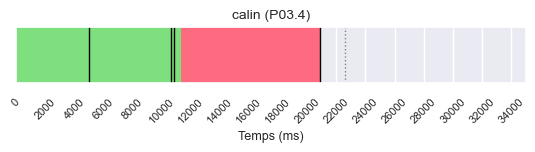

P03_4: 102985it [00:01, 75844.92it/s]

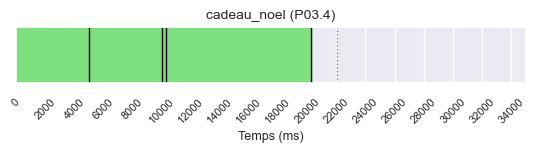

P03_4: 138014it [00:01, 80367.91it/s]

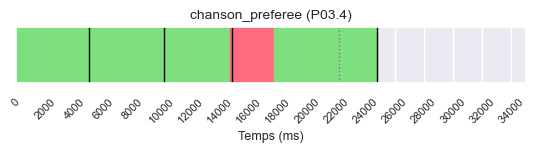

P03_4: 175637it [00:02, 75320.06it/s]

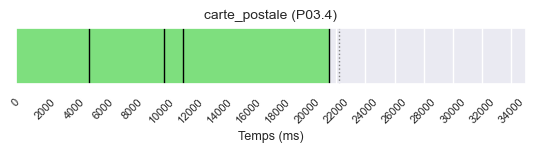

P03_4: 189543it [00:03, 59494.51it/s]

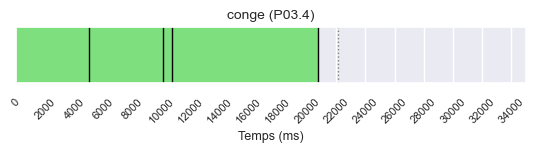

P03_4: 231066it [00:03, 76544.13it/s]

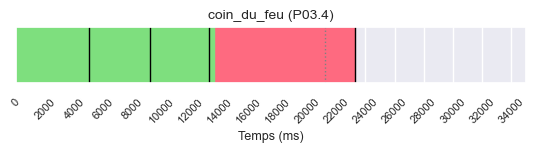

P03_4: 266530it [00:04, 78977.77it/s]

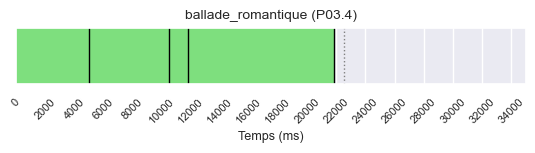

P03_4: 304926it [00:04, 87070.07it/s]

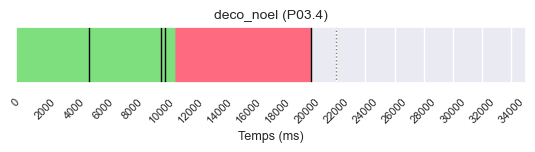

P03_4: 319445it [00:04, 66227.42it/s]

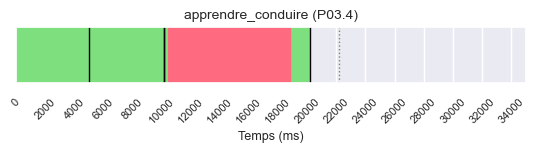

P03_4: 363997it [00:05, 83276.19it/s]

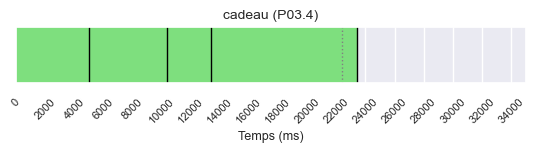

P03_4: 401713it [00:05, 68782.69it/s]
P31_1: 15266it [00:00, 152522.69it/s]

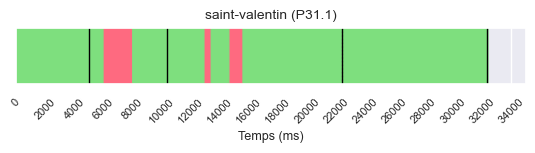

P31_1: 81517it [00:01, 91380.52it/s] 

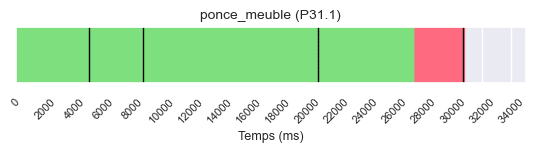

P31_1: 126046it [00:01, 86517.53it/s]

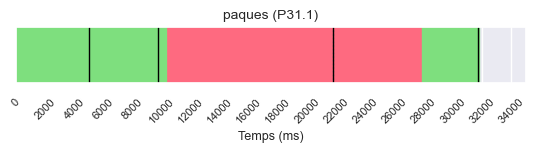

P31_1: 196669it [00:02, 98927.97it/s]

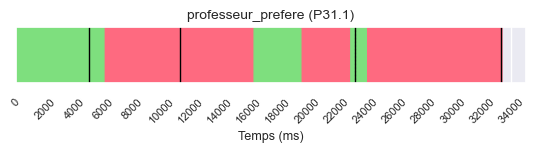

P31_1: 273901it [00:03, 128357.49it/s]

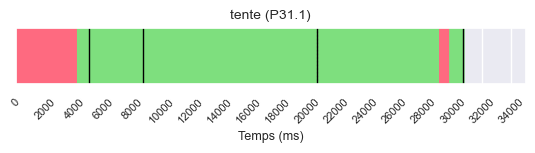

P31_1: 327079it [00:03, 120011.22it/s]

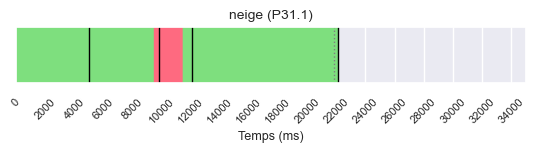

P31_1: 399785it [00:04, 130598.94it/s]

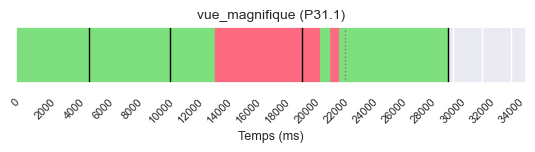

P31_1: 469539it [00:05, 110457.85it/s]

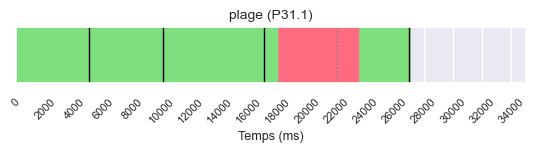

P31_1: 539683it [00:05, 128816.69it/s]

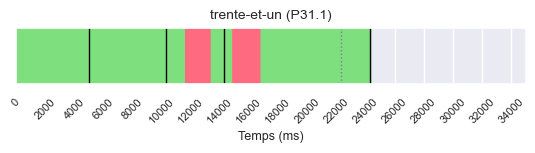

P31_1: 601098it [00:06, 100280.96it/s]

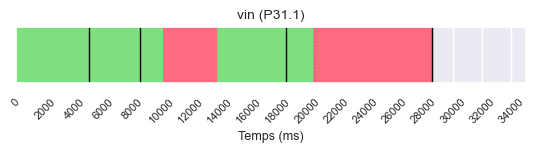

P31_1: 661505it [00:07, 89985.69it/s] 

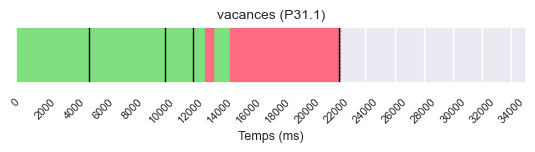

P31_1: 731494it [00:08, 124124.94it/s]

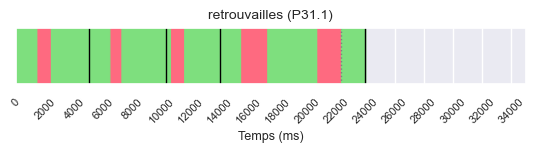

P31_1: 779684it [00:08, 88081.64it/s] 
P31_2: 0it [00:00, ?it/s]

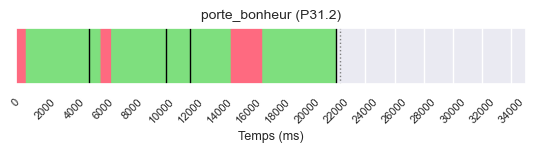

P31_2: 94209it [00:00, 164108.72it/s]

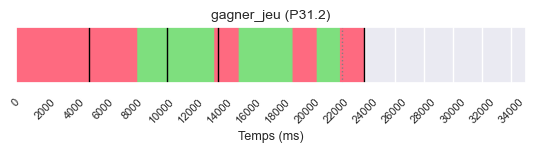

P31_2: 139193it [00:01, 87078.99it/s]

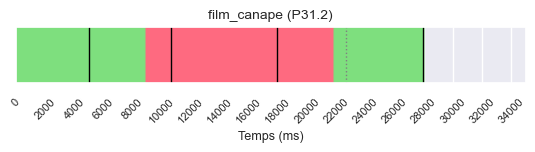

P31_2: 187357it [00:02, 92216.75it/s]

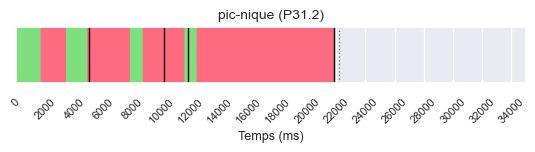

P31_2: 235796it [00:02, 100379.93it/s]

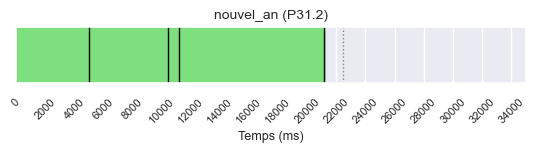

P31_2: 284182it [00:03, 106166.48it/s]

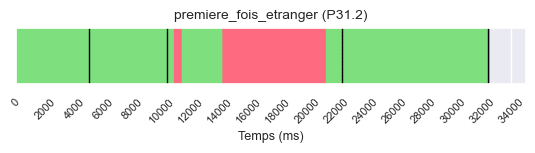

P31_2: 370148it [00:04, 106253.30it/s]

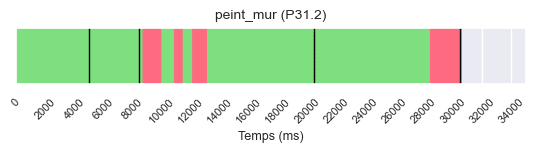

P31_2: 411631it [00:05, 66215.61it/s] 

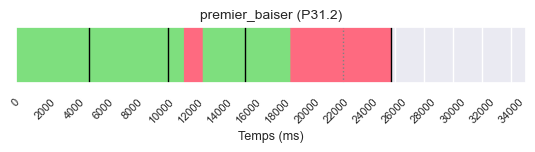

P31_2: 455731it [00:06, 69253.39it/s]

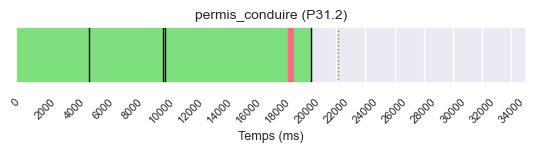

P31_2: 501566it [00:06, 80917.69it/s]

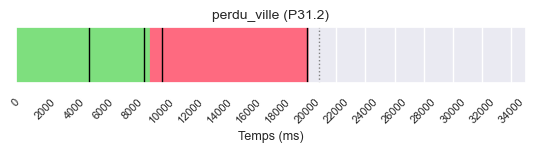

P31_2: 550015it [00:07, 86484.96it/s]

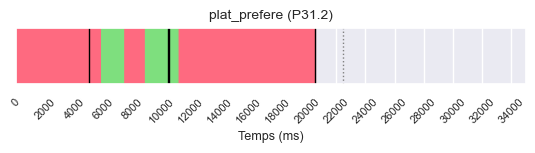

P31_2: 591689it [00:07, 90945.03it/s]

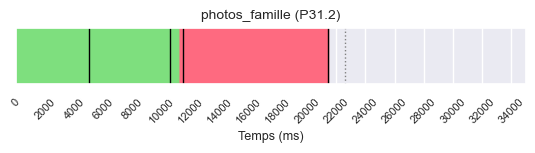

P31_2: 617489it [00:08, 73735.40it/s]
P31_3: 17018it [00:00, 159773.17it/s]

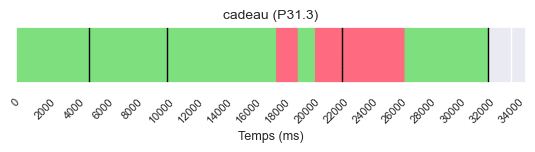

P31_3: 56800it [00:01, 56399.09it/s] 

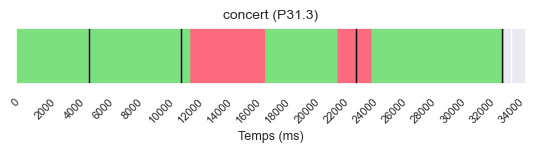

P31_3: 112666it [00:02, 60759.75it/s]

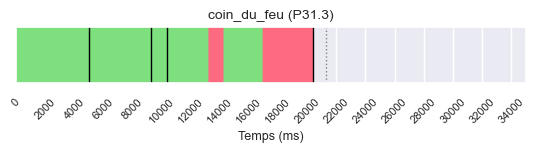

P31_3: 149632it [00:02, 75836.41it/s]

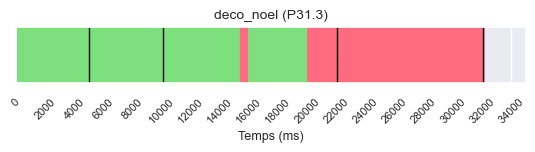

P31_3: 211255it [00:03, 78273.58it/s]

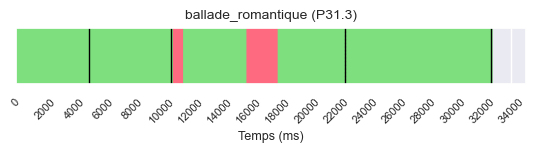

P31_3: 246361it [00:04, 64552.32it/s]

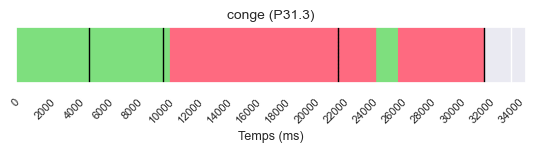

P31_3: 280944it [00:05, 63184.07it/s]

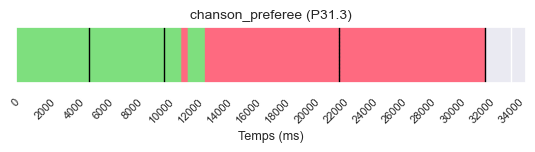

P31_3: 320978it [00:05, 61258.05it/s]

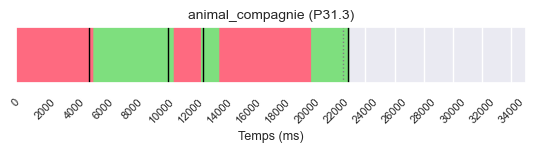

P31_3: 364273it [00:06, 69449.03it/s]

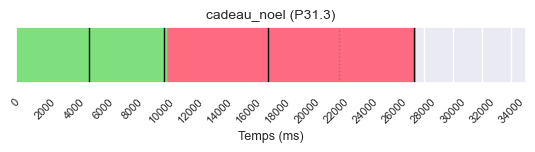

P31_3: 407273it [00:07, 77657.87it/s]

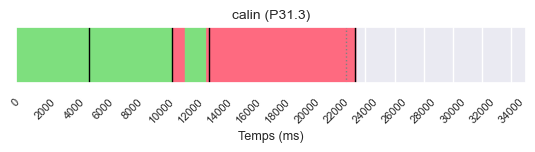

P31_3: 452824it [00:07, 79388.06it/s]

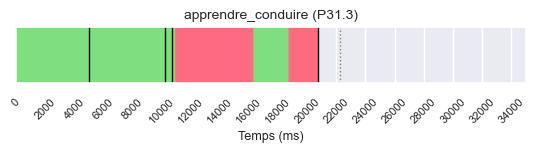

P31_3: 502685it [00:08, 92470.27it/s]

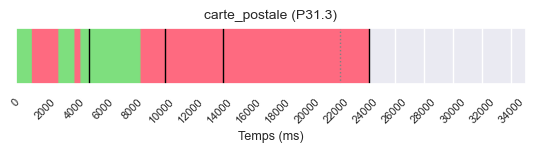

P31_3: 565667it [00:08, 63474.75it/s] 
P31_4: 7980it [00:00, 79278.21it/s]

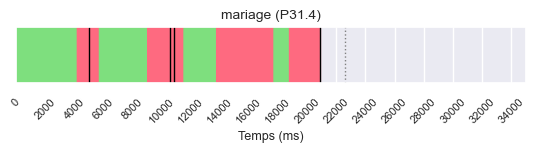

P31_4: 43237it [00:00, 89070.67it/s]

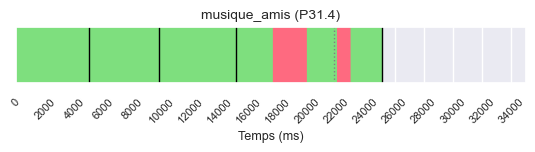

P31_4: 105024it [00:01, 104954.80it/s]

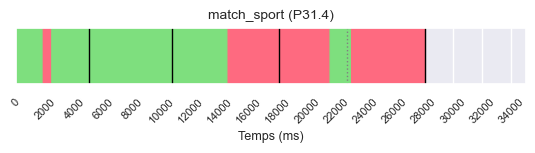

P31_4: 168047it [00:01, 111351.72it/s]

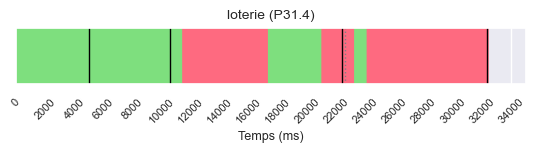

P31_4: 208048it [00:02, 72921.36it/s] 

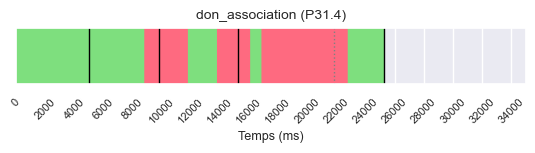

P31_4: 266731it [00:03, 93465.69it/s]

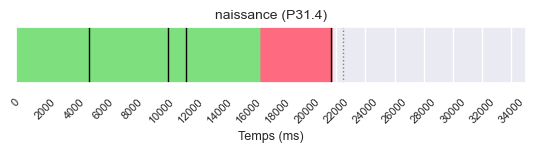

P31_4: 308761it [00:03, 97813.94it/s]

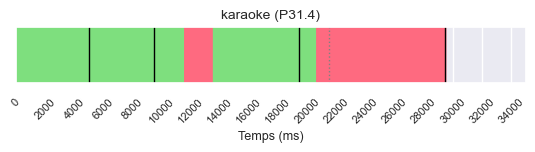

P31_4: 375320it [00:04, 102632.58it/s]

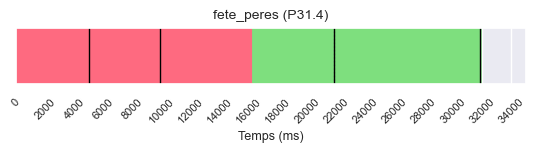

P31_4: 393241it [00:05, 75692.50it/s] 

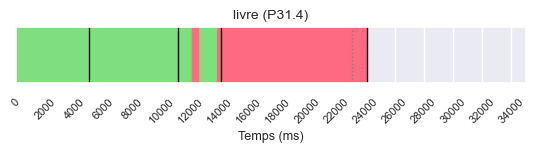

P31_4: 458850it [00:06, 88315.36it/s]

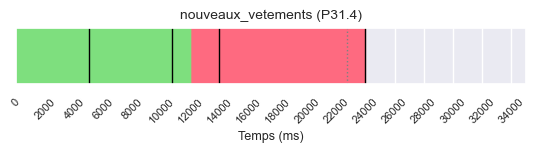

P31_4: 496269it [00:06, 73671.23it/s]

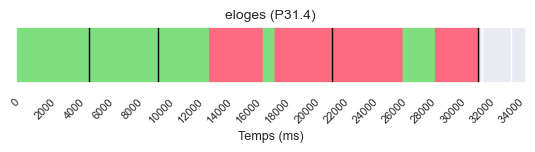

P31_4: 534124it [00:07, 60950.27it/s]

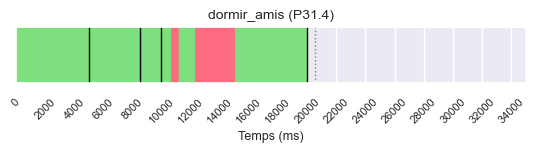

P31_4: 564316it [00:08, 69408.46it/s]
P32_1: 9458it [00:00, 93971.14it/s]

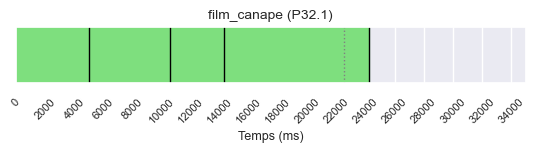

P32_1: 44308it [00:00, 88567.63it/s]

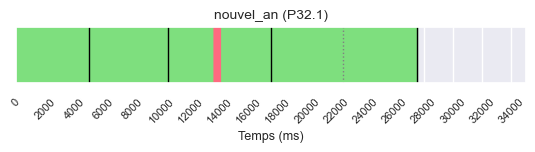

P32_1: 85481it [00:01, 66775.81it/s]

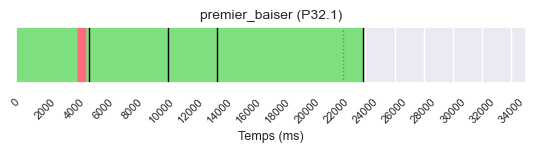

P32_1: 123981it [00:01, 77600.75it/s]

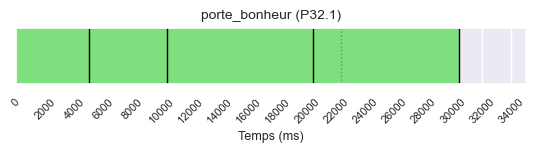

P32_1: 162852it [00:02, 82020.32it/s]

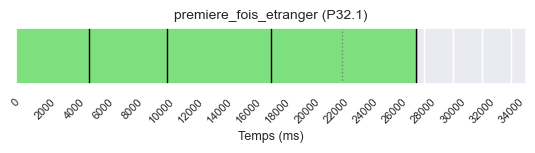

P32_1: 228107it [00:03, 107392.32it/s]

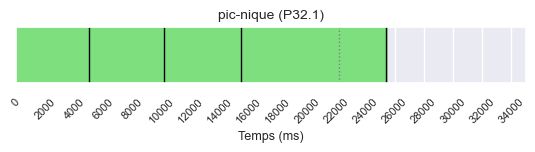

P32_1: 266967it [00:03, 96445.47it/s] 

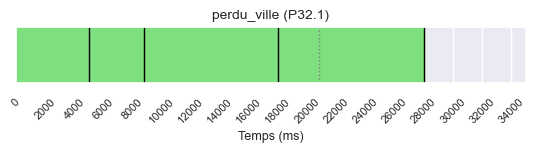

P32_1: 299389it [00:04, 73848.58it/s]

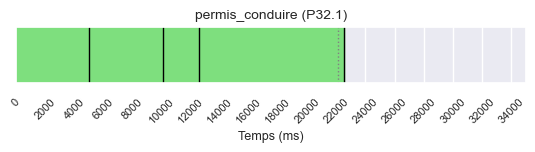

P32_1: 339208it [00:04, 79479.72it/s]

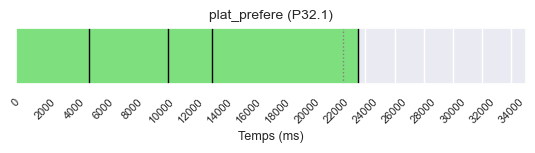

P32_1: 382941it [00:05, 90000.52it/s]

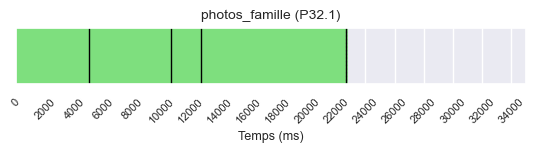

P32_1: 423391it [00:05, 87704.10it/s]

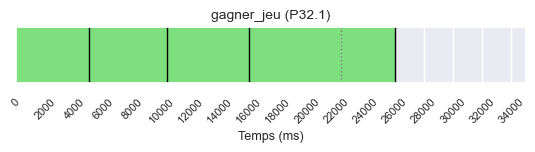

P32_1: 463008it [00:06, 86842.02it/s]

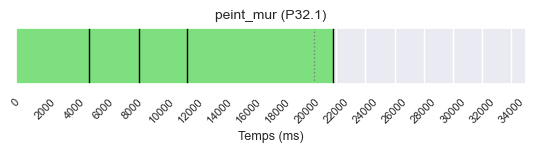

P32_1: 485653it [00:06, 71365.84it/s]
P32_2: 11959it [00:00, 118686.31it/s]

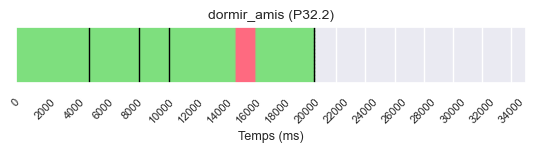

P32_2: 45816it [00:00, 91031.44it/s] 

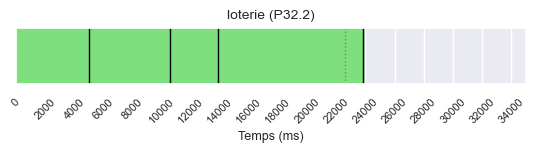

P32_2: 85364it [00:01, 84003.44it/s]

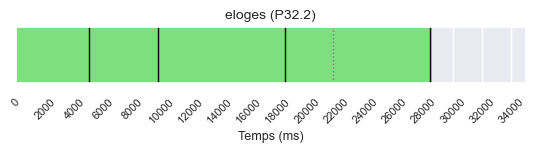

P32_2: 130033it [00:01, 92488.59it/s]

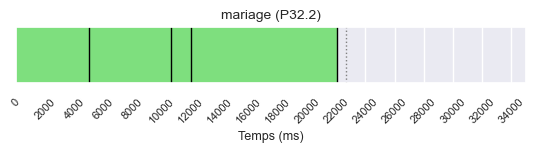

P32_2: 175592it [00:02, 99001.99it/s]

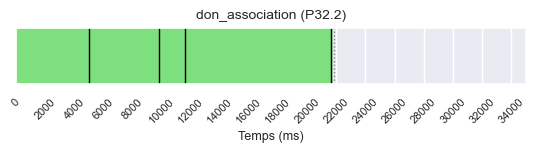

P32_2: 216965it [00:02, 95854.90it/s]

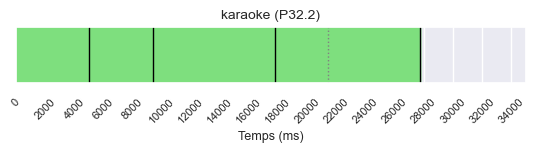

P32_2: 256667it [00:03, 92938.44it/s]

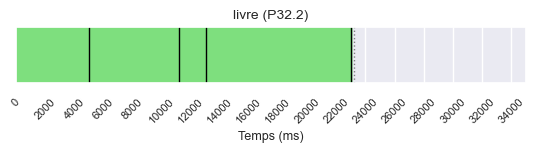

P32_2: 298746it [00:03, 94176.99it/s]

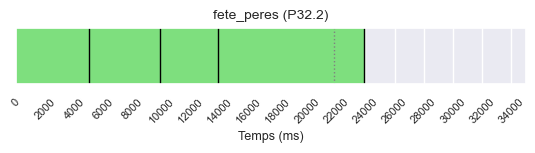

P32_2: 335478it [00:04, 88288.18it/s]

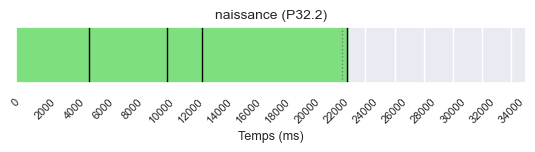

P32_2: 350419it [00:04, 67881.78it/s]

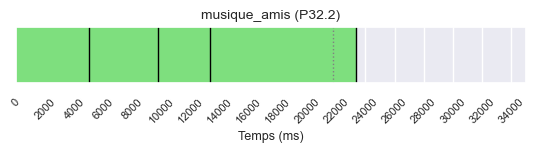

P32_2: 385784it [00:05, 77406.54it/s]

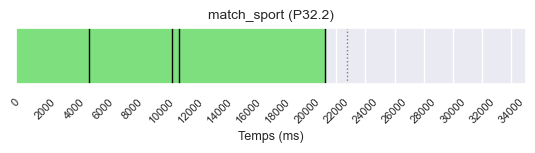

P32_2: 422334it [00:05, 82799.55it/s]

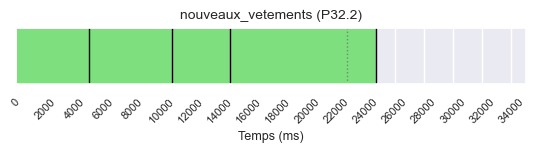

P32_2: 446713it [00:05, 75105.52it/s]
P32_3: 16750it [00:00, 165881.80it/s]

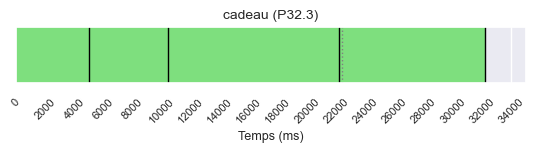

P32_3: 54305it [00:00, 93556.86it/s] 

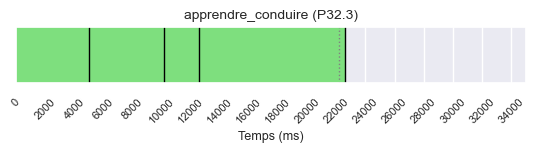

P32_3: 68815it [00:01, 57422.87it/s]

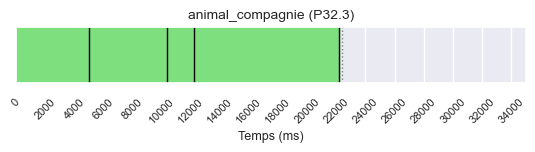

P32_3: 112719it [00:01, 76699.29it/s]

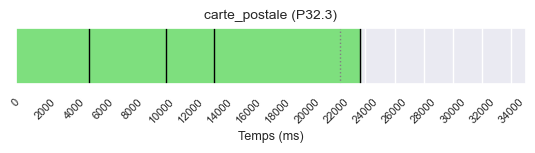

P32_3: 153775it [00:02, 85371.39it/s]

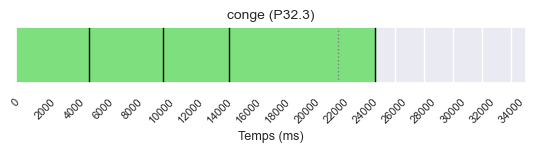

P32_3: 191402it [00:02, 84018.37it/s]

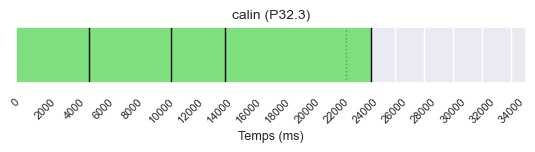

P32_3: 232435it [00:03, 88574.40it/s]

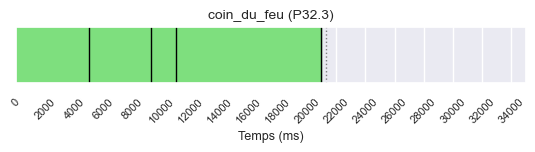

P32_3: 269097it [00:03, 84356.62it/s]

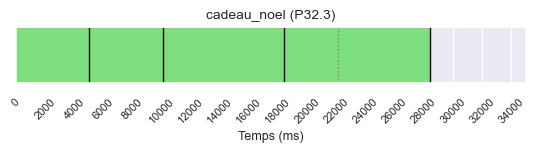

P32_3: 310289it [00:04, 89361.61it/s]

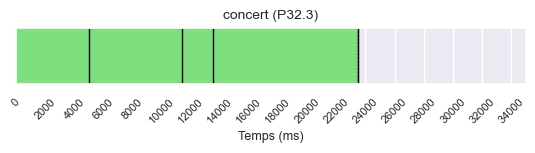

P32_3: 349506it [00:04, 91539.68it/s]

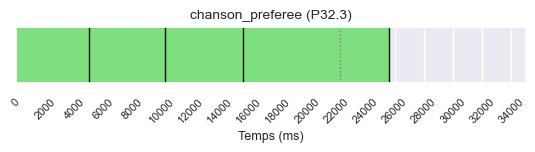

P32_3: 383483it [00:05, 82729.82it/s]

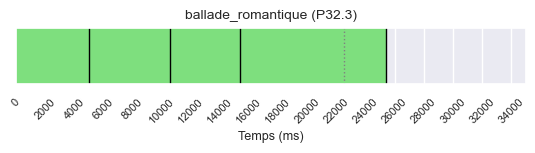

P32_3: 419248it [00:05, 83766.07it/s]

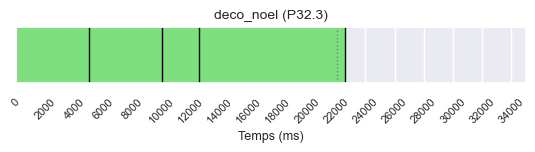

P32_3: 442721it [00:06, 72953.65it/s]
P32_4: 10404it [00:00, 103244.04it/s]

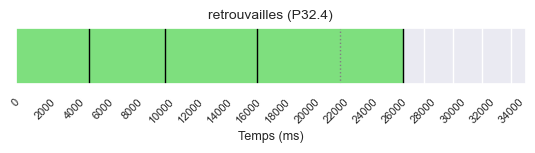

P32_4: 45408it [00:00, 89034.84it/s] 

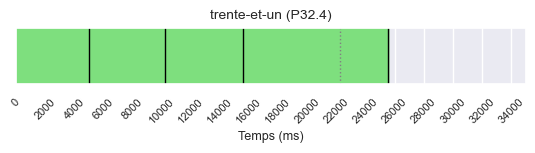

P32_4: 85721it [00:01, 84081.50it/s]

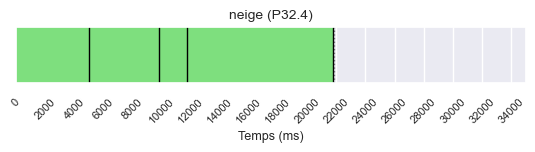

P32_4: 125994it [00:01, 87756.21it/s]

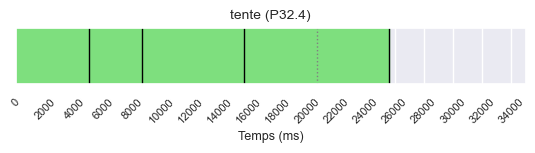

P32_4: 164499it [00:02, 88017.97it/s]

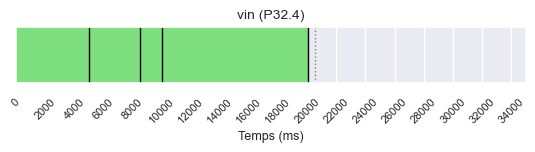

P32_4: 179752it [00:02, 65987.30it/s]

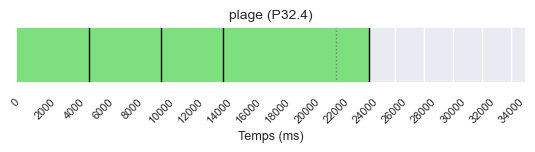

P32_4: 241889it [00:03, 93848.08it/s]

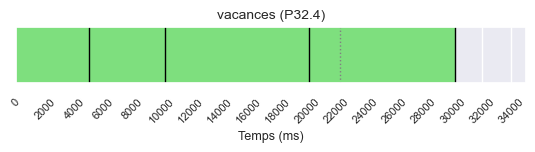

P32_4: 281201it [00:03, 94516.79it/s]

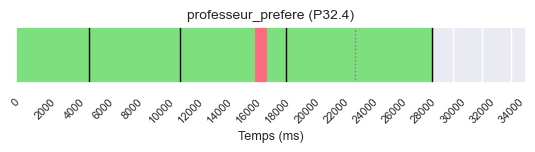

P32_4: 323292it [00:04, 79481.56it/s]

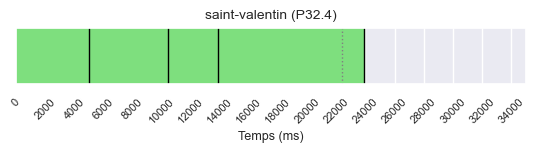

P32_4: 357157it [00:04, 79315.84it/s]

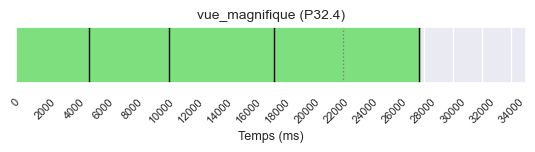

P32_4: 392879it [00:05, 82218.11it/s]

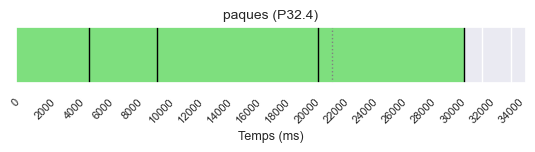

P32_4: 406957it [00:05, 62376.51it/s]

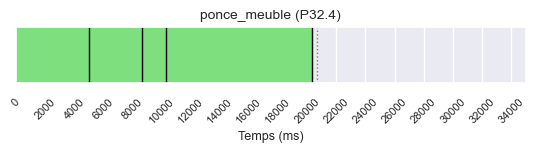

P32_4: 443918it [00:06, 70879.43it/s]
P33_1: 11041it [00:00, 107074.54it/s]

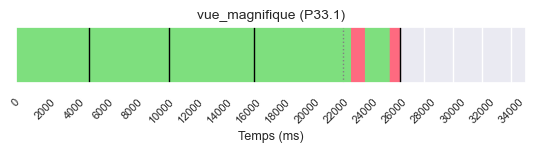

P33_1: 48003it [00:00, 94461.56it/s] 

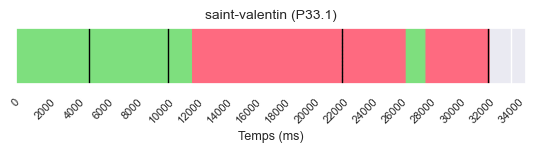

P33_1: 90075it [00:01, 68467.51it/s]

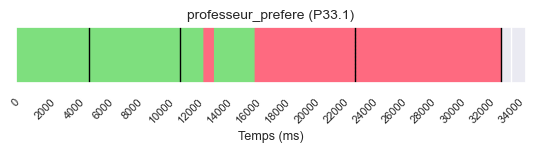

P33_1: 130506it [00:02, 60528.45it/s]

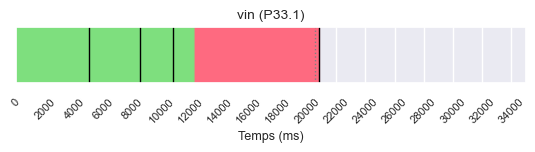

P33_1: 173813it [00:02, 79562.29it/s]

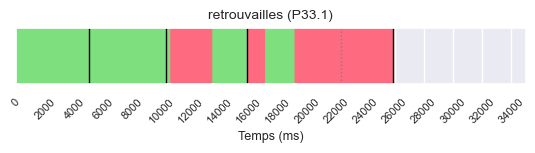

P33_1: 216961it [00:03, 69100.48it/s]

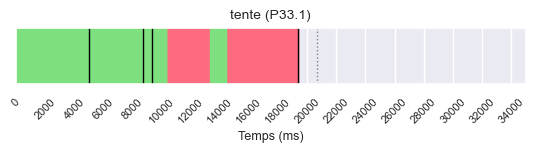

P33_1: 257740it [00:04, 80946.62it/s]

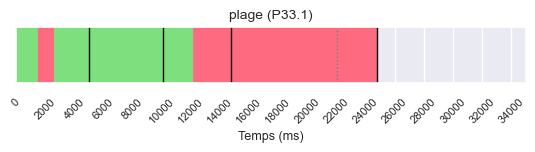

P33_1: 303013it [00:04, 79678.57it/s]

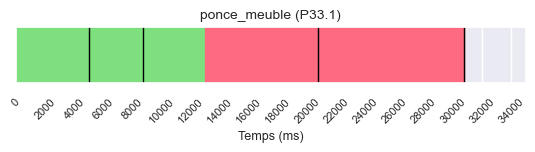

P33_1: 370248it [00:05, 95645.25it/s]

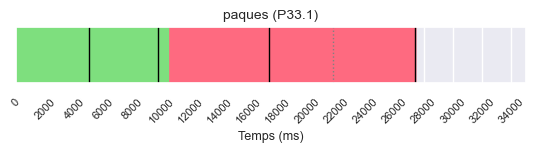

P33_1: 411280it [00:06, 80217.63it/s]

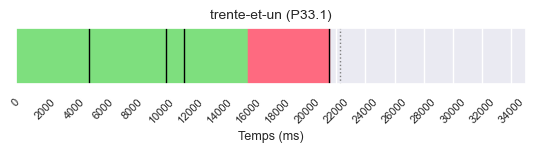

P33_1: 454800it [00:06, 91557.14it/s]

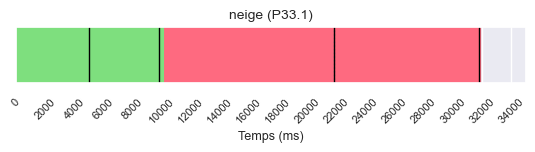

P33_1: 515187it [00:07, 100116.90it/s]

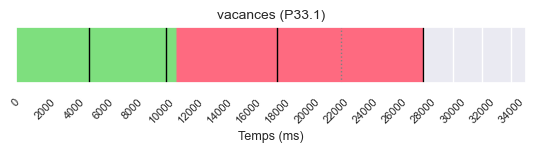

P33_1: 555416it [00:08, 68320.56it/s] 
P33_2: 0it [00:00, ?it/s]

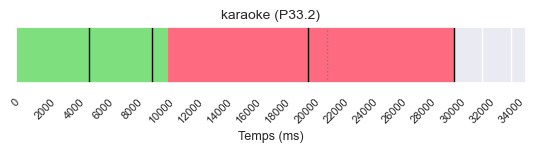

P33_2: 57856it [00:01, 75418.02it/s]

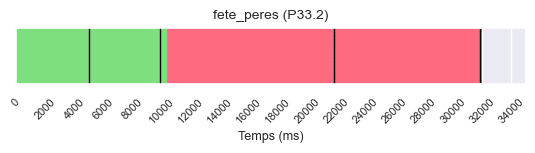

P33_2: 122201it [00:01, 96088.84it/s]

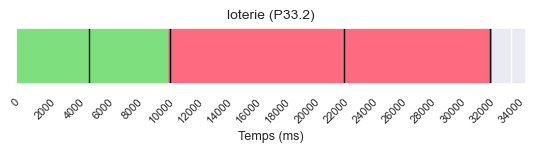

P33_2: 166718it [00:02, 101240.08it/s]

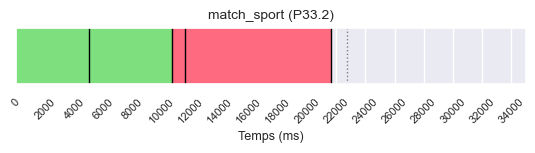

P33_2: 211581it [00:02, 104333.66it/s]

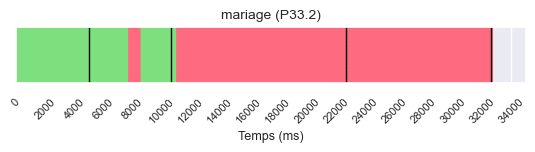

P33_2: 274968it [00:03, 107606.14it/s]

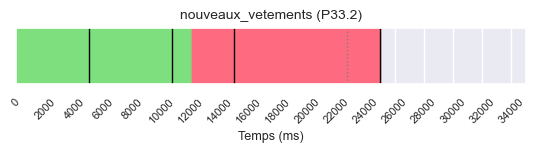

P33_2: 315615it [00:04, 86753.49it/s] 

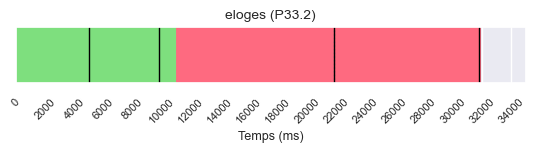

P33_2: 356975it [00:05, 78464.39it/s]

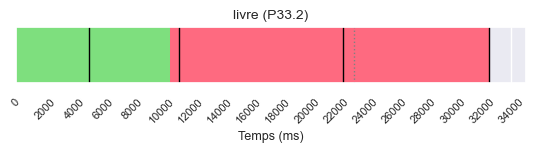

P33_2: 400899it [00:05, 89561.99it/s]

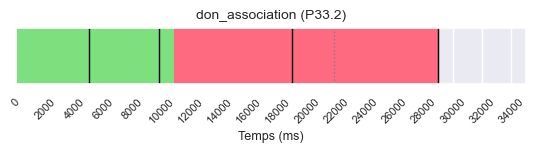

P33_2: 440469it [00:06, 76023.69it/s]

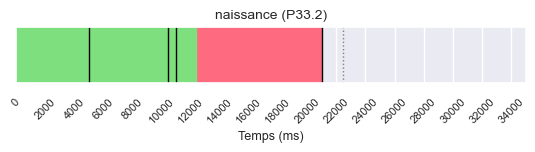

P33_2: 488317it [00:06, 90675.89it/s]

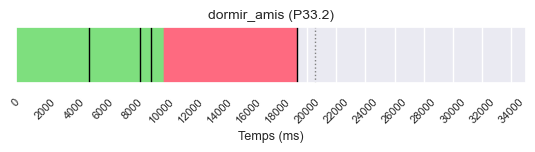

P33_2: 530618it [00:07, 95286.55it/s]

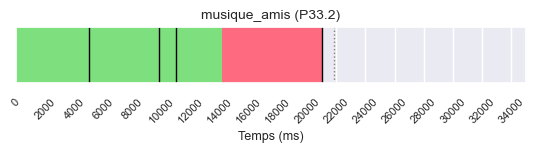

P33_2: 555860it [00:07, 72714.62it/s]
P33_3: 12597it [00:00, 123466.53it/s]

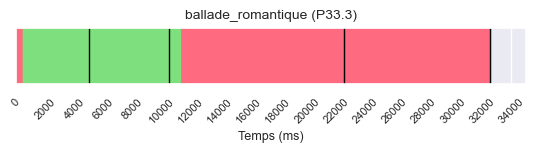

P33_3: 43802it [00:00, 58619.19it/s] 

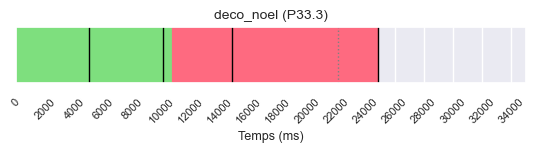

P33_3: 78771it [00:01, 56124.02it/s]

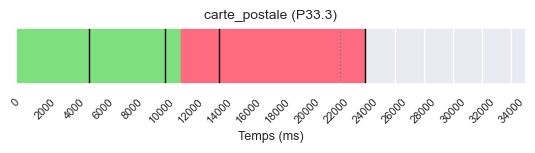

P33_3: 116061it [00:02, 62151.40it/s]

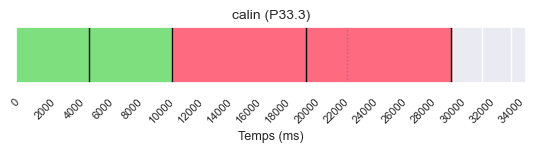

P33_3: 157873it [00:02, 77418.72it/s]

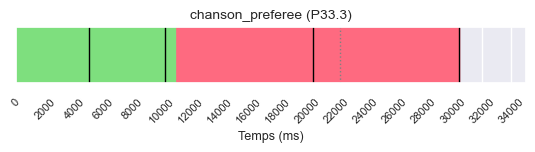

P33_3: 201696it [00:03, 75004.22it/s]

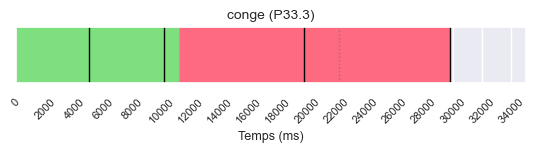

P33_3: 244997it [00:04, 72604.90it/s]

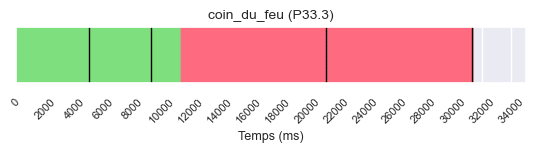

P33_3: 314909it [00:05, 94494.10it/s]

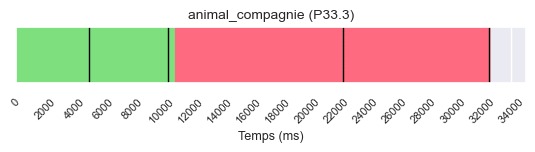

P33_3: 357721it [00:05, 82180.42it/s]

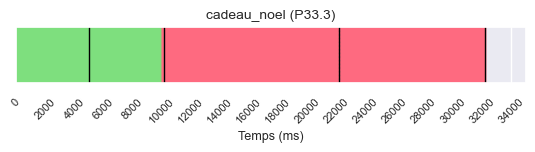

P33_3: 395730it [00:06, 84520.45it/s]

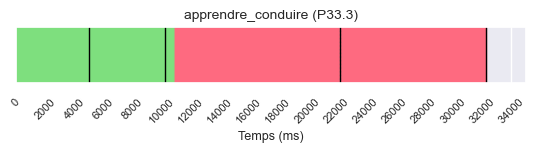

P33_3: 432151it [00:06, 70102.66it/s]

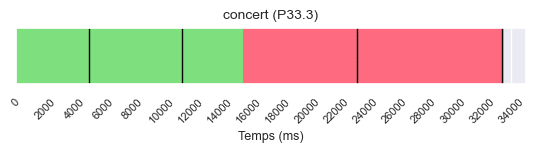

P33_3: 446343it [00:07, 47661.32it/s]

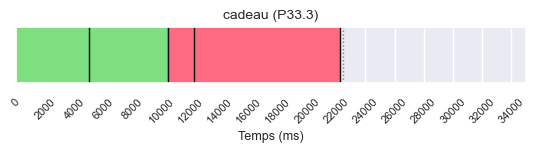

P33_3: 499491it [00:08, 61982.82it/s]
P33_4: 14214it [00:00, 130874.62it/s]

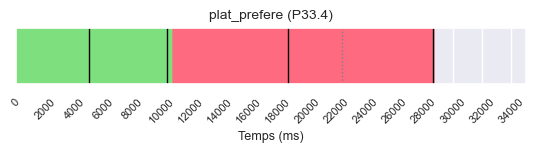

P33_4: 45739it [00:00, 69802.75it/s] 

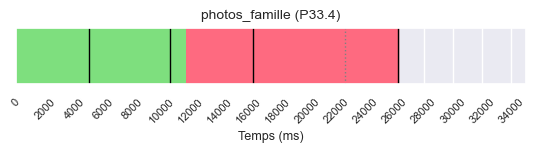

P33_4: 76209it [00:01, 51826.41it/s]

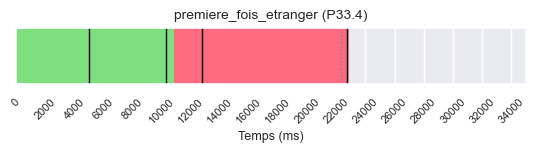

P33_4: 133443it [00:02, 82085.27it/s]

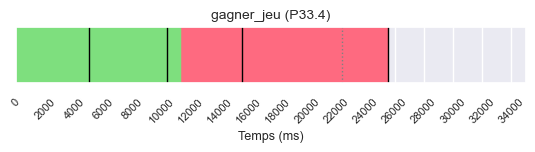

P33_4: 169252it [00:02, 70535.13it/s]

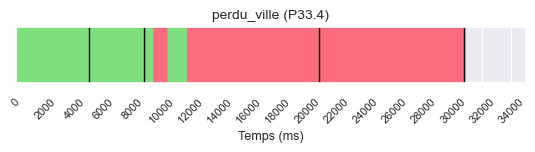

P33_4: 208217it [00:03, 60572.50it/s]

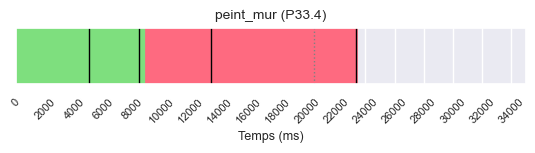

P33_4: 222890it [00:04, 47590.76it/s]

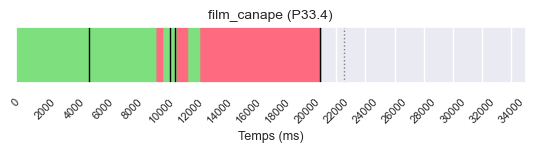

P33_4: 265832it [00:04, 65897.72it/s]

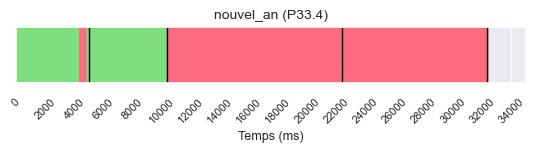

P33_4: 303526it [00:05, 75050.32it/s]

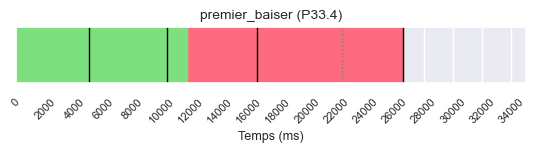

P33_4: 317982it [00:05, 51010.55it/s]

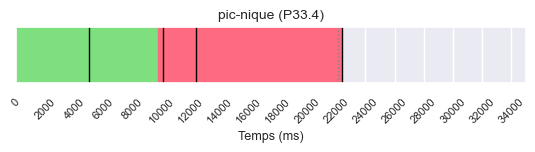

P33_4: 369161it [00:06, 76679.63it/s]

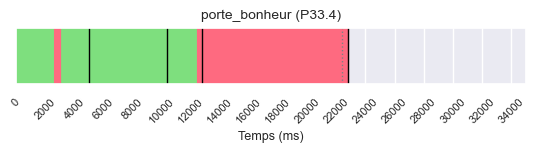

P33_4: 416907it [00:07, 68167.82it/s]

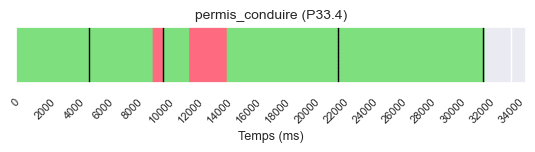

P33_4: 423766it [00:07, 54746.75it/s]
P04_1: 18879it [00:00, 187746.77it/s]

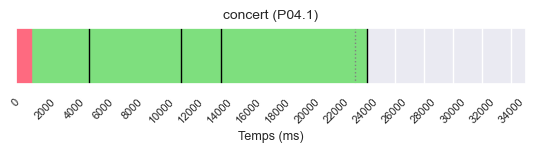

P04_1: 112232it [00:00, 164800.79it/s]

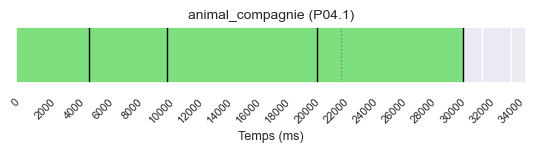

P04_1: 183564it [00:01, 134704.01it/s]

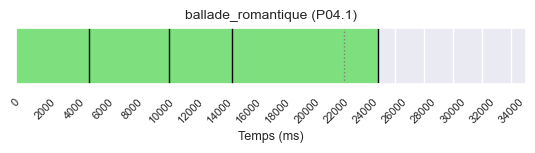

P04_1: 252036it [00:02, 132540.67it/s]

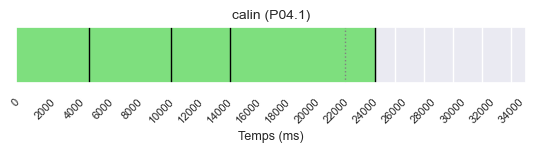

P04_1: 316997it [00:02, 130982.61it/s]

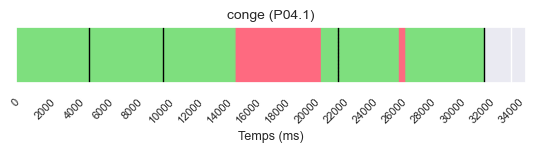

P04_1: 361503it [00:03, 92330.09it/s] 

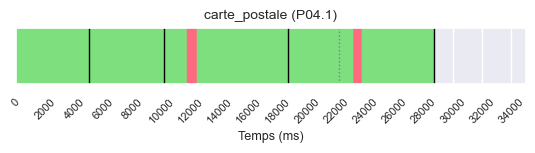

P04_1: 488439it [00:04, 155176.37it/s]

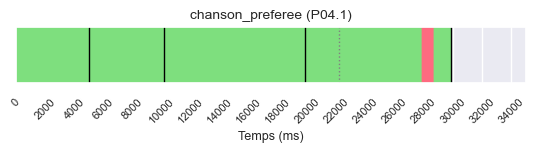

P04_1: 557342it [00:05, 140311.91it/s]

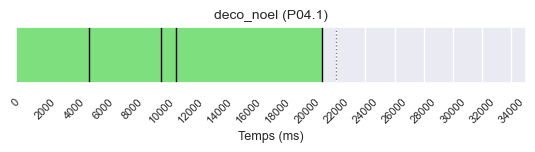

P04_1: 597555it [00:05, 111459.06it/s]

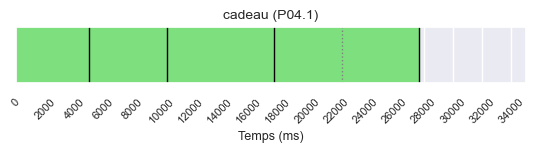

P04_1: 664344it [00:06, 125424.04it/s]

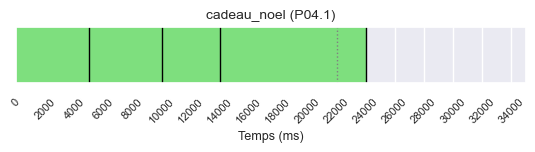

P04_1: 710370it [00:06, 112661.52it/s]

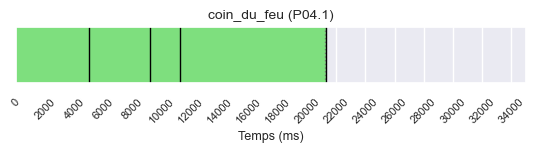

P04_1: 777599it [00:07, 119561.60it/s]

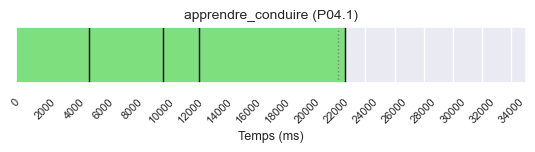

P04_1: 835596it [00:07, 105025.85it/s]
P04_2: 0it [00:00, ?it/s]

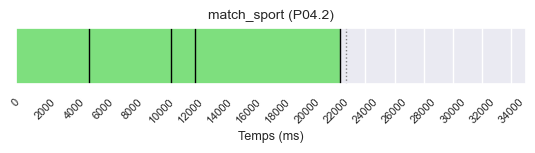

P04_2: 49973it [00:00, 112392.51it/s]

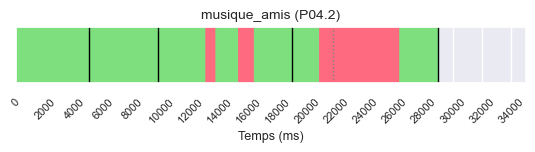

P04_2: 96224it [00:01, 66870.25it/s] 

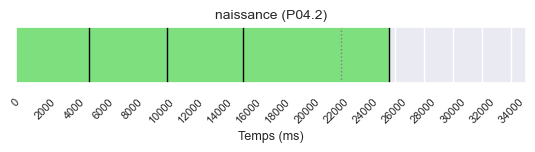

P04_2: 172820it [00:02, 110642.20it/s]

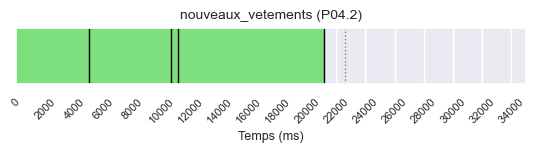

P04_2: 245038it [00:02, 131086.73it/s]

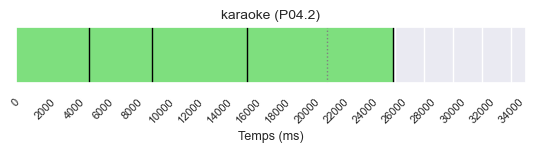

P04_2: 313943it [00:03, 135411.41it/s]

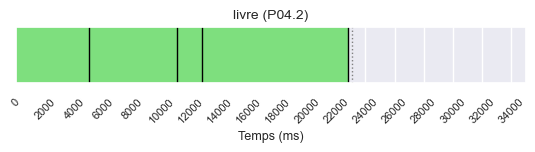

P04_2: 357812it [00:03, 116356.05it/s]

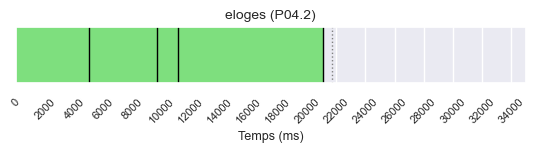

P04_2: 402192it [00:04, 109603.68it/s]

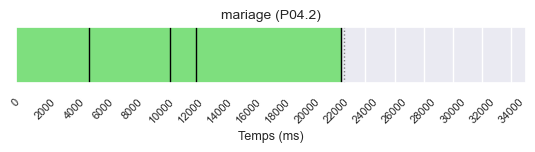

P04_2: 480213it [00:04, 136922.09it/s]

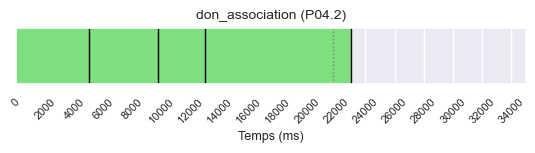

P04_2: 552993it [00:05, 141755.67it/s]

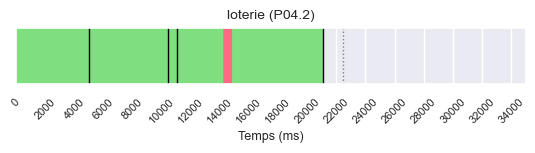

P04_2: 629886it [00:06, 153422.17it/s]

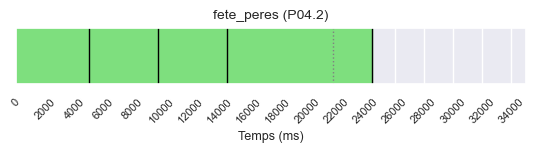

P04_2: 678784it [00:06, 124915.30it/s]

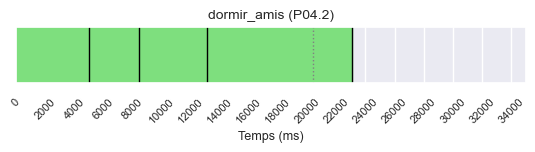

P04_2: 729562it [00:07, 100548.14it/s]
P04_3: 10734it [00:00, 106840.33it/s]

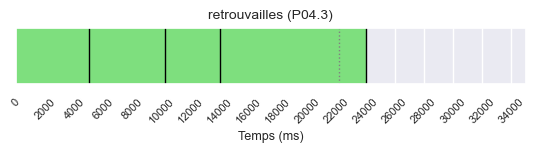

P04_3: 67567it [00:00, 122063.04it/s]

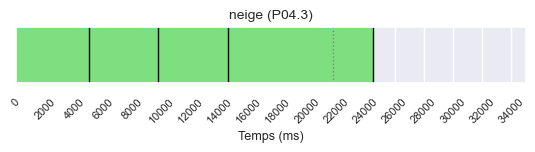

P04_3: 111376it [00:01, 95750.75it/s]

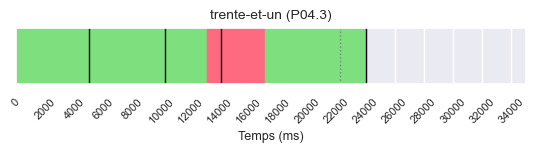

P04_3: 172056it [00:02, 78694.32it/s]

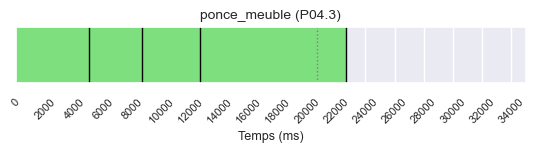

P04_3: 234199it [00:03, 99199.20it/s]

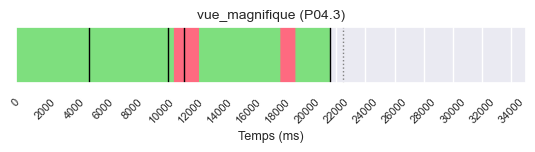

P04_3: 302820it [00:03, 109797.94it/s]

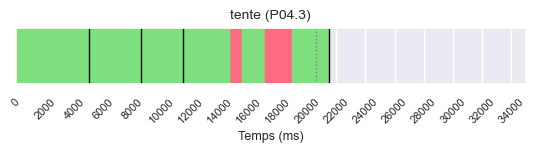

P04_3: 365549it [00:04, 124186.96it/s]

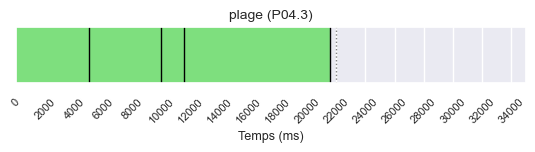

P04_3: 409085it [00:04, 114031.33it/s]

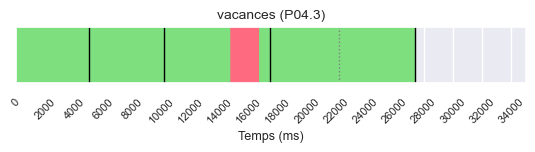

P04_3: 473608it [00:05, 110022.70it/s]

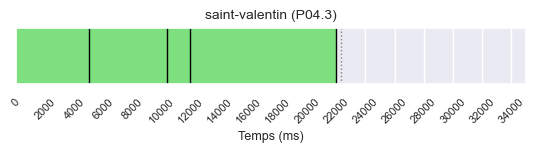

P04_3: 568372it [00:06, 153339.11it/s]

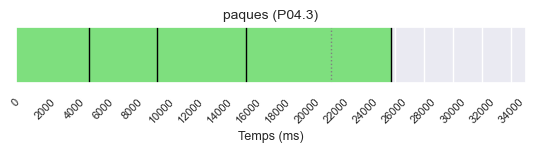

P04_3: 638755it [00:06, 145461.63it/s]

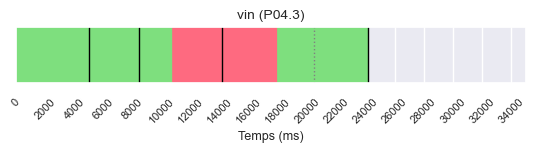

P04_3: 685433it [00:07, 112434.00it/s]

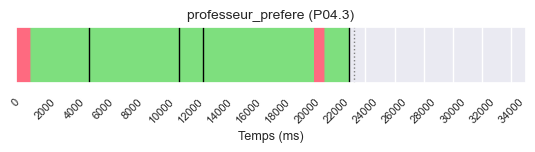

P04_3: 744120it [00:07, 93075.10it/s] 
P04_4: 13063it [00:00, 129918.32it/s]

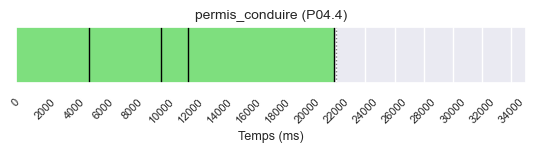

P04_4: 85359it [00:00, 156589.37it/s]

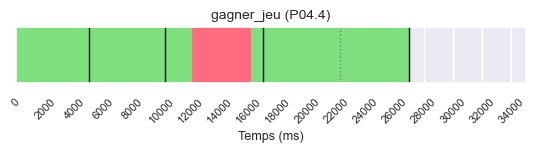

P04_4: 158823it [00:01, 124186.43it/s]

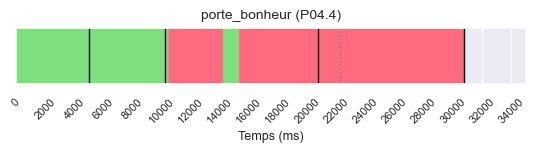

P04_4: 204467it [00:02, 83991.13it/s] 

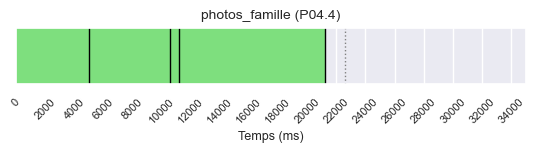

P04_4: 248537it [00:02, 93057.63it/s]

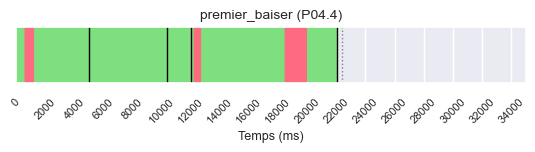

P04_4: 303366it [00:03, 97499.96it/s]

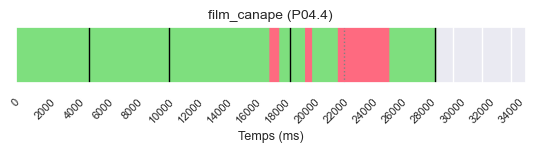

P04_4: 340203it [00:04, 73214.85it/s]

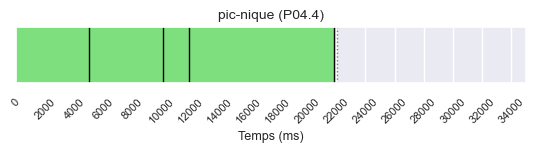

P04_4: 379002it [00:04, 83949.85it/s]

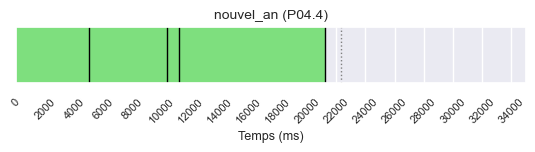

P04_4: 420968it [00:05, 90762.71it/s]

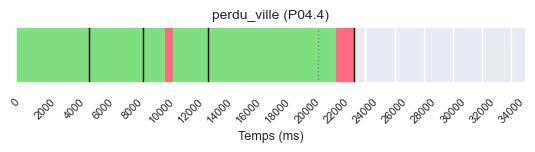

P04_4: 464822it [00:05, 79927.61it/s]

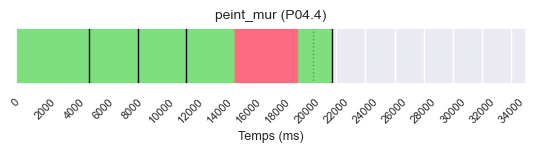

P04_4: 527034it [00:06, 104686.95it/s]

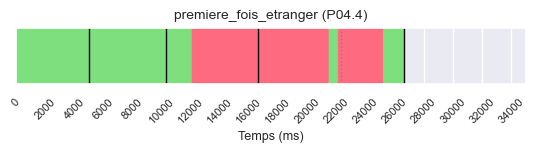

P04_4: 570008it [00:07, 90167.59it/s] 

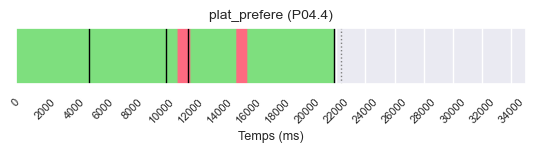

P04_4: 621622it [00:08, 77539.58it/s]
P05_1: 22285it [00:00, 221104.80it/s]

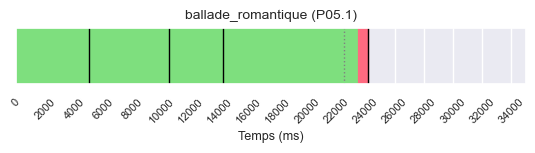

P05_1: 70448it [00:00, 112958.55it/s]

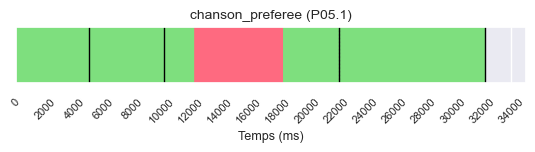

P05_1: 142041it [00:01, 91367.18it/s]

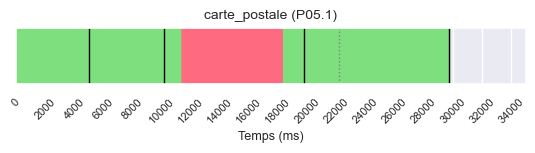

P05_1: 180466it [00:02, 73821.65it/s]

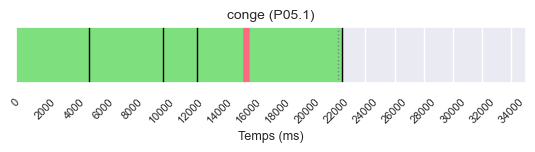

P05_1: 270346it [00:03, 130038.49it/s]

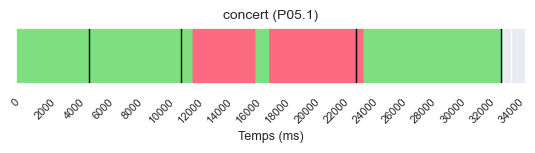

P05_1: 316774it [00:04, 83341.04it/s] 

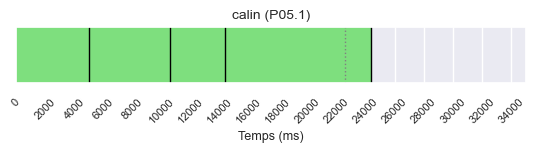

P05_1: 360405it [00:04, 90201.33it/s]

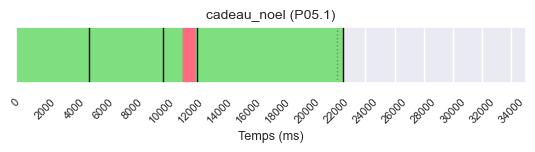

P05_1: 409177it [00:05, 84792.28it/s]

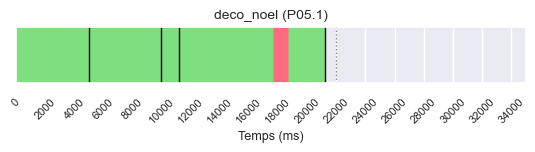

P05_1: 454615it [00:05, 95500.68it/s]

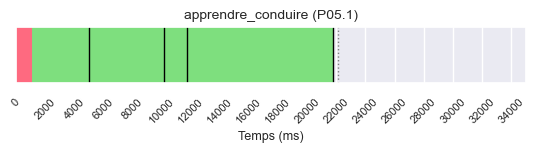

P05_1: 500590it [00:06, 101813.04it/s]

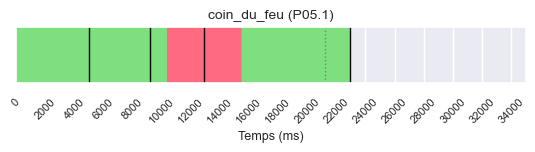

P05_1: 563584it [00:07, 102623.86it/s]

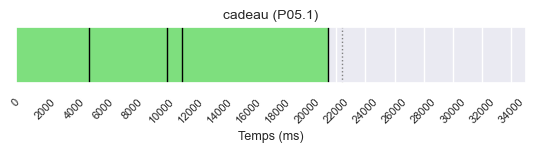

P05_1: 603846it [00:07, 98928.89it/s] 

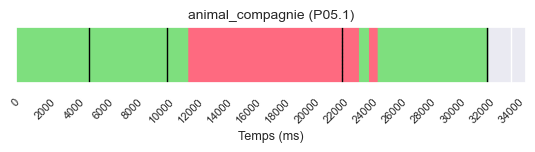

P05_1: 670544it [00:08, 79578.39it/s]
P05_2: 14787it [00:00, 147796.85it/s]

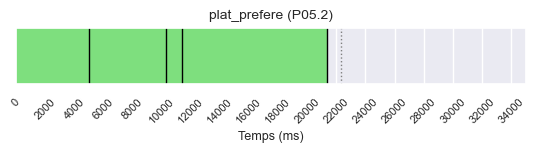

P05_2: 53680it [00:00, 99713.37it/s] 

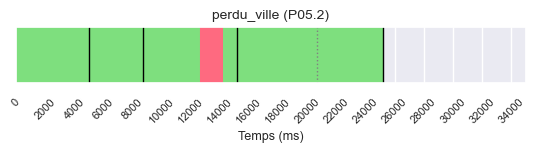

P05_2: 95098it [00:01, 69802.75it/s]

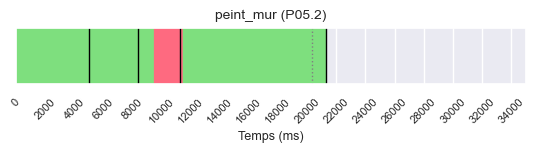

P05_2: 140765it [00:02, 74412.66it/s]

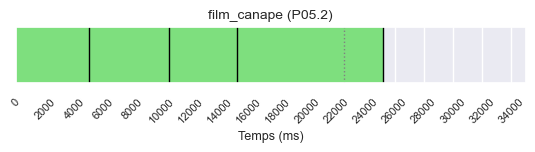

P05_2: 186898it [00:02, 82031.90it/s]

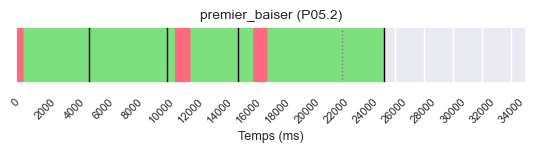

P05_2: 231528it [00:03, 81110.42it/s]

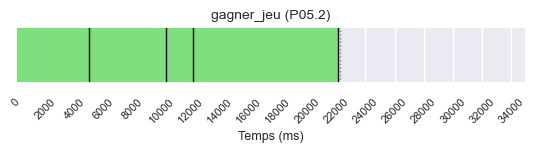

P05_2: 297051it [00:04, 100884.84it/s]

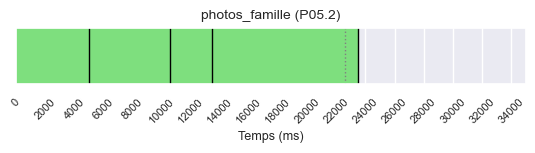

P05_2: 338252it [00:04, 99448.76it/s] 

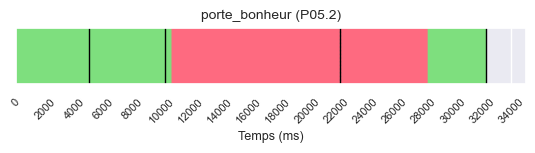

P05_2: 375993it [00:05, 80322.22it/s]

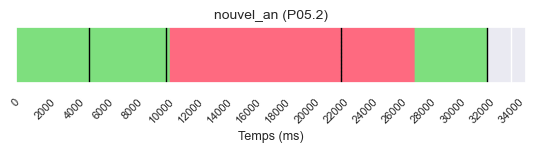

P05_2: 423330it [00:05, 88546.84it/s]

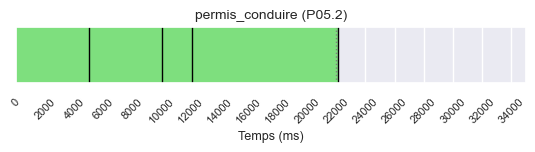

P05_2: 466965it [00:06, 92573.05it/s]

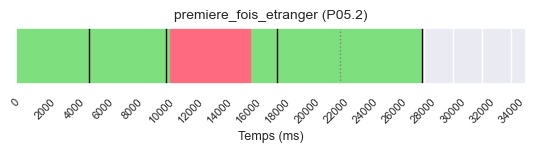

P05_2: 534151it [00:07, 106277.99it/s]

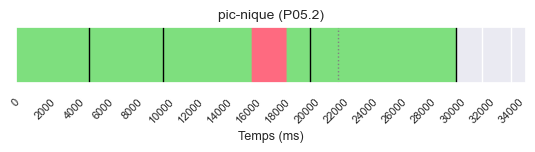

P05_2: 581589it [00:07, 73940.87it/s] 
P05_3: 8118it [00:00, 80811.31it/s]

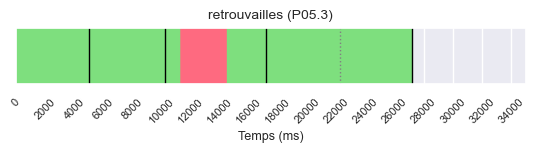

P05_3: 65191it [00:01, 79951.83it/s]

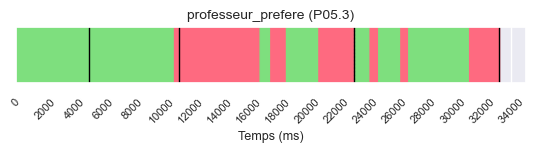

P05_3: 105704it [00:01, 78294.00it/s]

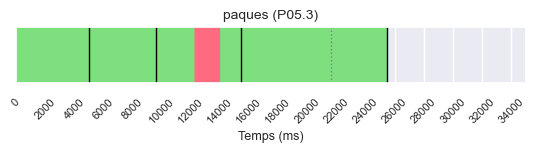

P05_3: 161202it [00:02, 87451.74it/s]

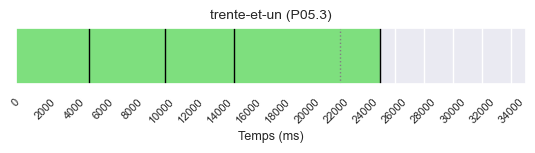

P05_3: 223683it [00:03, 110034.55it/s]

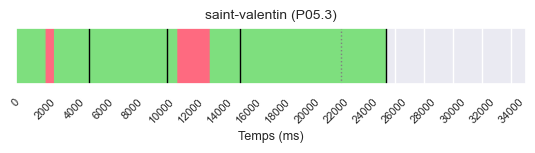

P05_3: 261035it [00:03, 81967.52it/s] 

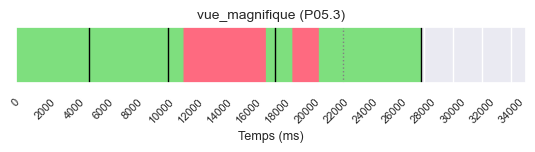

P05_3: 298675it [00:04, 68220.36it/s]

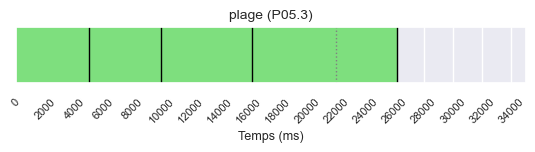

P05_3: 333086it [00:05, 73869.31it/s]

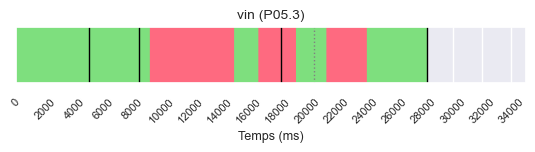

P05_3: 373909it [00:05, 64371.32it/s]

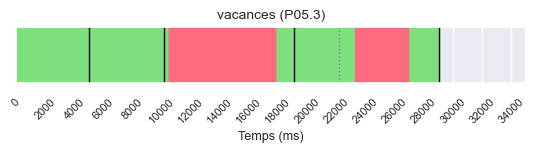

P05_3: 411372it [00:06, 65514.10it/s]

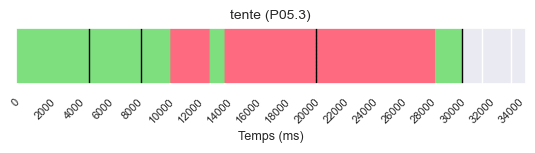

P05_3: 501791it [00:07, 101388.96it/s]

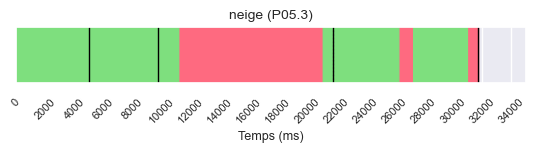

P05_3: 548012it [00:08, 82809.33it/s] 

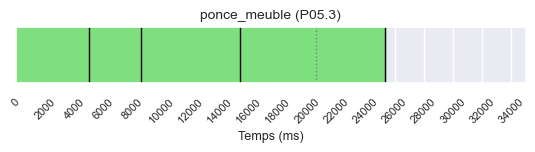

P05_3: 579727it [00:08, 64908.91it/s]
P05_4: 19039it [00:00, 189971.22it/s]

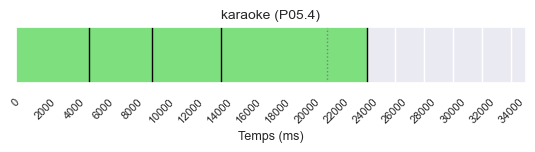

P05_4: 61968it [00:00, 102976.59it/s]

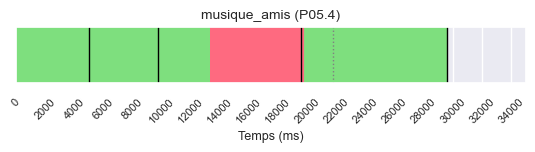

P05_4: 102803it [00:01, 76653.28it/s]

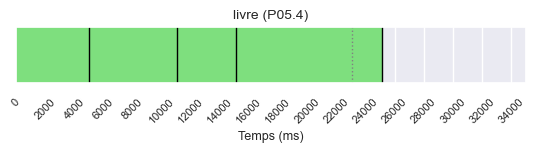

P05_4: 141420it [00:01, 79712.09it/s]

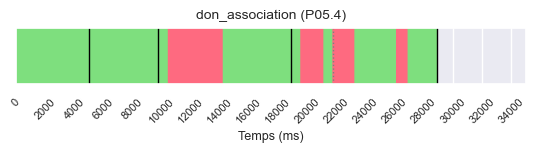

P05_4: 184155it [00:02, 74508.21it/s]

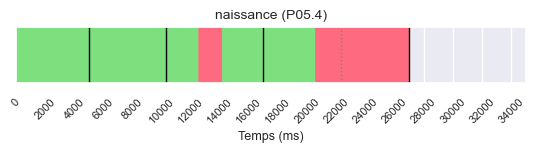

P05_4: 247836it [00:03, 89371.89it/s]

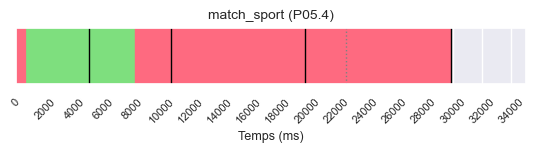

P05_4: 283276it [00:03, 85049.66it/s]

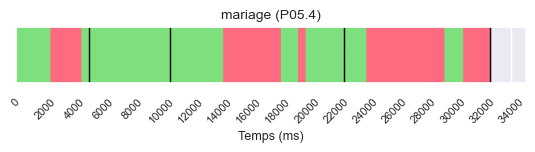

P05_4: 377238it [00:05, 102461.47it/s]

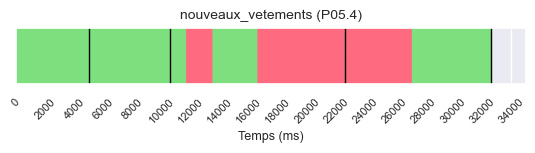

P05_4: 418961it [00:06, 74241.31it/s] 

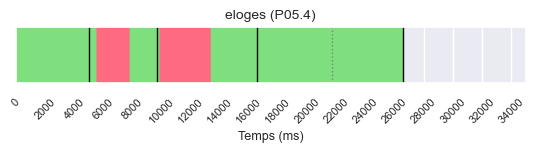

P05_4: 461810it [00:06, 82924.54it/s]

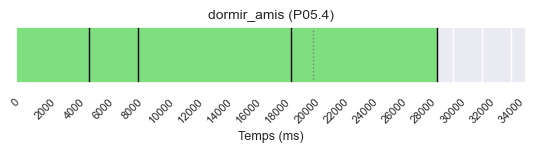

P05_4: 505096it [00:07, 90163.16it/s]

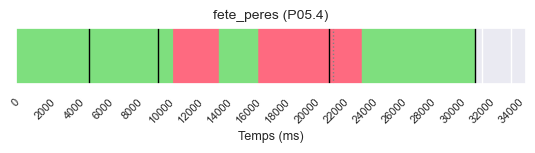

P05_4: 549832it [00:08, 71237.47it/s]

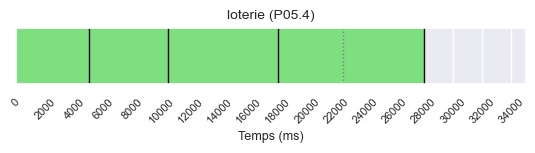

P05_4: 585108it [00:08, 68064.89it/s]
P06_1: 14000it [00:00, 138559.80it/s]

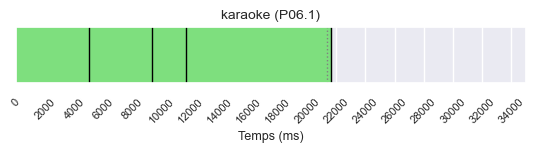

P06_1: 72934it [00:00, 125388.89it/s]

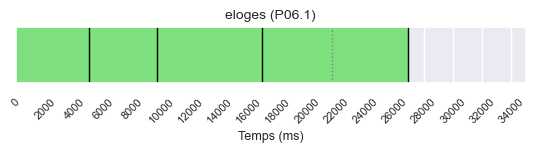

P06_1: 141956it [00:01, 126050.84it/s]

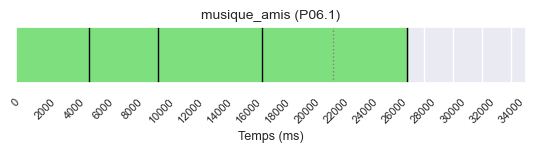

P06_1: 189924it [00:01, 115616.85it/s]

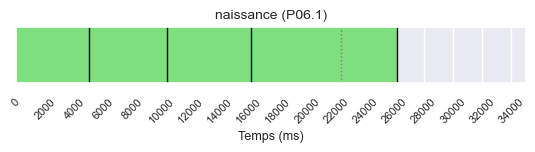

P06_1: 266299it [00:02, 137353.05it/s]

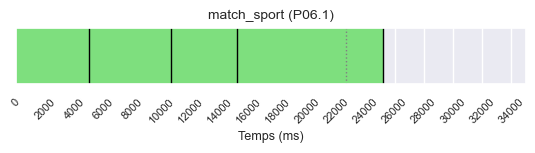

P06_1: 316306it [00:03, 120246.86it/s]

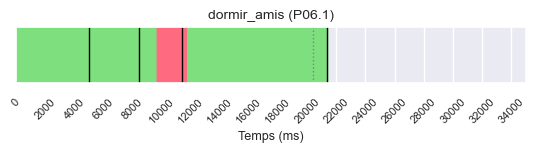

P06_1: 383604it [00:03, 119711.87it/s]

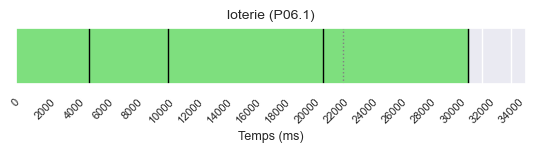

P06_1: 455975it [00:04, 132971.85it/s]

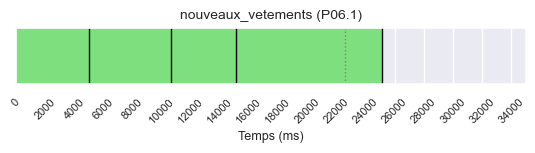

P06_1: 501173it [00:04, 115071.88it/s]

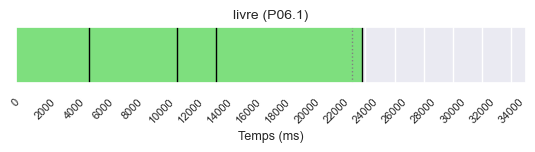

P06_1: 547656it [00:05, 109650.55it/s]

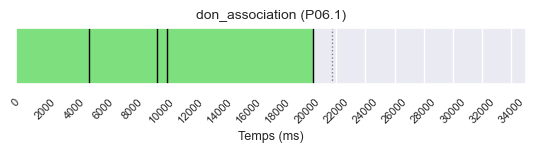

P06_1: 611529it [00:05, 119821.27it/s]

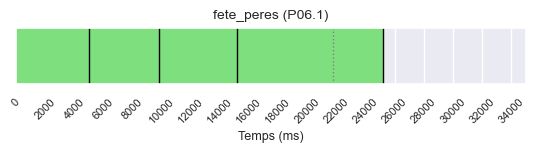

P06_1: 652940it [00:06, 105915.88it/s]

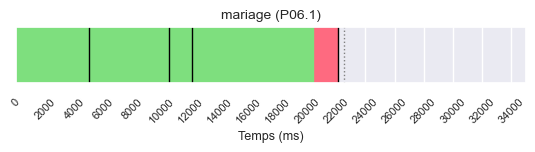

P06_1: 705113it [00:07, 100037.86it/s]
P06_2: 13224it [00:00, 132009.11it/s]

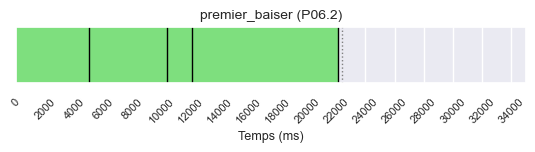

P06_2: 48976it [00:00, 90956.35it/s] 

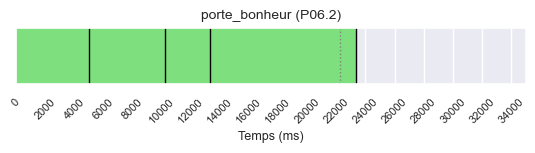

P06_2: 102235it [00:01, 90789.97it/s]

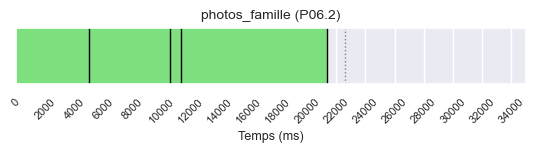

P06_2: 143067it [00:01, 93997.09it/s]

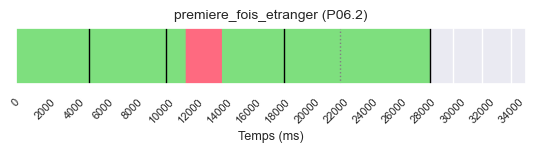

P06_2: 200831it [00:02, 86991.79it/s]

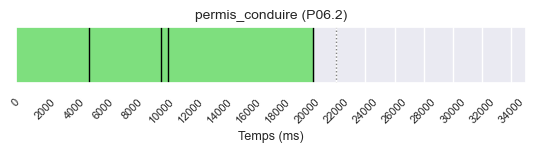

P06_2: 240293it [00:03, 93221.85it/s]

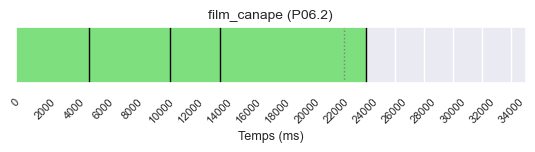

P06_2: 287321it [00:03, 101202.78it/s]

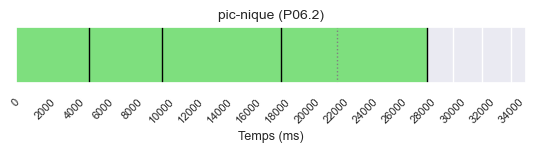

P06_2: 331757it [00:04, 98167.32it/s] 

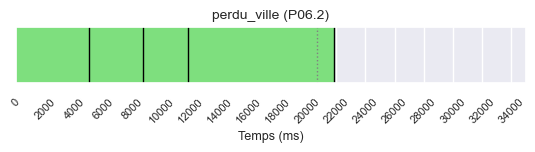

P06_2: 393285it [00:04, 103211.37it/s]

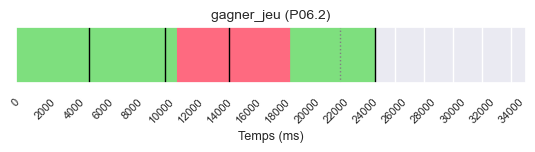

P06_2: 410354it [00:05, 62135.07it/s] 

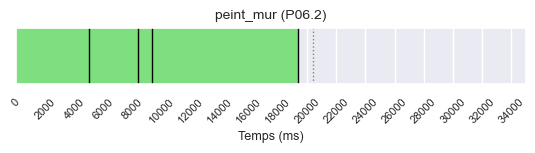

P06_2: 503492it [00:06, 120828.08it/s]

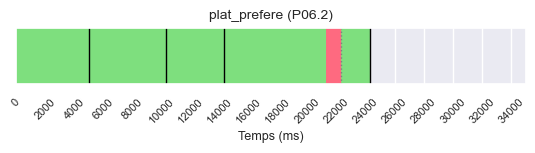

P06_2: 548247it [00:06, 106344.04it/s]

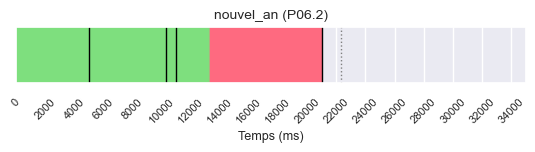

P06_2: 599658it [00:07, 82570.92it/s] 
P06_3: 14825it [00:00, 140761.84it/s]

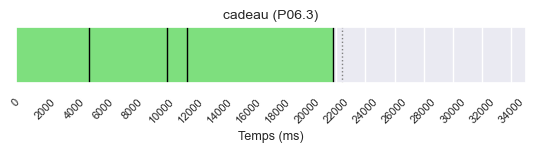

P06_3: 56747it [00:00, 104337.53it/s]

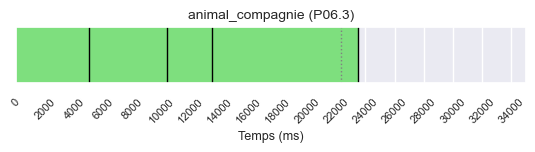

P06_3: 118455it [00:01, 107529.52it/s]

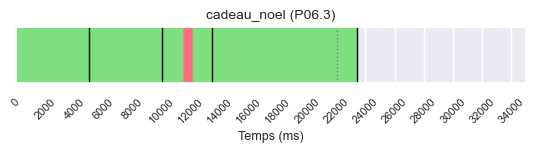

P06_3: 160785it [00:01, 91217.98it/s] 

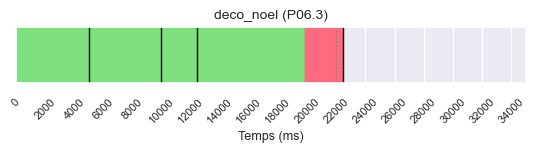

P06_3: 203589it [00:02, 88109.56it/s]

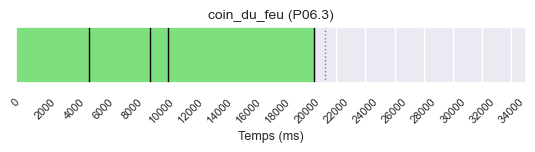

P06_3: 242796it [00:02, 89592.38it/s]

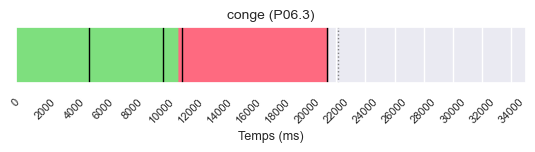

P06_3: 300634it [00:03, 84474.71it/s]

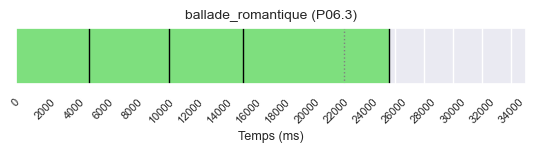

P06_3: 336332it [00:04, 86121.97it/s]

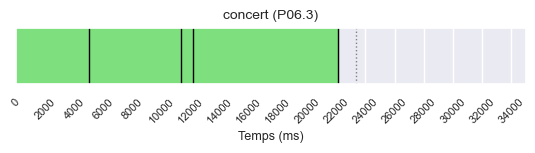

P06_3: 378049it [00:04, 92906.17it/s]

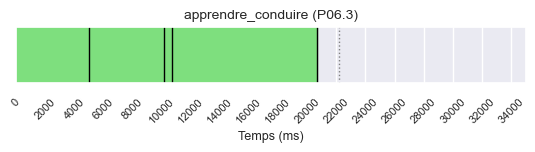

P06_3: 442190it [00:05, 114860.16it/s]

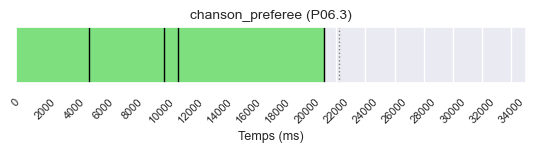

P06_3: 483789it [00:05, 105508.29it/s]

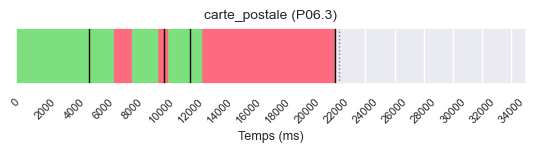

P06_3: 523088it [00:06, 97566.34it/s] 

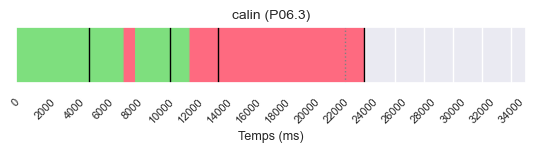

P06_3: 568433it [00:07, 80302.52it/s]
P06_4: 10463it [00:00, 100872.54it/s]

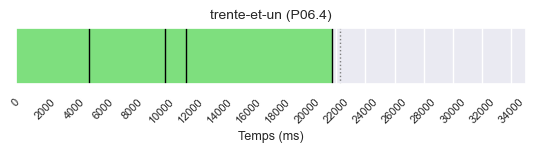

P06_4: 68725it [00:00, 120285.81it/s]

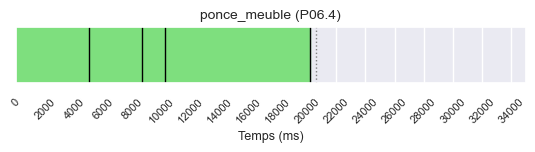

P06_4: 102962it [00:01, 81171.99it/s]

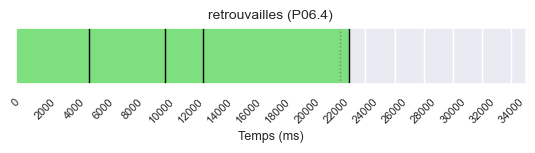

P06_4: 145443it [00:01, 93265.79it/s]

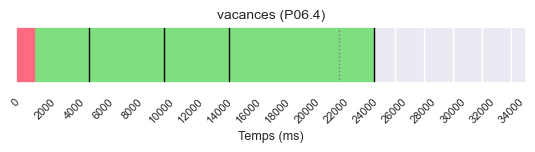

P06_4: 208307it [00:02, 110565.56it/s]

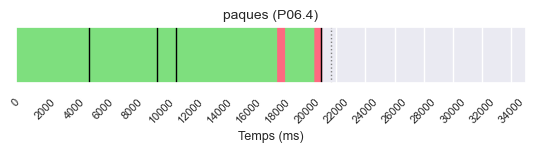

P06_4: 269893it [00:03, 119535.14it/s]

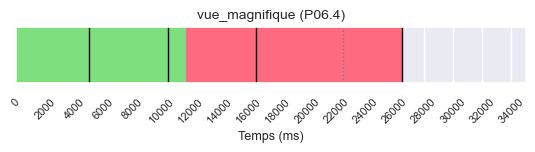

P06_4: 287441it [00:03, 68976.33it/s] 

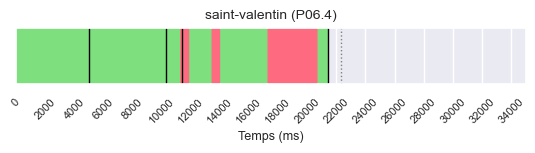

P06_4: 353343it [00:04, 78215.52it/s]

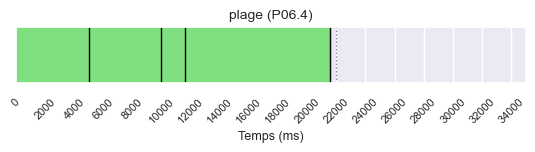

P06_4: 390772it [00:04, 82368.16it/s]

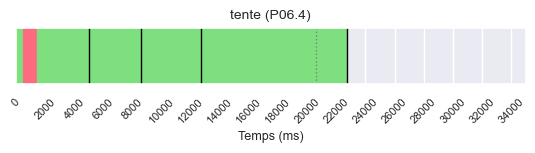

P06_4: 433521it [00:05, 89573.36it/s]

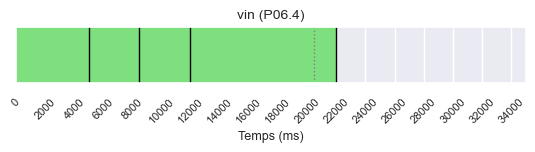

P06_4: 479299it [00:06, 97389.60it/s]

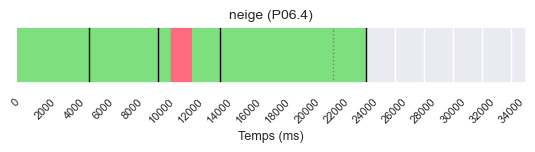

P06_4: 543564it [00:06, 102238.46it/s]

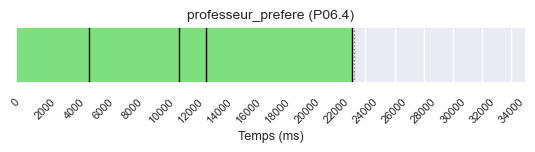

P06_4: 579933it [00:07, 80486.23it/s] 
P07_1: 22416it [00:00, 206246.48it/s]

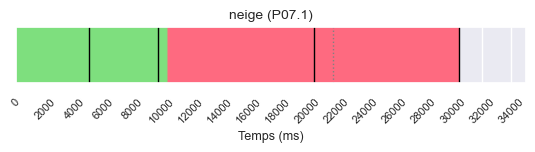

P07_1: 92561it [00:00, 103051.07it/s]

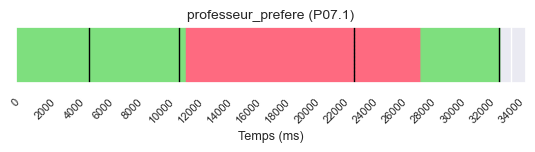

P07_1: 156169it [00:01, 100870.06it/s]

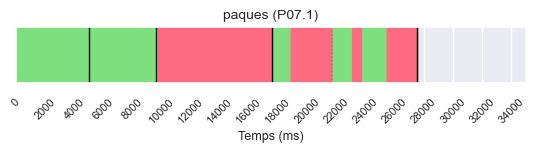

P07_1: 200516it [00:02, 94790.70it/s] 

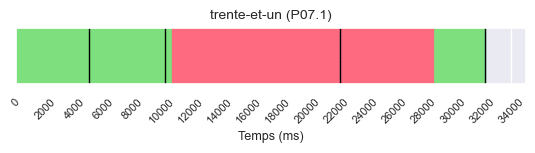

P07_1: 265768it [00:03, 83808.70it/s]

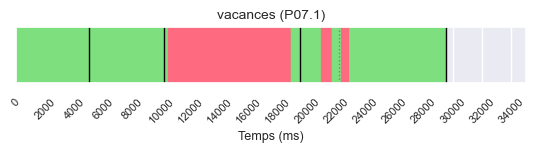

P07_1: 304806it [00:04, 68111.34it/s]

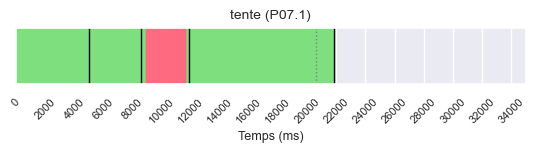

P07_1: 366578it [00:05, 84887.68it/s]

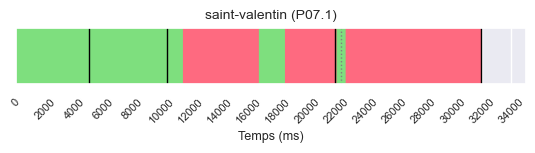

P07_1: 404440it [00:05, 66956.66it/s]

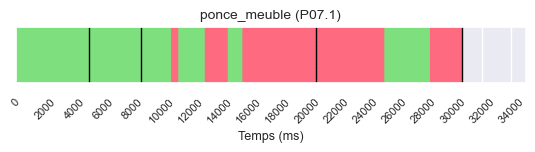

P07_1: 443958it [00:06, 52658.09it/s]

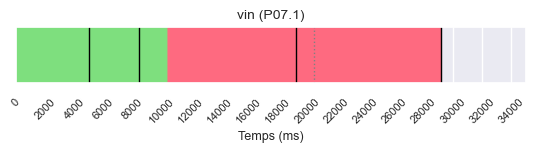

P07_1: 498620it [00:07, 70223.34it/s]

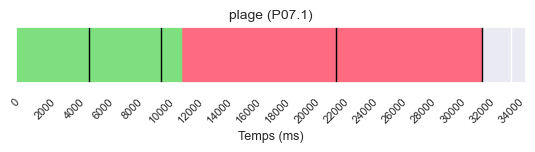

P07_1: 541318it [00:08, 72517.82it/s]

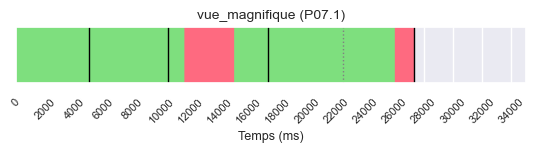

P07_1: 605048it [00:09, 84580.39it/s]

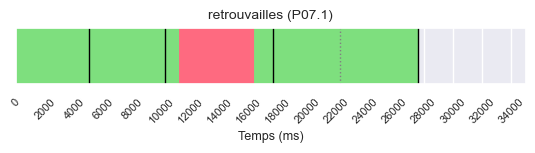

P07_1: 642177it [00:10, 63032.64it/s]
P07_2: 15299it [00:00, 148192.09it/s]

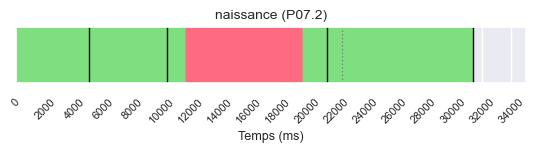

P07_2: 56133it [00:00, 81639.99it/s] 

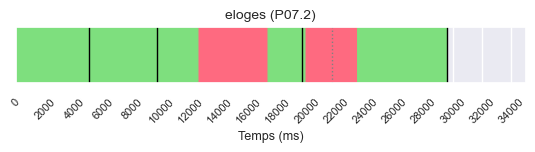

P07_2: 118273it [00:01, 77353.57it/s]

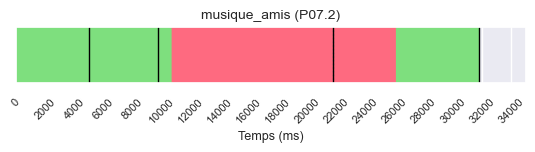

P07_2: 156835it [00:02, 71663.65it/s]

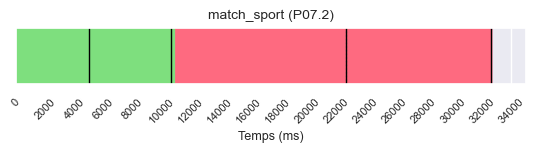

P07_2: 199528it [00:03, 75566.03it/s]

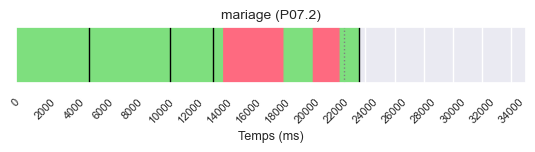

P07_2: 263371it [00:03, 100144.92it/s]

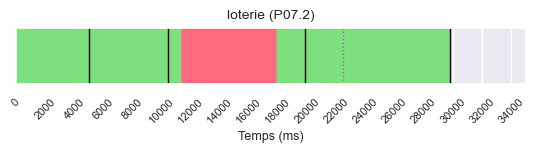

P07_2: 302573it [00:04, 76936.19it/s] 

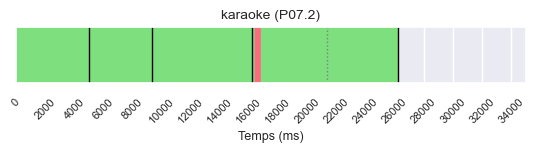

P07_2: 341841it [00:04, 82656.51it/s]

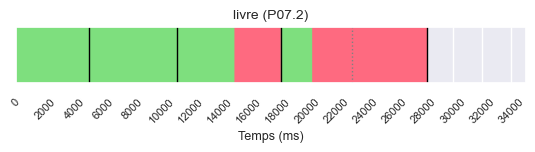

P07_2: 382255it [00:05, 75189.60it/s]

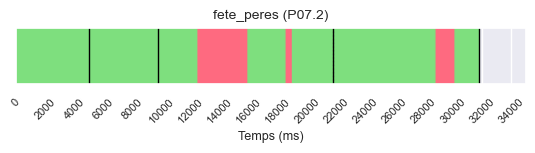

P07_2: 422583it [00:06, 62882.30it/s]

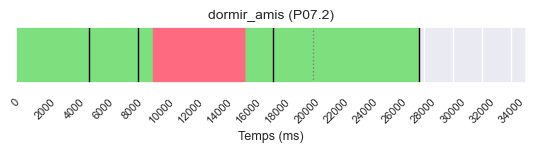

P07_2: 461825it [00:07, 60026.22it/s]

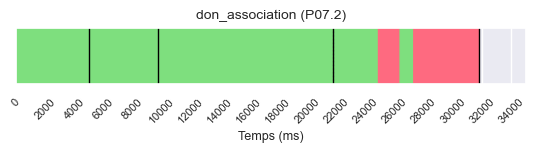

P07_2: 526563it [00:08, 88089.96it/s]

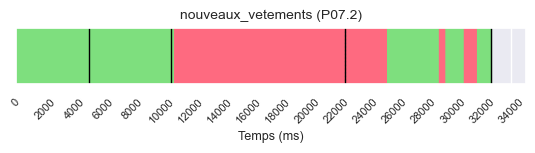

P07_2: 566621it [00:08, 65704.29it/s]
P07_3: 11804it [00:00, 112077.25it/s]

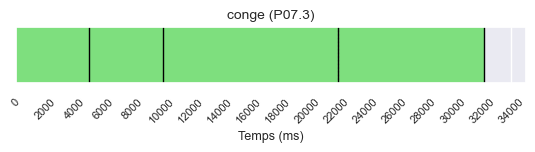

P07_3: 65746it [00:00, 98286.71it/s] 

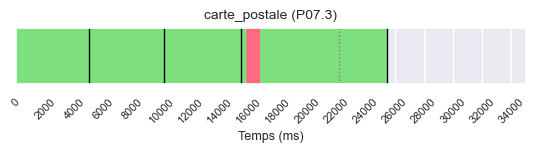

P07_3: 103349it [00:01, 85155.17it/s]

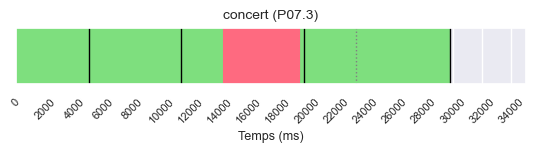

P07_3: 158549it [00:02, 80935.04it/s]

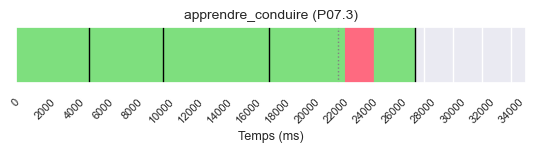

P07_3: 196085it [00:02, 83029.29it/s]

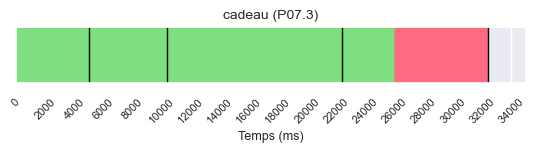

P07_3: 238350it [00:03, 89041.30it/s]

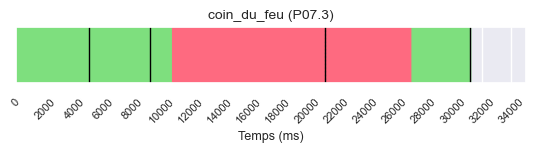

P07_3: 297127it [00:04, 85027.19it/s]

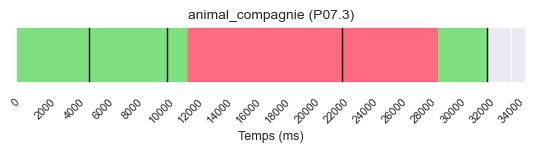

P07_3: 333342it [00:04, 71732.08it/s]

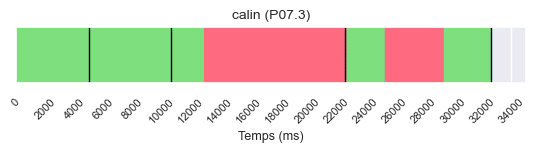

P07_3: 374900it [00:05, 66269.41it/s]

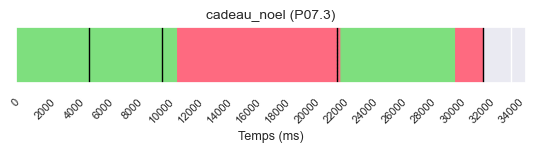

P07_3: 434340it [00:06, 69744.55it/s]

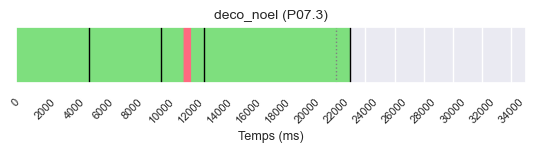

P07_3: 489782it [00:07, 76965.29it/s]

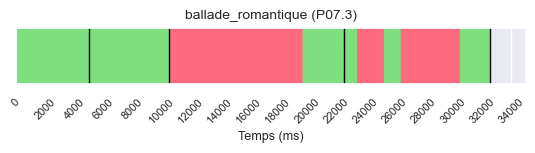

P07_3: 527265it [00:07, 80885.91it/s]

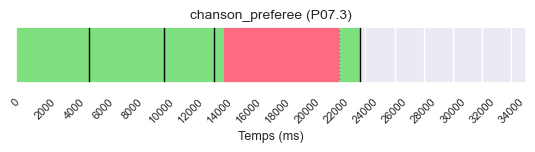

P07_3: 556652it [00:08, 66202.69it/s]
P07_4: 15035it [00:00, 148863.04it/s]

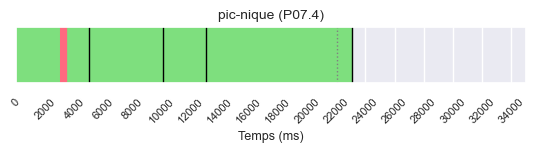

P07_4: 50512it [00:00, 89186.03it/s] 

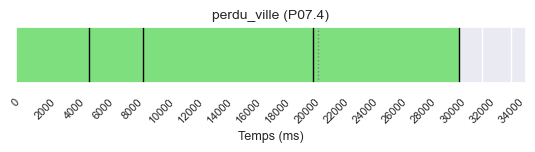

P07_4: 94858it [00:01, 88185.97it/s]

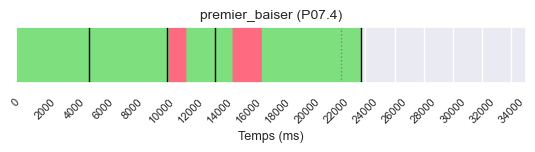

P07_4: 139276it [00:01, 90747.68it/s]

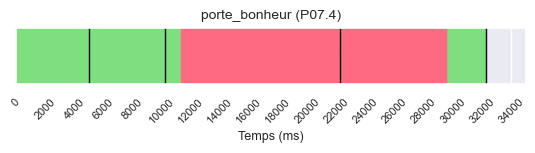

P07_4: 182335it [00:02, 76898.64it/s]

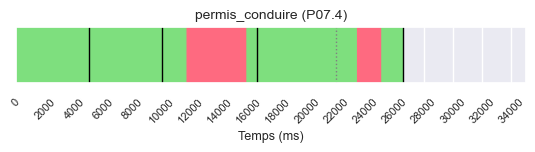

P07_4: 224193it [00:03, 77182.38it/s]

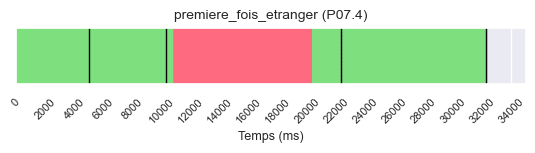

P07_4: 268222it [00:03, 75911.50it/s]

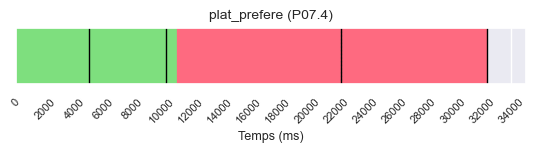

P07_4: 313903it [00:04, 72333.93it/s]

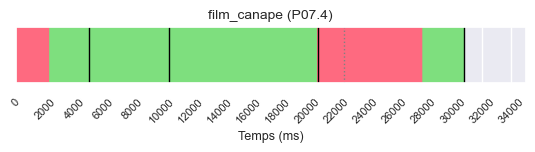

P07_4: 356493it [00:05, 68295.74it/s]

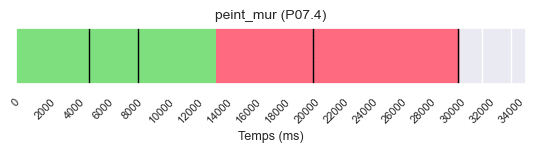

P07_4: 400040it [00:06, 65858.37it/s]

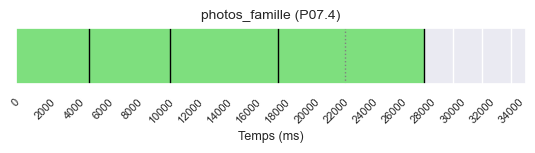

P07_4: 439529it [00:06, 69349.35it/s]

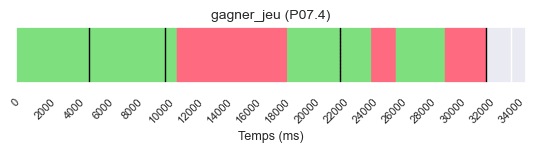

P07_4: 481082it [00:07, 67866.84it/s]

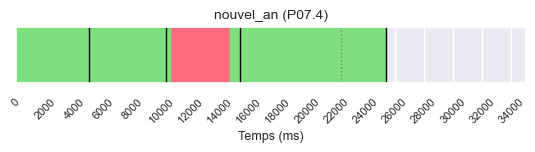

P07_4: 514869it [00:08, 61057.05it/s]
P09_1: 38739it [00:00, 185339.76it/s]

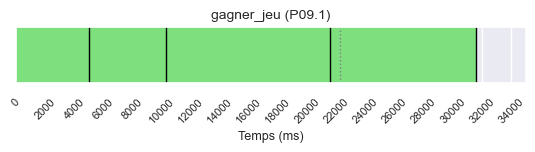

P09_1: 105380it [00:00, 133384.75it/s]

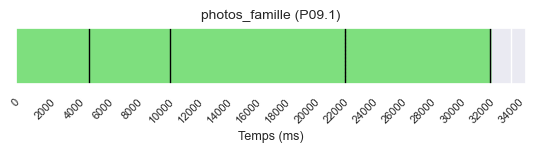

P09_1: 148820it [00:01, 98485.19it/s] 

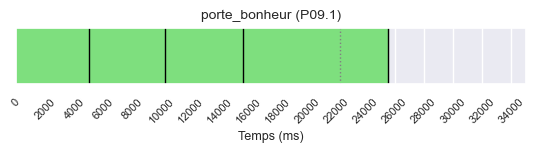

P09_1: 192861it [00:01, 99302.42it/s]

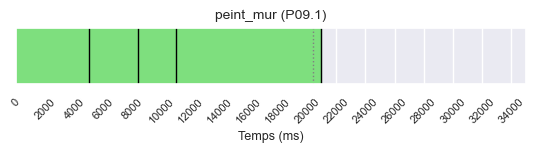

P09_1: 237084it [00:02, 99223.71it/s]

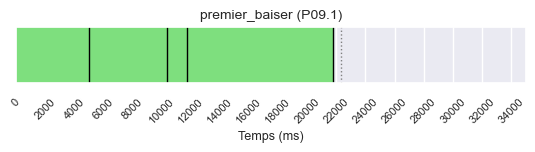

P09_1: 281768it [00:03, 100211.70it/s]

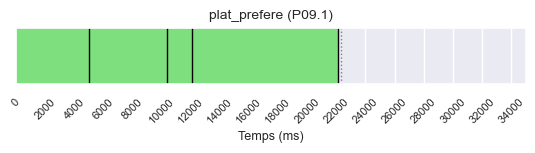

P09_1: 324889it [00:03, 98717.60it/s] 

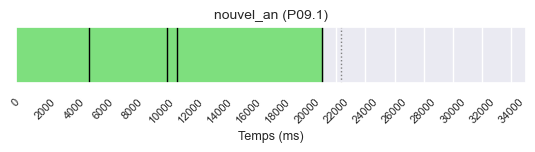

P09_1: 369935it [00:04, 99094.40it/s]

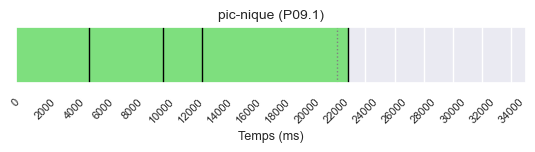

P09_1: 428725it [00:04, 108456.07it/s]

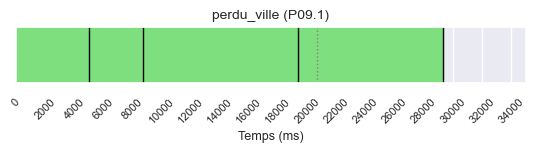

P09_1: 468490it [00:05, 98638.72it/s] 

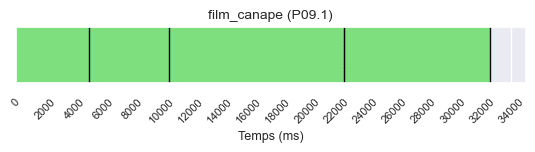

P09_1: 507077it [00:05, 92131.38it/s]

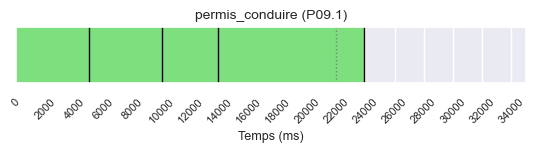

P09_1: 567536it [00:06, 106228.48it/s]

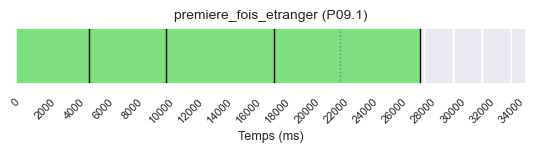

P09_1: 596415it [00:06, 88500.53it/s] 
P09_2: 16987it [00:00, 159621.48it/s]

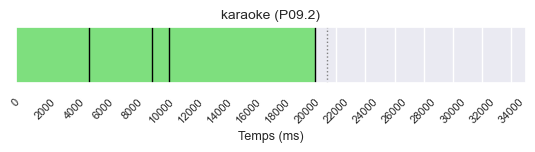

P09_2: 54276it [00:00, 101606.40it/s]

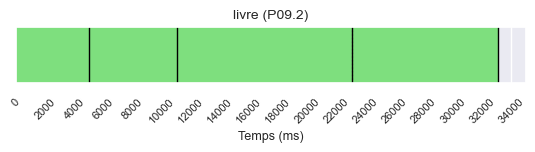

P09_2: 109654it [00:01, 103392.08it/s]

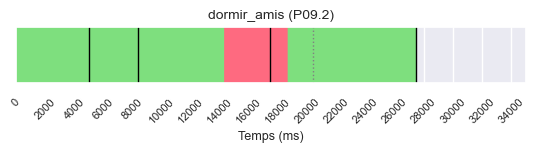

P09_2: 153194it [00:02, 79167.90it/s] 

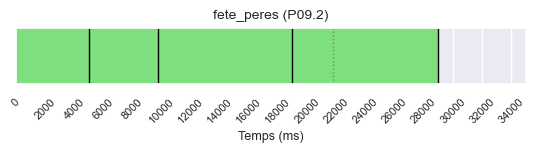

P09_2: 219918it [00:02, 98400.32it/s]

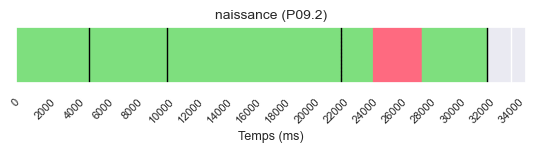

P09_2: 260216it [00:03, 74858.17it/s]

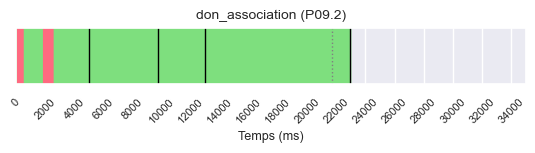

P09_2: 302714it [00:04, 85538.96it/s]

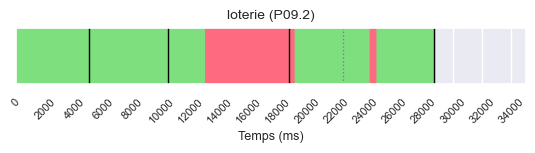

P09_2: 347288it [00:04, 78577.42it/s]

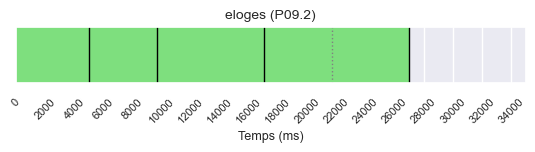

P09_2: 393127it [00:05, 83331.66it/s]

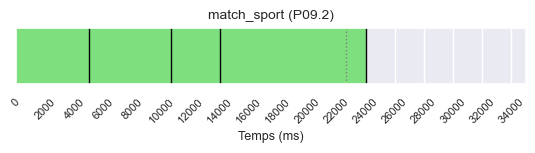

P09_2: 433249it [00:05, 84086.59it/s]

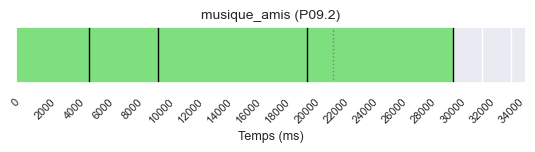

P09_2: 474046it [00:06, 82769.39it/s]

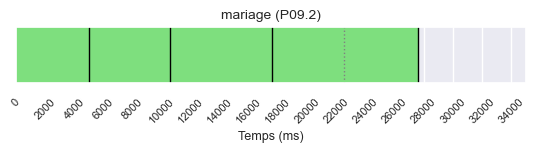

P09_2: 513958it [00:07, 84741.49it/s]

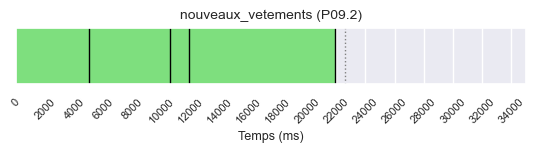

P09_2: 548714it [00:07, 72593.29it/s]
P09_3: 0it [00:00, ?it/s]

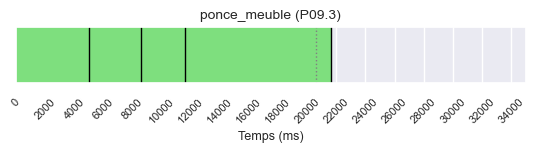

P09_3: 50362it [00:00, 93949.40it/s]

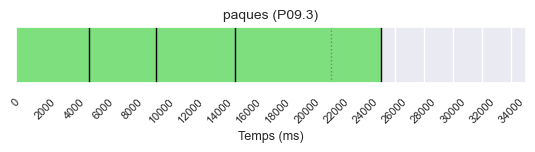

P09_3: 93381it [00:01, 78208.83it/s]

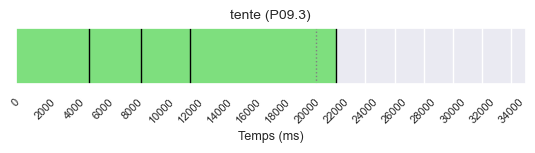

P09_3: 139241it [00:01, 87940.62it/s]

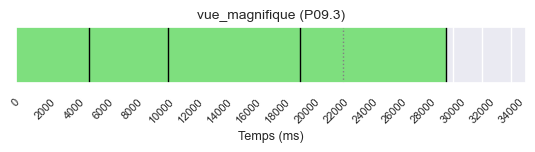

P09_3: 197804it [00:02, 94505.59it/s]

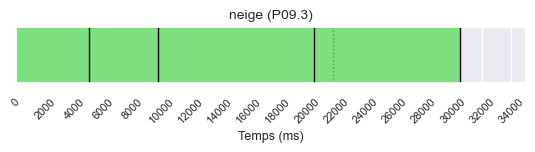

P09_3: 233266it [00:03, 79312.66it/s]

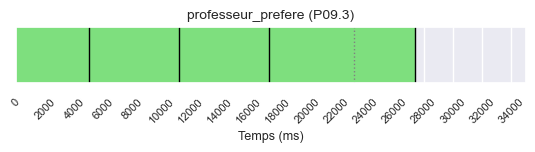

P09_3: 269527it [00:03, 80838.19it/s]

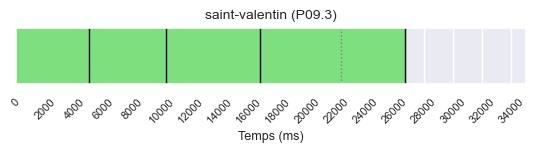

P09_3: 310805it [00:04, 86327.88it/s]

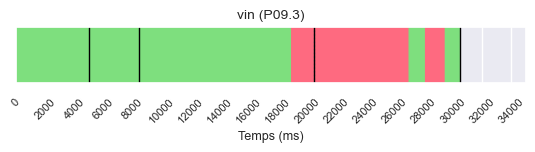

P09_3: 351629it [00:05, 75979.20it/s]

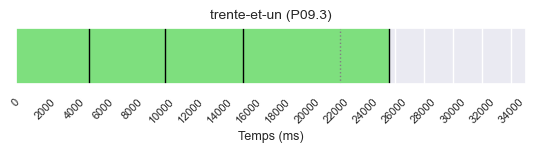

P09_3: 392538it [00:05, 77202.17it/s]

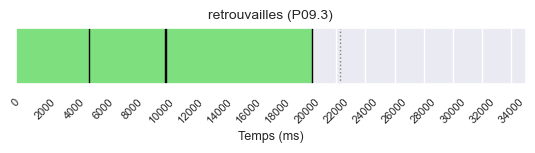

P09_3: 434377it [00:06, 88074.66it/s]

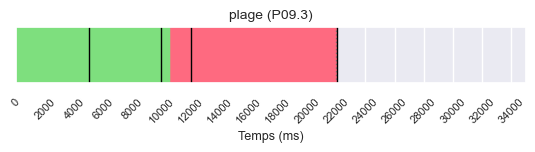

P09_3: 474727it [00:07, 63956.55it/s]

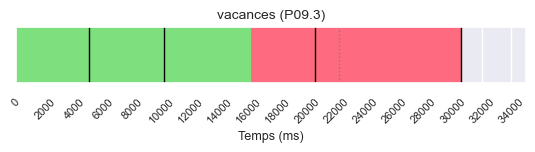

P09_3: 515806it [00:07, 66576.05it/s]
P09_4: 11891it [00:00, 118830.79it/s]

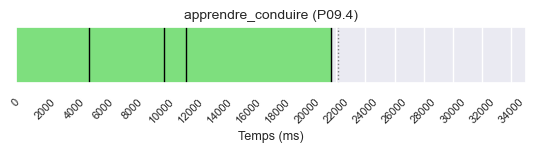

P09_4: 50335it [00:00, 101091.66it/s]

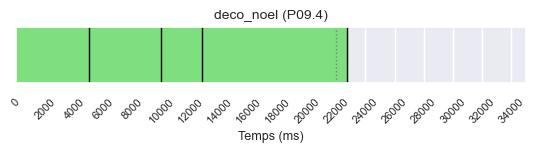

P09_4: 94030it [00:01, 93952.54it/s] 

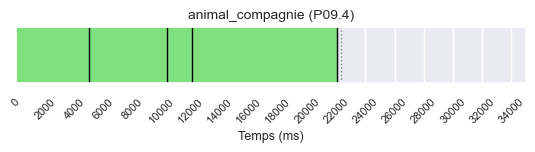

P09_4: 136814it [00:01, 95170.79it/s]

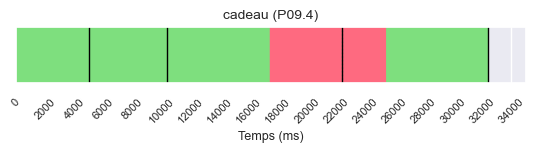

P09_4: 177729it [00:02, 82800.14it/s]

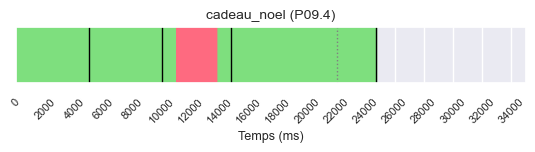

P09_4: 215822it [00:03, 64635.51it/s]

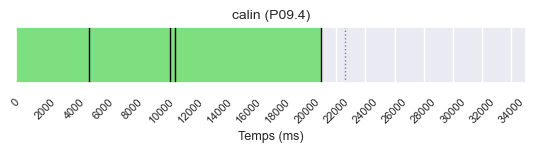

P09_4: 255626it [00:03, 76479.95it/s]

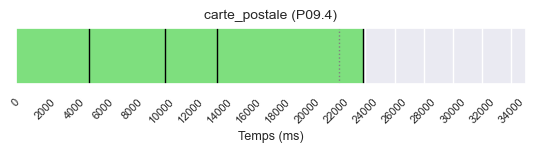

P09_4: 296052it [00:04, 83801.89it/s]

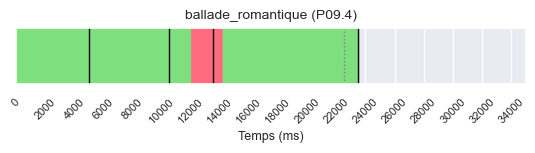

P09_4: 338513it [00:04, 78243.89it/s]

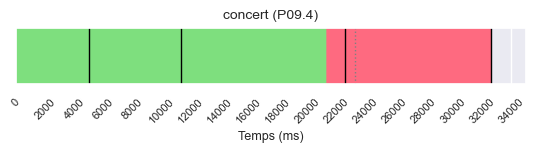

P09_4: 383088it [00:05, 78791.12it/s]

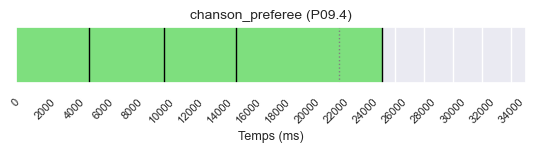

P09_4: 426276it [00:06, 86519.46it/s]

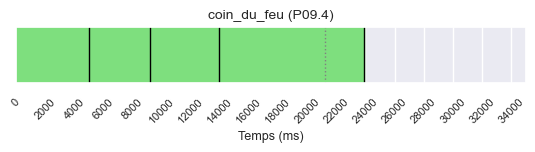

P09_4: 467289it [00:06, 90511.88it/s]

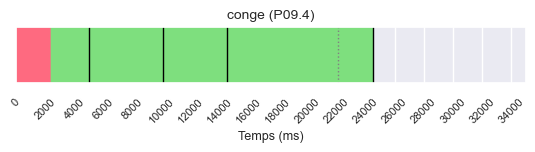

P09_4: 508419it [00:07, 71759.90it/s]

number of VD starting in access and continuing in elaboration =  444


In [5]:
###############################
    
ouvrir_fichier_ET()
ouvrir_fichier_ET_visu()
ouvrir_fichier_orientation()
os.chdir(wd_input)
lst_files = os.listdir()
lst_files.sort()
lst = []
for asc_file in lst_files:
    if ".asc" in asc_file:
       lst.append(asc_file)
sujets=[]
sns.set(style="darkgrid")

count_VD_start_access_continue_visu = 0

for filename in lst :    
    fichier = csv.reader(open(filename),delimiter='\t')
    sujett=filename[4:-6]
    sujet=idd[sujett]
    if sujet not in sujets :
        sujets.append(sujet)
    bloc=filename[-5:-4]
    numero=0
    ind_essai=0    
    for row in tqdm(fichier,desc=f'{sujet}_{bloc}'): 
        roww=','.join(row)
        
              
        if "FIX_DOT" in roww :  
            ind_essai=1 #Indicate if the datapoint is part of the access phase
            ind_acces=0
            #**********
            ind_visu = 0
            #**********
            ind_out=0 #indicate if the gaze is OUT of the screen
            ind_in=0 #indicate if the gaze is IN of the screen
            ind_VD=0 ##indicate if the gaze (datapoint) is part of a gaze aversion (VD) or not 
            just_in=0 # indicate if transition from OUT to IN
            just_out=0 # indicate if transition from IN to OUT
            L=[] #finale list containing O and 1 values (1 is gaze aversion) for all the signal
            L_acces=[] #list containing O and 1 values (1 is gaze aversion) for access phases
            #***********
            L_visu = [] #list containing O and 1 values (1 is gaze aversion) for elaboration phases
            #***********
            ## Temporary storage and if OUT goes less than 500 ms, will be considered as a blinks :
            pas_blink_in=[]
            blink_in=[]
            pas_blink_out=[] 
            blink_out=[]
            ##Saccades and fixations
            nb_sacc=0
            ind_fix=0
            fix=0
            started_before_visu = 0
            duration_VD_inside_elaboration = 0
            ##Coordinates
            x=[]
            y=[]
            txt=row[1]
            pattern='auto'
            aa=txt.index(pattern)
            audio=row[1][aa:]
            titre=audio[5:-4]+' ('+sujet+'.'+bloc+')'
        
        if "ACCES" in roww :
            #print("enter_acces")
            ind_acces=1
            #*********
            ind_visu = 0
            #*********
            pas_blink_in.append(7)
            blink_in.append(7)
            pas_blink_out.append(7) 
            blink_out.append(7)
        
        #******************
        if "VISUAL" in roww :
            #print('enter visu')
            ind_visu=1
            ind_acces=0
            pas_blink_in.append(6)
            blink_in.append(6)
            pas_blink_out.append(6) 
            blink_out.append(6)
            
        #******************
           
        if ind_essai==1 :
            ind_go=1
            if "S" in row[0] or "E" in row[0]:  #when there is a message line in Eyelink file (FIX, SACC, loggers, ...). S stands for START (ex : SFIX = start of fixation). E stands for END (ex : ESACC = end of saccade).
                ind_go=0
            if "DEBRIEFING_AUDIO" in roww: #if last line
                if ind_in==1: 
                    just_out=1
                    just_in=0
                if ind_out==1:
                    just_in=1
                    just_out=0
                ind_go=1

            
            if ind_go==1:
                #when there is coordinates
                if "S" not in row[0] and "E" not in row[0]and " ." not in row[1]:
                    x_coord=float(row[1])
                    y_coord=float(row[2])
                    if x_coord>=1 and x_coord<=1022 and y_coord>=1 and y_coord<=766: #when inside the screen
                        ind_in=1
                        x.append(x_coord)
                        y.append(y_coord)
                        if ind_out==1: #just_in tells if the gaze comes back in the screen 
                            just_in=1
                            ind_out=0
                    if x_coord<1 or x_coord>1022 or y_coord<1 or y_coord>766: #when outside of the screen
                        ind_out=1
                        x.append('out')
                        y.append('out')
                #When there is no coordinate
                elif " ." in row[1]:
                    ind_out=1
                    x.append('out')
                    y.append('out')
                if ind_out==1 and ind_in==1 and just_in==0: #just_out tells if the gaze left the screen
                    just_out=1
                    ind_in=0   
                #Now, determine what to do after a transition between IN and OUT 
                if just_in==1:
                    if len(blink_out)>seuil or ind_VD==1: #if OUT for less than maximal blink duration, considered as a blink 
                        ind_VD=1
                        L.extend(pas_blink_out)
                    if len(blink_out)<=seuil and ind_VD==0:
                        L.extend(blink_out)
                    pas_blink_out=[]
                    blink_out=[]
                    blink_in=[]
                    pas_blink_in=[]                    
                if just_out==1:
                    if len(blink_in)<seuil: #if it is a blink
                        if ind_VD==1:
                            L.extend(blink_in)
                        if ind_VD==0:
                            L.extend(pas_blink_in)
                    if len(blink_in)>=seuil:
                        L.extend(pas_blink_in)
                        ind_VD=0
                    blink_in=[]
                    pas_blink_in=[]
                    pas_blink_out=[]
                    blink_out=[]                    
                just_out=0
                just_in=0
                #If this is not a transition period
                if ind_in==1 and just_in==0:
                    pas_blink_in.append(0)
                    blink_in.append(1)
                if ind_out==1 and just_out==0:
                    pas_blink_out.append(1)
                    blink_out.append(0)
                    
            #Count saccades and fixations when gaze is inside the screen            
            if ind_acces==1 :                   
                if "SSACC" in row[0] and ind_in==1:
                    nb_sacc=nb_sacc+1
                if "SFIX" in row[0] and ind_in==1:
                    ind_fix=1
                if "EFIX" in row[0]:
                    ind_fix=0
                if ind_fix==1:
                    fix=fix+1
    
        if "DEBRIEFING_AUDIO" in roww :
            ind_essai=0
            ind_acces=0
            ind_visu = 0
          
            numero=numero+1
            
            nb_VD,delai,moy_duree_VD,text,pattern,ratio,L_acces,end_of_question_xc, VD_continue_in_visu=calcul_VD(L)#fonction
            completer_fichier_ET(sujet,bloc,audio,str(nb_VD),str(moy_duree_VD),str(ratio),str(delai),str(nb_sacc),str(fix/len(L_acces)), str(VD_continue_in_visu))
            
            nb_VD_v,delai_v,moy_duree_VD_v,text_v,pattern_v,ratio_v,L_visu,start_of_visualisation,started_before_visu,duration_VD_inside_elaboration=calcul_VD_visu(L)
            completer_fichier_ET_visu(sujet,bloc,audio,str(nb_VD_v),str(moy_duree_VD_v),str(ratio_v),str(delai_v), str(started_before_visu), str(duration_VD_inside_elaboration))
            
            if L_acces[-1] == 1 and L_visu[0] == 1:
                count_VD_start_access_continue_visu = count_VD_start_access_continue_visu + 1
            
  
            plot_figure(L,L_acces,titre,"1",str(numero))   
            

            
            
            #Collect data for orientation calculation (get last datapoint before the gaze leaves the screen for gaze aversion)
            #Collect orientation for gaze aversions occurring in access phase
            pattern_fin = [1,0]            
            pattern_fin = ''.join(str(z) for z in pattern_fin) 
            if L_acces[0]!=1:  
                indx=0
                indxx=0
                if nb_VD!=0:
                    for i in range(nb_VD):
                        indx=text.index(pattern,indxx)    
                        #rint('index=', indx)
                        indxx=indx+1 
                        tps=250
                        m=0
                        if (i+1)!=nb_VD:
                            indx_fin=text.index(pattern_fin,indx)                          
                        elif (i+1)==nb_VD:
                            if L_acces[-1]!=1:                               
                                indx_fin=text.index(pattern_fin,indx)
                            elif L_acces[-1]==1:
                                indx_fin=len(text)                            
                        dur=(indx_fin-indx)*2 # dur = duration of visual disengagement (= gaze aversion)
                        
                        if indx<tps:
                            mm=range(0,indx-1)
                        elif indx>=tps:
                            mm=range(0,tps)
                        for n in mm:
                            if n==0 :
                                m="1"
                            y_acces=y[end_of_question_xc+1:]
                            x_acces=x[end_of_question_xc+1:]
                            indd=indx-n-1 
                            completer_fichier_orientation(sujet,audio,str(i+1),str(indxx*2),str(x_acces[indd]),str(y_acces[indd]),str(m),str(dur))            
                            m=0

print('number of VD starting in access and continuing in elaboration = ', count_VD_start_access_continue_visu)